In [1]:
import torch

print(torch.cuda.is_available())


print(torch.cuda.current_device())

print(torch.cuda.device(0))

print(torch.cuda.device_count())

print(torch.cuda.get_device_name(0))

True
0
1
GeForce RTX 3070


In [1]:
import numpy as np 
import time

import torch 
import torch.nn as nn
import torch.nn.functional as F 
from torch.utils.data import TensorDataset, DataLoader

import matplotlib.pyplot as plt
from collections import OrderedDict

from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score, f1_score
from sklearn.preprocessing import RobustScaler
from sklearn.preprocessing import StandardScaler
import os
import pandas as pd
pd.set_option("display.max_columns", None)


# from keras.utils import np_utils
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
import json

from google.cloud import bigquery
from google.oauth2 import service_account
import datetime
import pickle

from tqdm.notebook import tqdm

import warnings
warnings.filterwarnings("ignore")
from SA_FunctionsRaycon import *

In [2]:
from Source.inception import Inception, InceptionBlock

In [3]:
class Flatten(nn.Module):
    def __init__(self, out_features):
        super(Flatten, self).__init__()
        self.output_dim = out_features

    def forward(self, x):
        return x.view(-1, self.output_dim)
    
class Reshape(nn.Module):
    def __init__(self, out_shape):
        super(Reshape, self).__init__()
        self.out_shape = out_shape

    def forward(self, x):
        return x.view(-1, *self.out_shape)

In [4]:
def label_data(training_data,labels):
    training_data['label']='no_event'
    for appliance,label,time in zip(labels.equipment_type,labels.event_type,labels.event_time):
        if label=='ON':
            start_time = time - datetime.timedelta(milliseconds=250)
            end_time = time + datetime.timedelta(milliseconds=750)
        else:
            start_time = time - datetime.timedelta(milliseconds=250)
            end_time = time + datetime.timedelta(milliseconds=750)
#         else:
#             start_time = time - datetime.timedelta(milliseconds=200)
#             end_time = time + datetime.timedelta(milliseconds=200)

        training_data.loc[(training_data.logged_on_utc>=start_time) & 
                          (training_data.logged_on_utc<=end_time),'label']= appliance+'_'+label

    return training_data

def label_data_chunks(alldata, labels):
    datalist = list()
    labellist = list()
    timelist = list()
    for appliance, label, time in zip(labels.equipment_type,labels.event_type,labels.event_time):
        st = time - datetime.timedelta(minutes=2)
        et = time + datetime.timedelta(minutes=1)
        out = alldata[(st <= alldata.logged_on_utc) & (alldata.logged_on_utc <= et)]
        if out.empty:
            continue
        datalist.append(out)
        labellist.append(appliance + '_' + label)
        timelist.append(time + datetime.timedelta(hours=5, minutes=30))
    return datalist, labellist, timelist

def no_label_data_chunks(alldata, nolabels):
    datalist = list()
    labellist = list()
    timelist = list()
    for nl in nolabels:
        st = nl - datetime.timedelta(minutes=2)
        et = nl + datetime.timedelta(minutes=1)
        out = alldata[(st <= alldata.logged_on_utc) & (alldata.logged_on_utc <= et)]
        if out.empty:
            continue
        datalist.append(out)
        labellist.append('no_label')
        timelist.append(nl + datetime.timedelta(hours=5, minutes=30))
    return datalist, labellist, timelist


def label_training_chunks(device_id, property_id, raw_training_data):
    labels=import_labels(property_id)
    training_data = raw_training_data[raw_training_data.device_id==device_id]
    training_data = training_data.drop(columns=['dump', 'created_on_utc', 'property_id', 'device_id'])
    training_data = training_data.sort_values(by='logged_on_utc')
    datalist, labellist, timelist = label_data_chunks(training_data, labels)
    return datalist, labellist, timelist

def no_label_training_chunks(device_id, property_id, raw_training_data):
    labels=import_labels(property_id)
    nolabellist = get_label_time(raw_training_data, labels, 10)
    training_data = raw_training_data.drop(columns=['dump', 'created_on_utc', 'property_id', 'device_id'])
    training_data = training_data.sort_values(by='logged_on_utc')
    datalist, labellist, timelist = no_label_data_chunks(training_data, nolabellist)
    return datalist, labellist, timelist    

def get_label_time(all_training_data, labels, samples):
    labels = labels.sort_values(by='event_time')
    eventlist = labels.event_time.tolist()
    starttime = min(all_training_data.logged_on_utc)
    endtime = max(all_training_data.logged_on_utc)
    shorteventlist = [e for e in eventlist if starttime < e < endtime]
#     print(starttime, endtime, len(eventlist), len(shorteventlist))
#     print(shorteventlist)
    nolabellist = []
    for i in range(len(shorteventlist)-1):
        st = shorteventlist[i] + datetime.timedelta(seconds=5)
        et = shorteventlist[i+1] - datetime.timedelta(seconds=5)
        delta = (et - st).total_seconds()
        if delta > 100:
#             print(st, et, delta)
            randsamp = np.random.uniform(0, 1, size=samples)
            randsamp = [st + datetime.timedelta(seconds=delta*r) for r in randsamp]
            for r in randsamp:
                nolabellist.append(r)
    return nolabellist
         

def import_labels(property_id):
    labels=pd.read_excel('Data/Labelled_Data_22_08_2021.xlsx')
    labels=labels[labels['lead_property_id']==property_id]
    labels['event_time']=[datetime.datetime.fromtimestamp(timestamp/1000)-datetime.timedelta(hours=5.5) 
                          for timestamp in labels['event_time']]
    return labels

def label_training_data(device_id, property_id, raw_training_data):
    labels=import_labels(property_id)
    training_data = raw_training_data[raw_training_data.device_id==device_id]
    training_data=label_data(training_data,labels)
    return training_data


In [5]:
all_training_data = pd.read_pickle('Data/logger_data160821180821.pkl')
# labelled_data.to_pickle('Data/labelled_data_22_08_2021.pkl')

In [6]:
datalist, labellist, timelist = label_training_chunks('devid_C82B9690A288', 1403, all_training_data)
nodatal, nolabl, notiml = no_label_training_chunks('devid_C82B9690A288', 1403, all_training_data)

In [7]:
labels = import_labels(1403)

In [8]:
datalist[0].info()
print(labellist)
print(timelist)  # Label Time list

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3541 entries, 1412928 to 2566515
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   logged_on_utc        3541 non-null   datetime64[ns]
 1   logged_on_local      3541 non-null   datetime64[ns]
 2   voltage_V1           3541 non-null   float64       
 3   voltage_V2           3541 non-null   float64       
 4   voltage_V3           3541 non-null   float64       
 5   current_i1           3541 non-null   float64       
 6   current_i2           3541 non-null   float64       
 7   current_i3           3541 non-null   float64       
 8   active_power_P1      3541 non-null   float64       
 9   active_power_P2      3541 non-null   float64       
 10  active_power_P3      3541 non-null   float64       
 11  apparent_power_S1    3541 non-null   float64       
 12  apparent_power_S2    3541 non-null   float64       
 13  apparent_power_S3    354

In [9]:
nodatal[0].info()
print(nolabl)
print(notiml)

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3540 entries, 2421789 to 603361
Data columns (total 32 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   logged_on_utc        3540 non-null   datetime64[ns]
 1   logged_on_local      3540 non-null   datetime64[ns]
 2   voltage_V1           3540 non-null   float64       
 3   voltage_V2           3540 non-null   float64       
 4   voltage_V3           3540 non-null   float64       
 5   current_i1           3540 non-null   float64       
 6   current_i2           3540 non-null   float64       
 7   current_i3           3540 non-null   float64       
 8   active_power_P1      3540 non-null   float64       
 9   active_power_P2      3540 non-null   float64       
 10  active_power_P3      3540 non-null   float64       
 11  apparent_power_S1    3540 non-null   float64       
 12  apparent_power_S2    3540 non-null   float64       
 13  apparent_power_S3    3540

In [10]:
nodatal[0]

,logged_on_utc,logged_on_local,voltage_V1,voltage_V2,voltage_V3,current_i1,current_i2,current_i3,active_power_P1,active_power_P2,active_power_P3,apparent_power_S1,apparent_power_S2,apparent_power_S3,reactive_power_Q1,reactive_power_Q2,reactive_power_Q3,frequency_Fq1,frequency_Fq2,frequency_Fq3,active_energy_Pt1,active_energy_Pt2,active_energy_Pt3,apparent_energy_St1,apparent_energy_St2,apparent_energy_St3,reactive_energy_Qt1,reactive_energy_Qt2,reactive_energy_Qt3,power_factor_PF1,power_factor_PF2,power_factor_PF3
2421789,2021-08-16 06:36:23.450,2021-08-16 12:06:23.450,235.33,240.43,240.73,7.88,0.31,0.69,383.48,67.73,67.73,1872.74,77.13,169.14,1829.49,37.05,132.12,50.03,50.03,50.03,45659.78,51337.44,0.0,105124.10,68936.37,0.0,94690.35,46007.49,0.0,0.211115,0.876929,-0.624749
2421784,2021-08-16 06:36:23.500,2021-08-16 12:06:23.500,235.33,240.44,240.75,7.88,0.31,0.69,378.66,67.61,67.61,1878.25,77.15,169.26,1829.49,37.05,132.12,50.03,50.03,50.03,45659.78,51337.44,0.0,105124.10,68936.37,0.0,94690.35,46007.49,0.0,0.211115,0.876929,-0.624749
2421793,2021-08-16 06:36:23.550,2021-08-16 12:06:23.550,235.32,240.44,240.74,7.88,0.31,0.69,387.69,67.57,67.57,1877.44,77.14,169.30,1829.49,37.05,132.12,50.03,50.03,50.03,45659.78,51337.44,0.0,105124.10,68936.37,0.0,94690.35,46007.49,0.0,0.211115,0.876929,-0.624749
2421792,2021-08-16 06:36:23.600,2021-08-16 12:06:23.600,235.31,240.43,240.74,7.88,0.31,0.69,407.52,67.55,67.55,1870.19,77.09,169.28,1829.49,37.05,132.12,50.03,50.03,50.03,45659.78,51337.44,0.0,105124.10,68936.37,0.0,94690.35,46007.49,0.0,0.211115,0.876929,-0.624749
2421778,2021-08-16 06:36:23.650,2021-08-16 12:06:23.650,235.32,240.44,240.76,7.88,0.31,0.69,408.31,67.49,67.49,1867.34,77.05,169.26,1829.49,37.05,132.12,50.03,50.03,50.03,45659.78,51337.44,0.0,105124.10,68936.37,0.0,94690.35,46007.49,0.0,0.211115,0.876929,-0.624749
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
603371,2021-08-16 06:39:23.200,2021-08-16 12:09:23.200,233.79,240.50,242.24,10.16,0.32,0.69,686.89,68.45,68.45,2395.12,78.24,168.76,2295.56,37.79,132.99,50.08,50.09,50.08,45688.02,51340.91,0.0,105232.87,68940.34,0.0,94797.47,46009.57,0.0,0.284831,0.875448,-0.615421
603299,2021-08-16 06:39:23.250,2021-08-16 12:09:23.250,233.79,240.50,242.24,10.16,0.32,0.69,688.95,68.43,68.43,2393.26,78.23,168.74,2295.56,37.79,132.99,50.08,50.09,50.08,45688.02,51340.91,0.0,105232.87,68940.34,0.0,94797.47,46009.57,0.0,0.284831,0.875448,-0.615421
603336,2021-08-16 06:39:23.300,2021-08-16 12:09:23.300,233.79,240.52,242.27,10.16,0.32,0.69,679.99,68.43,68.43,2395.06,78.22,168.78,2295.56,37.79,132.99,50.08,50.09,50.08,45688.02,51340.91,0.0,105232.87,68940.34,0.0,94797.47,46009.57,0.0,0.284831,0.875448,-0.615421
603314,2021-08-16 06:39:23.350,2021-08-16 12:09:23.350,233.79,240.53,242.28,10.16,0.32,0.69,672.39,68.47,68.47,2397.38,78.22,168.81,2295.56,37.79,132.99,50.08,50.09,50.08,45688.02,51340.91,0.0,105232.87,68940.34,0.0,94797.47,46009.57,0.0,0.284831,0.875448,-0.615421


In [11]:
datalist[0].head(60)

,logged_on_utc,logged_on_local,voltage_V1,voltage_V2,voltage_V3,current_i1,current_i2,current_i3,active_power_P1,active_power_P2,active_power_P3,apparent_power_S1,apparent_power_S2,apparent_power_S3,reactive_power_Q1,reactive_power_Q2,reactive_power_Q3,frequency_Fq1,frequency_Fq2,frequency_Fq3,active_energy_Pt1,active_energy_Pt2,active_energy_Pt3,apparent_energy_St1,apparent_energy_St2,apparent_energy_St3,reactive_energy_Qt1,reactive_energy_Qt2,reactive_energy_Qt3,power_factor_PF1,power_factor_PF2,power_factor_PF3
1412928,2021-08-16 06:33:12.600,2021-08-16 12:03:12.600,235.01,238.25,242.91,0.09,0.3,0.69,7.15,63.18,63.18,21.69,72.78,170.18,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412999,2021-08-16 06:33:12.650,2021-08-16 12:03:12.650,235.01,238.24,242.92,0.09,0.3,0.69,7.22,63.18,63.18,21.78,72.75,170.19,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412975,2021-08-16 06:33:12.700,2021-08-16 12:03:12.700,235.03,238.25,242.93,0.09,0.3,0.69,7.18,63.25,63.25,21.88,72.78,170.23,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412939,2021-08-16 06:33:12.750,2021-08-16 12:03:12.750,235.03,238.26,242.92,0.09,0.3,0.69,7.18,63.23,63.23,21.86,72.78,170.28,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1413004,2021-08-16 06:33:12.800,2021-08-16 12:03:12.800,235.02,238.26,242.91,0.09,0.3,0.69,7.20,63.29,63.29,21.86,72.75,170.31,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412910,2021-08-16 06:33:12.850,2021-08-16 12:03:12.850,235.02,238.28,242.91,0.09,0.3,0.69,7.26,63.42,63.42,21.86,72.82,170.32,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412961,2021-08-16 06:33:12.900,2021-08-16 12:03:12.900,235.02,238.31,242.92,0.09,0.3,0.69,7.26,63.26,63.26,21.77,72.85,170.32,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412986,2021-08-16 06:33:12.950,2021-08-16 12:03:12.950,235.01,238.30,242.91,0.09,0.3,0.69,7.22,63.26,63.26,21.64,72.81,170.27,20.49,36.02,131.40,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.332873,0.869147,-0.635627
1412968,2021-08-16 06:33:13.000,2021-08-16 12:03:13.000,234.99,238.30,242.89,0.09,0.3,0.69,7.24,63.26,63.26,21.45,72.78,170.21,20.48,36.00,131.34,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.333333,0.868812,-0.635835
1412936,2021-08-16 06:33:13.050,2021-08-16 12:03:13.050,234.99,238.31,242.90,0.09,0.3,0.69,7.30,63.26,63.26,21.39,72.77,170.24,20.48,36.00,131.34,49.98,49.98,49.98,45655.3,51334.04,0.0,105094.31,68932.46,0.0,94659.42,46005.44,0.0,0.333333,0.868812,-0.635835


In [12]:
finallist = list()
indlist = list()
i = 0
for dat, lab, tim in zip(datalist, labellist, timelist):
    try:
        historical_json = dat.iloc[:60 * 20, :].to_json()
        stdate = str(min(dat.logged_on_local))
        enddate = str(max(dat.logged_on_local))
        print(stdate, enddate)
        out = getfeatures(stdate, enddate, dat, historical_json)
        obs_event = out.logged_on_local[out.observable_event>0]
        print(obs_event, lab, tim)
        out['label'] = 'no_event'
        selected_index = obs_event.index[np.argmin([abs(o - tim) for o in out.logged_on_local[out.observable_event>0]])]
        out.loc[selected_index, 'label'] = lab
        finallist.append(out)
        indlist.append(i)
        i += 1
    except:
        print(tim, lab)


2021-08-16 12:03:12.600000 2021-08-16 12:06:12.600000
start:  2021-08-30 12:05:05.367002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133337.70it/s]


observable events:  2021-08-30 12:05:05.693002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 90588.62it/s]


2417    2021-08-16 12:05:13.450000
2462    2021-08-16 12:05:15.700000
Name: logged_on_local, dtype: object AC_ON 2021-08-16 12:05:12.600000
2021-08-16 12:23:48.800000 2021-08-16 12:26:48.800000
start:  2021-08-30 12:05:05.853002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133330.63it/s]


observable events:  2021-08-30 12:05:06.171003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 92324.30it/s]


2420    2021-08-16 12:25:49.800000
2977    2021-08-16 12:26:17.650000
Name: logged_on_local, dtype: object AC_OFF 2021-08-16 12:25:48.800000
2021-08-16 12:11:58.800000 2021-08-16 12:14:57.950000
start:  2021-08-30 12:05:06.246002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4783/4783 [00:00<00:00, 132863.70it/s]


observable events:  2021-08-30 12:05:06.566002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4784/4784 [00:00<00:00, 90262.98it/s]


2416    2021-08-16 12:13:59.600000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-16 12:13:58.800000
2021-08-16 12:13:46.800000 2021-08-16 12:16:46.800000
start:  2021-08-30 12:05:06.646002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 120000.11it/s]


observable events:  2021-08-30 12:05:06.968002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 73862.56it/s]


5       2021-08-16 12:13:47.050000
88      2021-08-16 12:13:51.200000
256     2021-08-16 12:13:59.600000
2412    2021-08-16 12:15:47.400000
Name: logged_on_local, dtype: object Geyser_ON 2021-08-16 12:15:46.800000
2021-08-16 12:14:59 2021-08-16 12:17:58.400000
start:  2021-08-30 12:05:07.058002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4788/4788 [00:00<00:00, 122770.62it/s]


observable events:  2021-08-30 12:05:07.378002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4789/4789 [00:00<00:00, 74828.81it/s]


7       2021-08-16 12:14:59.350000
968     2021-08-16 12:15:47.400000
2404    2021-08-16 12:16:59.200000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-16 12:16:58.400000
2021-08-16 12:33:04.200000 2021-08-16 12:36:04.200000
start:  2021-08-30 12:05:07.467005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 123078.32it/s]


observable events:  2021-08-30 12:05:07.790002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 55826.38it/s]


9       2021-08-16 12:33:04.650000
431     2021-08-16 12:33:25.750000
820     2021-08-16 12:33:45.200000
2413    2021-08-16 12:35:04.850000
Name: logged_on_local, dtype: object Geyser_OFF 2021-08-16 12:35:04.200000
2021-08-16 12:29:10 2021-08-16 12:31:44.800000
start:  2021-08-30 12:05:07.899002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4296/4296 [00:00<00:00, 134251.73it/s]


observable events:  2021-08-30 12:05:08.186002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4297/4297 [00:00<00:00, 89526.43it/s]


1354    2021-08-16 12:30:17.700000
1905    2021-08-16 12:30:45.250000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-16 12:30:44.800000
2021-08-16 12:31:44.400000 2021-08-16 12:34:44.400000
start:  2021-08-30 12:05:08.322005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 123078.32it/s]


observable events:  2021-08-30 12:05:08.644002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 92328.96it/s]


2027    2021-08-16 12:33:25.750000
2416    2021-08-16 12:33:45.200000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-16 12:33:44.400000
2021-08-16 12:34:04.400000 2021-08-16 12:36:20.950000
start:  2021-08-30 12:05:08.719002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3931/3931 [00:00<00:00, 131036.58it/s]


observable events:  2021-08-30 12:05:08.985002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3932/3932 [00:00<00:00, 87380.87it/s]


1209    2021-08-16 12:35:04.850000
2408    2021-08-16 12:36:04.800000
Name: logged_on_local, dtype: object AC_ON 2021-08-16 12:36:04.400000
2021-08-16 12:38:45 2021-08-16 12:41:45
start:  2021-08-30 12:05:09.053002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 126316.23it/s]


observable events:  2021-08-30 12:05:09.375002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 73863.91it/s]


7       2021-08-16 12:38:45.350000
56      2021-08-16 12:38:47.800000
2409    2021-08-16 12:40:45.450000
Name: logged_on_local, dtype: object Geyser_ON 2021-08-16 12:40:45
2021-08-16 12:49:03.600000 2021-08-16 12:52:03.600000
start:  2021-08-30 12:05:09.464002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137145.32it/s]


observable events:  2021-08-30 12:05:09.784002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 109126.28it/s]


2413    2021-08-16 12:51:04.250000
Name: logged_on_local, dtype: object AC_OFF 2021-08-16 12:51:03.600000
2021-08-16 12:40:11.200000 2021-08-16 12:43:11.200000
start:  2021-08-30 12:05:09.850002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 129731.61it/s]


observable events:  2021-08-30 12:05:10.171002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 70604.10it/s]


5       2021-08-16 12:40:11.450000
685     2021-08-16 12:40:45.450000
2411    2021-08-16 12:42:11.750000
Name: logged_on_local, dtype: object Geyser_OFF 2021-08-16 12:42:11.200000
2021-08-16 16:05:33.200000 2021-08-16 16:08:33.200000
start:  2021-08-30 12:05:10.265002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133344.76it/s]


observable events:  2021-08-30 12:05:10.584002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 85733.61it/s]


2424    2021-08-16 16:07:34.400000
3003    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object AC_ON 2021-08-16 16:07:33.200000
2021-08-16 16:08:57.400000 2021-08-16 16:11:57.400000
start:  2021-08-30 12:05:10.662002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 129737.46it/s]


observable events:  2021-08-30 12:05:10.973003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 84236.29it/s]


18      2021-08-16 16:08:58.300000
2413    2021-08-16 16:10:58.050000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-16 16:10:57.400000
2021-08-16 16:11:57 2021-08-16 16:14:57
start:  2021-08-30 12:05:11.054002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133343.88it/s]


observable events:  2021-08-30 12:05:11.444003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 111664.21it/s]


2412    2021-08-16 16:13:57.600000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-16 16:13:57
2021-08-16 16:28:52 2021-08-16 16:31:52
start:  2021-08-30 12:05:11.511002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133338.58it/s]


observable events:  2021-08-30 12:05:11.831002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 111657.40it/s]


2408    2021-08-16 16:30:52.400000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-16 16:30:52
2021-08-16 16:31:52 2021-08-16 16:34:15.950000
start:  2021-08-30 12:05:11.899001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4079/4079 [00:00<00:00, 135971.12it/s]


observable events:  2021-08-30 12:05:12.173002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4080/4080 [00:00<00:00, 107385.64it/s]


2393    2021-08-16 16:33:51.650000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-16 16:33:51
2021-08-16 16:33:53.800000 2021-08-16 16:36:53.800000
start:  2021-08-30 12:05:12.233002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 129743.31it/s]


observable events:  2021-08-30 12:05:12.546002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 69578.26it/s]


1686    2021-08-16 16:35:18.100000
2413    2021-08-16 16:35:54.450000
Name: logged_on_local, dtype: object Geyser_OFF 2021-08-16 16:35:53.800000
2021-08-16 16:35:18 2021-08-16 16:37:54.800000
start:  2021-08-30 12:05:12.642002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4336/4336 [00:00<00:00, 127551.18it/s]


observable events:  2021-08-30 12:05:12.935002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4337/4337 [00:00<00:00, 65714.27it/s]


2       2021-08-16 16:35:18.100000
729     2021-08-16 16:35:54.450000
1956    2021-08-16 16:36:55.800000
Name: logged_on_local, dtype: object AC_ON 2021-08-16 16:36:54.800000
2021-08-16 16:38:48.600000 2021-08-16 16:41:48.600000
start:  2021-08-30 12:05:13.025002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133343.88it/s]


observable events:  2021-08-30 12:05:13.341002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 111657.40it/s]


2408    2021-08-16 16:40:49
Name: logged_on_local, dtype: object Geyser_ON 2021-08-16 16:40:48.600000
2021-08-16 16:59:56 2021-08-16 17:02:09.200000
start:  2021-08-30 12:05:13.406002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3864/3864 [00:00<00:00, 133237.89it/s]


observable events:  2021-08-30 12:05:13.671002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3865/3865 [00:00<00:00, 101713.43it/s]


1483    2021-08-16 17:01:10.150000
Name: logged_on_local, dtype: object AC_OFF 2021-08-16 17:01:09.200000
2021-08-17 12:06:45 2021-08-17 12:09:45
start:  2021-08-30 12:05:13.730001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 129732.44it/s]


observable events:  2021-08-30 12:05:14.049002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 94142.76it/s]


2315    2021-08-17 12:08:40.750000
2383    2021-08-17 12:08:44.150000
Name: logged_on_local, dtype: object AC_ON 2021-08-17 12:08:45
2021-08-17 12:11:55.600000 2021-08-17 12:14:55.600000
start:  2021-08-30 12:05:14.125002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133340.35it/s]


observable events:  2021-08-30 12:05:14.442002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 111657.40it/s]


2414    2021-08-17 12:13:56.300000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-17 12:13:55.600000
2021-08-17 12:13:55.200000 2021-08-17 12:16:54.950000
start:  2021-08-30 12:05:14.590002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4795/4795 [00:00<00:00, 133198.81it/s]


observable events:  2021-08-30 12:05:14.911004


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4796/4796 [00:00<00:00, 85643.60it/s]


3       2021-08-17 12:13:55.350000
2409    2021-08-17 12:15:55.650000
Name: logged_on_local, dtype: object Geyser_ON 2021-08-17 12:15:55.200000
2021-08-17 12:32:17 2021-08-17 12:35:17
start:  2021-08-30 12:05:14.990002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133341.23it/s]


observable events:  2021-08-30 12:05:15.304002


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4773/4801 [00:00<00:00, 85235.05it/s]


2021-08-17 12:34:17 Geyser_OFF
2021-08-17 12:29:42 2021-08-17 12:31:54.200000
start:  2021-08-30 12:05:15.373002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3844/3844 [00:00<00:00, 120123.86it/s]


observable events:  2021-08-30 12:05:15.638004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3845/3845 [00:00<00:00, 103931.81it/s]


1457    2021-08-17 12:30:54.850000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-17 12:30:54.200000
2021-08-17 12:34:25 2021-08-17 12:37:25
start:  2021-08-30 12:05:15.698002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133335.05it/s]


observable events:  2021-08-30 12:05:16.015002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 109119.18it/s]


2421    2021-08-17 12:36:26.050000
Name: logged_on_local, dtype: object AC_ON 2021-08-17 12:36:25
2021-08-17 12:39:03.400000 2021-08-17 12:42:03.400000
start:  2021-08-30 12:05:16.083004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137146.26it/s]


observable events:  2021-08-30 12:05:16.400002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 111663.59it/s]


2411    2021-08-17 12:41:03.950000
Name: logged_on_local, dtype: object Geyser_ON 2021-08-17 12:41:03.400000
2021-08-17 12:40:34.200000 2021-08-17 12:43:34.200000
start:  2021-08-30 12:05:16.468005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 129741.64it/s]


observable events:  2021-08-30 12:05:16.791002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 68585.78it/s]


5       2021-08-17 12:40:34.450000
595     2021-08-17 12:41:03.950000
2413    2021-08-17 12:42:34.850000
Name: logged_on_local, dtype: object Geyser_OFF 2021-08-17 12:42:34.200000
2021-08-17 12:31:54.400000 2021-08-17 12:34:54.400000
start:  2021-08-30 12:05:16.884001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 129734.12it/s]


observable events:  2021-08-30 12:05:17.201002


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4773/4801 [00:00<00:00, 61990.93it/s]


2021-08-17 12:33:54.400000 Microwave_OFF
2021-08-17 12:59:27 2021-08-17 13:02:27
start:  2021-08-30 12:05:17.292003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133336.82it/s]


observable events:  2021-08-30 12:05:17.610001


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4773/4801 [00:00<00:00, 93597.64it/s]


2021-08-17 13:01:27 AC_OFF
2021-08-17 16:04:02.200000 2021-08-17 16:06:09.950000
start:  2021-08-30 12:05:17.674002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3755/3755 [00:00<00:00, 134119.15it/s]


observable events:  2021-08-30 12:05:17.928002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3756/3756 [00:00<00:00, 113810.81it/s]


2431    2021-08-17 16:06:03.750000
Name: logged_on_local, dtype: object AC_ON 2021-08-17 16:06:02.200000
2021-08-17 16:09:05.800000 2021-08-17 16:12:05.800000
start:  2021-08-30 12:05:17.984004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133333.28it/s]


observable events:  2021-08-30 12:05:18.302001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 85735.07it/s]


2417    2021-08-17 16:11:06.650000
2460    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-17 16:11:05.800000
2021-08-17 16:12:05.200000 2021-08-17 16:15:05.200000
start:  2021-08-30 12:05:18.380001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133344.76it/s]


observable events:  2021-08-30 12:05:18.701002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 109124.50it/s]


2418    2021-08-17 16:14:06.100000
Name: logged_on_local, dtype: object Microwave_OFF 2021-08-17 16:14:05.200000
2021-08-17 16:16:23 2021-08-17 16:18:53.800000
start:  2021-08-30 12:05:18.767001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4216/4216 [00:00<00:00, 136025.55it/s]


observable events:  2021-08-30 12:05:19.138002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4217/4217 [00:00<00:00, 105434.53it/s]


1827    2021-08-17 16:17:54.350000
Name: logged_on_local, dtype: object Geyser_OFF 2021-08-17 16:17:53.800000
2021-08-17 16:24:08.600000 2021-08-17 16:27:08.600000
start:  2021-08-30 12:05:19.200001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 129735.79it/s]


observable events:  2021-08-30 12:05:19.509002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 88909.93it/s]


3       2021-08-17 16:24:08.750000
2412    2021-08-17 16:26:09.200000
Name: logged_on_local, dtype: object AC_OFF 2021-08-17 16:26:08.600000
2021-08-17 16:29:17 2021-08-17 16:32:17
start:  2021-08-30 12:05:19.588004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133323.57it/s]


observable events:  2021-08-30 12:05:19.911004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 111656.16it/s]


2413    2021-08-17 16:31:17.650000
Name: logged_on_local, dtype: object Microwave_ON 2021-08-17 16:31:17
2021-08-17 16:34:54 2021-08-17 16:37:44.800000
start:  2021-08-30 12:05:19.978002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4616/4616 [00:00<00:00, 131888.09it/s]


observable events:  2021-08-30 12:05:20.285001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4617/4617 [00:00<00:00, 109931.55it/s]


2242    2021-08-17 16:36:46.100000
Name: logged_on_local, dtype: object AC_ON 2021-08-17 16:36:44.800000
2021-08-17 16:46:36 2021-08-17 16:49:17.950000
start:  2021-08-30 12:05:20.352002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4439/4439 [00:00<00:00, 123303.88it/s]


observable events:  2021-08-30 12:05:20.652002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4440/4440 [00:00<00:00, 103259.86it/s]


2409    2021-08-17 16:48:36.450000
Name: logged_on_local, dtype: object Geyser_ON 2021-08-17 16:48:36
2021-08-17 16:59:17.200000 2021-08-17 17:02:17.200000
start:  2021-08-30 12:05:20.719001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133330.63it/s]


observable events:  2021-08-30 12:05:21.038002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4801/4801 [00:00<00:00, 111657.40it/s]

2411    2021-08-17 17:01:17.750000
Name: logged_on_local, dtype: object AC_OFF 2021-08-17 17:01:17.200000


In [13]:
nlfinallist = list()
nlindlist = list()
nlobs_eventlist = list()
i = 0
for dat, lab, tim in zip(nodatal, nolabl, notiml):
    try:
        historical_json = dat.iloc[:60 * 20, :].to_json()
        stdate = str(min(dat.logged_on_local))
        enddate = str(max(dat.logged_on_local))
        print(stdate, enddate)
        out = getfeatures(stdate, enddate, dat, historical_json)
        obs_event = out.logged_on_local[out.observable_event>0]
        print(obs_event, lab, tim)
        out['label'] = 'no_event'
#         selected_index = obs_event.index[np.argmin([abs(o - tim) for o in out.logged_on_local[out.observable_event>0]])]
#         out.loc[selected_index, 'label'] = lab
        if len(obs_event) > 0:
            nlobs_eventlist.append(i)
        nlfinallist.append(out)
        nlindlist.append(i)
        i += 1
    except:
        print(tim, lab)

2021-08-16 12:06:23.450000 2021-08-16 12:09:23.400000
start:  2021-08-30 12:05:21.125003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133305.51it/s]


observable events:  2021-08-30 12:05:21.446002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109100.00it/s]


15    2021-08-16 12:06:23.950000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:08:23.449450
2021-08-16 12:08:33.100000 2021-08-16 12:11:33.050000
start:  2021-08-30 12:05:21.512002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129716.28it/s]


observable events:  2021-08-30 12:05:21.825001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137145.32it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:10:33.067730
2021-08-16 12:07:11.450000 2021-08-16 12:09:39.950000
start:  2021-08-30 12:05:21.885001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4170/4170 [00:00<00:00, 139000.13it/s]


observable events:  2021-08-30 12:05:22.163002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4171/4171 [00:00<00:00, 130348.34it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:09:11.430144
2021-08-16 12:08:03.600000 2021-08-16 12:11:03.550000
start:  2021-08-30 12:05:22.215002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137113.95it/s]


observable events:  2021-08-30 12:05:22.525004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137151.86it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:10:03.556317
2021-08-16 12:11:08.300000 2021-08-16 12:14:07.950000
start:  2021-08-30 12:05:22.584002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4793/4793 [00:00<00:00, 129555.77it/s]


observable events:  2021-08-30 12:05:22.908002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4794/4794 [00:00<00:00, 94005.50it/s]


3426    2021-08-16 12:13:59.600000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:13:08.292880
2021-08-16 12:03:46.350000 2021-08-16 12:06:46.300000
start:  2021-08-30 12:05:23.077002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133313.45it/s]


observable events:  2021-08-30 12:05:23.397001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92313.54it/s]


1742    2021-08-16 12:05:13.450000
1787    2021-08-16 12:05:15.700000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:05:46.303554
2021-08-16 12:11:16.950000 2021-08-16 12:14:16.900000
start:  2021-08-30 12:05:23.474003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133321.40it/s]


observable events:  2021-08-30 12:05:23.798002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92310.15it/s]


3253    2021-08-16 12:13:59.600000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:13:16.936813
2021-08-16 12:04:50.050000 2021-08-16 12:07:50
start:  2021-08-30 12:05:23.873003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126301.80it/s]


observable events:  2021-08-30 12:05:24.193002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 61542.73it/s]


7      2021-08-16 12:04:50.400000
468    2021-08-16 12:05:13.450000
513    2021-08-16 12:05:15.700000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:06:50.000617
2021-08-16 12:08:12.350000 2021-08-16 12:11:12.300000
start:  2021-08-30 12:05:24.292002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141157.29it/s]


observable events:  2021-08-30 12:05:24.598002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 126317.02it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:10:12.317247
2021-08-16 12:05:59.400000 2021-08-16 12:08:59.350000
start:  2021-08-30 12:05:24.659003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133311.69it/s]


observable events:  2021-08-30 12:05:24.976002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109098.23it/s]


10    2021-08-16 12:05:59.900000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:07:59.398528
2021-08-16 12:18:32.800000 2021-08-16 12:21:32.750000
start:  2021-08-30 12:05:25.041002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137104.61it/s]


observable events:  2021-08-30 12:05:25.348005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141187.69it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:20:32.799868
2021-08-16 12:18:29.550000 2021-08-16 12:21:28.950000
start:  2021-08-30 12:05:25.404003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4788/4788 [00:00<00:00, 136791.28it/s]


observable events:  2021-08-30 12:05:25.714002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4789/4789 [00:00<00:00, 136844.08it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:20:29.501574
2021-08-16 12:23:41.150000 2021-08-16 12:26:40.950000
start:  2021-08-30 12:05:25.772003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4796/4796 [00:00<00:00, 133231.00it/s]


observable events:  2021-08-30 12:05:26.090002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4797/4797 [00:00<00:00, 92254.57it/s]


2573    2021-08-16 12:25:49.800000
3130    2021-08-16 12:26:17.650000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:25:41.114745
2021-08-16 12:21:17.450000 2021-08-16 12:24:17.400000
start:  2021-08-30 12:05:26.163002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137126.09it/s]


observable events:  2021-08-30 12:05:26.479002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141183.73it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:23:17.406264
2021-08-16 12:19:55 2021-08-16 12:22:26.500000
start:  2021-08-30 12:05:26.537001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4230/4230 [00:00<00:00, 136455.21it/s]


observable events:  2021-08-30 12:05:26.823002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4231/4231 [00:00<00:00, 141054.77it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:21:26.502258
2021-08-16 12:19:55 2021-08-16 12:21:58.800000
start:  2021-08-30 12:05:26.876003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3676/3676 [00:00<00:00, 141406.53it/s]


observable events:  2021-08-30 12:05:27.126002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3677/3677 [00:00<00:00, 141422.95it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:20:58.815676
2021-08-16 12:16:24.450000 2021-08-16 12:18:47.950000
start:  2021-08-30 12:05:27.174002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4070/4070 [00:00<00:00, 131291.76it/s]


observable events:  2021-08-30 12:05:27.450002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4071/4071 [00:00<00:00, 74019.38it/s]


8      2021-08-16 12:16:24.850000
695    2021-08-16 12:16:59.200000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:18:24.432342
2021-08-16 12:17:43.900000 2021-08-16 12:20:43.850000
start:  2021-08-30 12:05:27.525003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133322.28it/s]


observable events:  2021-08-30 12:05:27.842002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137148.13it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:19:43.853133
2021-08-16 12:20:12.700000 2021-08-16 12:23:12.650000
start:  2021-08-30 12:05:28.016002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137117.69it/s]


observable events:  2021-08-30 12:05:28.335005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137151.86it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:22:12.669789
2021-08-16 12:17:28.450000 2021-08-16 12:20:28.400000
start:  2021-08-30 12:05:28.391003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137116.75it/s]


observable events:  2021-08-30 12:05:28.707002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137151.86it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:19:28.417547
2021-08-16 12:28:00.850000 2021-08-16 12:31:00.800000
start:  2021-08-30 12:05:28.762004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133306.39it/s]


observable events:  2021-08-30 12:05:29.070002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 94122.27it/s]


2737    2021-08-16 12:30:17.700000
3288    2021-08-16 12:30:45.250000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:30:00.831062
2021-08-16 12:25:42.750000 2021-08-16 12:28:02.950000
start:  2021-08-30 12:05:29.142004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4004/4004 [00:00<00:00, 125126.61it/s]


observable events:  2021-08-30 12:05:29.412014


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4005/4005 [00:00<00:00, 59786.84it/s]


2       2021-08-16 12:25:42.850000
141     2021-08-16 12:25:49.800000
698     2021-08-16 12:26:17.650000
2729    2021-08-16 12:27:59.200000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:27:42.702220
2021-08-16 12:27:33.150000 2021-08-16 12:30:33.100000
start:  2021-08-30 12:05:29.497005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126293.08it/s]


observable events:  2021-08-30 12:05:29.814003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 71642.39it/s]


4       2021-08-16 12:27:33.350000
521     2021-08-16 12:27:59.200000
3291    2021-08-16 12:30:17.700000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:29:33.131182
2021-08-16 12:29:10 2021-08-16 12:31:11.300000
start:  2021-08-30 12:05:29.902002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3626/3626 [00:00<00:00, 129500.56it/s]


observable events:  2021-08-30 12:05:30.149002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3627/3627 [00:00<00:00, 82431.99it/s]


1354    2021-08-16 12:30:17.700000
1905    2021-08-16 12:30:45.250000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:30:11.325694
2021-08-16 12:25:53.500000 2021-08-16 12:28:02.950000
start:  2021-08-30 12:05:30.212002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3789/3789 [00:00<00:00, 126297.11it/s]


observable events:  2021-08-30 12:05:30.472002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3790/3790 [00:00<00:00, 60158.76it/s]


2       2021-08-16 12:25:53.600000
483     2021-08-16 12:26:17.650000
2514    2021-08-16 12:27:59.200000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:27:53.490979
2021-08-16 12:26:28.400000 2021-08-16 12:29:28.350000
start:  2021-08-30 12:05:30.554003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133297.56it/s]


observable events:  2021-08-30 12:05:30.867004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109092.31it/s]


1816    2021-08-16 12:27:59.200000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:28:28.385133
2021-08-16 12:23:56.400000 2021-08-16 12:26:56.350000
start:  2021-08-30 12:05:30.934002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133306.39it/s]


observable events:  2021-08-30 12:05:31.256004


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 90567.31it/s]


2268    2021-08-16 12:25:49.800000
2825    2021-08-16 12:26:17.650000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:25:56.398335
2021-08-16 12:27:22 2021-08-16 12:30:21.950000
start:  2021-08-30 12:05:31.331002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 117045.69it/s]


observable events:  2021-08-30 12:05:31.643003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 73845.28it/s]


4       2021-08-16 12:27:22.200000
744     2021-08-16 12:27:59.200000
3514    2021-08-16 12:30:17.700000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:29:21.981226
2021-08-16 12:26:18.350000 2021-08-16 12:29:18.300000
start:  2021-08-30 12:05:31.730005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129702.91it/s]


observable events:  2021-08-30 12:05:32.061005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109100.00it/s]


2017    2021-08-16 12:27:59.200000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:28:18.341925
2021-08-16 12:29:10 2021-08-16 12:31:32.050000
start:  2021-08-30 12:05:32.129003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4041/4041 [00:00<00:00, 130356.27it/s]


observable events:  2021-08-30 12:05:32.408002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4042/4042 [00:00<00:00, 84212.35it/s]


1354    2021-08-16 12:30:17.700000
1905    2021-08-16 12:30:45.250000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:30:32.080400
2021-08-16 12:29:16.600000 2021-08-16 12:32:16.550000
start:  2021-08-30 12:05:32.479003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129704.58it/s]


observable events:  2021-08-30 12:05:32.803001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 78688.38it/s]


16      2021-08-16 12:29:17.400000
1222    2021-08-16 12:30:17.700000
1773    2021-08-16 12:30:45.250000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:31:16.594318
2021-08-16 12:29:40 2021-08-16 12:32:39.950000
start:  2021-08-30 12:05:32.888004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 123054.18it/s]


observable events:  2021-08-30 12:05:33.211002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 66668.63it/s]


2       2021-08-16 12:29:40.100000
754     2021-08-16 12:30:17.700000
1305    2021-08-16 12:30:45.250000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:31:39.959295
2021-08-16 12:30:36.850000 2021-08-16 12:33:36.800000
start:  2021-08-30 12:05:33.306002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 117053.18it/s]


observable events:  2021-08-30 12:05:33.632002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 82763.26it/s]


4       2021-08-16 12:30:37.050000
168     2021-08-16 12:30:45.250000
3378    2021-08-16 12:33:25.750000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:32:36.827810
2021-08-16 12:30:35.350000 2021-08-16 12:33:35.300000
start:  2021-08-30 12:05:33.712001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 114259.81it/s]


observable events:  2021-08-30 12:05:34.039003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 78692.08it/s]


4       2021-08-16 12:30:35.550000
198     2021-08-16 12:30:45.250000
3408    2021-08-16 12:33:25.750000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:32:35.347913
2021-08-16 12:29:53.950000 2021-08-16 12:32:53.900000
start:  2021-08-30 12:05:34.123002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126301.80it/s]


observable events:  2021-08-30 12:05:34.565002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 62340.06it/s]


8       2021-08-16 12:29:54.350000
475     2021-08-16 12:30:17.700000
1026    2021-08-16 12:30:45.250000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:31:53.925174
2021-08-16 12:31:22.500000 2021-08-16 12:34:22.450000
start:  2021-08-30 12:05:34.666002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133307.27it/s]


observable events:  2021-08-30 12:05:34.983002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 94119.63it/s]


2465    2021-08-16 12:33:25.750000
2854    2021-08-16 12:33:45.200000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:33:22.485339
2021-08-16 12:29:28.600000 2021-08-16 12:32:28.550000
start:  2021-08-30 12:05:35.058002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129712.10it/s]


observable events:  2021-08-30 12:05:35.375002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 72730.18it/s]


2       2021-08-16 12:29:28.700000
982     2021-08-16 12:30:17.700000
1533    2021-08-16 12:30:45.250000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:31:28.555589
2021-08-16 12:31:35.500000 2021-08-16 12:34:35.450000
start:  2021-08-30 12:05:35.464002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129702.07it/s]


observable events:  2021-08-30 12:05:35.787002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92311.84it/s]


2205    2021-08-16 12:33:25.750000
2594    2021-08-16 12:33:45.200000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:33:35.464040
2021-08-16 12:29:49.400000 2021-08-16 12:32:49.350000
start:  2021-08-30 12:05:35.862004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129712.10it/s]


observable events:  2021-08-30 12:05:36.185002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 69566.41it/s]


566     2021-08-16 12:30:17.700000
1117    2021-08-16 12:30:45.250000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:31:49.393390
2021-08-16 12:31:19.650000 2021-08-16 12:34:19.600000
start:  2021-08-30 12:05:36.277001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133312.57it/s]


observable events:  2021-08-30 12:05:36.596002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 87274.51it/s]


2522    2021-08-16 12:33:25.750000
2911    2021-08-16 12:33:45.200000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:33:19.602056
2021-08-16 12:38:08.300000 2021-08-16 12:41:08.250000
start:  2021-08-30 12:05:36.675001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129702.07it/s]


observable events:  2021-08-30 12:05:36.996002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 67607.81it/s]


5       2021-08-16 12:38:08.550000
722     2021-08-16 12:38:44.400000
3143    2021-08-16 12:40:45.450000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:40:08.255081
2021-08-16 12:37:22 2021-08-16 12:39:54.450000
start:  2021-08-30 12:05:37.088002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4249/4249 [00:00<00:00, 132793.84it/s]


observable events:  2021-08-30 12:05:37.371004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4250/4250 [00:00<00:00, 106253.27it/s]


1648    2021-08-16 12:38:44.400000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:38:54.495841
2021-08-16 12:37:22 2021-08-16 12:40:02.900000
start:  2021-08-30 12:05:37.433002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4418/4418 [00:00<00:00, 133883.66it/s]


observable events:  2021-08-30 12:05:37.734002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4419/4419 [00:00<00:00, 107782.66it/s]


1648    2021-08-16 12:38:44.400000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:39:02.931279
2021-08-16 12:37:55.650000 2021-08-16 12:40:54.950000
start:  2021-08-30 12:05:37.799001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4786/4786 [00:00<00:00, 129358.23it/s]


observable events:  2021-08-30 12:05:38.120002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4787/4787 [00:00<00:00, 77209.63it/s]


5       2021-08-16 12:37:55.900000
975     2021-08-16 12:38:44.400000
3396    2021-08-16 12:40:45.450000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:39:55.612050
2021-08-16 12:38:15.750000 2021-08-16 12:41:15.700000
start:  2021-08-30 12:05:38.206002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126288.33it/s]


observable events:  2021-08-30 12:05:38.525002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 68573.60it/s]


5              2021-08-16 12:38:16
573     2021-08-16 12:38:44.400000
2994    2021-08-16 12:40:45.450000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:40:15.726618
2021-08-16 12:38:22.650000 2021-08-16 12:41:22.600000
start:  2021-08-30 12:05:38.619002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129706.25it/s]


observable events:  2021-08-30 12:05:38.946002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 69566.89it/s]


5       2021-08-16 12:38:22.900000
435     2021-08-16 12:38:44.400000
2856    2021-08-16 12:40:45.450000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:40:22.640003
2021-08-16 12:37:26.700000 2021-08-16 12:40:26.650000
start:  2021-08-30 12:05:39.038004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133295.80it/s]


observable events:  2021-08-30 12:05:39.356003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109093.50it/s]


1554    2021-08-16 12:38:44.400000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:39:26.692039
2021-08-16 12:36:01.700000 2021-08-16 12:39:01.650000
start:  2021-08-30 12:05:39.421003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 119981.55it/s]


observable events:  2021-08-30 12:05:39.738003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 73847.98it/s]


9       2021-08-16 12:36:02.150000
3254    2021-08-16 12:38:44.400000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:38:01.666284
2021-08-16 12:35:38.600000 2021-08-16 12:38:38.550000
start:  2021-08-30 12:05:39.825002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129706.25it/s]


observable events:  2021-08-30 12:05:40.139002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 80004.84it/s]


9      2021-08-16 12:35:39.050000
524    2021-08-16 12:36:04.800000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:37:38.577411
2021-08-16 12:35:05.400000 2021-08-16 12:38:04.950000
start:  2021-08-30 12:05:40.222003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4791/4791 [00:00<00:00, 133089.45it/s]


observable events:  2021-08-30 12:05:40.531003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4792/4792 [00:00<00:00, 90419.21it/s]


1188    2021-08-16 12:36:04.800000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:37:05.355960
2021-08-16 12:48:54.800000 2021-08-16 12:51:54.750000
start:  2021-08-30 12:05:40.607002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133310.80it/s]


observable events:  2021-08-30 12:05:40.929002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109091.13it/s]


2589    2021-08-16 12:51:04.250000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:50:54.763833
2021-08-16 12:44:01.450000 2021-08-16 12:47:01.400000
start:  2021-08-30 12:05:40.997003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137111.15it/s]


observable events:  2021-08-30 12:05:41.305005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137149.99it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:46:01.443937
2021-08-16 12:46:55.600000 2021-08-16 12:49:55.550000
start:  2021-08-30 12:05:41.505005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137115.82it/s]


observable events:  2021-08-30 12:05:41.826004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137151.86it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:48:55.561802
2021-08-16 12:46:34.850000 2021-08-16 12:49:34.800000
start:  2021-08-30 12:05:41.884002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137117.69it/s]


observable events:  2021-08-30 12:05:42.204002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137149.06it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:48:34.822367
2021-08-16 12:41:05.400000 2021-08-16 12:44:05.350000
start:  2021-08-30 12:05:42.263002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129715.45it/s]


observable events:  2021-08-30 12:05:42.584002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 75002.08it/s]


1327    2021-08-16 12:42:11.750000
2654    2021-08-16 12:43:18.100000
2690    2021-08-16 12:43:19.900000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:43:05.366228
2021-08-16 12:42:05.300000 2021-08-16 12:44:34.950000
start:  2021-08-30 12:05:42.671004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4193/4193 [00:00<00:00, 127066.14it/s]


observable events:  2021-08-30 12:05:42.954002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4194/4194 [00:00<00:00, 66572.73it/s]


2       2021-08-16 12:42:05.400000
129     2021-08-16 12:42:11.750000
1456    2021-08-16 12:43:18.100000
1492    2021-08-16 12:43:19.900000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:44:05.252262
2021-08-16 12:46:22.300000 2021-08-16 12:49:22.250000
start:  2021-08-30 12:05:43.039002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137117.69it/s]


observable events:  2021-08-30 12:05:43.357002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137150.93it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:48:22.277070
2021-08-16 12:45:35 2021-08-16 12:48:01.650000
start:  2021-08-30 12:05:43.415002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4133/4133 [00:00<00:00, 137774.46it/s]


observable events:  2021-08-30 12:05:43.697001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4134/4134 [00:00<00:00, 137805.61it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:47:01.652875
2021-08-16 12:47:28 2021-08-16 12:50:27.950000
start:  2021-08-30 12:05:43.750001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141151.35it/s]


observable events:  2021-08-30 12:05:44.070002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141182.74it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:49:27.969943
2021-08-16 12:43:20.200000 2021-08-16 12:46:20.150000
start:  2021-08-30 12:05:44.126001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137114.88it/s]


observable events:  2021-08-30 12:05:44.435003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137150.93it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:45:20.173356
2021-08-16 14:31:57.400000 2021-08-16 14:34:57.350000
start:  2021-08-30 12:05:44.495002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137118.62it/s]


observable events:  2021-08-30 12:05:44.820002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141177.79it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 14:33:57.369333
2021-08-16 15:44:16.050000 2021-08-16 15:47:16
start:  2021-08-30 12:05:44.877003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141161.25it/s]


observable events:  2021-08-30 12:05:45.186002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133346.53it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 15:46:16.031658
2021-08-16 14:11:46 2021-08-16 14:14:12.200000
start:  2021-08-30 12:05:45.246002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4124/4124 [00:00<00:00, 137478.82it/s]


observable events:  2021-08-30 12:05:45.523003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4125/4125 [00:00<00:00, 137505.60it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 14:13:12.206693
2021-08-16 12:56:34.800000 2021-08-16 12:59:34.750000
start:  2021-08-30 12:05:45.577002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137119.55it/s]


observable events:  2021-08-30 12:05:45.899002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137155.60it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 12:58:34.773111
2021-08-16 15:15:56.300000 2021-08-16 15:18:23.950000
start:  2021-08-30 12:05:45.958002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4153/4153 [00:00<00:00, 138434.57it/s]


observable events:  2021-08-30 12:05:46.237002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4154/4154 [00:00<00:00, 134001.47it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 15:17:56.297865
2021-08-16 12:49:50.650000 2021-08-16 12:52:43.950000
start:  2021-08-30 12:05:46.290001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4666/4666 [00:00<00:00, 137249.09it/s]


observable events:  2021-08-30 12:05:46.600004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4667/4667 [00:00<00:00, 101457.57it/s]


1472    2021-08-16 12:51:04.250000
Name: logged_on_local, dtype: object no_label 2021-08-16 12:51:50.638879
2021-08-16 13:31:12.100000 2021-08-16 13:34:12.050000
start:  2021-08-30 12:05:46.670002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137114.88it/s]


observable events:  2021-08-30 12:05:46.987002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137149.06it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 13:33:12.063081
2021-08-16 13:05:33.750000 2021-08-16 13:08:33.700000
start:  2021-08-30 12:05:47.045002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137105.54it/s]


observable events:  2021-08-30 12:05:47.363004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141179.77it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 13:07:33.734079
2021-08-16 15:28:22.200000 2021-08-16 15:31:22.150000
start:  2021-08-30 12:05:47.421006


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133313.45it/s]


observable events:  2021-08-30 12:05:47.761004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 100000.29it/s]


2500    2021-08-16 15:30:27.200000
3552    2021-08-16 15:31:19.800000
Name: logged_on_local, dtype: object no_label 2021-08-16 15:30:22.161238
2021-08-16 14:40:29.100000 2021-08-16 14:43:29.050000
start:  2021-08-30 12:05:47.832002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133313.45it/s]


observable events:  2021-08-30 12:05:48.149002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 100004.76it/s]


2002    2021-08-16 14:42:09.200000
2202    2021-08-16 14:42:19.200000
Name: logged_on_local, dtype: object no_label 2021-08-16 14:42:29.078250
2021-08-16 16:07:33 2021-08-16 16:09:37.950000
start:  2021-08-30 12:05:48.217001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3699/3699 [00:00<00:00, 123300.12it/s]


observable events:  2021-08-30 12:05:48.473002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3700/3700 [00:00<00:00, 64916.17it/s]


19     2021-08-16 16:07:33.950000
607    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:09:32.991204
2021-08-16 16:06:02.100000 2021-08-16 16:09:02.050000
start:  2021-08-30 12:05:48.551001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129693.72it/s]


observable events:  2021-08-30 12:05:48.875003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 90572.60it/s]


1846    2021-08-16 16:07:34.400000
2425    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:08:02.099025
2021-08-16 16:06:01.600000 2021-08-16 16:09:01.550000
start:  2021-08-30 12:05:49.107001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133307.27it/s]


observable events:  2021-08-30 12:05:49.426002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 90571.79it/s]


1856    2021-08-16 16:07:34.400000
2435    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:08:01.562888
2021-08-16 16:07:52.650000 2021-08-16 16:10:52.600000
start:  2021-08-30 12:05:49.500002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129712.10it/s]


observable events:  2021-08-30 12:05:49.813002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 87273.38it/s]


4      2021-08-16 16:07:52.850000
214    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:09:52.625597
2021-08-16 16:06:05.550000 2021-08-16 16:09:05.500000
start:  2021-08-30 12:05:49.891001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133308.15it/s]


observable events:  2021-08-30 12:05:50.210002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 90571.38it/s]


1777    2021-08-16 16:07:34.400000
2356    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:08:05.501108
2021-08-16 16:07:26.250000 2021-08-16 16:09:37.950000
start:  2021-08-30 12:05:50.284002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3834/3834 [00:00<00:00, 119814.04it/s]


observable events:  2021-08-30 12:05:50.547001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3835/3835 [00:00<00:00, 63918.76it/s]


25     2021-08-16 16:07:27.500000
163    2021-08-16 16:07:34.400000
742    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:09:26.243475
2021-08-16 16:05:40.400000 2021-08-16 16:08:40.350000
start:  2021-08-30 12:05:50.634002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129708.76it/s]


observable events:  2021-08-30 12:05:50.955003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92311.42it/s]


2280    2021-08-16 16:07:34.400000
2859    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:07:40.379835
2021-08-16 16:08:00.950000 2021-08-16 16:11:00.900000
start:  2021-08-30 12:05:51.028002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129697.90it/s]


observable events:  2021-08-30 12:05:51.339002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 80002.62it/s]


4       2021-08-16 16:08:01.150000
55      2021-08-16 16:08:03.700000
3542    2021-08-16 16:10:58.050000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:10:00.942983
2021-08-16 16:07:18 2021-08-16 16:09:37.950000
start:  2021-08-30 12:05:51.421005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3999/3999 [00:00<00:00, 124987.12it/s]


observable events:  2021-08-30 12:05:51.697001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4000/4000 [00:00<00:00, 59703.27it/s]


328    2021-08-16 16:07:34.400000
907    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:09:17.959900
2021-08-16 16:06:21.300000 2021-08-16 16:09:21.250000
start:  2021-08-30 12:05:51.788003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129710.43it/s]


observable events:  2021-08-30 12:05:52.109002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92310.15it/s]


1462    2021-08-16 16:07:34.400000
2041    2021-08-16 16:08:03.350000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:08:21.283325
2021-08-16 16:09:27.800000 2021-08-16 16:12:27.750000
start:  2021-08-30 12:05:52.183002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133309.92it/s]


observable events:  2021-08-30 12:05:52.493002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 79999.76it/s]


5       2021-08-16 16:09:28.050000
1805    2021-08-16 16:10:58.050000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:11:27.774919
2021-08-16 16:11:08.800000 2021-08-16 16:14:08.750000
start:  2021-08-30 12:05:52.576002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137114.88it/s]


observable events:  2021-08-30 12:05:52.897002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 114290.75it/s]


3376    2021-08-16 16:13:57.600000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:13:08.793163
2021-08-16 16:10:50.850000 2021-08-16 16:13:50.800000
start:  2021-08-30 12:05:52.962001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133310.80it/s]


observable events:  2021-08-30 12:05:53.282002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 96008.79it/s]


5      2021-08-16 16:10:51.100000
144    2021-08-16 16:10:58.050000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:12:50.832389
2021-08-16 16:09:08.350000 2021-08-16 16:12:08.300000
start:  2021-08-30 12:05:53.355002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129712.94it/s]


observable events:  2021-08-30 12:05:53.671004


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 84210.64it/s]


5       2021-08-16 16:09:08.600000
2194    2021-08-16 16:10:58.050000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:11:08.304048
2021-08-16 16:11:43.750000 2021-08-16 16:14:43.700000
start:  2021-08-30 12:05:53.752002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133297.56it/s]


observable events:  2021-08-30 12:05:54.069002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 104349.98it/s]


2677    2021-08-16 16:13:57.600000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:13:43.745199
2021-08-16 16:10:40 2021-08-16 16:13:35.100000
start:  2021-08-30 12:05:54.137001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4702/4702 [00:00<00:00, 130612.79it/s]


observable events:  2021-08-30 12:05:54.452002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4703/4703 [00:00<00:00, 79712.49it/s]


5      2021-08-16 16:10:40.250000
361    2021-08-16 16:10:58.050000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:12:35.104996
2021-08-16 16:09:34.150000 2021-08-16 16:12:34.100000
start:  2021-08-30 12:05:54.532002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129706.25it/s]


observable events:  2021-08-30 12:05:54.848002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 78690.23it/s]


5       2021-08-16 16:09:34.400000
1678    2021-08-16 16:10:58.050000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:11:34.141059
2021-08-16 16:11:02.250000 2021-08-16 16:14:02.200000
start:  2021-08-30 12:05:54.932004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133305.51it/s]


observable events:  2021-08-30 12:05:55.250002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 123083.59it/s]


3507    2021-08-16 16:13:57.600000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:13:02.215567
2021-08-16 16:09:26.850000 2021-08-16 16:12:26.800000
start:  2021-08-30 12:05:55.312002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129698.73it/s]


observable events:  2021-08-30 12:05:55.622003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 74997.33it/s]


5       2021-08-16 16:09:27.100000
1824    2021-08-16 16:10:58.050000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:11:26.822982
2021-08-16 16:10:51.150000 2021-08-16 16:13:51.100000
start:  2021-08-30 12:05:55.711003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133316.10it/s]


observable events:  2021-08-30 12:05:56.031002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 94116.55it/s]


5      2021-08-16 16:10:51.400000
138    2021-08-16 16:10:58.050000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:12:51.117755
2021-08-16 16:13:55.350000 2021-08-16 16:16:55.300000
start:  2021-08-30 12:05:56.106002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133308.15it/s]


observable events:  2021-08-30 12:05:56.424002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 100002.78it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:15:55.342409
2021-08-16 16:12:16.550000 2021-08-16 16:15:16.500000
start:  2021-08-30 12:05:56.496003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137113.02it/s]


observable events:  2021-08-30 12:05:56.818002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 106670.44it/s]


2021    2021-08-16 16:13:57.600000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:14:16.529285
2021-08-16 16:16:24.950000 2021-08-16 16:19:24.900000
start:  2021-08-30 12:05:56.884001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133309.92it/s]


observable events:  2021-08-30 12:05:57.197002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137150.93it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:18:24.942648
2021-08-16 16:19:19.900000 2021-08-16 16:22:19.850000
start:  2021-08-30 12:05:57.254002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137121.42it/s]


observable events:  2021-08-30 12:05:57.576004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137156.54it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:21:19.850883
2021-08-16 16:17:19.100000 2021-08-16 16:20:19.050000
start:  2021-08-30 12:05:57.636002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137117.69it/s]


observable events:  2021-08-30 12:05:57.945002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137149.06it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:19:19.073331
2021-08-16 16:19:15.300000 2021-08-16 16:22:15.250000
start:  2021-08-30 12:05:58.002002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137115.82it/s]


observable events:  2021-08-30 12:05:58.320004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141183.73it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:21:15.266428
2021-08-16 16:15:16.850000 2021-08-16 16:17:51.950000
start:  2021-08-30 12:05:58.559002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4302/4302 [00:00<00:00, 134429.21it/s]


observable events:  2021-08-30 12:05:58.852004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4303/4303 [00:00<00:00, 138829.33it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:17:16.842298
2021-08-16 16:20:41.500000 2021-08-16 16:23:41.450000
start:  2021-08-30 12:05:58.907005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137120.49it/s]


observable events:  2021-08-30 12:05:59.226002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137148.13it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:22:41.464508
2021-08-16 16:13:28.750000 2021-08-16 16:16:28.700000
start:  2021-08-30 12:05:59.284001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133312.57it/s]


observable events:  2021-08-30 12:05:59.605004


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 75000.13it/s]


2      2021-08-16 16:13:28.850000
577    2021-08-16 16:13:57.600000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:15:28.706996
2021-08-16 16:15:46.350000 2021-08-16 16:17:51.950000
start:  2021-08-30 12:05:59.691002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3712/3712 [00:00<00:00, 137482.95it/s]


observable events:  2021-08-30 12:05:59.944002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3713/3713 [00:00<00:00, 132613.37it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:17:46.315348
2021-08-16 16:30:27.350000 2021-08-16 16:33:27.300000
start:  2021-08-30 12:05:59.996002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133305.51it/s]


observable events:  2021-08-30 12:06:00.317002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 78690.84it/s]


5      2021-08-16 16:30:27.600000
501    2021-08-16 16:30:52.400000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:32:27.307534
2021-08-16 16:29:01.650000 2021-08-16 16:32:01.600000
start:  2021-08-30 12:06:00.401002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137123.29it/s]


observable events:  2021-08-30 12:06:00.724002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109095.27it/s]


2215    2021-08-16 16:30:52.400000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:31:01.613590
2021-08-16 16:31:32.850000 2021-08-16 16:34:15.950000
start:  2021-08-30 12:06:00.791002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4462/4462 [00:00<00:00, 131241.13it/s]


observable events:  2021-08-30 12:06:01.091002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4463/4463 [00:00<00:00, 108858.38it/s]


2776    2021-08-16 16:33:51.650000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:33:32.839240
2021-08-16 16:30:34.050000 2021-08-16 16:33:34
start:  2021-08-30 12:06:01.156002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133316.10it/s]


observable events:  2021-08-30 12:06:01.481001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 80001.03it/s]


4      2021-08-16 16:30:34.250000
367    2021-08-16 16:30:52.400000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:32:34.002337
2021-08-16 16:30:41.350000 2021-08-16 16:33:41.300000
start:  2021-08-30 12:06:01.564004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133310.80it/s]


observable events:  2021-08-30 12:06:01.885002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 90574.23it/s]


4      2021-08-16 16:30:41.550000
221    2021-08-16 16:30:52.400000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:32:41.328335
2021-08-16 16:30:53.150000 2021-08-16 16:33:53.100000
start:  2021-08-30 12:06:01.962002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129699.57it/s]


observable events:  2021-08-30 12:06:02.283002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 90563.64it/s]


5       2021-08-16 16:30:53.400000
3570    2021-08-16 16:33:51.650000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:32:53.142722
2021-08-16 16:31:13.400000 2021-08-16 16:34:13.350000
start:  2021-08-30 12:06:02.358002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133310.80it/s]


observable events:  2021-08-30 12:06:02.682002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 111632.90it/s]


3165    2021-08-16 16:33:51.650000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:33:13.368623
2021-08-16 16:29:30.650000 2021-08-16 16:32:30.600000
start:  2021-08-30 12:06:02.749002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137121.42it/s]


observable events:  2021-08-30 12:06:03.066002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109093.50it/s]


1635    2021-08-16 16:30:52.400000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:31:30.628303
2021-08-16 16:31:00.950000 2021-08-16 16:34:00.900000
start:  2021-08-30 12:06:03.133002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137114.88it/s]


observable events:  2021-08-30 12:06:03.453002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 114291.40it/s]


3414    2021-08-16 16:33:51.650000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:33:00.926821
2021-08-16 16:29:38.550000 2021-08-16 16:32:38.500000
start:  2021-08-30 12:06:03.518003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133311.69it/s]


observable events:  2021-08-30 12:06:03.840002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109097.63it/s]


1477    2021-08-16 16:30:52.400000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:31:38.509382
2021-08-16 16:33:21.950000 2021-08-16 16:36:20.950000
start:  2021-08-30 12:06:03.905004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4780/4780 [00:00<00:00, 122568.49it/s]


observable events:  2021-08-30 12:06:04.217001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4781/4781 [00:00<00:00, 60520.09it/s]


10      2021-08-16 16:33:22.450000
594     2021-08-16 16:33:51.650000
2323    2021-08-16 16:35:18.100000
3050    2021-08-16 16:35:54.450000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:35:21.923849
2021-08-16 16:32:05.100000 2021-08-16 16:34:15.950000
start:  2021-08-30 12:06:04.319002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3817/3817 [00:00<00:00, 136333.63it/s]


observable events:  2021-08-30 12:06:04.579004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3818/3818 [00:00<00:00, 103191.35it/s]


2131    2021-08-16 16:33:51.650000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:34:05.081013
2021-08-16 16:33:41.450000 2021-08-16 16:36:41.400000
start:  2021-08-30 12:06:04.640002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 123052.68it/s]


observable events:  2021-08-30 12:06:04.952002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 60761.70it/s]


10      2021-08-16 16:33:41.950000
204     2021-08-16 16:33:51.650000
1933    2021-08-16 16:35:18.100000
2660    2021-08-16 16:35:54.450000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:35:41.401544
2021-08-16 16:32:49.250000 2021-08-16 16:35:49.200000
start:  2021-08-30 12:06:05.051002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129703.75it/s]


observable events:  2021-08-30 12:06:05.361002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 90569.75it/s]


1248    2021-08-16 16:33:51.650000
2977    2021-08-16 16:35:18.100000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:34:49.240735
2021-08-16 16:33:09.100000 2021-08-16 16:36:09.050000
start:  2021-08-30 12:06:05.436002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129707.92it/s]


observable events:  2021-08-30 12:06:05.754002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 63160.29it/s]


2       2021-08-16 16:33:09.200000
851     2021-08-16 16:33:51.650000
2580    2021-08-16 16:35:18.100000
3307    2021-08-16 16:35:54.450000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:35:09.065525
2021-08-16 16:32:37.350000 2021-08-16 16:35:37.300000
start:  2021-08-30 12:06:05.851002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133316.10it/s]


observable events:  2021-08-30 12:06:06.165001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 90569.75it/s]


1486    2021-08-16 16:33:51.650000
3215    2021-08-16 16:35:18.100000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:34:37.341839
2021-08-16 16:33:25.600000 2021-08-16 16:36:25.550000
start:  2021-08-30 12:06:06.239002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126291.50it/s]


observable events:  2021-08-30 12:06:06.553002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 57143.11it/s]


10      2021-08-16 16:33:26.100000
521     2021-08-16 16:33:51.650000
2250    2021-08-16 16:35:18.100000
2977    2021-08-16 16:35:54.450000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:35:25.555099
2021-08-16 16:33:48.350000 2021-08-16 16:36:48.300000
start:  2021-08-30 12:06:06.659002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 123052.68it/s]


observable events:  2021-08-30 12:06:06.975002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 59259.89it/s]


10      2021-08-16 16:33:48.850000
66      2021-08-16 16:33:51.650000
1795    2021-08-16 16:35:18.100000
2522    2021-08-16 16:35:54.450000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:35:48.336948
2021-08-16 16:33:43.400000 2021-08-16 16:36:43.350000
start:  2021-08-30 12:06:07.080002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126295.46it/s]


observable events:  2021-08-30 12:06:07.394002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 62339.29it/s]


10      2021-08-16 16:33:43.900000
165     2021-08-16 16:33:51.650000
1894    2021-08-16 16:35:18.100000
2621    2021-08-16 16:35:54.450000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:35:43.378427
2021-08-16 16:32:11.050000 2021-08-16 16:34:15.950000
start:  2021-08-30 12:06:07.492002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3698/3698 [00:00<00:00, 127524.39it/s]


observable events:  2021-08-30 12:06:07.750002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3699/3699 [00:00<00:00, 102749.28it/s]


2012    2021-08-16 16:33:51.650000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:34:11.042426
2021-08-16 16:36:36.250000 2021-08-16 16:39:36.200000
start:  2021-08-30 12:06:07.809002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126298.63it/s]


observable events:  2021-08-30 12:06:08.127002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 73845.28it/s]


5      2021-08-16 16:36:36.500000
391    2021-08-16 16:36:55.800000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:38:36.238322
2021-08-16 16:36:12.450000 2021-08-16 16:39:12.400000
start:  2021-08-30 12:06:08.216002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129702.91it/s]


observable events:  2021-08-30 12:06:08.537002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 80001.67it/s]


5      2021-08-16 16:36:12.700000
867    2021-08-16 16:36:55.800000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:38:12.449156
2021-08-16 16:37:53.250000 2021-08-16 16:40:53.200000
start:  2021-08-30 12:06:08.620002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133315.22it/s]


observable events:  2021-08-30 12:06:08.943002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 123076.81it/s]


3515    2021-08-16 16:40:49
Name: logged_on_local, dtype: object no_label 2021-08-16 16:39:53.245616
2021-08-16 16:35:43.750000 2021-08-16 16:38:43.700000
start:  2021-08-30 12:06:09.007002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129708.76it/s]


observable events:  2021-08-30 12:06:09.330002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 77421.99it/s]


2       2021-08-16 16:35:43.850000
214     2021-08-16 16:35:54.450000
1441    2021-08-16 16:36:55.800000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:37:43.730327
2021-08-16 16:35:18.800000 2021-08-16 16:38:18.750000
start:  2021-08-30 12:06:09.415002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126293.08it/s]


observable events:  2021-08-30 12:06:09.740002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 68574.53it/s]


2       2021-08-16 16:35:18.900000
713     2021-08-16 16:35:54.450000
1940    2021-08-16 16:36:55.800000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:37:18.783781
2021-08-16 16:37:00.050000 2021-08-16 16:40:00
start:  2021-08-30 12:06:09.834002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133306.39it/s]


observable events:  2021-08-30 12:06:10.154002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109094.68it/s]


22    2021-08-16 16:37:01.150000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:39:00.023375
2021-08-16 16:37:10.200000 2021-08-16 16:40:10.150000
start:  2021-08-30 12:06:10.429002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133312.57it/s]


observable events:  2021-08-30 12:06:10.751001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 111629.81it/s]


26    2021-08-16 16:37:11.500000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:39:10.169082
2021-08-16 16:38:35.800000 2021-08-16 16:41:35.750000
start:  2021-08-30 12:06:10.818002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133297.56it/s]


observable events:  2021-08-30 12:06:11.135004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109098.23it/s]


2664    2021-08-16 16:40:49
Name: logged_on_local, dtype: object no_label 2021-08-16 16:40:35.788886
2021-08-16 16:37:04.200000 2021-08-16 16:40:04.150000
start:  2021-08-30 12:06:11.203002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133297.56it/s]


observable events:  2021-08-30 12:06:11.523004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133338.58it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:39:04.152177
2021-08-16 16:35:21.150000 2021-08-16 16:38:21.100000
start:  2021-08-30 12:06:11.582001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129711.27it/s]


observable events:  2021-08-30 12:06:11.909002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 69568.10it/s]


2       2021-08-16 16:35:21.250000
666     2021-08-16 16:35:54.450000
1893    2021-08-16 16:36:55.800000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:37:21.117238
2021-08-16 16:49:46.850000 2021-08-16 16:52:46.800000
start:  2021-08-30 12:06:11.999004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137118.62it/s]


observable events:  2021-08-30 12:06:12.307002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137144.39it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:51:46.819643
2021-08-16 16:47:03.350000 2021-08-16 16:50:03.300000
start:  2021-08-30 12:06:12.366002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137117.69it/s]


observable events:  2021-08-30 12:06:12.691003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137154.67it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:49:03.300790
2021-08-16 16:46:03.750000 2021-08-16 16:49:03.700000
start:  2021-08-30 12:06:12.748002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133314.34it/s]


observable events:  2021-08-30 12:06:13.067002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137149.06it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:48:03.719479
2021-08-16 16:38:58.950000 2021-08-16 16:41:58.900000
start:  2021-08-30 12:06:13.127002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133310.80it/s]


observable events:  2021-08-30 12:06:13.444001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109095.86it/s]


2201    2021-08-16 16:40:49
Name: logged_on_local, dtype: object no_label 2021-08-16 16:40:58.945238
2021-08-16 16:51:57.850000 2021-08-16 16:54:57.800000
start:  2021-08-30 12:06:13.511004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129706.25it/s]


observable events:  2021-08-30 12:06:13.834002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92308.88it/s]


2133    2021-08-16 16:53:44.500000
2649    2021-08-16 16:54:10.300000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:53:57.821243
2021-08-16 16:51:45.600000 2021-08-16 16:54:45.550000
start:  2021-08-30 12:06:13.908001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133300.21it/s]


observable events:  2021-08-30 12:06:14.227003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92308.88it/s]


2378    2021-08-16 16:53:44.500000
2894    2021-08-16 16:54:10.300000
Name: logged_on_local, dtype: object no_label 2021-08-16 16:53:45.566815
2021-08-16 16:48:55.400000 2021-08-16 16:51:55.350000
start:  2021-08-30 12:06:14.301002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137117.69it/s]


observable events:  2021-08-30 12:06:14.608002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 126320.19it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:50:55.381765
2021-08-16 16:55:35.450000 2021-08-16 16:58:35.400000
start:  2021-08-30 12:06:14.670002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141154.32it/s]


observable events:  2021-08-30 12:06:14.988004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141178.78it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:57:35.417657
2021-08-16 16:57:41.700000 2021-08-16 17:00:41.650000
start:  2021-08-30 12:06:15.045002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137113.02it/s]


observable events:  2021-08-30 12:06:15.354002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137145.32it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:59:41.654505
2021-08-16 16:57:24.150000 2021-08-16 17:00:24.100000
start:  2021-08-30 12:06:15.411002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141148.38it/s]


observable events:  2021-08-30 12:06:15.727002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141168.88it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 16:59:24.106109
2021-08-17 02:49:58.550000 2021-08-17 02:52:52.950000
start:  2021-08-30 12:06:15.785002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4688/4688 [00:00<00:00, 142070.90it/s]


observable events:  2021-08-30 12:06:16.097002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4689/4689 [00:00<00:00, 142102.24it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 02:51:58.542983
2021-08-17 08:33:31.850000 2021-08-17 08:36:31.800000
start:  2021-08-30 12:06:16.154002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137124.22it/s]


observable events:  2021-08-30 12:06:16.474002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137152.80it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 08:35:31.810125
2021-08-17 05:39:29.450000 2021-08-17 05:42:29.400000
start:  2021-08-30 12:06:16.533002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137122.36it/s]


observable events:  2021-08-30 12:06:16.854002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137144.39it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 05:41:29.433722
2021-08-17 10:44:41.850000 2021-08-17 10:47:41.800000
start:  2021-08-30 12:06:16.911002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126298.63it/s]


observable events:  2021-08-30 12:06:17.234004


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 69565.21it/s]


13      2021-08-17 10:44:42.500000
576     2021-08-17 10:45:10.650000
2668    2021-08-17 10:46:54.950000
Name: logged_on_local, dtype: object no_label 2021-08-17 10:46:41.819786
2021-08-17 02:39:20.050000 2021-08-17 02:42:20
start:  2021-08-30 12:06:17.326001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126294.67it/s]


observable events:  2021-08-30 12:06:17.651002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137135.98it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 02:41:20.012122
2021-08-17 04:04:25.800000 2021-08-17 04:07:25.750000
start:  2021-08-30 12:06:17.707002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141149.37it/s]


observable events:  2021-08-30 12:06:18.015002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137149.99it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 04:06:25.782869
2021-08-17 01:38:18.500000 2021-08-17 01:41:18.450000
start:  2021-08-30 12:06:18.070002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141148.38it/s]


observable events:  2021-08-30 12:06:18.379002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141170.86it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 01:40:18.482160
2021-08-16 21:56:03.150000 2021-08-16 21:59:03.100000
start:  2021-08-30 12:06:18.438003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137126.09it/s]


observable events:  2021-08-30 12:06:18.758002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141179.77it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-16 21:58:03.112053
2021-08-17 08:43:24.750000 2021-08-17 08:46:24.700000
start:  2021-08-30 12:06:18.816002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137121.42it/s]


observable events:  2021-08-30 12:06:19.135003


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 122370.84it/s]


2021-08-17 08:45:24.702101 no_label
2021-08-17 11:31:25.150000 2021-08-17 11:34:25.100000
start:  2021-08-30 12:06:19.188005


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129696.22it/s]


observable events:  2021-08-30 12:06:19.509005


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 84211.35it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 11:33:25.130894
2021-08-17 12:10:05.950000 2021-08-17 12:13:05.900000
start:  2021-08-30 12:06:19.587002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129714.61it/s]


observable events:  2021-08-30 12:06:19.903002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 82761.90it/s]


5       2021-08-17 12:10:06.200000
1343    2021-08-17 12:11:13.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:12:05.944506
2021-08-17 12:07:03 2021-08-17 12:10:01.950000
start:  2021-08-30 12:06:19.985001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4779/4779 [00:00<00:00, 129169.03it/s]


observable events:  2021-08-30 12:06:20.302001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4780/4780 [00:00<00:00, 91927.63it/s]


1955    2021-08-17 12:08:40.750000
2023    2021-08-17 12:08:44.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:09:02.810686
2021-08-17 12:07:41.650000 2021-08-17 12:10:10.950000
start:  2021-08-30 12:06:20.376002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4186/4186 [00:00<00:00, 113141.88it/s]


observable events:  2021-08-30 12:06:20.664002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4187/4187 [00:00<00:00, 64414.38it/s]


16      2021-08-17 12:07:42.450000
1182    2021-08-17 12:08:40.750000
1250    2021-08-17 12:08:44.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:09:41.608854
2021-08-17 12:07:05.850000 2021-08-17 12:10:05.800000
start:  2021-08-30 12:06:20.751002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133316.98it/s]


observable events:  2021-08-30 12:06:21.069002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92311.42it/s]


1898    2021-08-17 12:08:40.750000
1966    2021-08-17 12:08:44.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:09:05.840017
2021-08-17 12:07:46.600000 2021-08-17 12:10:10.950000
start:  2021-08-30 12:06:21.143002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4087/4087 [00:00<00:00, 120210.38it/s]


observable events:  2021-08-30 12:06:21.424002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4088/4088 [00:00<00:00, 64891.38it/s]


15      2021-08-17 12:07:47.350000
1083    2021-08-17 12:08:40.750000
1151    2021-08-17 12:08:44.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:09:46.581266
2021-08-17 12:08:14.350000 2021-08-17 12:11:14.300000
start:  2021-08-30 12:06:21.509002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 119980.12it/s]


observable events:  2021-08-30 12:06:21.826002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 62338.13it/s]


5       2021-08-17 12:08:14.600000
350     2021-08-17 12:08:31.850000
528     2021-08-17 12:08:40.750000
596     2021-08-17 12:08:44.150000
3575    2021-08-17 12:11:13.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:10:14.304238
2021-08-17 12:11:13 2021-08-17 12:13:41.800000
start:  2021-08-30 12:06:21.926002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4176/4176 [00:00<00:00, 134715.30it/s]


observable events:  2021-08-30 12:06:22.209002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4177/4177 [00:00<00:00, 139235.68it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:12:41.803813
2021-08-17 12:09:00.600000 2021-08-17 12:12:00.550000
start:  2021-08-30 12:06:22.261004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133313.45it/s]


observable events:  2021-08-30 12:06:22.573003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 106663.66it/s]


2650    2021-08-17 12:11:13.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:11:00.597624
2021-08-17 12:07:41.400000 2021-08-17 12:10:10.950000
start:  2021-08-30 12:06:22.645002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4191/4191 [00:00<00:00, 127003.70it/s]


observable events:  2021-08-30 12:06:22.930002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4192/4192 [00:00<00:00, 64493.20it/s]


16      2021-08-17 12:07:42.200000
1187    2021-08-17 12:08:40.750000
1255    2021-08-17 12:08:44.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:09:41.351428
2021-08-17 12:09:32 2021-08-17 12:12:31.650000
start:  2021-08-30 12:06:23.015002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4793/4793 [00:00<00:00, 126132.81it/s]


observable events:  2021-08-30 12:06:23.329001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4794/4794 [00:00<00:00, 76097.59it/s]


5       2021-08-17 12:09:32.250000
2022    2021-08-17 12:11:13.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:11:31.685761
2021-08-17 12:13:44.500000 2021-08-17 12:16:44.450000
start:  2021-08-30 12:06:23.658002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129708.76it/s]


observable events:  2021-08-30 12:06:23.979001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 76193.40it/s]


3       2021-08-17 12:13:44.650000
236     2021-08-17 12:13:56.300000
2623    2021-08-17 12:15:55.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:15:44.465706
2021-08-17 12:13:36.100000 2021-08-17 12:16:36.050000
start:  2021-08-30 12:06:24.066002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126291.50it/s]


observable events:  2021-08-30 12:06:24.384001


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 69566.89it/s]


3       2021-08-17 12:13:36.250000
404     2021-08-17 12:13:56.300000
2791    2021-08-17 12:15:55.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:15:36.062678
2021-08-17 12:12:32 2021-08-17 12:15:31.950000
start:  2021-08-30 12:06:24.477002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133309.04it/s]


observable events:  2021-08-30 12:06:24.800002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109097.63it/s]


1686    2021-08-17 12:13:56.300000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:14:31.959889
2021-08-17 12:13:20.050000 2021-08-17 12:16:20
start:  2021-08-30 12:06:24.868002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129692.05it/s]


observable events:  2021-08-30 12:06:25.187002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 68574.30it/s]


3       2021-08-17 12:13:20.200000
725     2021-08-17 12:13:56.300000
3112    2021-08-17 12:15:55.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:15:20.036741
2021-08-17 12:12:17.050000 2021-08-17 12:15:17
start:  2021-08-30 12:06:25.281002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133300.21it/s]


observable events:  2021-08-30 12:06:25.600004


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 99999.80it/s]


1985    2021-08-17 12:13:56.300000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:14:17.026364
2021-08-17 12:12:43.350000 2021-08-17 12:15:43.300000
start:  2021-08-30 12:06:25.672004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133314.34it/s]


observable events:  2021-08-30 12:06:25.990002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 111631.67it/s]


1459    2021-08-17 12:13:56.300000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:14:43.315873
2021-08-17 12:13:34.800000 2021-08-17 12:16:34.750000
start:  2021-08-30 12:06:26.057002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126285.16it/s]


observable events:  2021-08-30 12:06:26.376006


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 69568.82it/s]


3       2021-08-17 12:13:34.950000
430     2021-08-17 12:13:56.300000
2817    2021-08-17 12:15:55.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:15:34.777363
2021-08-17 12:12:36.450000 2021-08-17 12:15:36.400000
start:  2021-08-30 12:06:26.469002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133315.22it/s]


observable events:  2021-08-30 12:06:26.791001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109093.50it/s]


1597    2021-08-17 12:13:56.300000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:14:36.437564
2021-08-17 12:12:47.350000 2021-08-17 12:15:47.300000
start:  2021-08-30 12:06:26.859002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133323.17it/s]


observable events:  2021-08-30 12:06:27.177001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109095.27it/s]


1379    2021-08-17 12:13:56.300000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:14:47.301264
2021-08-17 12:12:07.300000 2021-08-17 12:15:07.250000
start:  2021-08-30 12:06:27.244002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133306.39it/s]


observable events:  2021-08-30 12:06:27.565001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109091.72it/s]


2180    2021-08-17 12:13:56.300000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:14:07.268073
2021-08-17 12:25:42.950000 2021-08-17 12:28:35.950000
start:  2021-08-30 12:06:27.636002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4660/4660 [00:00<00:00, 137072.60it/s]


observable events:  2021-08-30 12:06:27.951002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4661/4661 [00:00<00:00, 108399.60it/s]


1781    2021-08-17 12:27:12
Name: logged_on_local, dtype: object no_label 2021-08-17 12:27:42.938351
2021-08-17 12:22:47.450000 2021-08-17 12:25:47.400000
start:  2021-08-30 12:06:28.017002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137124.22it/s]


observable events:  2021-08-30 12:06:28.335001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109094.09it/s]


3038    2021-08-17 12:25:19.350000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:24:47.415666
2021-08-17 12:17:05.550000 2021-08-17 12:19:21.950000
start:  2021-08-30 12:06:28.401002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3928/3928 [00:00<00:00, 140287.52it/s]


observable events:  2021-08-30 12:06:28.670002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3929/3929 [00:00<00:00, 135491.47it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:19:05.525554
2021-08-17 12:23:56.500000 2021-08-17 12:26:56.450000
start:  2021-08-30 12:06:28.722004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137104.61it/s]


observable events:  2021-08-30 12:06:29.039002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109093.50it/s]


1657    2021-08-17 12:25:19.350000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:25:56.473674
2021-08-17 12:27:02.550000 2021-08-17 12:30:02.500000
start:  2021-08-30 12:06:29.106003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126299.42it/s]


observable events:  2021-08-30 12:06:29.417002


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 73418.01it/s]


2021-08-17 12:29:02.511925 no_label
2021-08-17 12:26:15 2021-08-17 12:28:35.950000
start:  2021-08-30 12:06:29.495002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4019/4019 [00:00<00:00, 125602.85it/s]


observable events:  2021-08-30 12:06:29.772003


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4020/4020 [00:00<00:00, 83748.17it/s]


5       2021-08-17 12:26:15.250000
1140           2021-08-17 12:27:12
Name: logged_on_local, dtype: object no_label 2021-08-17 12:28:14.994208
2021-08-17 12:17:05.250000 2021-08-17 12:19:21.950000
start:  2021-08-30 12:06:29.841002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3934/3934 [00:00<00:00, 135643.82it/s]


observable events:  2021-08-30 12:06:30.106003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3935/3935 [00:00<00:00, 140545.90it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:19:05.231620
2021-08-17 12:28:19.450000 2021-08-17 12:31:19.400000
start:  2021-08-30 12:06:30.156003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129710.43it/s]


observable events:  2021-08-30 12:06:30.470002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 69568.34it/s]


2       2021-08-17 12:28:19.550000
1655    2021-08-17 12:29:42.200000
3108    2021-08-17 12:30:54.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:30:19.445619
2021-08-17 12:20:27 2021-08-17 12:23:15.550000
start:  2021-08-30 12:06:30.563004


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4571/4571 [00:00<00:00, 138516.18it/s]


observable events:  2021-08-30 12:06:30.868002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4572/4572 [00:00<00:00, 134477.51it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:22:15.570657
2021-08-17 12:16:15.700000 2021-08-17 12:19:15.650000
start:  2021-08-30 12:06:30.926002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137122.36it/s]


observable events:  2021-08-30 12:06:31.243001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137152.80it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:18:15.686032
2021-08-17 12:30:13.550000 2021-08-17 12:33:13.500000
start:  2021-08-30 12:06:31.302002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126289.91it/s]


observable events:  2021-08-30 12:06:31.622004


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 66669.07it/s]


4       2021-08-17 12:30:13.750000
826     2021-08-17 12:30:54.850000
2326    2021-08-17 12:32:09.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:32:13.500345
2021-08-17 12:29:42 2021-08-17 12:32:37.900000
start:  2021-08-30 12:06:31.717001


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4718/4718 [00:00<00:00, 134800.59it/s]


observable events:  2021-08-30 12:06:32.033002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4719/4719 [00:00<00:00, 90754.91it/s]


1457    2021-08-17 12:30:54.850000
2957    2021-08-17 12:32:09.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:31:37.920397
2021-08-17 12:31:38.800000 2021-08-17 12:34:37.950000
start:  2021-08-30 12:06:32.108002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4783/4783 [00:00<00:00, 122647.67it/s]


observable events:  2021-08-30 12:06:32.428003


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4756/4784 [00:00<00:00, 58717.02it/s]


2021-08-17 12:33:38.782119 no_label
2021-08-17 12:31:17.800000 2021-08-17 12:34:17.750000
start:  2021-08-30 12:06:32.523003


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126290.70it/s]


observable events:  2021-08-30 12:06:32.847002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 69567.38it/s]


6       2021-08-17 12:31:18.100000
1041    2021-08-17 12:32:09.850000
3148    2021-08-17 12:33:55.200000
3597    2021-08-17 12:34:17.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:33:17.780813
2021-08-17 12:29:50.800000 2021-08-17 12:32:50.750000
start:  2021-08-30 12:06:32.940002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133315.22it/s]


observable events:  2021-08-30 12:06:33.258002


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92311.00it/s]


1281    2021-08-17 12:30:54.850000
2781    2021-08-17 12:32:09.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:31:50.781470
2021-08-17 12:30:16.650000 2021-08-17 12:33:16.600000
start:  2021-08-30 12:06:33.335002


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 119212.68it/s]


observable events:  2021-08-30 12:06:33.659261


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 69565.93it/s]


4       2021-08-17 12:30:16.850000
764     2021-08-17 12:30:54.850000
2264    2021-08-17 12:32:09.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:32:16.644708
2021-08-17 12:31:30.150000 2021-08-17 12:34:30.100000
start:  2021-08-30 12:06:33.752259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126281.20it/s]


observable events:  2021-08-30 12:06:34.072262


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 61181.30it/s]


2021-08-17 12:33:30.127153 no_label
2021-08-17 12:30:14.500000 2021-08-17 12:33:14.450000
start:  2021-08-30 12:06:34.165260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129709.60it/s]


observable events:  2021-08-30 12:06:34.484259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 68573.36it/s]


4       2021-08-17 12:30:14.700000
807     2021-08-17 12:30:54.850000
2307    2021-08-17 12:32:09.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:32:14.463312
2021-08-17 12:31:26.900000 2021-08-17 12:34:26.850000
start:  2021-08-30 12:06:34.578262


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126297.84it/s]


observable events:  2021-08-30 12:06:34.902260


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 61975.26it/s]


2021-08-17 12:33:26.859929 no_label
2021-08-17 12:29:59.100000 2021-08-17 12:32:59.050000
start:  2021-08-30 12:06:34.994260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129706.25it/s]


observable events:  2021-08-30 12:06:35.313259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 76192.25it/s]


7       2021-08-17 12:29:59.450000
1115    2021-08-17 12:30:54.850000
2615    2021-08-17 12:32:09.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:31:59.070526
2021-08-17 12:33:53.150000 2021-08-17 12:36:53.100000
start:  2021-08-30 12:06:35.399259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 123060.95it/s]


observable events:  2021-08-30 12:06:35.728259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 59260.24it/s]


2       2021-08-17 12:33:53.250000
56      2021-08-17 12:33:55.950000
490     2021-08-17 12:34:17.650000
3058    2021-08-17 12:36:26.050000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:35:53.137310
2021-08-17 12:33:09.100000 2021-08-17 12:36:09.050000
start:  2021-08-30 12:06:35.834259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126288.33it/s]


observable events:  2021-08-30 12:06:36.157264


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 67213.21it/s]


2021-08-17 12:35:09.069223 no_label
2021-08-17 12:32:53.700000 2021-08-17 12:35:53.650000
start:  2021-08-30 12:06:36.242260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129702.07it/s]


observable events:  2021-08-30 12:06:36.564259


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 85214.66it/s]


2021-08-17 12:34:53.656220 no_label
2021-08-17 12:33:25.850000 2021-08-17 12:36:25.800000
start:  2021-08-30 12:06:36.638260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 123058.70it/s]


observable events:  2021-08-30 12:06:36.961259


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 62791.86it/s]


2021-08-17 12:35:25.832604 no_label
2021-08-17 12:32:42.850000 2021-08-17 12:35:42.800000
start:  2021-08-30 12:06:37.053259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133305.51it/s]


observable events:  2021-08-30 12:06:37.374259


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 85216.83it/s]


2021-08-17 12:34:42.832142 no_label
2021-08-17 12:33:24.350000 2021-08-17 12:36:24.300000
start:  2021-08-30 12:06:37.445260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126294.67it/s]


observable events:  2021-08-30 12:06:37.772262


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 63627.84it/s]


2021-08-17 12:35:24.301601 no_label
2021-08-17 12:33:18.050000 2021-08-17 12:36:18
start:  2021-08-30 12:06:37.861259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 123052.68it/s]


observable events:  2021-08-30 12:06:38.183259


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 64486.17it/s]


2021-08-17 12:35:18.018217 no_label
2021-08-17 12:32:31.400000 2021-08-17 12:35:31.350000
start:  2021-08-30 12:06:38.271260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133300.21it/s]


observable events:  2021-08-30 12:06:38.589259


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 79536.57it/s]


2021-08-17 12:34:31.380279 no_label
2021-08-17 12:33:32.850000 2021-08-17 12:36:31.950000
start:  2021-08-30 12:06:38.663260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4782/4782 [00:00<00:00, 125849.65it/s]


observable events:  2021-08-30 12:06:38.983259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4783/4783 [00:00<00:00, 59051.40it/s]


2       2021-08-17 12:33:32.950000
447     2021-08-17 12:33:55.200000
896     2021-08-17 12:34:17.650000
3464    2021-08-17 12:36:26.050000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:35:32.843018
2021-08-17 12:33:02.200000 2021-08-17 12:36:02.150000
start:  2021-08-30 12:06:39.087259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126290.70it/s]


observable events:  2021-08-30 12:06:39.407259


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 70179.59it/s]


2021-08-17 12:35:02.172110 no_label
2021-08-17 12:37:34.500000 2021-08-17 12:40:34.450000
start:  2021-08-30 12:06:39.488260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137113.95it/s]


observable events:  2021-08-30 12:06:39.801259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133336.82it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:39:34.481136
2021-08-17 12:38:55 2021-08-17 12:41:14.450000
start:  2021-08-30 12:06:39.859259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3989/3989 [00:00<00:00, 132967.85it/s]


observable events:  2021-08-30 12:06:40.129261


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3990/3990 [00:00<00:00, 110836.23it/s]


2579    2021-08-17 12:41:03.950000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:40:14.481257
2021-08-17 12:38:55 2021-08-17 12:41:04.450000
start:  2021-08-30 12:06:40.186259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3789/3789 [00:00<00:00, 130663.57it/s]


observable events:  2021-08-30 12:06:40.446260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3790/3790 [00:00<00:00, 118441.67it/s]


2579    2021-08-17 12:41:03.950000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:40:04.481278
2021-08-17 12:34:40.150000 2021-08-17 12:37:40.100000
start:  2021-08-30 12:06:40.502259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137120.49it/s]


observable events:  2021-08-30 12:06:40.826259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 111629.19it/s]


2118    2021-08-17 12:36:26.050000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:36:40.133145
2021-08-17 12:37:40.350000 2021-08-17 12:40:40.300000
start:  2021-08-30 12:06:41.158259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137116.75it/s]


observable events:  2021-08-30 12:06:41.469261


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137141.59it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:39:40.340992
2021-08-17 12:34:57.350000 2021-08-17 12:37:49.950000
start:  2021-08-30 12:06:41.527260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4652/4652 [00:00<00:00, 129219.61it/s]


observable events:  2021-08-30 12:06:41.840260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4653/4653 [00:00<00:00, 105751.36it/s]


1774    2021-08-17 12:36:26.050000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:36:57.337871
2021-08-17 12:37:21.900000 2021-08-17 12:40:21.850000
start:  2021-08-30 12:06:41.906259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137115.82it/s]


observable events:  2021-08-30 12:06:42.212259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141177.79it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:39:21.857448
2021-08-17 12:38:55 2021-08-17 12:41:35.600000
start:  2021-08-30 12:06:42.270259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4412/4412 [00:00<00:00, 133697.97it/s]


observable events:  2021-08-30 12:06:42.568259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4413/4413 [00:00<00:00, 105074.27it/s]


2579    2021-08-17 12:41:03.950000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:40:35.616953
2021-08-17 12:38:55 2021-08-17 12:41:14.950000
start:  2021-08-30 12:06:42.636259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3999/3999 [00:00<00:00, 128994.47it/s]


observable events:  2021-08-30 12:06:42.906260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4000/4000 [00:00<00:00, 111119.90it/s]


2579    2021-08-17 12:41:03.950000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:40:14.980224
2021-08-17 12:36:10.600000 2021-08-17 12:39:10.550000
start:  2021-08-30 12:06:42.963260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133312.57it/s]


observable events:  2021-08-30 12:06:43.272262


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 82756.79it/s]


4      2021-08-17 12:36:10.800000
309    2021-08-17 12:36:26.050000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:38:10.592226
2021-08-17 12:49:32.250000 2021-08-17 12:52:32.200000
start:  2021-08-30 12:06:43.353259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137123.29it/s]


observable events:  2021-08-30 12:06:43.675259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133344.76it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:51:32.242060
2021-08-17 12:45:53.700000 2021-08-17 12:48:53.650000
start:  2021-08-30 12:06:43.734259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141151.35it/s]


observable events:  2021-08-30 12:06:44.042259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141178.78it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:47:53.658517
2021-08-17 12:49:38.100000 2021-08-17 12:52:38.050000
start:  2021-08-30 12:06:44.101259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137121.42it/s]


observable events:  2021-08-30 12:06:44.417259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137133.18it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:51:38.099800
2021-08-17 12:58:50.150000 2021-08-17 13:01:50.100000
start:  2021-08-30 12:06:44.477261


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137125.16it/s]


observable events:  2021-08-30 12:06:44.801260


 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 97391.50it/s]


2021-08-17 13:00:50.128204 no_label
2021-08-17 12:50:03.700000 2021-08-17 12:53:03.650000
start:  2021-08-30 12:06:44.865260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137123.29it/s]


observable events:  2021-08-30 12:06:45.182259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137153.73it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:52:03.688342
2021-08-17 12:41:20.450000 2021-08-17 12:44:20.400000
start:  2021-08-30 12:06:45.240259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133309.04it/s]


observable events:  2021-08-30 12:06:45.561259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 106671.57it/s]


1488    2021-08-17 12:42:34.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 12:43:20.438790
2021-08-17 12:46:09.150000 2021-08-17 12:49:09.100000
start:  2021-08-30 12:06:45.632260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133312.57it/s]


observable events:  2021-08-30 12:06:45.942259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137154.67it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:48:09.120404
2021-08-17 12:58:38.250000 2021-08-17 13:01:38.200000
start:  2021-08-30 12:06:46.001259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137114.88it/s]


observable events:  2021-08-30 12:06:46.319259


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 108460.64it/s]


2021-08-17 13:00:38.200820 no_label
2021-08-17 12:45:22.750000 2021-08-17 12:48:22.700000
start:  2021-08-30 12:06:46.376259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137126.09it/s]


observable events:  2021-08-30 12:06:46.689260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133342.11it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:47:22.734830
2021-08-17 12:44:35.600000 2021-08-17 12:47:05.950000
start:  2021-08-30 12:06:46.748259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4207/4207 [00:00<00:00, 140237.93it/s]


observable events:  2021-08-30 12:06:47.031259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4208/4208 [00:00<00:00, 135752.82it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 12:46:35.591912
2021-08-17 15:23:16.050000 2021-08-17 15:26:16
start:  2021-08-30 12:06:47.083260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137122.36it/s]


observable events:  2021-08-30 12:06:47.392259


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 122362.61it/s]


2021-08-17 15:25:16.023357 no_label
2021-08-17 13:40:13.950000 2021-08-17 13:43:13.900000
start:  2021-08-30 12:06:47.443259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141152.34it/s]


observable events:  2021-08-30 12:06:47.755262


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137150.93it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 13:42:13.928038
2021-08-17 13:41:31 2021-08-17 13:43:25.550000
start:  2021-08-30 12:06:47.812260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3491/3491 [00:00<00:00, 139655.45it/s]


observable events:  2021-08-30 12:06:48.050259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3492/3492 [00:00<00:00, 139670.14it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 13:42:25.565781
2021-08-17 15:23:06.050000 2021-08-17 15:26:06
start:  2021-08-30 12:06:48.095259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133291.38it/s]


observable events:  2021-08-30 12:06:48.406261


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 4772/4800 [00:00<00:00, 119304.38it/s]


2021-08-17 15:25:06.018451 no_label
2021-08-17 15:42:35 2021-08-17 15:45:08.100000
start:  2021-08-30 12:06:48.458260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4262/4262 [00:00<00:00, 137485.38it/s]


observable events:  2021-08-30 12:06:48.754262


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4263/4263 [00:00<00:00, 137522.92it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 15:44:08.124501
2021-08-17 14:58:31 2021-08-17 15:00:33.600000
start:  2021-08-30 12:06:48.806259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3652/3652 [00:00<00:00, 135266.67it/s]


observable events:  2021-08-30 12:06:49.057259


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌ | 3625/3653 [00:00<00:00, 116941.26it/s]


2021-08-17 14:59:33.646047 no_label
2021-08-17 13:18:32.650000 2021-08-17 13:21:32.600000
start:  2021-08-30 12:06:49.102259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129700.40it/s]


observable events:  2021-08-30 12:06:49.422260


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 80002.30it/s]


23     2021-08-17 13:18:33.800000
568    2021-08-17 13:19:01.050000
Name: logged_on_local, dtype: object no_label 2021-08-17 13:20:32.640886
2021-08-17 13:40:16 2021-08-17 13:43:15.950000
start:  2021-08-30 12:06:49.505262


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141150.36it/s]


observable events:  2021-08-30 12:06:49.817259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141179.77it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 13:42:15.961057
2021-08-17 14:46:27.850000 2021-08-17 14:49:13.950000
start:  2021-08-30 12:06:49.875260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4522/4522 [00:00<00:00, 137034.29it/s]


observable events:  2021-08-30 12:06:50.176259


 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ | 4495/4523 [00:00<00:00, 121489.03it/s]


2021-08-17 14:48:27.845875 no_label
2021-08-17 16:03:15.650000 2021-08-17 16:06:09.950000
start:  2021-08-30 12:06:50.227259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4686/4686 [00:00<00:00, 133891.77it/s]


observable events:  2021-08-30 12:06:50.539260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4687/4687 [00:00<00:00, 120189.67it/s]


3362    2021-08-17 16:06:03.750000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:05:15.604306
2021-08-17 16:08:34.300000 2021-08-17 16:11:34.250000
start:  2021-08-30 12:06:50.602266


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133308.15it/s]


observable events:  2021-08-30 12:06:50.925262


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92309.30it/s]


3047    2021-08-17 16:11:06.650000
3090    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:10:34.259479
2021-08-17 16:07:54.650000 2021-08-17 16:10:54.600000
start:  2021-08-30 12:06:51.000259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141153.33it/s]


observable events:  2021-08-30 12:06:51.320259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137145.32it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:09:54.644810
2021-08-17 16:08:26.950000 2021-08-17 16:11:26.900000
start:  2021-08-30 12:06:51.379260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133307.27it/s]


observable events:  2021-08-30 12:06:51.704260


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 90568.12it/s]


3194    2021-08-17 16:11:06.650000
3237    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:10:26.945450
2021-08-17 16:08:20.900000 2021-08-17 16:11:20.850000
start:  2021-08-30 12:06:51.781259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133305.51it/s]


observable events:  2021-08-30 12:06:52.100259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 96001.01it/s]


3315    2021-08-17 16:11:06.650000
3358    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:10:20.877512
2021-08-17 16:05:33.100000 2021-08-17 16:08:33.050000
start:  2021-08-30 12:06:52.171259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133316.98it/s]


observable events:  2021-08-30 12:06:52.483259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 78691.77it/s]


6      2021-08-17 16:05:33.400000
613    2021-08-17 16:06:03.750000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:07:33.054784
2021-08-17 16:04:24.950000 2021-08-17 16:07:24.900000
start:  2021-08-30 12:06:52.566260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133314.34it/s]


observable events:  2021-08-30 12:06:52.880259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109098.23it/s]


1976    2021-08-17 16:06:03.750000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:06:24.907722
2021-08-17 16:04:19.350000 2021-08-17 16:07:19.300000
start:  2021-08-30 12:06:52.947260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133303.74it/s]


observable events:  2021-08-30 12:06:53.257259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109092.90it/s]


2088    2021-08-17 16:06:03.750000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:06:19.337642
2021-08-17 16:07:17.550000 2021-08-17 16:10:17.500000
start:  2021-08-30 12:06:53.324262


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 123054.94it/s]


observable events:  2021-08-30 12:06:53.646260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109095.27it/s]


27    2021-08-17 16:07:18.900000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:09:17.507959
2021-08-17 16:04:28.550000 2021-08-17 16:07:28.500000
start:  2021-08-30 12:06:53.712260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133310.80it/s]


observable events:  2021-08-30 12:06:54.022262


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 106666.49it/s]


1904    2021-08-17 16:06:03.750000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:06:28.518390
2021-08-17 16:07:11 2021-08-17 16:09:55.950000
start:  2021-08-30 12:06:54.090259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4499/4499 [00:00<00:00, 132334.05it/s]


observable events:  2021-08-30 12:06:54.393260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4500/4500 [00:00<00:00, 104647.14it/s]


23    2021-08-17 16:07:12.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:08:55.989802
2021-08-17 16:09:29.900000 2021-08-17 16:12:29.850000
start:  2021-08-30 12:06:54.459259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133310.80it/s]


observable events:  2021-08-30 12:06:54.784259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 90569.75it/s]


1935    2021-08-17 16:11:06.650000
1978    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:11:29.884868
2021-08-17 16:11:22.050000 2021-08-17 16:14:22
start:  2021-08-30 12:06:54.861260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133311.69it/s]


observable events:  2021-08-30 12:06:55.182260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 111634.14it/s]


3281    2021-08-17 16:14:06.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:13:22.029629
2021-08-17 16:11:12.950000 2021-08-17 16:14:12.900000
start:  2021-08-30 12:06:55.248259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137128.90it/s]


observable events:  2021-08-30 12:06:55.567259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 117078.25it/s]


3463    2021-08-17 16:14:06.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:13:12.925465
2021-08-17 16:11:13.550000 2021-08-17 16:14:13.500000
start:  2021-08-30 12:06:55.635260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133307.27it/s]


observable events:  2021-08-30 12:06:55.953259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 117072.81it/s]


3451    2021-08-17 16:14:06.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:13:13.531348
2021-08-17 16:10:15.400000 2021-08-17 16:13:15.350000
start:  2021-08-30 12:06:56.018260


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129710.43it/s]


observable events:  2021-08-30 12:06:56.341259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 69567.86it/s]


5       2021-08-17 16:10:15.650000
1025    2021-08-17 16:11:06.650000
1068    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:12:15.391964
2021-08-17 16:10:46.150000 2021-08-17 16:13:46.100000
start:  2021-08-30 12:06:56.434259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129702.91it/s]


observable events:  2021-08-30 12:06:56.758259


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 60760.05it/s]


5      2021-08-17 16:10:46.400000
410    2021-08-17 16:11:06.650000
453    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:12:46.131419
2021-08-17 16:11:09.250000 2021-08-17 16:14:09.200000
start:  2021-08-30 12:06:56.861259


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133314.34it/s]


observable events:  2021-08-30 12:06:57.182269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 120004.41it/s]


3537    2021-08-17 16:14:06.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:13:09.208009
2021-08-17 16:10:32.650000 2021-08-17 16:13:32.600000
start:  2021-08-30 12:06:57.246267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 123057.94it/s]


observable events:  2021-08-30 12:06:57.570269


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 55813.82it/s]


5      2021-08-17 16:10:32.900000
680    2021-08-17 16:11:06.650000
723    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:12:32.618403
2021-08-17 16:09:48.900000 2021-08-17 16:12:48.850000
start:  2021-08-30 12:06:57.686269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129704.58it/s]


observable events:  2021-08-30 12:06:58.010267


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 92311.42it/s]


1555    2021-08-17 16:11:06.650000
1598    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:11:48.855091
2021-08-17 16:09:52.350000 2021-08-17 16:12:52.300000
start:  2021-08-30 12:06:58.086268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133307.27it/s]


observable events:  2021-08-30 12:06:58.402267


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 88891.41it/s]


1486    2021-08-17 16:11:06.650000
1529    2021-08-17 16:11:08.800000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:11:52.325541
2021-08-17 16:14:14 2021-08-17 16:17:13.950000
start:  2021-08-30 12:06:58.477269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133309.92it/s]


observable events:  2021-08-30 12:06:58.793267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109088.77it/s]


2583    2021-08-17 16:16:23.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:16:13.976011
2021-08-17 16:14:11.200000 2021-08-17 16:17:11.150000
start:  2021-08-30 12:06:58.858267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133310.80it/s]


observable events:  2021-08-30 12:06:59.166268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109093.50it/s]


2639    2021-08-17 16:16:23.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:16:11.180198
2021-08-17 16:14:13.450000 2021-08-17 16:17:13.400000
start:  2021-08-30 12:06:59.232267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133320.52it/s]


observable events:  2021-08-30 12:06:59.543269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109092.90it/s]


2594    2021-08-17 16:16:23.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:16:13.425633
2021-08-17 16:14:15 2021-08-17 16:17:13.950000
start:  2021-08-30 12:06:59.608272


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4779/4779 [00:00<00:00, 132762.26it/s]


observable events:  2021-08-30 12:07:00.227267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4780/4780 [00:00<00:00, 108641.29it/s]


2563    2021-08-17 16:16:23.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:16:14.973886
2021-08-17 16:16:23 2021-08-17 16:18:22.300000
start:  2021-08-30 12:07:00.292270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3586/3586 [00:00<00:00, 132818.58it/s]


observable events:  2021-08-30 12:07:00.537267


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3587/3587 [00:00<00:00, 99642.81it/s]


1827    2021-08-17 16:17:54.350000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:17:22.300308
2021-08-17 16:12:53.300000 2021-08-17 16:15:17.950000
start:  2021-08-30 12:07:00.595267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4093/4093 [00:00<00:00, 136436.72it/s]


observable events:  2021-08-30 12:07:00.875269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4094/4094 [00:00<00:00, 104986.46it/s]


1456    2021-08-17 16:14:06.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:14:53.294945
2021-08-17 16:14:27.750000 2021-08-17 16:17:27.700000
start:  2021-08-30 12:07:00.935267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129704.58it/s]


observable events:  2021-08-30 12:07:01.246270


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 84207.47it/s]


5              2021-08-17 16:14:28
2308    2021-08-17 16:16:23.150000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:16:27.700115
2021-08-17 16:12:29.500000 2021-08-17 16:15:17.950000
start:  2021-08-30 12:07:01.327268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4569/4569 [00:00<00:00, 120245.56it/s]


observable events:  2021-08-30 12:07:01.635267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4570/4570 [00:00<00:00, 108808.15it/s]


1932    2021-08-17 16:14:06.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:14:29.496786
2021-08-17 16:12:52.750000 2021-08-17 16:15:17.950000
start:  2021-08-30 12:07:01.700267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4104/4104 [00:00<00:00, 132393.64it/s]


observable events:  2021-08-30 12:07:01.980268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4105/4105 [00:00<00:00, 105260.82it/s]


1467    2021-08-17 16:14:06.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:14:52.734028
2021-08-17 16:15:16.200000 2021-08-17 16:18:16.150000
start:  2021-08-30 12:07:02.040268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126291.50it/s]


observable events:  2021-08-30 12:07:02.354270


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 73847.71it/s]


5       2021-08-17 16:15:16.450000
1339    2021-08-17 16:16:23.150000
3163    2021-08-17 16:17:54.350000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:17:16.189383
2021-08-17 16:20:14.600000 2021-08-17 16:23:14.550000
start:  2021-08-30 12:07:02.443267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137122.36it/s]


observable events:  2021-08-30 12:07:02.765268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141181.75it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:22:14.556104
2021-08-17 16:19:16.300000 2021-08-17 16:22:16.250000
start:  2021-08-30 12:07:02.824268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137126.09it/s]


observable events:  2021-08-30 12:07:03.144268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137150.93it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:21:16.290795
2021-08-17 16:16:23 2021-08-17 16:19:07.450000
start:  2021-08-30 12:07:03.203270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4489/4489 [00:00<00:00, 132026.95it/s]


observable events:  2021-08-30 12:07:03.508268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4490/4490 [00:00<00:00, 106904.62it/s]


1827    2021-08-17 16:17:54.350000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:18:07.480020
2021-08-17 16:18:39.300000 2021-08-17 16:21:39.250000
start:  2021-08-30 12:07:03.573269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137114.88it/s]


observable events:  2021-08-30 12:07:03.899268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137139.72it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:20:39.295420
2021-08-17 16:22:08 2021-08-17 16:24:31.950000
start:  2021-08-30 12:07:03.957269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4079/4079 [00:00<00:00, 135981.93it/s]


observable events:  2021-08-30 12:07:04.233270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4080/4080 [00:00<00:00, 136006.62it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:24:07.986271
2021-08-17 16:19:02 2021-08-17 16:22:01.950000
start:  2021-08-30 12:07:04.287268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137116.75it/s]


observable events:  2021-08-30 12:07:04.607270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 123073.81it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:21:01.961815
2021-08-17 16:17:21.800000 2021-08-17 16:20:21.750000
start:  2021-08-30 12:07:04.670270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129703.75it/s]


observable events:  2021-08-30 12:07:04.993269


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 78690.54it/s]


3      2021-08-17 16:17:21.950000
651    2021-08-17 16:17:54.350000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:19:21.794110
2021-08-17 16:19:08.050000 2021-08-17 16:22:08
start:  2021-08-30 12:07:05.079268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137116.75it/s]


observable events:  2021-08-30 12:07:05.397268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137151.86it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:21:08.026154
2021-08-17 16:21:55.650000 2021-08-17 16:24:31.950000
start:  2021-08-30 12:07:05.455270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4326/4326 [00:00<00:00, 139548.84it/s]


observable events:  2021-08-30 12:07:05.750267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4327/4327 [00:00<00:00, 135225.53it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:23:55.646265
2021-08-17 16:23:01.400000 2021-08-17 16:26:01.350000
start:  2021-08-30 12:07:05.804268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141165.21it/s]


observable events:  2021-08-30 12:07:06.113267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141179.77it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:25:01.396293
2021-08-17 16:28:42.750000 2021-08-17 16:31:42.700000
start:  2021-08-30 12:07:06.171267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133303.74it/s]


observable events:  2021-08-30 12:07:06.491267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 111632.28it/s]


3098    2021-08-17 16:31:17.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:30:42.730169
2021-08-17 16:28:57.850000 2021-08-17 16:31:57.800000
start:  2021-08-30 12:07:06.557270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133305.51it/s]


observable events:  2021-08-30 12:07:06.881268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109091.13it/s]


2796    2021-08-17 16:31:17.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:30:57.836954
2021-08-17 16:27:19 2021-08-17 16:30:17.950000
start:  2021-08-30 12:07:06.949267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4779/4779 [00:00<00:00, 136548.10it/s]


observable events:  2021-08-30 12:07:07.264269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4780/4780 [00:00<00:00, 140581.67it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:29:17.988890
2021-08-17 16:26:11.650000 2021-08-17 16:29:11.600000
start:  2021-08-30 12:07:07.322269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 119976.54it/s]


observable events:  2021-08-30 12:07:07.647269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137145.32it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:28:11.626996
2021-08-17 16:28:40.700000 2021-08-17 16:31:40.650000
start:  2021-08-30 12:07:07.707267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133306.39it/s]


observable events:  2021-08-30 12:07:08.023268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 111633.52it/s]


3139    2021-08-17 16:31:17.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:30:40.655282
2021-08-17 16:28:07.150000 2021-08-17 16:31:07.100000
start:  2021-08-30 12:07:08.091268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141145.41it/s]


observable events:  2021-08-30 12:07:08.407268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137148.13it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:30:07.120134
2021-08-17 16:24:20.700000 2021-08-17 16:27:20.650000
start:  2021-08-30 12:07:08.464268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129697.06it/s]


observable events:  2021-08-30 12:07:08.779268


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 80002.62it/s]


3       2021-08-17 16:24:20.850000
2170    2021-08-17 16:26:09.200000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:26:20.660857
2021-08-17 16:27:07.600000 2021-08-17 16:30:07.550000
start:  2021-08-30 12:07:08.862267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137113.02it/s]


observable events:  2021-08-30 12:07:09.180267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137127.58it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:29:07.586558
2021-08-17 16:26:53.150000 2021-08-17 16:29:53.100000
start:  2021-08-30 12:07:09.238267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137110.21it/s]


observable events:  2021-08-30 12:07:09.556269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133330.63it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:28:53.127103
2021-08-17 16:28:44.700000 2021-08-17 16:31:44.650000
start:  2021-08-30 12:07:09.617270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137117.69it/s]


observable events:  2021-08-30 12:07:09.943267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109095.27it/s]


3059    2021-08-17 16:31:17.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:30:44.673061
2021-08-17 16:32:17.900000 2021-08-17 16:35:17.850000
start:  2021-08-30 12:07:10.010269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133294.03it/s]


observable events:  2021-08-30 12:07:10.323269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109101.18it/s]


3127    2021-08-17 16:34:54.250000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:34:17.889404
2021-08-17 16:31:27.700000 2021-08-17 16:33:46.950000
start:  2021-08-30 12:07:10.391267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3985/3985 [00:00<00:00, 142326.90it/s]


observable events:  2021-08-30 12:07:10.668268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3986/3986 [00:00<00:00, 137436.77it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:33:27.676873
2021-08-17 16:30:03 2021-08-17 16:33:02.750000
start:  2021-08-30 12:07:10.721267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4795/4795 [00:00<00:00, 129598.14it/s]


observable events:  2021-08-30 12:07:11.044268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4796/4796 [00:00<00:00, 104267.35it/s]


1493    2021-08-17 16:31:17.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:32:02.774512
2021-08-17 16:31:26.850000 2021-08-17 16:33:46.950000
start:  2021-08-30 12:07:11.112268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4002/4002 [00:00<00:00, 138016.81it/s]


observable events:  2021-08-30 12:07:11.383267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4003/4003 [00:00<00:00, 138044.49it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:33:26.843602
2021-08-17 16:31:48.050000 2021-08-17 16:33:46.950000
start:  2021-08-30 12:07:11.433269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3578/3578 [00:00<00:00, 132530.46it/s]


observable events:  2021-08-30 12:07:11.682268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3579/3579 [00:00<00:00, 137667.61it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:33:48.049019
2021-08-17 16:32:18.900000 2021-08-17 16:35:18.850000
start:  2021-08-30 12:07:11.729267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133312.57it/s]


observable events:  2021-08-30 12:07:12.041268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 111631.67it/s]


3107    2021-08-17 16:34:54.250000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:34:18.885417
2021-08-17 16:34:54 2021-08-17 16:37:02.400000
start:  2021-08-30 12:07:12.107267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3768/3768 [00:00<00:00, 129939.38it/s]


observable events:  2021-08-30 12:07:12.363268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3769/3769 [00:00<00:00, 101868.97it/s]


2242    2021-08-17 16:36:46.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:36:02.403619
2021-08-17 16:31:50 2021-08-17 16:33:46.950000
start:  2021-08-30 12:07:12.421268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3539/3539 [00:00<00:00, 141559.46it/s]


observable events:  2021-08-30 12:07:12.667268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3540/3540 [00:00<00:00, 136157.47it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:33:49.049219
2021-08-17 16:32:31.300000 2021-08-17 16:35:31.250000
start:  2021-08-30 12:07:12.713268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133302.86it/s]


observable events:  2021-08-30 12:07:13.024270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109089.95it/s]


2859    2021-08-17 16:34:54.250000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:34:31.299916
2021-08-17 16:32:20.050000 2021-08-17 16:35:20
start:  2021-08-30 12:07:13.091268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137124.22it/s]


observable events:  2021-08-30 12:07:13.402268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 106671.01it/s]


3084    2021-08-17 16:34:54.250000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:34:20.033797
2021-08-17 16:35:08.250000 2021-08-17 16:38:08.200000
start:  2021-08-30 12:07:13.469268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133314.34it/s]


observable events:  2021-08-30 12:07:13.794269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109093.50it/s]


1957    2021-08-17 16:36:46.100000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:37:08.200647
2021-08-17 16:43:11.050000 2021-08-17 16:46:11
start:  2021-08-30 12:07:13.863267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133314.34it/s]


observable events:  2021-08-30 12:07:14.180267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109096.45it/s]


1539    2021-08-17 16:44:28
Name: logged_on_local, dtype: object no_label 2021-08-17 16:45:11.014302
2021-08-17 16:37:16.550000 2021-08-17 16:40:16.500000
start:  2021-08-30 12:07:14.249268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133307.27it/s]


observable events:  2021-08-30 12:07:14.568267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 133334.17it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:39:16.549361
2021-08-17 16:45:38.300000 2021-08-17 16:48:38.250000
start:  2021-08-30 12:07:14.631929


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133320.52it/s]


observable events:  2021-08-30 12:07:14.949267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 123081.33it/s]


3563    2021-08-17 16:48:36.450000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:47:38.270544
2021-08-17 16:44:52.250000 2021-08-17 16:47:52.200000
start:  2021-08-30 12:07:15.013268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137130.76it/s]


observable events:  2021-08-30 12:07:15.331268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137147.19it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:46:52.239902
2021-08-17 16:38:18.050000 2021-08-17 16:41:18
start:  2021-08-30 12:07:15.389269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133306.39it/s]


observable events:  2021-08-30 12:07:15.711268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137136.92it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:40:18.028594
2021-08-17 16:38:00 2021-08-17 16:40:59.950000
start:  2021-08-30 12:07:15.770268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 141148.38it/s]


observable events:  2021-08-30 12:07:16.086268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 141178.78it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:39:59.979218
2021-08-17 16:43:17.500000 2021-08-17 16:46:17.450000
start:  2021-08-30 12:07:16.144268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129705.42it/s]


observable events:  2021-08-30 12:07:16.467267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 109093.50it/s]


1410    2021-08-17 16:44:28
Name: logged_on_local, dtype: object no_label 2021-08-17 16:45:17.482091
2021-08-17 16:41:19.700000 2021-08-17 16:44:19.650000
start:  2021-08-30 12:07:16.533267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 137124.22it/s]


observable events:  2021-08-30 12:07:16.853268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137148.13it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:43:19.685216
2021-08-17 16:37:37.100000 2021-08-17 16:40:37.050000
start:  2021-08-30 12:07:16.913268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133309.04it/s]


observable events:  2021-08-30 12:07:17.237269


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 137159.34it/s]


Series([], Name: logged_on_local, dtype: object) no_label 2021-08-17 16:39:37.069332
2021-08-17 16:53:16.550000 2021-08-17 16:56:16.500000
start:  2021-08-30 12:07:17.296268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129712.10it/s]


observable events:  2021-08-30 12:07:17.619268


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 81358.54it/s]


17    2021-08-17 16:53:17.400000
61    2021-08-17 16:53:19.600000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:55:16.548354
2021-08-17 16:55:11.750000 2021-08-17 16:57:25.950000
start:  2021-08-30 12:07:17.702268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3884/3884 [00:00<00:00, 129468.85it/s]


observable events:  2021-08-30 12:07:17.969268


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3885/3885 [00:00<00:00, 94759.66it/s]


1671    2021-08-17 16:56:35.300000
1902    2021-08-17 16:56:46.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:57:11.734450
2021-08-17 16:50:27.200000 2021-08-17 16:53:27.150000
start:  2021-08-30 12:07:18.033267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126292.29it/s]


observable events:  2021-08-30 12:07:18.356268


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 85718.67it/s]


2718    2021-08-17 16:52:43.100000
2809    2021-08-17 16:52:47.650000
3120    2021-08-17 16:53:03.200000
3236           2021-08-17 16:53:09
3447    2021-08-17 16:53:19.550000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:52:27.170168
2021-08-17 16:51:37.900000 2021-08-17 16:54:37.850000
start:  2021-08-30 12:07:18.438268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129707.09it/s]


observable events:  2021-08-30 12:07:18.763268


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 80000.71it/s]


1304    2021-08-17 16:52:43.100000
1395    2021-08-17 16:52:47.650000
1706    2021-08-17 16:53:03.200000
1822           2021-08-17 16:53:09
2033    2021-08-17 16:53:19.550000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:53:37.873864
2021-08-17 16:55:25.200000 2021-08-17 16:57:25.950000
start:  2021-08-30 12:07:18.844270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3615/3615 [00:00<00:00, 133877.31it/s]


observable events:  2021-08-30 12:07:19.090268


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 3616/3616 [00:00<00:00, 90400.09it/s]


1402    2021-08-17 16:56:35.300000
1633    2021-08-17 16:56:46.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:57:25.179488
2021-08-17 16:49:04.150000 2021-08-17 16:52:04.100000
start:  2021-08-30 12:07:19.151268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 119982.27it/s]


observable events:  2021-08-30 12:07:19.464267


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 78690.23it/s]


2       2021-08-17 16:49:04.250000
1482    2021-08-17 16:50:18.250000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:51:04.139561
2021-08-17 16:51:28.800000 2021-08-17 16:54:28.750000
start:  2021-08-30 12:07:19.548268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 126294.67it/s]


observable events:  2021-08-30 12:07:19.872270


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 80003.89it/s]


1486    2021-08-17 16:52:43.100000
1577    2021-08-17 16:52:47.650000
1888    2021-08-17 16:53:03.200000
2004           2021-08-17 16:53:09
2215    2021-08-17 16:53:19.550000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:53:28.750114
2021-08-17 16:50:18 2021-08-17 16:52:48.300000
start:  2021-08-30 12:07:20.313268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4206/4206 [00:00<00:00, 131439.19it/s]


observable events:  2021-08-30 12:07:20.599268


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4207/4207 [00:00<00:00, 105186.39it/s]


2902    2021-08-17 16:52:43.100000
2993    2021-08-17 16:52:47.650000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:51:48.336324
2021-08-17 16:49:08.900000 2021-08-17 16:52:08.850000
start:  2021-08-30 12:07:20.662267


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 129703.75it/s]


observable events:  2021-08-30 12:07:20.977268


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 82762.24it/s]


2              2021-08-17 16:49:09
1387    2021-08-17 16:50:18.250000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:51:08.899320
2021-08-17 16:54:12.600000 2021-08-17 16:57:12.550000
start:  2021-08-30 12:07:21.060270


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4799/4799 [00:00<00:00, 133315.22it/s]


observable events:  2021-08-30 12:07:21.382270


100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 4800/4800 [00:00<00:00, 95998.72it/s]

2854    2021-08-17 16:56:35.300000
3085    2021-08-17 16:56:46.850000
Name: logged_on_local, dtype: object no_label 2021-08-17 16:56:12.583940


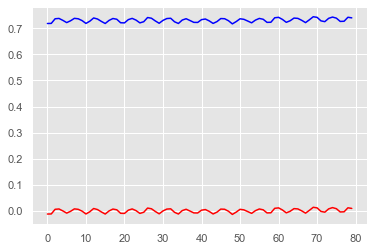

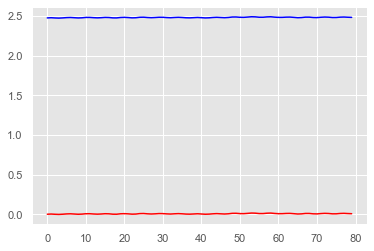

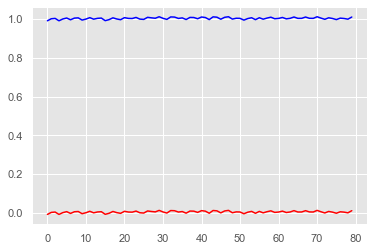

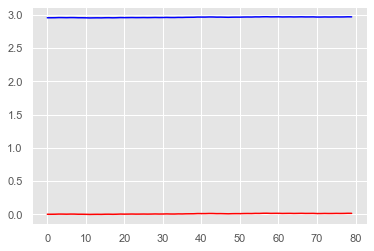

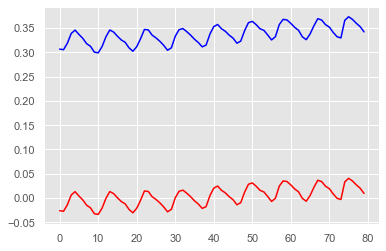

...

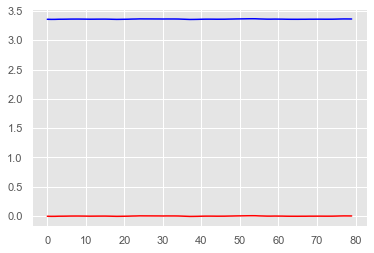

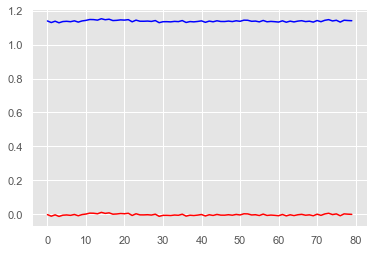

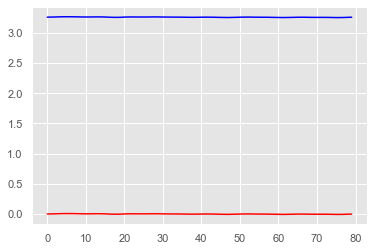

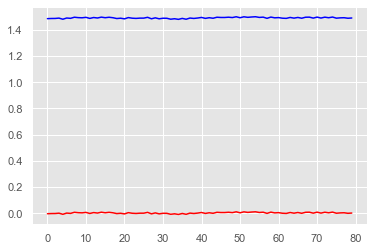

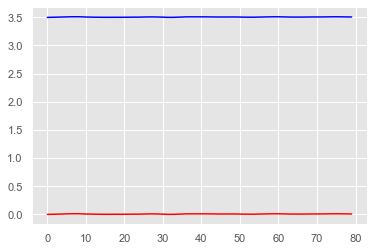

In [40]:
for i in nlobs_eventlist:
    out = nlfinallist[i]
    labeltim = notiml[nlindlist[i]]
    label = nolabl[nlindlist[i]]
    ind = out.index[out.observable_event > 0].tolist()[0]
    out['apparent_power'] = (out.apparent_power_S1 + out.apparent_power_S2 + out.apparent_power_S3)/1000
    out['mean_app_power'] = out.apparent_power.rolling(30).mean()
    data = out[lab_ind-20:lab_ind+60]
    data['norm_main_power'] = data.mains_power - data.before_mean.tolist()[0]
    data['norm_apparent_power'] = data.apparent_power - data.mean_app_power.tolist()[0]
    data = data[['mains_power', 'apparent_power', 'norm_main_power', 'norm_apparent_power']].values
    plt.plot(data[:, 0], color='blue')
    plt.plot(data[:, 2], color='red')
    plt.show()
    plt.plot(data[:, 1], color='blue')
    plt.plot(data[:, 3], color='red')
    plt.show()
    

In [14]:
len(finallist), len(datalist)

(37, 40)

In [15]:
len(nodatal), len(nlobs_eventlist), len(nlfinallist)

(310, 198, 291)

In [16]:
ldataset = list()
ltargetset = list()

for i in range(len(finallist)):
    out = finallist[i]
    labeltim = timelist[indlist[i]]
    label = labellist[indlist[i]]
    ind = out.index[out.label != 'no_event'].tolist()[0]
    out['apparent_power'] = (out.apparent_power_S1 + out.apparent_power_S2 + out.apparent_power_S3)/1000
    out['mean_app_power'] = out.apparent_power.rolling(30).mean()
    for lab_ind in range(ind-20, ind):
        data = out[lab_ind-20:lab_ind+60]
        data['norm_main_power'] = data.mains_power - data.before_mean.tolist()[0]
        data['norm_apparent_power'] = data.apparent_power - data.mean_app_power.tolist()[0]
        data = data[['mains_power', 'apparent_power', 'norm_main_power', 'norm_apparent_power']].values
        ldataset.append(data)
        ltargetset.append(label)
        
    

In [17]:
nldataset = list()
nltargetset = list()

for i in range(len(nlfinallist)):
    out = nlfinallist[i]
#     print(out.index)
#     continue
    labeltim = notiml[nlindlist[i]]
    label = nolabl[nlindlist[i]]
    ind = 2000
    out['apparent_power'] = (out.apparent_power_S1 + out.apparent_power_S2 + out.apparent_power_S3)/1000
    out['mean_app_power'] = out.apparent_power.rolling(30).mean()
    for lab_ind in range(ind-20, ind):
        data = out[lab_ind-20:lab_ind+60]
        data['norm_main_power'] = data.mains_power - data.before_mean.tolist()[0]
        data['norm_apparent_power'] = data.apparent_power - data.mean_app_power.tolist()[0]
        data = data[['mains_power', 'apparent_power', 'norm_main_power', 'norm_apparent_power']].values
        nldataset.append(data)
        nltargetset.append(label)
        
    

In [18]:
# i = 2
# out = finallist[i]
# labeltim = timelist[indlist[i]]
# label = labellist[indlist[i]]
# ind = out.index[out.label != 'no_event'].tolist()[0]

# lab_ind = 5 + ind
# out['apparent_power'] = out.apparent_power_S1 + out.apparent_power_S2 + out.apparent_power_S3
# out['mean_app_power'] = out.apparent_power.rolling(30).mean()
# data = out[lab_ind-20:lab_ind+60]
# data['norm_main_power'] = data.mains_power - data.before_mean.tolist()[0]
# data['norm_apparent_power'] = data.apparent_power - data.mean_app_power.tolist()[0]
# data = data[['mains_power', 'apparent_power', 'norm_main_power', 'norm_apparent_power']].values

In [19]:
dataset = ldataset + nldataset
targetset = ltargetset + nltargetset

xfinaltargetset3 = np.array(dataset)
yfinaltargetset3 = np.array(targetset)
truelabels = np.array(targetset)


In [20]:
# encode and transform labels 
encoder = LabelEncoder()
encoder.fit(targetset)
encoded_Y = encoder.transform(targetset)

# convert integers to dummy variables (i.e. one hot encoded)
dummy_y = np.zeros((encoded_Y.size, encoded_Y.max()+1))
dummy_y[np.arange(encoded_Y.size),encoded_Y] = 1

yfinaltargetset3 = dummy_y
xfinaltargetset3.shape, yfinaltargetset3.shape

((6560, 80, 4), (6560, 7))

In [21]:
LOOK_BACK=80
InceptionTime = nn.Sequential(
                    Reshape(out_shape=(4,LOOK_BACK)),
                    InceptionBlock(
                        in_channels=4, 
                        n_filters=32, 
                        kernel_sizes=[5,13,23],
                        bottleneck_channels=32,
                        use_residual=True,
                        activation=nn.ReLU()
                    ),
                    InceptionBlock(
                        in_channels=32*4, 
                        n_filters=32, 
                        kernel_sizes=[5,13,23],
                        bottleneck_channels=32,
                        use_residual=True,
                        activation=nn.ReLU()
                    ),
                    nn.AdaptiveMaxPool1d(output_size=1),
#     nn.AdaptiveMaxPool1d(output_size=1),
                    Flatten(out_features=32*4*1),
                    nn.Linear(in_features=4*32*1, out_features=7)
        )

In [22]:
# Source: https://stackoverflow.com/questions/50125844/how-to-standard-scale-a-3d-matrix/50134698
import numpy as np
from sklearn.base import TransformerMixin
from sklearn.preprocessing import StandardScaler


class NDStandardScaler(TransformerMixin):
    def __init__(self, **kwargs):
        self._scaler = StandardScaler(copy=True, **kwargs)
        self._orig_shape = None

    def fit(self, X, **kwargs):
        X = np.array(X)
        # Save the original shape to reshape the flattened X later
        # back to its original shape
        if len(X.shape) > 1:
            self._orig_shape = X.shape[1:]
        X = self._flatten(X)
        self._scaler.fit(X, **kwargs)
        return self

    def transform(self, X, **kwargs):
        X = np.array(X)
        X = self._flatten(X)
        X = self._scaler.transform(X, **kwargs)
        X = self._reshape(X)
        return X

    def _flatten(self, X):
        # Reshape X to <= 2 dimensions
        if len(X.shape) > 2:
            n_dims = np.prod(self._orig_shape)
            X = X.reshape(-1, n_dims)
        return X

    def _reshape(self, X):
        # Reshape X back to it's original shape
        if len(X.shape) >= 2:
            X = X.reshape(-1, *self._orig_shape)
        return X

In [26]:
xall_data = xfinaltargetset3
yall_data = yfinaltargetset3

np.save('Data/xall_data_PL3.npy', xall_data)
np.save('Data/yall_data_PL3.npy', yall_data)

# xll_data = np.load('Data/xall_data_PL3.npy')
# yll_data = np.load('Data/yall_data_PL3.npy')

nx_train, nx_test, ny_train, ny_test = train_test_split(xall_data, yall_data, test_size=0.33, random_state=42)

scaler = NDStandardScaler()
scaler.fit(nx_train)

nx_train = scaler.transform(nx_train)
nx_test = scaler.transform(nx_test)

nx_train.shape, ny_train.shape

((4395, 80, 4), (4395, 7))

In [27]:
tensor_x = torch.Tensor(nx_train) # transform to torch tensor
tensor_y = torch.Tensor(ny_train)


# X_test = scaler.transform(tensor_y)

dataset = TensorDataset(tensor_x,tensor_y) # create your datset
trainloader = DataLoader(dataset,batch_size=512, shuffle=True) # create your dataloader


In [30]:
torch.cuda.empty_cache()



In [41]:
net=InceptionTime
import torch.optim as optim
import math
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# for epoch in range(epochs):
#     for inputs, labels in trainloader:
#         inputs, labels = inputs.to(device), labels.to(device)
device = "cuda"
net.to(device)
print(device)
# start_lr = 1e-7
# end_lr = .1
epochs=100

optimizer = optim.Adam(net.parameters(), lr=0.002)
# lr_lambda = lambda x: math.exp(x * math.log(end_lr / start_lr) / (epochs * len(trainloader.dataset)))
# scheduler = torch.optim.lr_scheduler.LambdaLR(optimizer, lr_lambda)

criterion = nn.BCEWithLogitsLoss()
# weight = torch.tensor([10.0, 10.0, 10.0, 10.0, 1.0])
# itera=0
# lr_find_lr=[]
# lr_find_loss=[]
# smoothing=-1e-7
for epoch in range(epochs):  # loop over the dataset multiple times
#     print(epoch)
    running_loss = 0.0
    for i, data in enumerate(trainloader, 0):
        # get the inputs; data is a list of [inputs, labels]
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
#         weight = weight.to(device)

        # zero the parameter gradients
        optimizer.zero_grad()

        # forward + backward + optimize
        outputs = net(inputs)
#         print(outputs)
        loss = criterion(outputs, labels)
        loss = loss
        loss = loss.mean()
        loss.backward()
        optimizer.step()

        # print statistics
        running_loss += loss.item()
#         if i % 2000 == 1999:    # print every 2000 mini-batches
        print('[%d, %5d] loss: %.3f' % (epoch + 1, i + 1, running_loss))
        running_loss = 0.0
        
#         # Update LR
#         scheduler.step()
#         lr_step = optimizer.state_dict()["param_groups"][0]["lr"]
#         lr_find_lr.append(lr_step)
        
#             # smooth the loss
#         if itera==0:
#             lr_find_loss.append(loss)
#         else:
#             loss = smoothing  * loss + (1 - smoothing) * lr_find_loss[-1]
#             lr_find_loss.append(loss)

#         itera += 1

cuda
[1,     1] loss: 0.016
[1,     2] loss: 0.007
[1,     3] loss: 0.014
[1,     4] loss: 0.004
[1,     5] loss: 0.022
[1,     6] loss: 0.008
[1,     7] loss: 0.008
[1,     8] loss: 0.005
[1,     9] loss: 0.008
[2,     1] loss: 0.005
[2,     2] loss: 0.005
[2,     3] loss: 0.004
[2,     4] loss: 0.006
[2,     5] loss: 0.005
[2,     6] loss: 0.007
[2,     7] loss: 0.008
[2,     8] loss: 0.006
[2,     9] loss: 0.006
[3,     1] loss: 0.002
[3,     2] loss: 0.006
[3,     3] loss: 0.006
[3,     4] loss: 0.004
[3,     5] loss: 0.004
[3,     6] loss: 0.005
[3,     7] loss: 0.006
[3,     8] loss: 0.006
[3,     9] loss: 0.006
[4,     1] loss: 0.006
[4,     2] loss: 0.002
[4,     3] loss: 0.003
[4,     4] loss: 0.005
[4,     5] loss: 0.005
[4,     6] loss: 0.006
[4,     7] loss: 0.004
[4,     8] loss: 0.003
[4,     9] loss: 0.004
[5,     1] loss: 0.004
[5,     2] loss: 0.003
[5,     3] loss: 0.002
[5,     4] loss: 0.006
[5,     5] loss: 0.004
[5,     6] loss: 0.006
[5,     7] loss: 0.006
[5,   

[39,     4] loss: 0.003
[39,     5] loss: 0.003
[39,     6] loss: 0.002
[39,     7] loss: 0.003
[39,     8] loss: 0.002
[39,     9] loss: 0.003
[40,     1] loss: 0.002
[40,     2] loss: 0.003
[40,     3] loss: 0.001
[40,     4] loss: 0.006
[40,     5] loss: 0.003
[40,     6] loss: 0.003
[40,     7] loss: 0.002
[40,     8] loss: 0.002
[40,     9] loss: 0.006
[41,     1] loss: 0.004
[41,     2] loss: 0.002
[41,     3] loss: 0.003
[41,     4] loss: 0.004
[41,     5] loss: 0.007
[41,     6] loss: 0.003
[41,     7] loss: 0.001
[41,     8] loss: 0.002
[41,     9] loss: 0.002
[42,     1] loss: 0.004
[42,     2] loss: 0.009
[42,     3] loss: 0.004
[42,     4] loss: 0.003
[42,     5] loss: 0.002
[42,     6] loss: 0.003
[42,     7] loss: 0.006
[42,     8] loss: 0.004
[42,     9] loss: 0.004
[43,     1] loss: 0.004
[43,     2] loss: 0.002
[43,     3] loss: 0.003
[43,     4] loss: 0.004
[43,     5] loss: 0.003
[43,     6] loss: 0.002
[43,     7] loss: 0.005
[43,     8] loss: 0.004
[43,     9] loss

[77,     3] loss: 0.003
[77,     4] loss: 0.001
[77,     5] loss: 0.000
[77,     6] loss: 0.007
[77,     7] loss: 0.002
[77,     8] loss: 0.001
[77,     9] loss: 0.001
[78,     1] loss: 0.002
[78,     2] loss: 0.003
[78,     3] loss: 0.001
[78,     4] loss: 0.003
[78,     5] loss: 0.003
[78,     6] loss: 0.003
[78,     7] loss: 0.001
[78,     8] loss: 0.003
[78,     9] loss: 0.001
[79,     1] loss: 0.002
[79,     2] loss: 0.003
[79,     3] loss: 0.001
[79,     4] loss: 0.002
[79,     5] loss: 0.001
[79,     6] loss: 0.002
[79,     7] loss: 0.002
[79,     8] loss: 0.001
[79,     9] loss: 0.001
[80,     1] loss: 0.002
[80,     2] loss: 0.001
[80,     3] loss: 0.001
[80,     4] loss: 0.002
[80,     5] loss: 0.001
[80,     6] loss: 0.001
[80,     7] loss: 0.002
[80,     8] loss: 0.000
[80,     9] loss: 0.001
[81,     1] loss: 0.001
[81,     2] loss: 0.001
[81,     3] loss: 0.002
[81,     4] loss: 0.001
[81,     5] loss: 0.002
[81,     6] loss: 0.002
[81,     7] loss: 0.003
[81,     8] loss

In [42]:
def calculate_metrics(cf):
    for i in range(len(cf)):
        print('For label ', encoder.classes_[i])
        true_positive = cf[i, i]
        false_positive = sum(cf[:, i]) - true_positive
        false_negative = sum(cf[i, :]) - cf[i, i]
        true_negative = sum(sum(cf)) - false_positive - false_negative - true_positive
        print('tp: ', true_positive, ' fp: ', false_positive, ' fn: ', false_negative, ' tn: ', true_negative)
    return



In [43]:
tensor_x = torch.Tensor(nx_train) # transform to torch tensor
tensor_y = torch.Tensor(nx_train)

with torch.no_grad():
    inputs, labels = tensor_x.to(device), tensor_y.to(device)
    outputs = net(inputs)
    outputs = outputs.detach().cpu().numpy()
    
ylab = np.argmax(ny_train, axis=1)
pred = np.argmax(outputs, axis=1)
print(f1_score(y_true=ylab, y_pred=pred,average="macro"))
print(accuracy_score(y_true=ylab, y_pred=pred))
cf1 = confusion_matrix(y_true=ylab, y_pred=pred) # x_axis = predicted, y_axis = ground_truth
print(cf1)
encoder.classes_

calculate_metrics(cf1)

0.9932860457096935
0.9981797497155859
[[  67    0    0    0    0    0    0]
 [   0   89    0    0    0    0    0]
 [   0    0   78    0    0    0    0]
 [   0    0    0   62    0    0    0]
 [   0    0    0    0   83    0    3]
 [   0    0    0    0    0   93    0]
 [   0    0    0    0    5    0 3915]]
For label  AC_OFF
tp:  67  fp:  0  fn:  0  tn:  4328
For label  AC_ON
tp:  89  fp:  0  fn:  0  tn:  4306
For label  Geyser_OFF
tp:  78  fp:  0  fn:  0  tn:  4317
For label  Geyser_ON
tp:  62  fp:  0  fn:  0  tn:  4333
For label  Microwave_OFF
tp:  83  fp:  5  fn:  3  tn:  4304
For label  Microwave_ON
tp:  93  fp:  0  fn:  0  tn:  4302
For label  no_label
tp:  3915  fp:  3  fn:  5  tn:  472


In [44]:
tensor_x = torch.Tensor(nx_test) # transform to torch tensor
tensor_y = torch.Tensor(ny_test)

with torch.no_grad():
    inputs, labels = tensor_x.to(device), tensor_y.to(device)
    outputs = net(inputs)
    outputs = outputs.detach().cpu().numpy()
    
ylab = np.argmax(ny_test, axis=1)
pred = np.argmax(outputs, axis=1)
print(f1_score(y_true=ylab, y_pred=pred,average="macro"))
print(accuracy_score(y_true=ylab, y_pred=pred))
cf1 = confusion_matrix(y_true=ylab, y_pred=pred) # x_axis = predicted, y_axis = ground_truth
print(cf1)
encoder.classes_

calculate_metrics(cf1)

0.9706046408990241
0.9939953810623556
[[  33    0    0    0    0    0    0]
 [   0   50    1    0    0    0    0]
 [   0    0   42    0    0    0    0]
 [   0    0    0   38    0    0    0]
 [   0    0    0    0   49    0    5]
 [   4    0    0    0    0   43    0]
 [   0    0    2    0    1    0 1897]]
For label  AC_OFF
tp:  33  fp:  4  fn:  0  tn:  2128
For label  AC_ON
tp:  50  fp:  0  fn:  1  tn:  2114
For label  Geyser_OFF
tp:  42  fp:  3  fn:  0  tn:  2120
For label  Geyser_ON
tp:  38  fp:  0  fn:  0  tn:  2127
For label  Microwave_OFF
tp:  49  fp:  1  fn:  5  tn:  2110
For label  Microwave_ON
tp:  43  fp:  0  fn:  4  tn:  2118
For label  no_label
tp:  1897  fp:  5  fn:  3  tn:  260


In [45]:
test_x = torch.Tensor(scaler.transform(xfinaltargetset3)) # transform to torch tensor
test_y = torch.Tensor(yfinaltargetset3)

testset = TensorDataset(test_x, test_y) # create your datset
testloader = DataLoader(testset,batch_size=512*20) # create your dataloader

In [46]:
preds = []
with torch.no_grad():
    for data in testloader:
        inputs, labels = data
        inputs, labels = inputs.to(device), labels.to(device)
        # calculate outputs by running images through the network
        outputs = net(inputs)
        # the class with the highest energy is what we choose as prediction
        preds.append(np.argmax(outputs.detach().cpu().numpy(), axis=1))

In [47]:
final3truepreds = np.argmax(test_y.detach().cpu().numpy(), axis=1)
finaltruepreds = encoder.inverse_transform(final3truepreds.squeeze())

truepreds = encoder.inverse_transform(np.array(preds).squeeze())
for tp, tl in zip(truepreds, finaltruepreds):
    print(tp, tl)

AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_ON AC_ON
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
AC_OFF AC_OFF
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON Microwave_ON
Microwave_ON

no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label n

no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label n

no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label n

no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label n

no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label no_label
no_label n

In [48]:
ylab = truelabels
pred = truepreds
print(f1_score(y_true=ylab, y_pred=pred,average="macro"))
print(accuracy_score(y_true=ylab, y_pred=pred))
cf1 = confusion_matrix(y_true=ylab, y_pred=pred) # x_axis = predicted, y_axis = ground_truth
print(cf1)
encoder.classes_

0.9884415863288376
0.9972560975609757
[[ 100    0    0    0    0    0    0]
 [   0  139    1    0    0    0    0]
 [   0    0  120    0    0    0    0]
 [   0    0    0  100    0    0    0]
 [   0    0    0    0  133    0    7]
 [   2    0    0    0    0  138    0]
 [   0    0    2    0    6    0 5812]]


array(['AC_OFF', 'AC_ON', 'Geyser_OFF', 'Geyser_ON', 'Microwave_OFF',
       'Microwave_ON', 'no_label'], dtype='<U13')

In [49]:
calculate_metrics(cf1)

For label  AC_OFF
tp:  100  fp:  2  fn:  0  tn:  6458
For label  AC_ON
tp:  139  fp:  0  fn:  1  tn:  6420
For label  Geyser_OFF
tp:  120  fp:  3  fn:  0  tn:  6437
For label  Geyser_ON
tp:  100  fp:  0  fn:  0  tn:  6460
For label  Microwave_OFF
tp:  133  fp:  6  fn:  7  tn:  6414
For label  Microwave_ON
tp:  138  fp:  0  fn:  2  tn:  6420
For label  no_label
tp:  5812  fp:  7  fn:  8  tn:  733


In [35]:
label_list = []
pred_list = []

for ind in ind_obser_events:
    st = max(0, ind-10)
    en = min(ind+10, len(tr_data))
    focus_data = tr_data[['logged_on_local', 'label', 'observable_event', 'Preds']]
    focus_data = focus_data[st:en]
    focus_data['Preds'] = focus_data.apply(lambda row: encoder_label[row.Preds], axis=1)
    print('Indice is: ', ind)
    fvc = focus_data.label.value_counts()
    pvc = focus_data.Preds.value_counts()
    print('FVC')
    print(fvc)
    print('PVC')
    print(pvc)
    print(" ")
    label_list.append(fvc)
    pred_list.append(pvc)

Indice is:  7242
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  82161
FVC
no_event    20
Name: label, dtype: int64
PVC
Refrigerator_ON    20
Name: Preds, dtype: int64
 
Indice is:  82197
FVC
Refrigerator_ON    18
no_event            2
Name: label, dtype: int64
PVC
Refrigerator_ON    17
Geyser_ON           3
Name: Preds, dtype: int64
 
Indice is:  92538
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  92573
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event           15
Refrigerator_ON     5
Name: Preds, dtype: int64
 
Indice is:  93076
FVC
no_event    20
Name: label, dtype: int64
PVC
Refrigerator_ON    20
Name: Preds, dtype: int64
 
Indice is:  112522
FVC
Refrigerator_OFF    15
no_event             5
Name: label, dtype: int64
PVC
Refrigerator_ON    12
no_event            6
Geyser_ON           2
Name: Preds, dtype: int64
 
Indice is:  188955
FVC
no_event    20
Name: lab

Indice is:  939613
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  945415
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  945833
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  947175
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  947354
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  948080
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  965255
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  965873
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  982634
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
I

Indice is:  1345904
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event           16
Refrigerator_ON     4
Name: Preds, dtype: int64
 
Indice is:  1346187
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1346641
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1346913
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1348757
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1349002
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1349087
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1349320
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  1352595
FVC
no_event    20
Name: label, dtype: int64
PVC
no_eve

Indice is:  2356386
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2378065
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2379488
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2387792
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2389712
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2394809
FVC
no_event            17
Refrigerator_OFF     3
Name: label, dtype: int64
PVC
no_event           18
Refrigerator_ON     2
Name: Preds, dtype: int64
 
Indice is:  2396442
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event     19
Geyser_ON     1
Name: Preds, dtype: int64
 
Indice is:  2396698
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2409450
FVC
no_

Indice is:  2858421
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2858456
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2858647
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2858850
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2859046
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2859246
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2859439
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2859641
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2859833
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  2866427
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2866533
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2866628
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2866730
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2866827
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2867156
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2867359
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2867548
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2867595
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  2877524
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2877649
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2877843
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2877968
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2878162
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2878287
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2878482
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2878606
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2878757
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  2896283
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2896386
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2896546
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2896601
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2896706
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2918813
FVC
no_event    20
Name: label, dtype: int64
PVC
Refrigerator_ON    20
Name: Preds, dtype: int64
 
Indice is:  2938214
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  2938512
FVC
no_event    20
Name: label, dtype: int64
PVC
Refrigerator_ON    20
Name: Preds, dtype: int64
 
Indice is:  2951172
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: 

no_event    20
Name: Preds, dtype: int64
 
Indice is:  3600847
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3631270
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3725254
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3755107
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3761951
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3762051
FVC
no_event    20
Name: label, dtype: int64
PVC
Refrigerator_ON    20
Name: Preds, dtype: int64
 
Indice is:  3850798
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3880340
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  3945155
FVC
no_event    20
Name: label, dt

Indice is:  4553954
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4576785
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4596144
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4598210
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4645041
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4688143
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4688343
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4688467
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4691914
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  4770030
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4770131
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4770224
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771000
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771205
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771391
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771437
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771563
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4771795
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  4778980
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779052
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779196
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779385
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779433
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779530
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779737
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4779927
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4780041
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Name: Preds, dtype: int64
 
Indice is:  4821199
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821225
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821315
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821521
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821544
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821721
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821731
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821797
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  4821902
FVC
no_event    20
Name: label, dtype: int64
PVC
no_even

Indice is:  5668921
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5710409
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5710530
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5710852
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5711818
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5726314
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5740784
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5741236
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  5742482
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

Indice is:  6396084
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6396185
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6396281
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6396379
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6397096
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6397308
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6397492
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6397518
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: int64
 
Indice is:  6397731
FVC
no_event    20
Name: label, dtype: int64
PVC
no_event    20
Name: Preds, dtype: 

no_event no_event 2


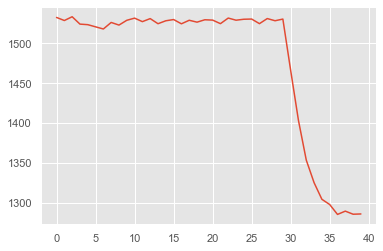

no_event Refrigerator_ON 1


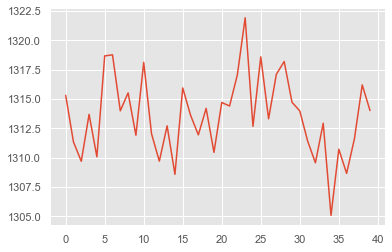

Refrigerator_ON Refrigerator_ON 1


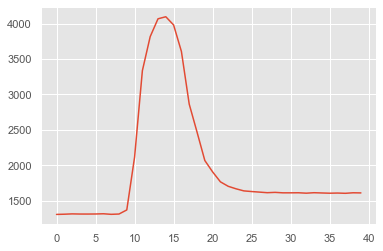

no_event no_event 1


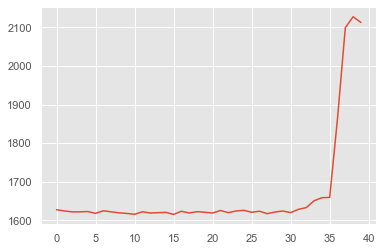

no_event Refrigerator_ON 1


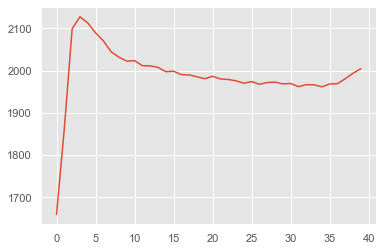

no_event Refrigerator_ON 2


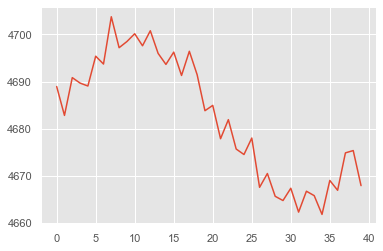

Refrigerator_OFF Refrigerator_ON 2


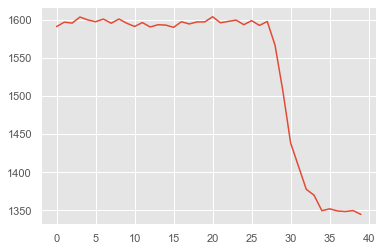

no_event no_event 1


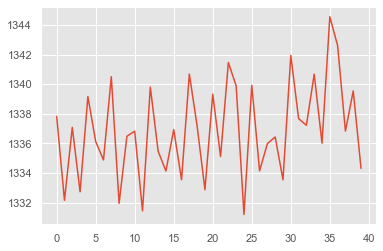

Refrigerator_OFF Refrigerator_ON 2


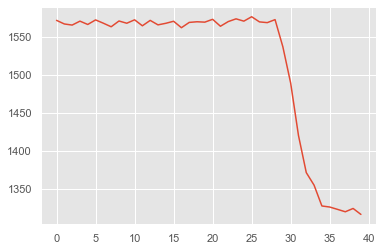

no_event no_event 2


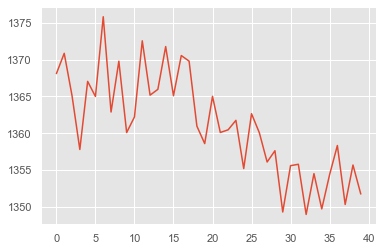

no_event no_event 2


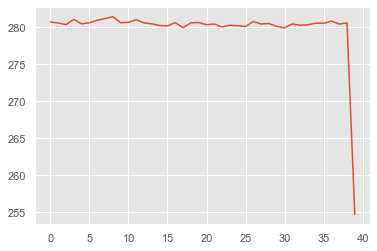

no_event no_event 2


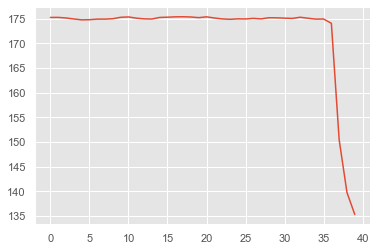

no_event no_event 1


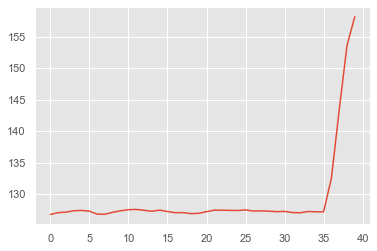

no_event no_event 2


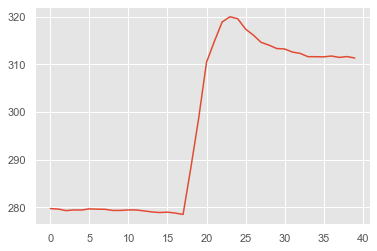

no_event no_event 2


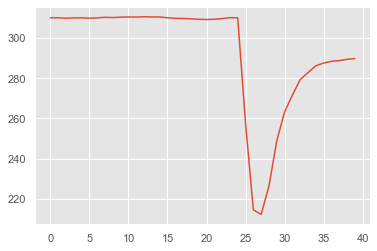

no_event no_event 1


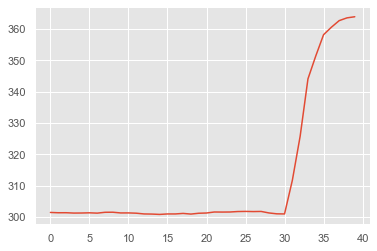

no_event no_event 2


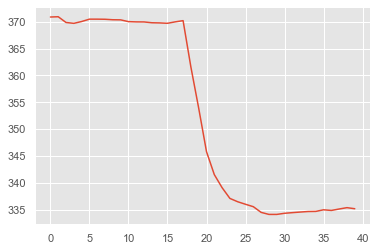

no_event no_event 2


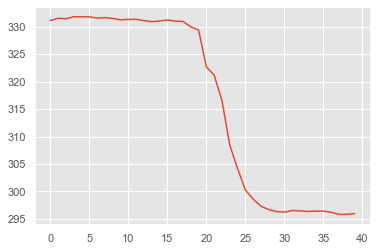

no_event no_event 1


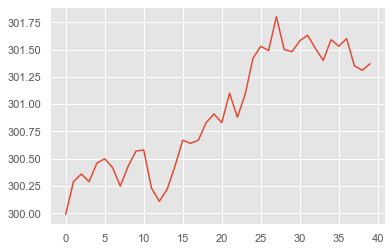

no_event Refrigerator_ON 2


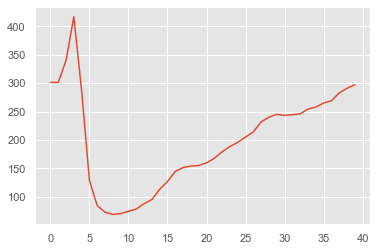

no_event no_event 1


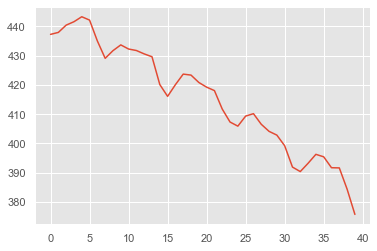

no_event no_event 1


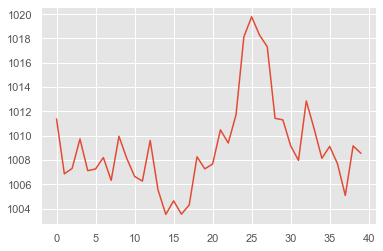

no_event no_event 2


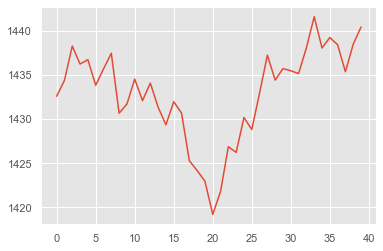

no_event no_event 2


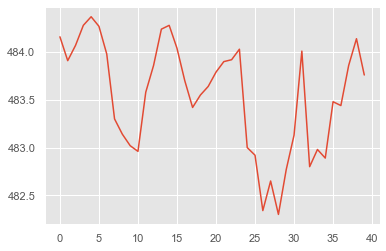

no_event no_event 1


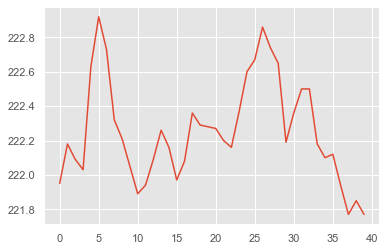

no_event no_event 2


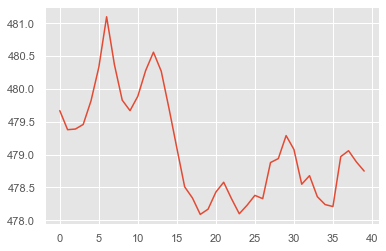

no_event no_event 2


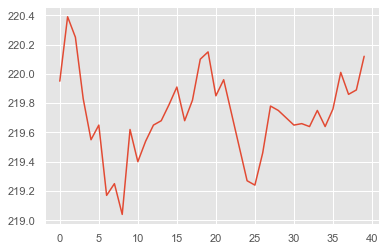

no_event no_event 1


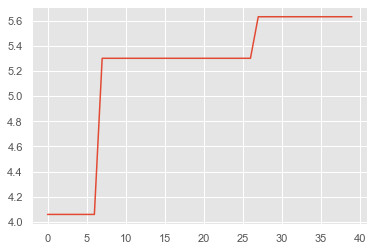

no_event no_event 2


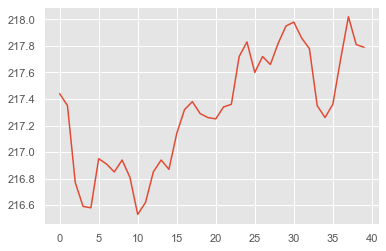

no_event no_event 1


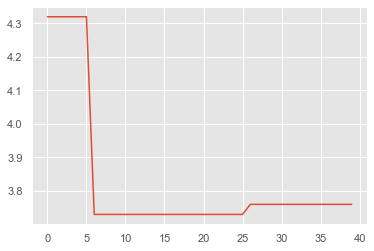

no_event no_event 1


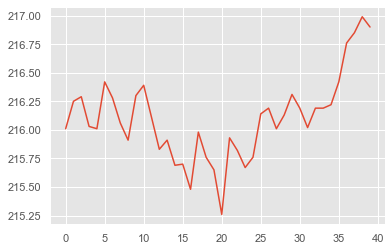

no_event no_event 2


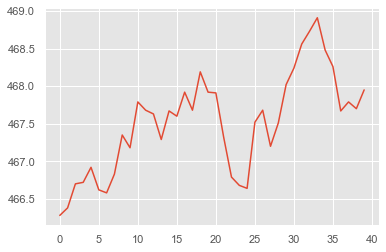

no_event no_event 1


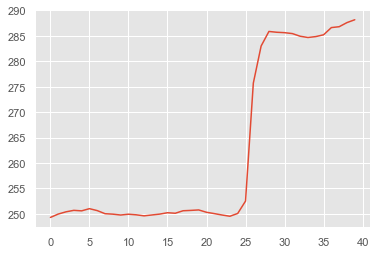

no_event no_event 1


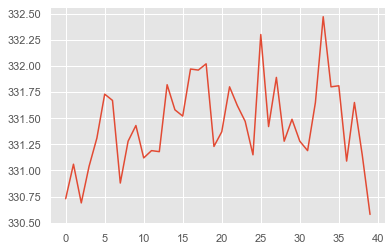

no_event no_event 2


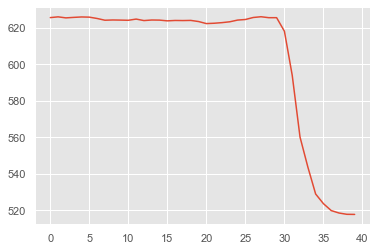

no_event no_event 1


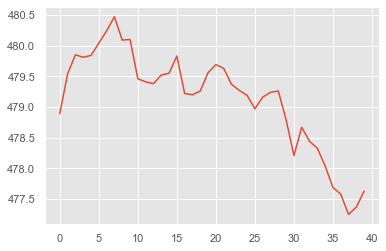

no_event Geyser_OFF 1


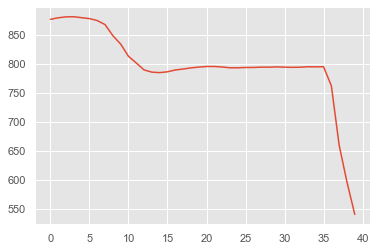

no_event no_event 1


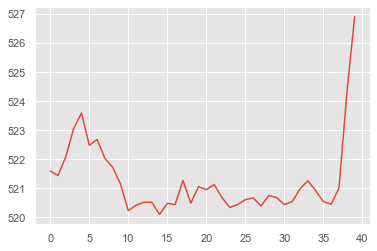

no_event no_event 2


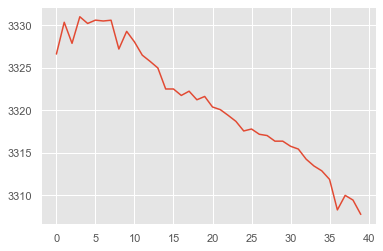

no_event no_event 2


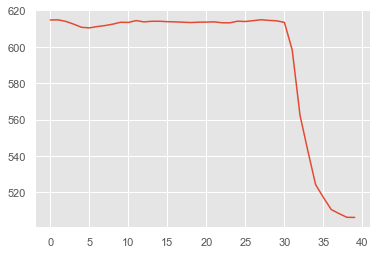

no_event no_event 2


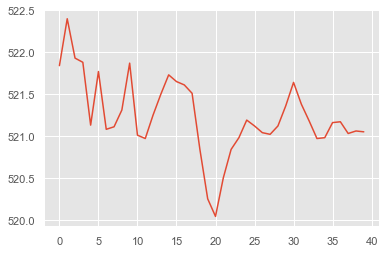

no_event no_event 1


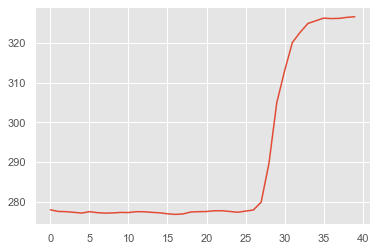

no_event no_event 1


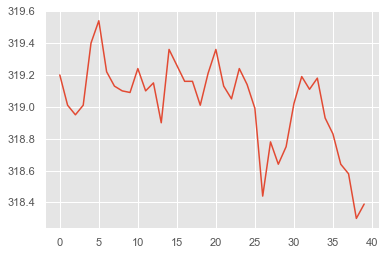

no_event no_event 2


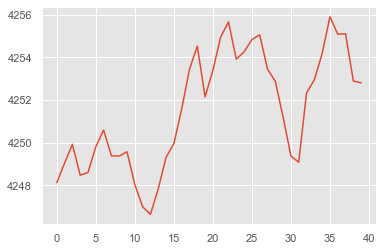

no_event no_event 1


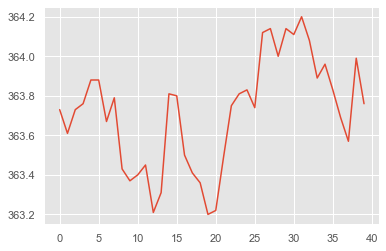

no_event no_event 2


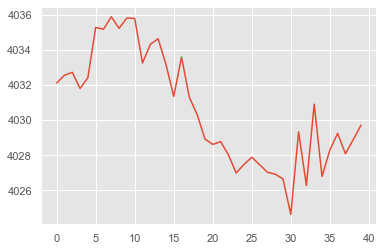

no_event no_event 1


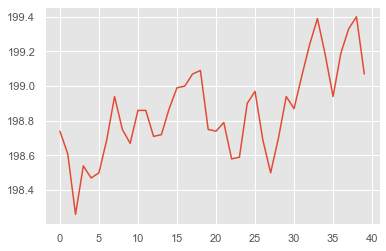

no_event no_event 2


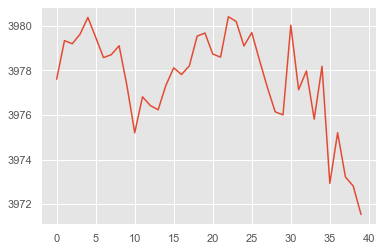

no_event no_event 1


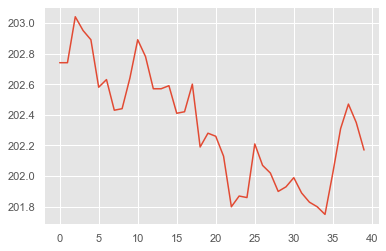

no_event no_event 2


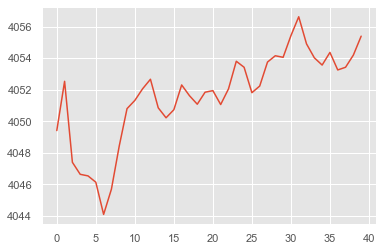

no_event no_event 1


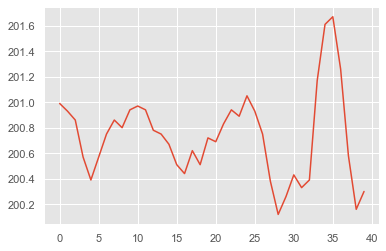

no_event no_event 1


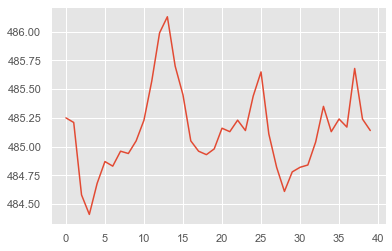

no_event no_event 2


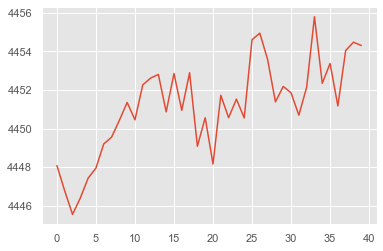

no_event no_event 2


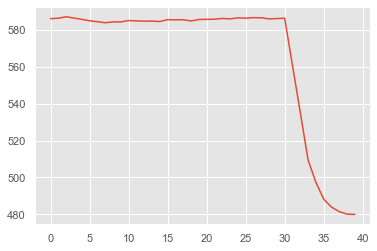

no_event no_event 2


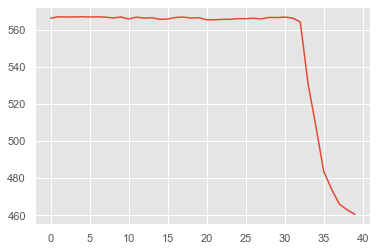

no_event no_event 2


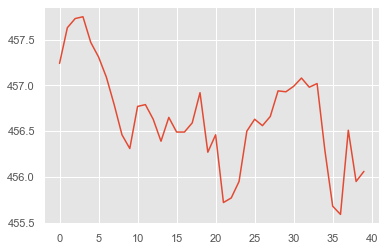

no_event no_event 2


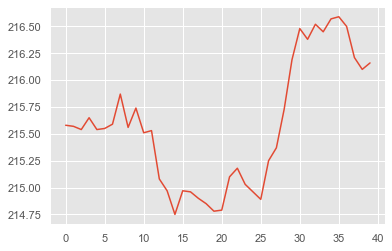

no_event no_event 1


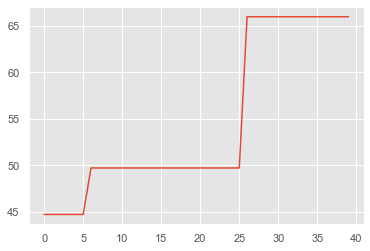

no_event Refrigerator_ON 1


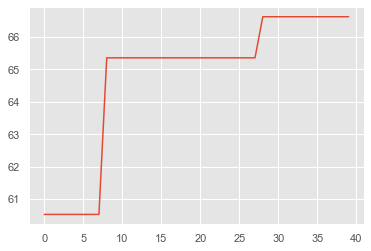

no_event no_event 1


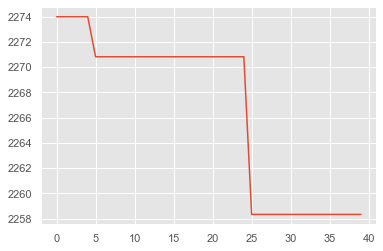

no_event no_event 1


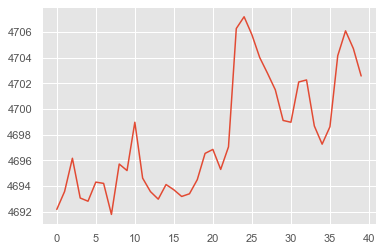

no_event Geyser_OFF 1


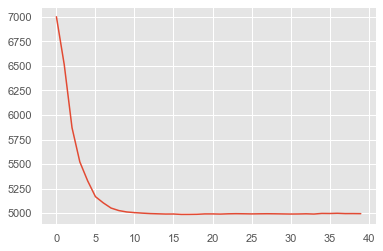

no_event no_event 2


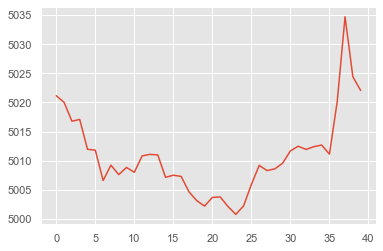

no_event no_event 2


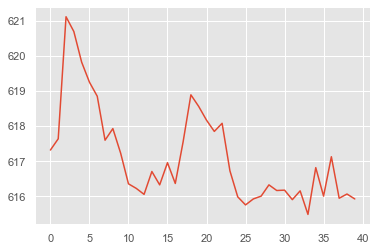

no_event no_event 1


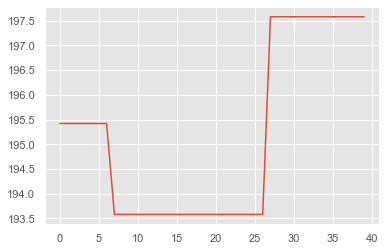

no_event no_event 2


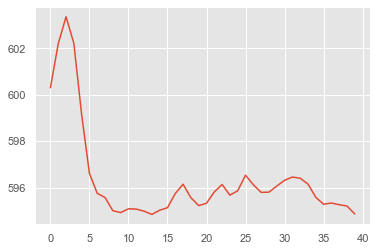

no_event no_event 1


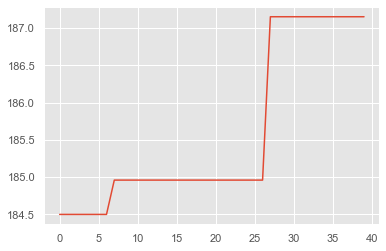

no_event no_event 2


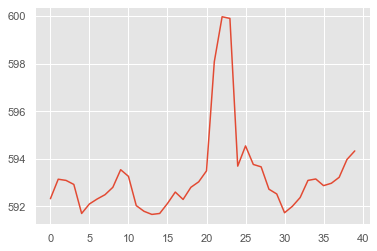

no_event no_event 1


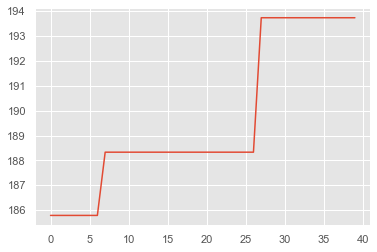

no_event no_event 2


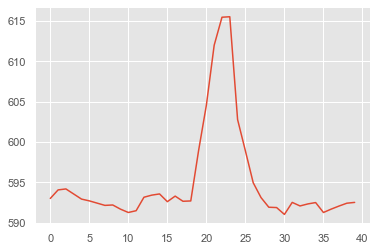

no_event no_event 1


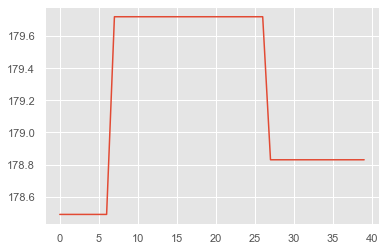

no_event no_event 2


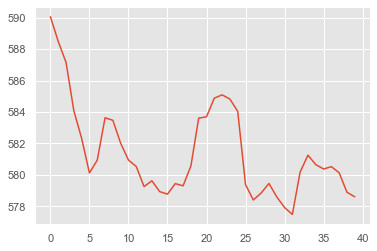

no_event no_event 1


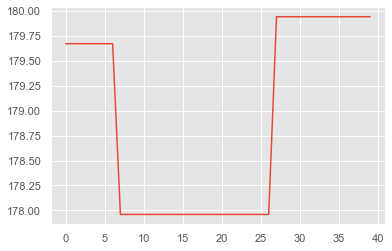

no_event no_event 2


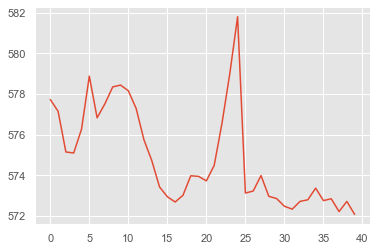

no_event no_event 1


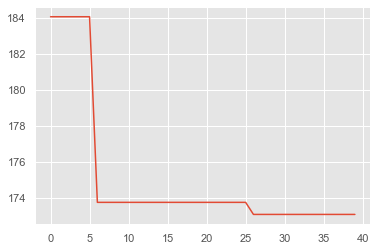

no_event no_event 2


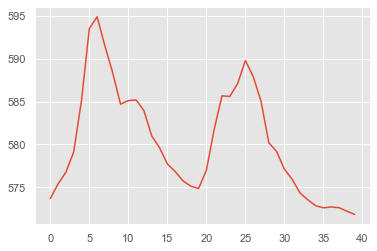

no_event no_event 2


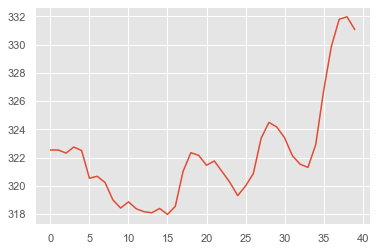

no_event no_event 1


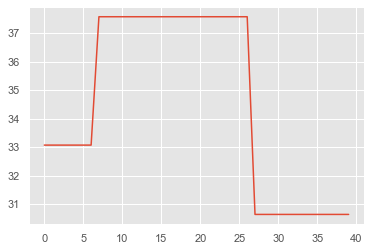

no_event no_event 2


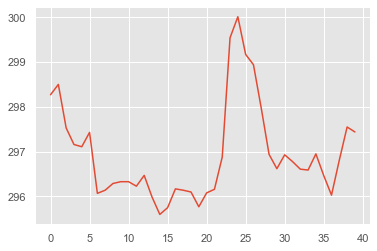

no_event no_event 1


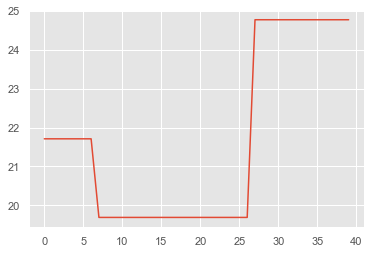

no_event no_event 2


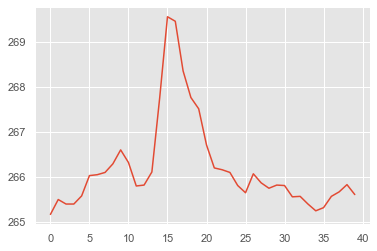

no_event no_event 1


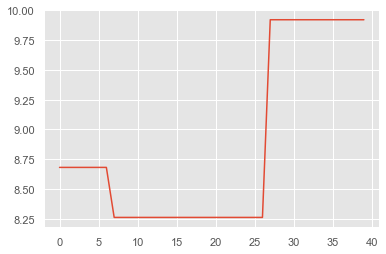

no_event no_event 1


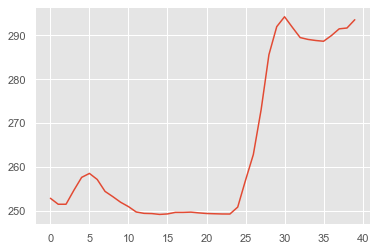

no_event no_event 1


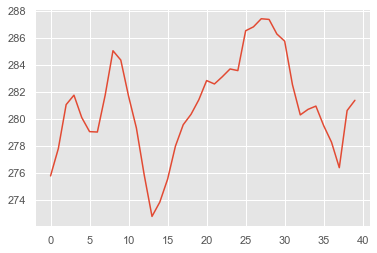

no_event no_event 1


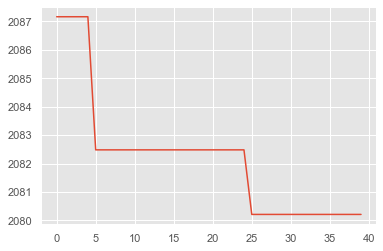

no_event no_event 2


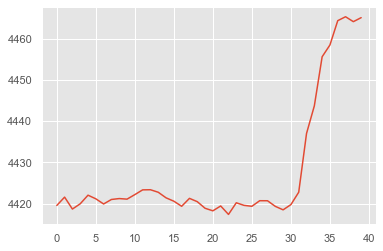

no_event no_event 2


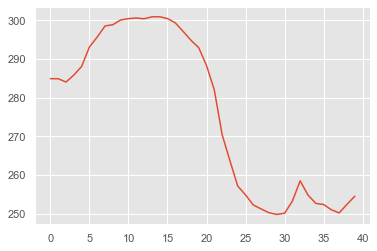

no_event no_event 2


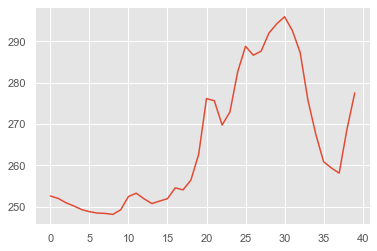

no_event no_event 1


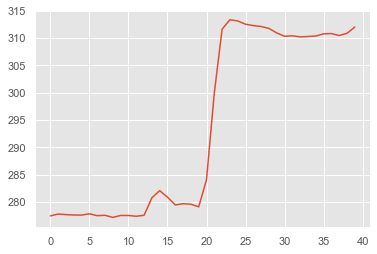

no_event no_event 2


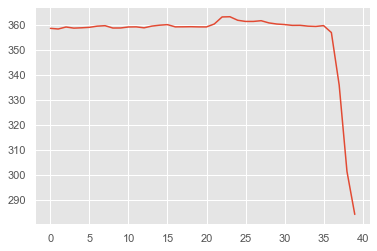

no_event no_event 2


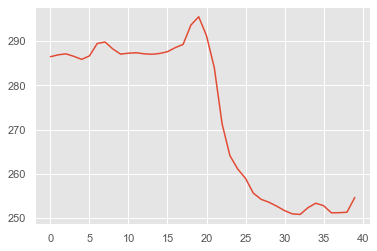

no_event no_event 2


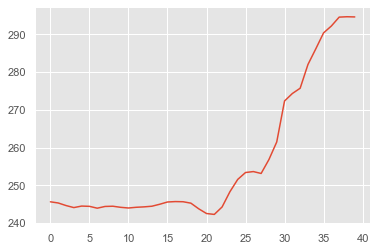

no_event no_event 1


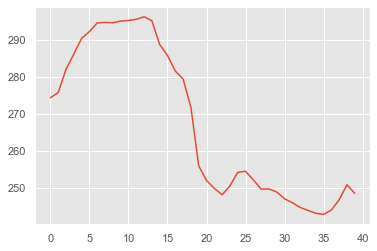

no_event no_event 1


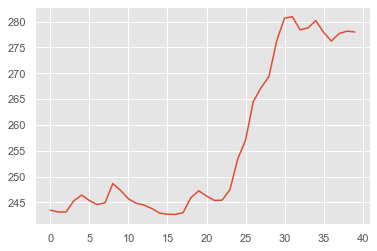

no_event no_event 1


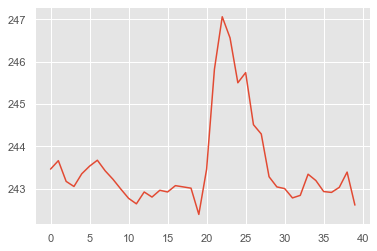

no_event no_event 2


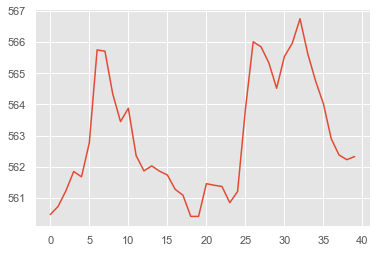

no_event no_event 2


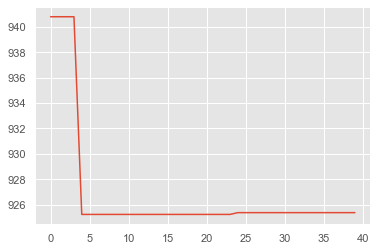

no_event no_event 1


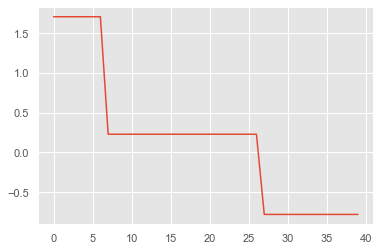

no_event no_event 1


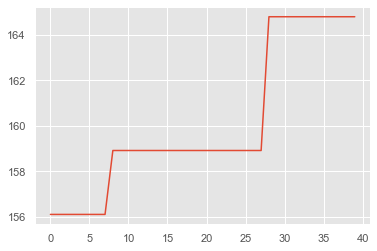

no_event no_event 1


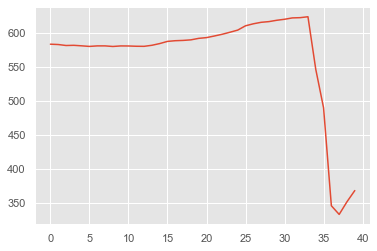

no_event Geyser_ON 1


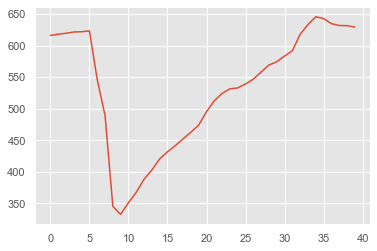

no_event no_event 1


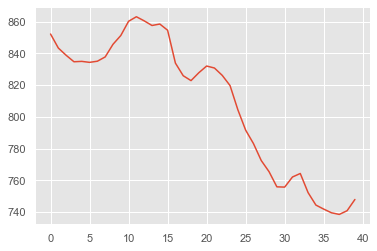

no_event no_event 2


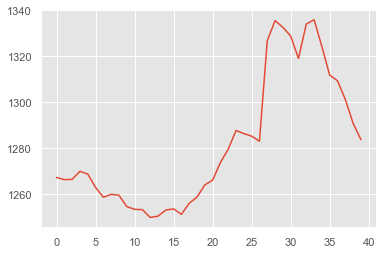

no_event no_event 2


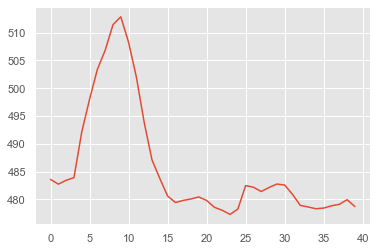

no_event no_event 2


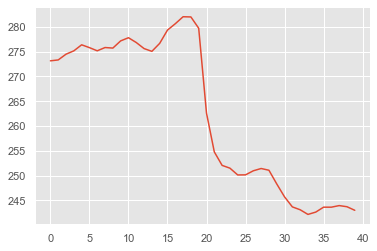

no_event no_event 2


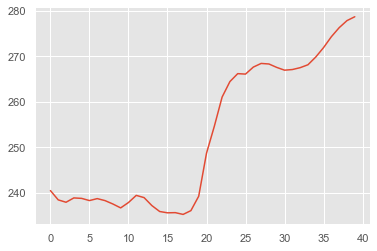

no_event no_event 1


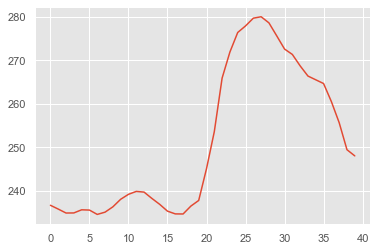

no_event no_event 1


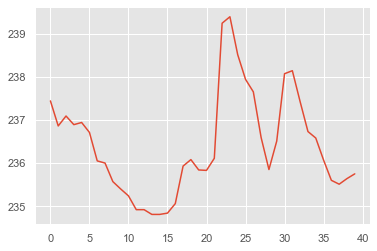

no_event no_event 2


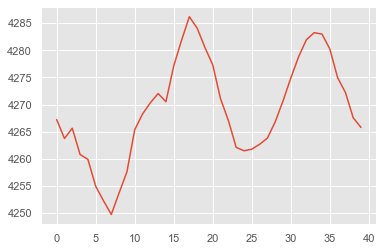

no_event no_event 1


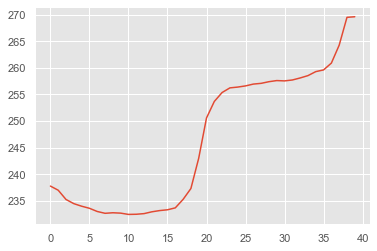

no_event no_event 1


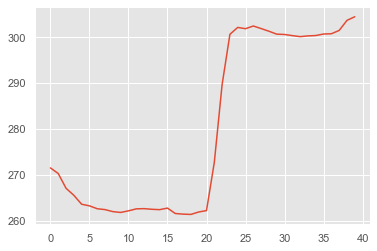

no_event no_event 2


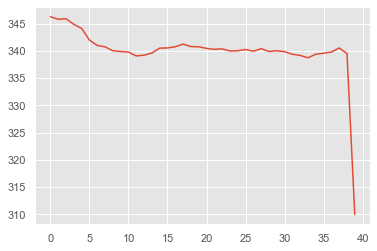

no_event no_event 2


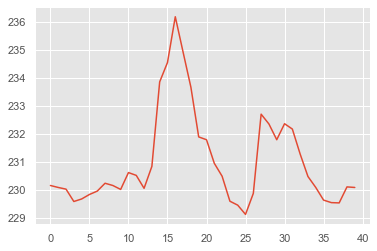

no_event no_event 1


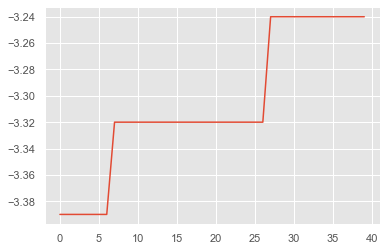

no_event no_event 1


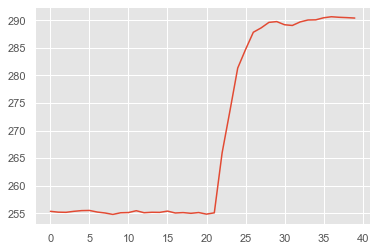

no_event no_event 1


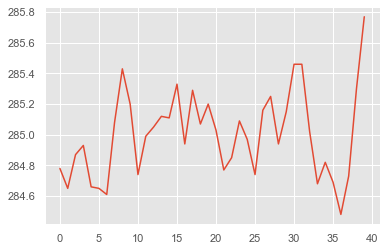

no_event no_event 2


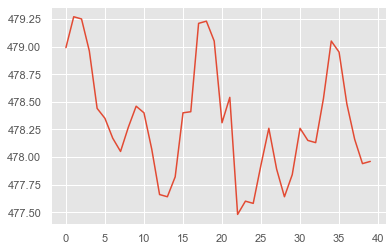

no_event no_event 1


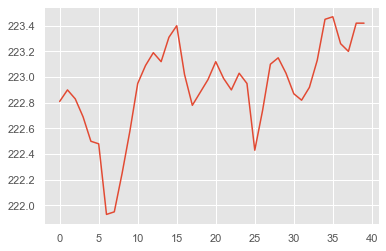

no_event no_event 2


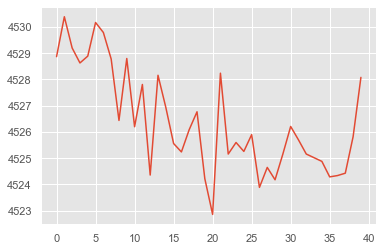

no_event no_event 1


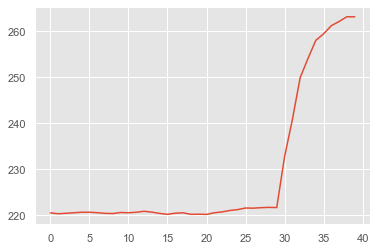

no_event no_event 1


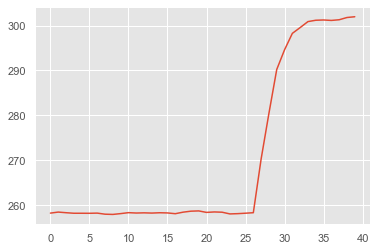

no_event no_event 1


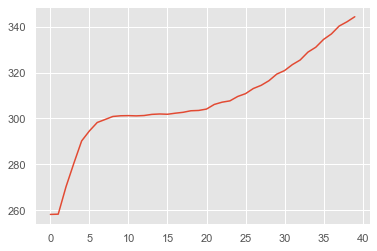

no_event Refrigerator_ON 1


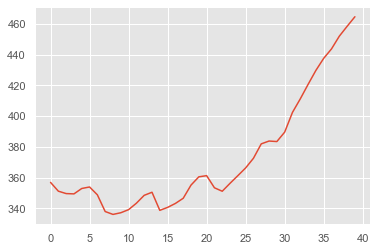

no_event no_event 1


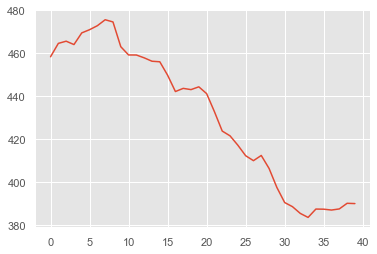

no_event no_event 2


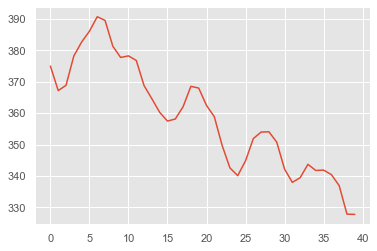

no_event no_event 2


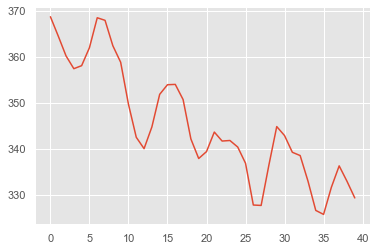

no_event no_event 2


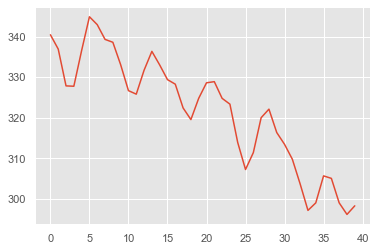

no_event no_event 2


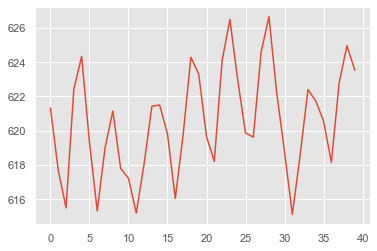

no_event no_event 1


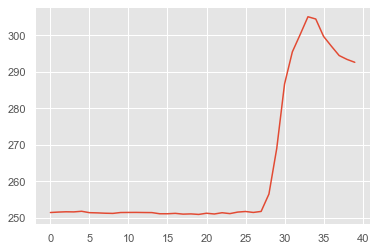

no_event no_event 1


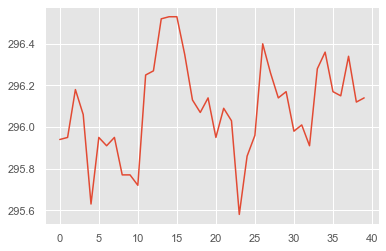

no_event no_event 2


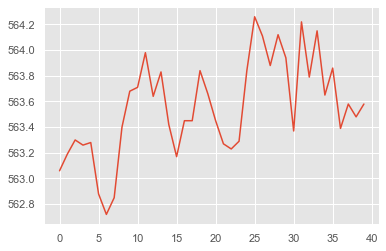

no_event no_event 1


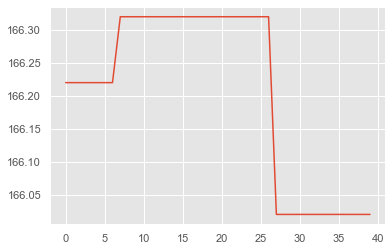

no_event no_event 2


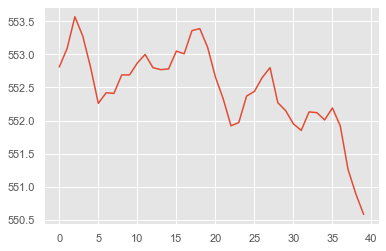

no_event no_event 1


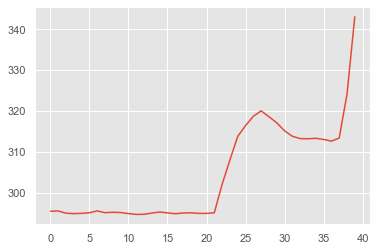

no_event no_event 1


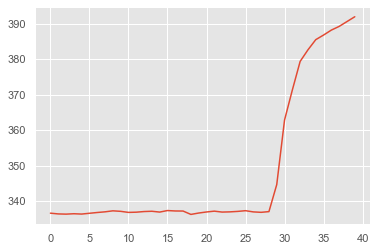

no_event no_event 2


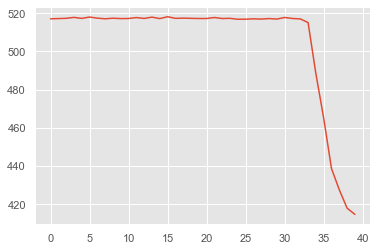

no_event no_event 1


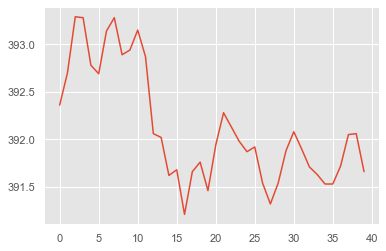

no_event no_event 2


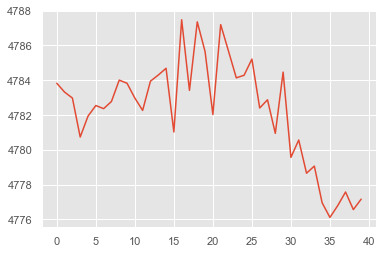

no_event no_event 2


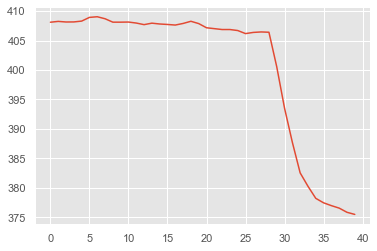

no_event no_event 1


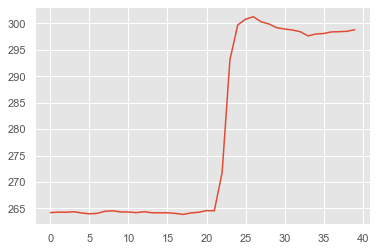

no_event no_event 2


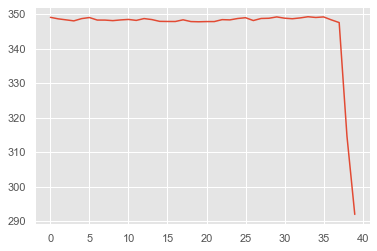

no_event no_event 1


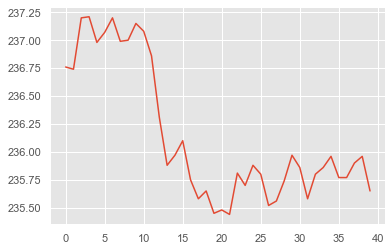

no_event no_event 1


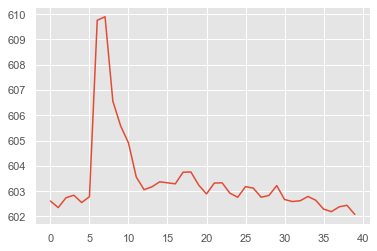

no_event no_event 1


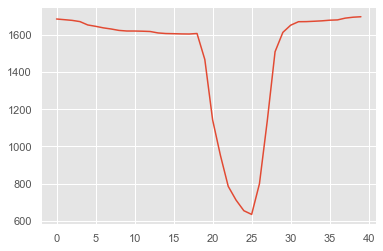

no_event Refrigerator_ON 1


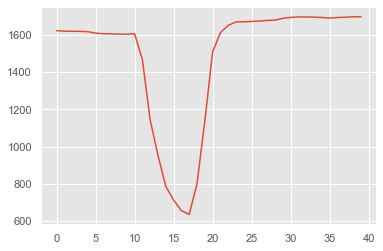

no_event no_event 2


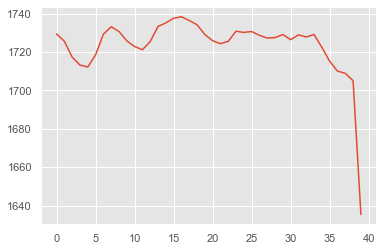

no_event no_event 1


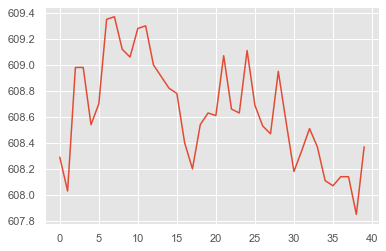

no_event no_event 2


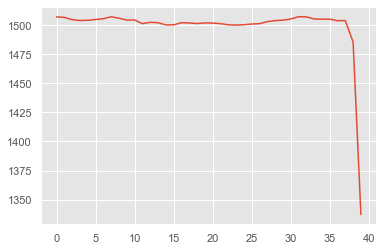

no_event no_event 1


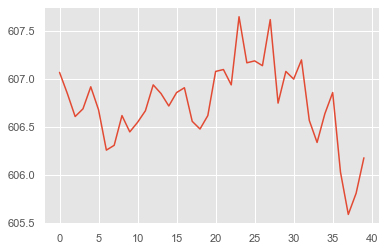

no_event no_event 1


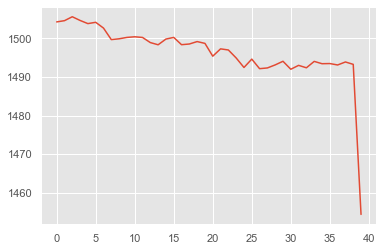

no_event no_event 1


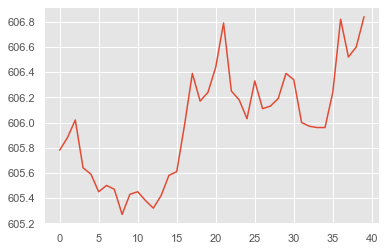

no_event no_event 2


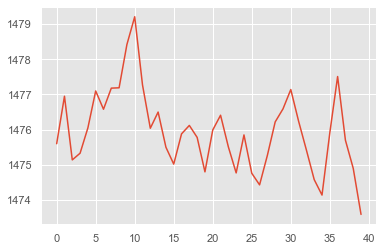

no_event no_event 2


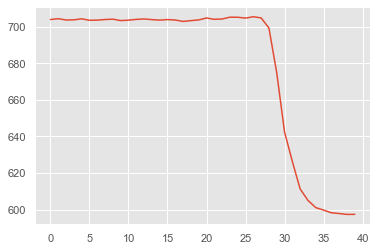

no_event no_event 2


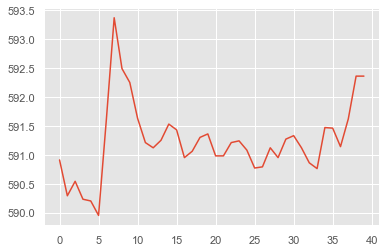

no_event no_event 1


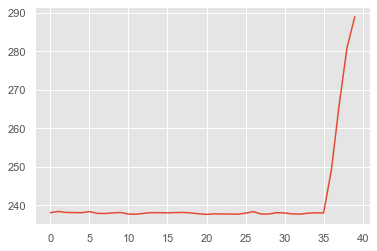

no_event no_event 1


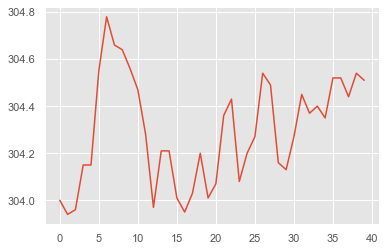

no_event no_event 1


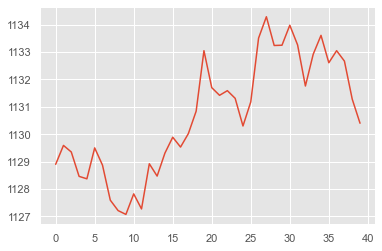

no_event no_event 1


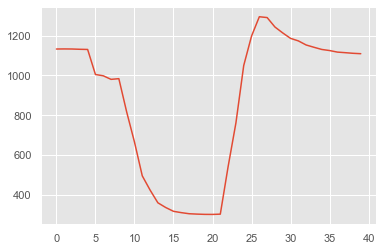

no_event no_event 2


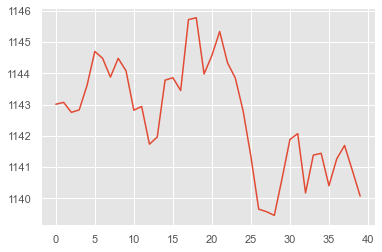

no_event no_event 1


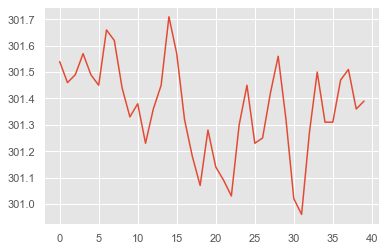

no_event no_event 2


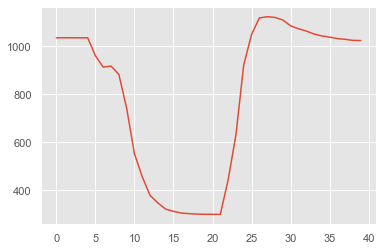

no_event no_event 2


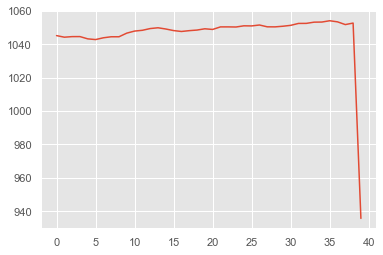

no_event no_event 1


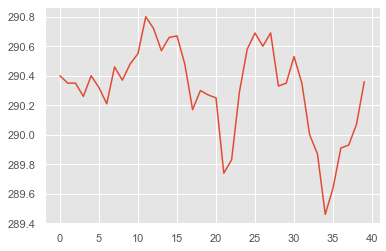

no_event no_event 2


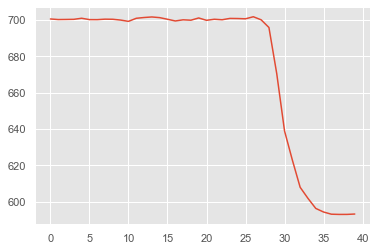

no_event no_event 1


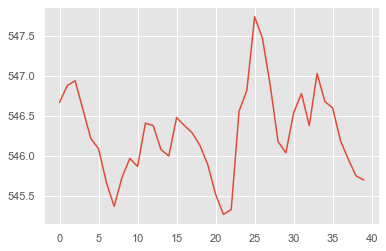

no_event no_event 2


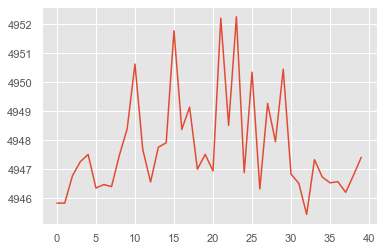

no_event no_event 2


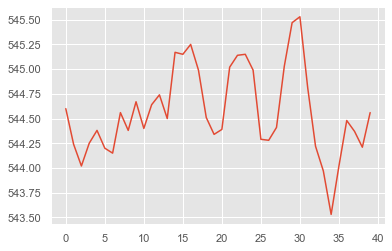

no_event no_event 1


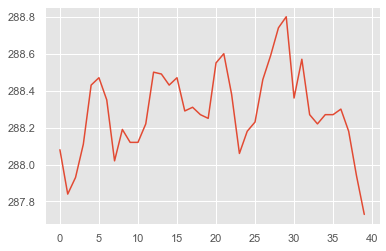

no_event no_event 1


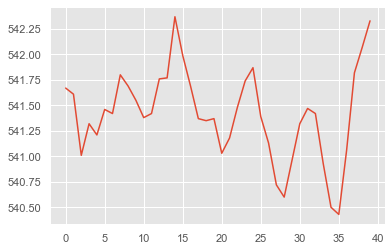

no_event no_event 2


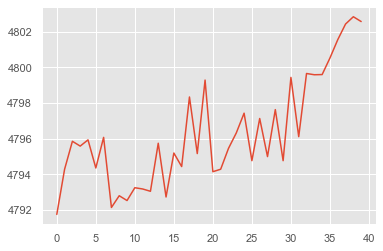

no_event no_event 2


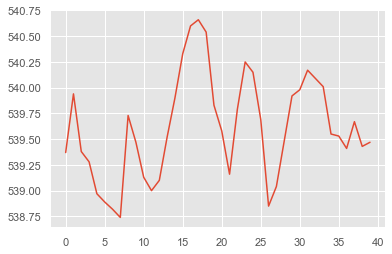

no_event no_event 1


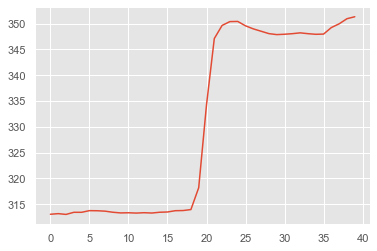

no_event no_event 2


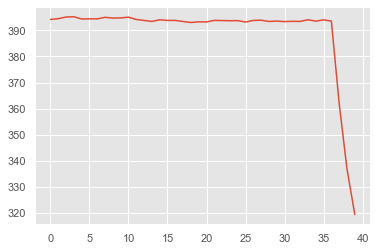

no_event no_event 1


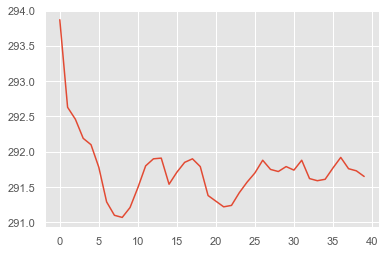

no_event no_event 2


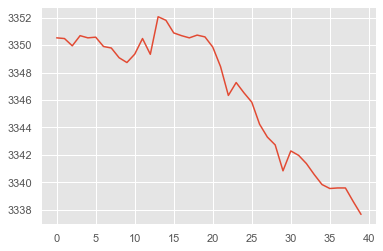

no_event no_event 1


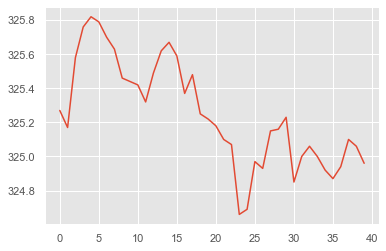

no_event no_event 2


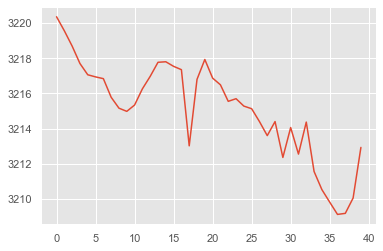

no_event no_event 2


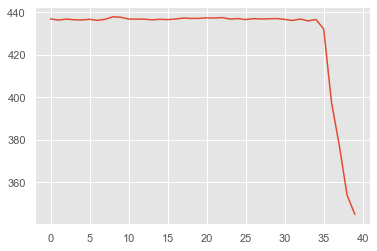

no_event no_event 1


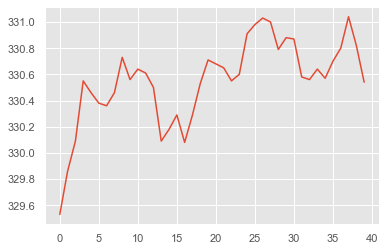

no_event no_event 1


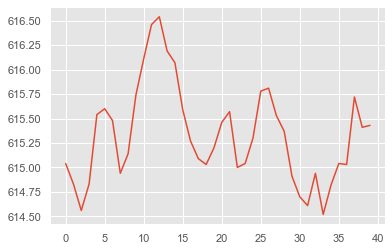

no_event no_event 2


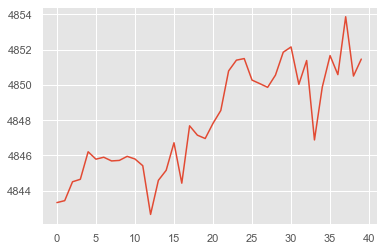

no_event no_event 2


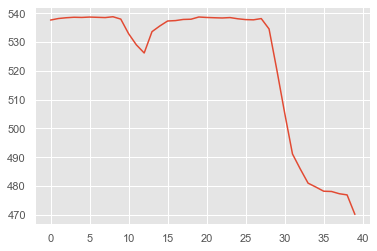

no_event no_event 1


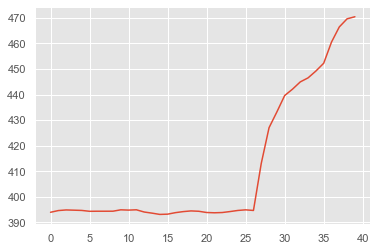

no_event no_event 2


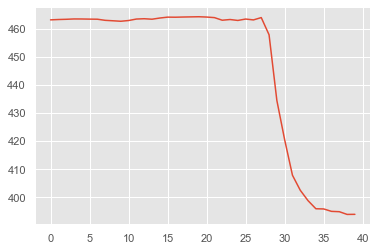

no_event no_event 2


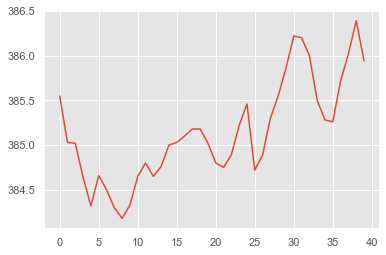

no_event no_event 1


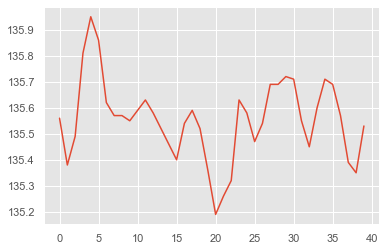

no_event Refrigerator_OFF 2


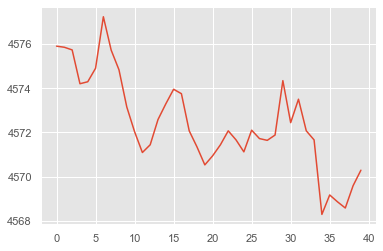

no_event no_event 1


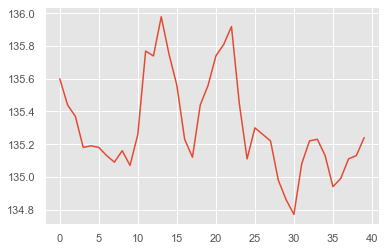

no_event no_event 2


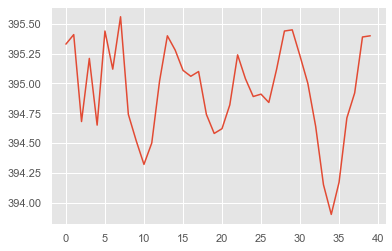

no_event no_event 1


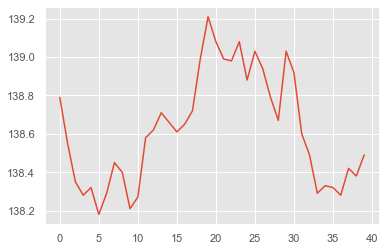

no_event no_event 2


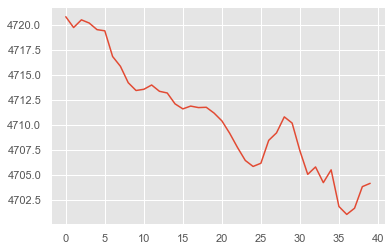

no_event no_event 1


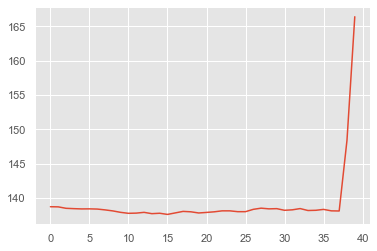

no_event no_event 1


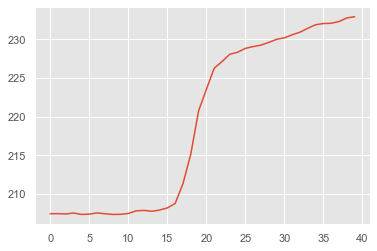

no_event no_event 1


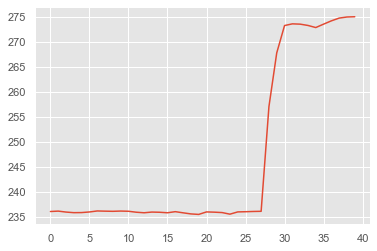

no_event no_event 2


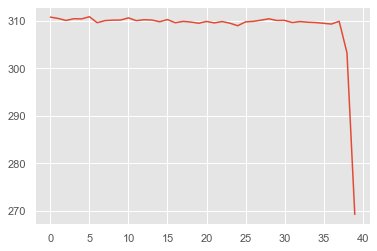

no_event no_event 1


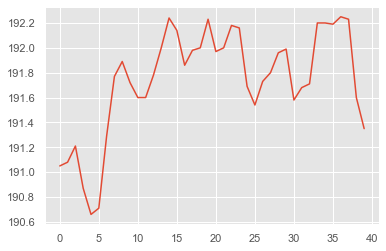

no_event no_event 2


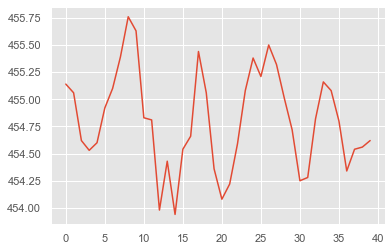

no_event no_event 1


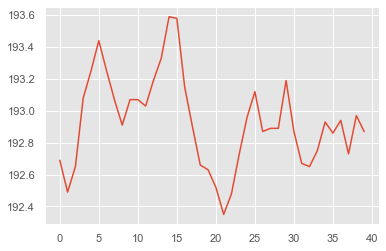

no_event no_event 2


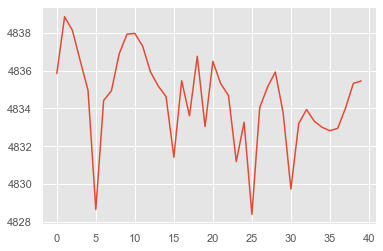

no_event Refrigerator_ON 1


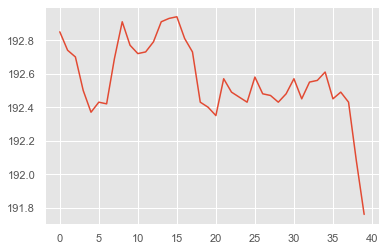

no_event no_event 1


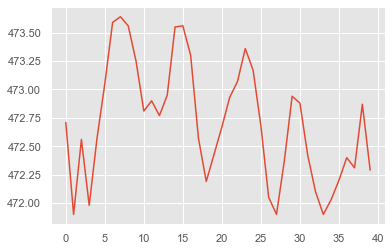

no_event no_event 2


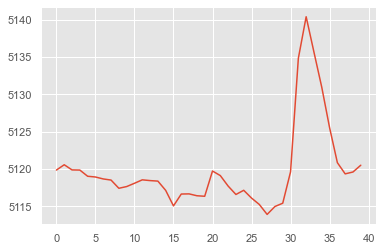

no_event no_event 2


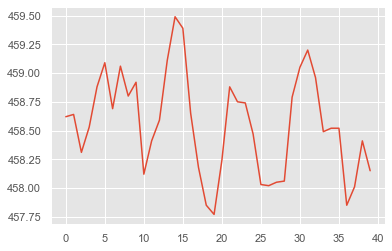

no_event no_event 1


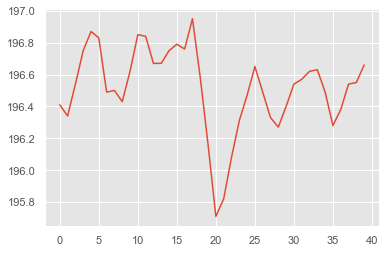

no_event no_event 2


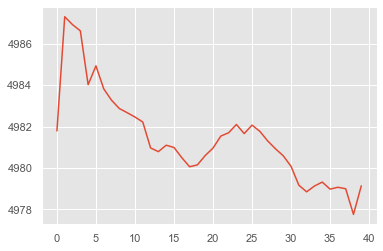

no_event no_event 1


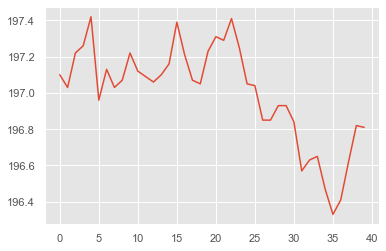

no_event no_event 2


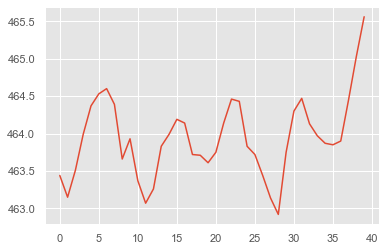

no_event no_event 2


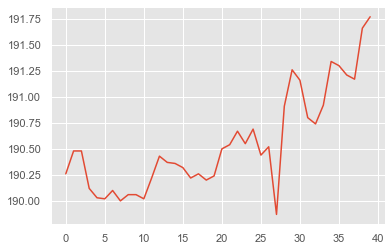

no_event Refrigerator_ON 1


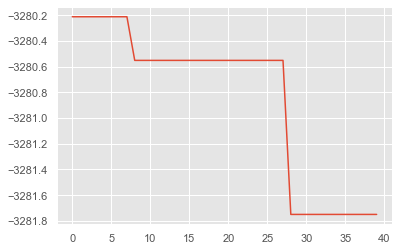

no_event no_event 1


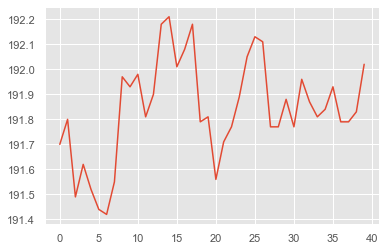

no_event no_event 2


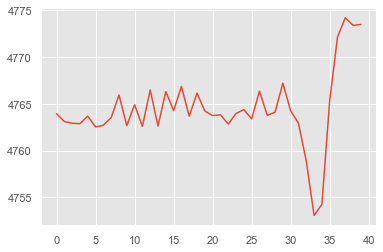

no_event no_event 1


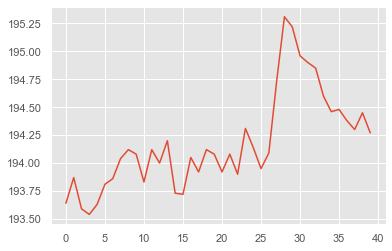

no_event no_event 2


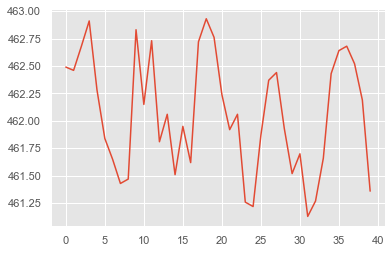

no_event no_event 1


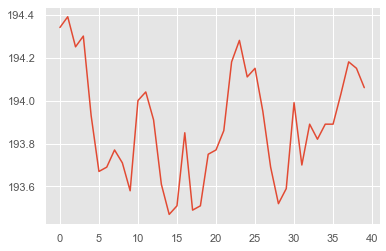

no_event no_event 2


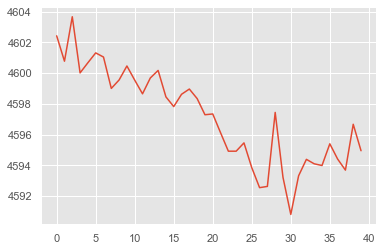

no_event no_event 2


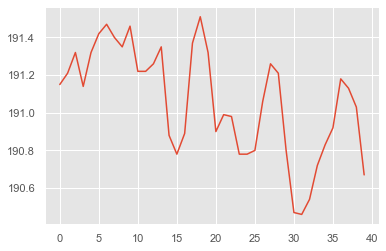

no_event no_event 1


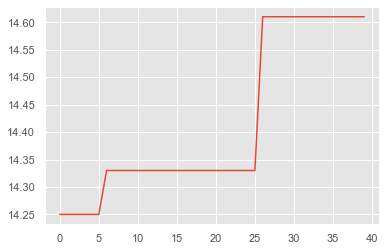

no_event no_event 1


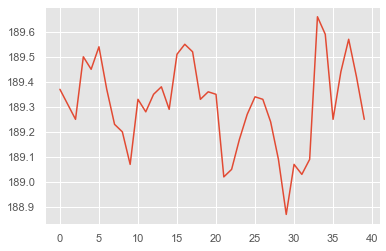

no_event no_event 1


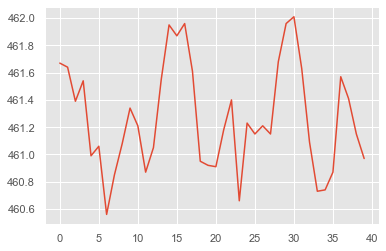

no_event no_event 2


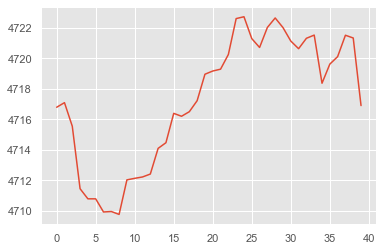

no_event no_event 2


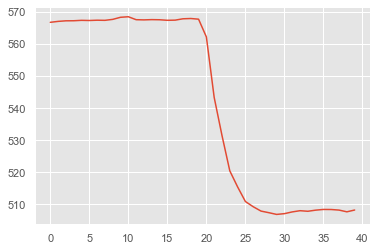

no_event no_event 1


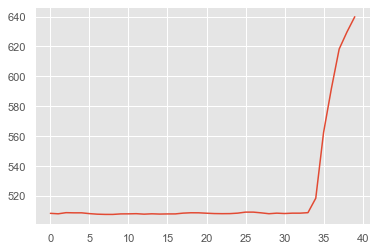

Refrigerator_OFF no_event 2


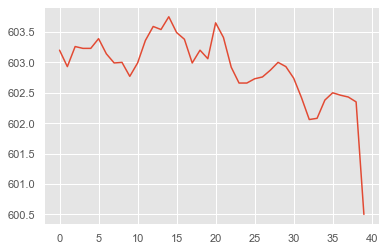

no_event no_event 2


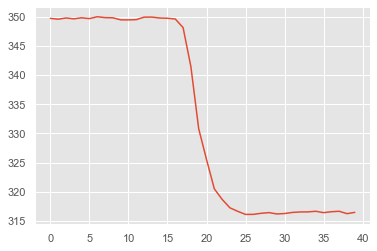

no_event no_event 2


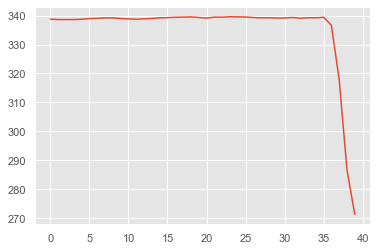

no_event no_event 1


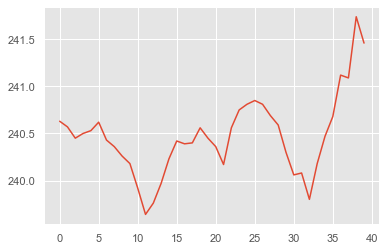

no_event no_event 2


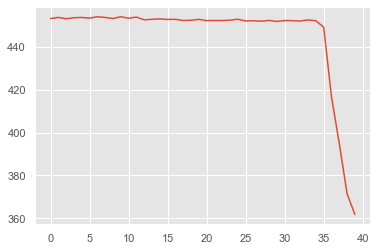

no_event no_event 2


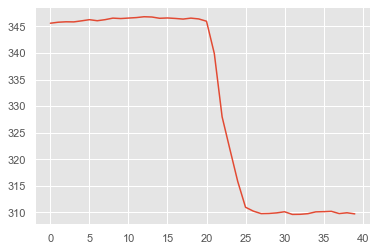

no_event no_event 2


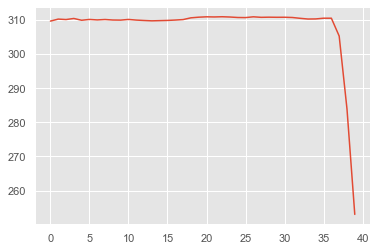

no_event no_event 2


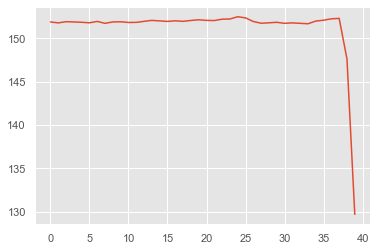

no_event no_event 2


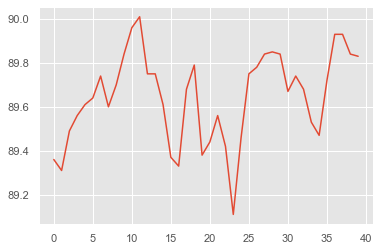

no_event no_event 1


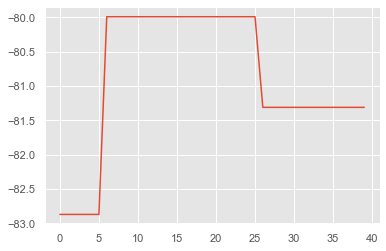

no_event no_event 1


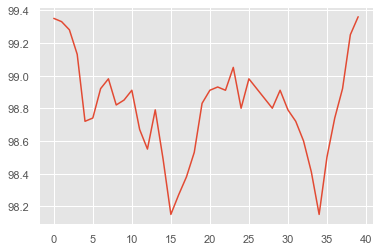

no_event no_event 1


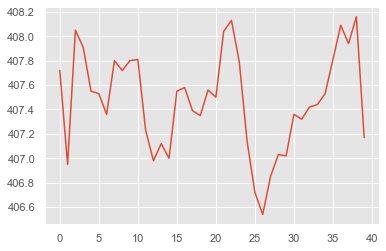

no_event no_event 2


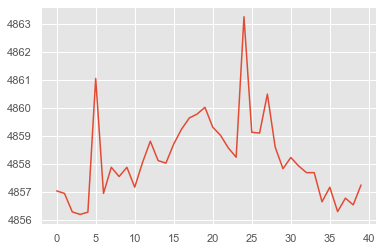

no_event no_event 1


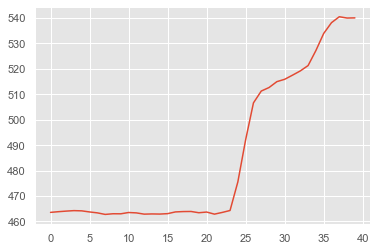

no_event no_event 1


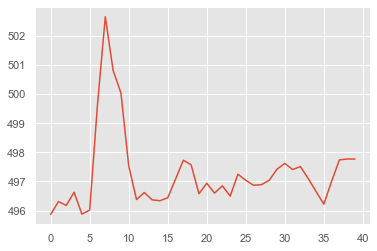

no_event Refrigerator_ON 2


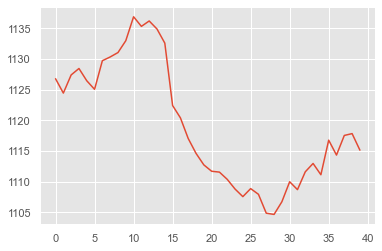

no_event no_event 2


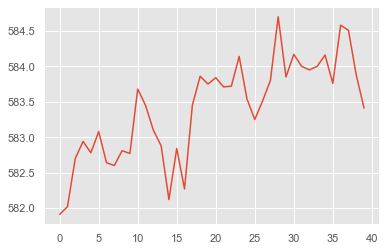

no_event Geyser_ON 1


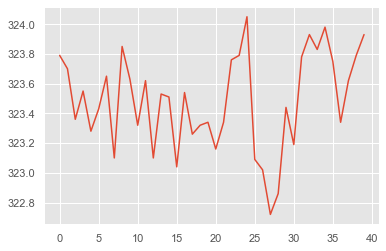

no_event no_event 2


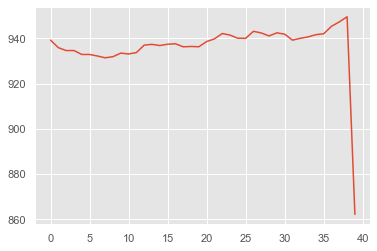

no_event no_event 2


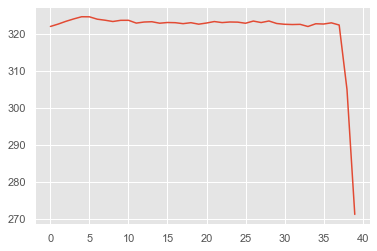

no_event Refrigerator_ON 1


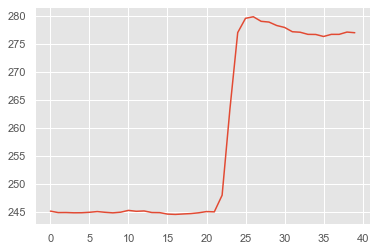

no_event no_event 2


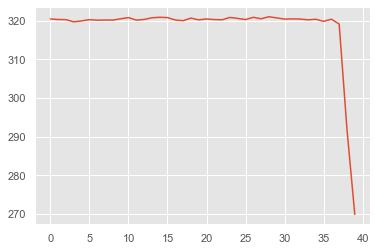

no_event no_event 2


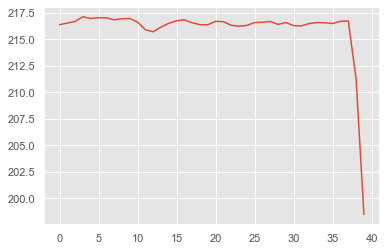

no_event no_event 1


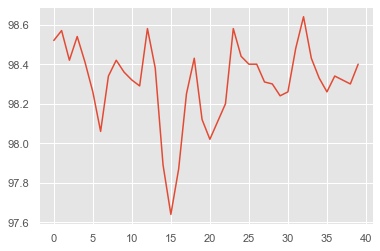

no_event no_event 2


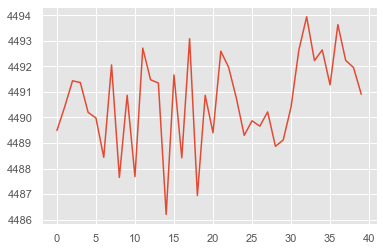

no_event no_event 1


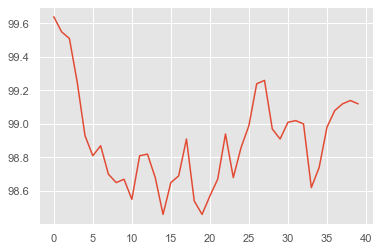

no_event no_event 2


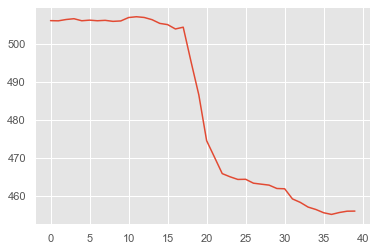

no_event no_event 2


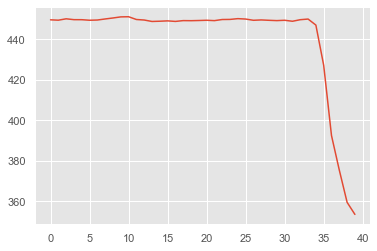

no_event no_event 2


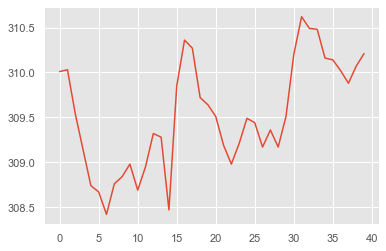

no_event no_event 1


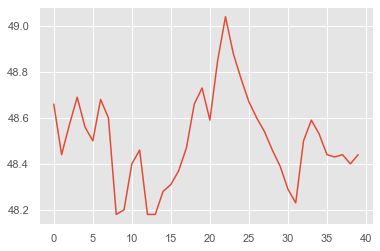

no_event no_event 2


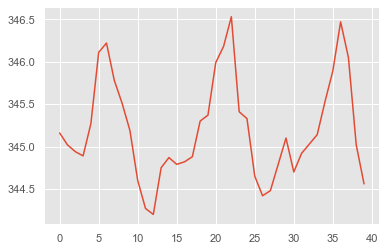

no_event Geyser_OFF 1


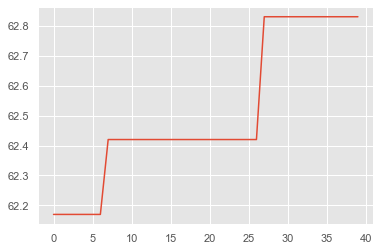

no_event no_event 2


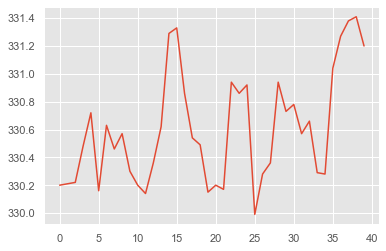

no_event no_event 1


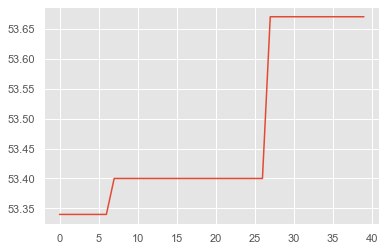

no_event no_event 2


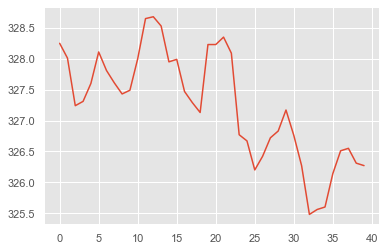

no_event no_event 1


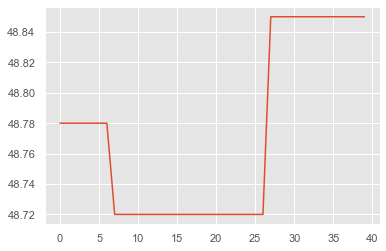

no_event no_event 2


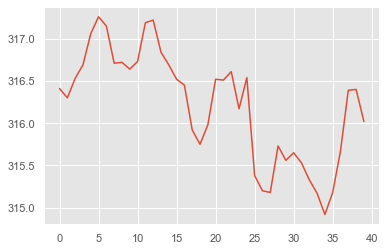

no_event no_event 1


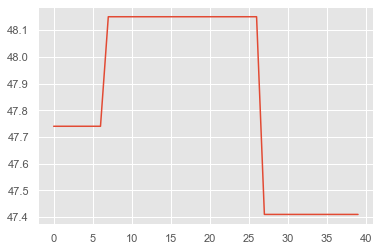

no_event no_event 2


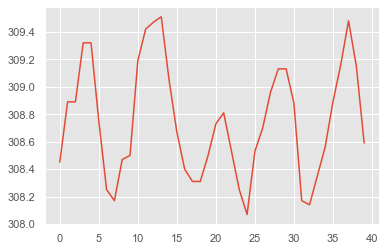

no_event no_event 2


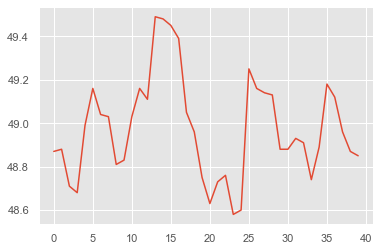

no_event no_event 1


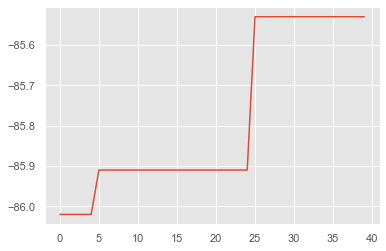

no_event no_event 2


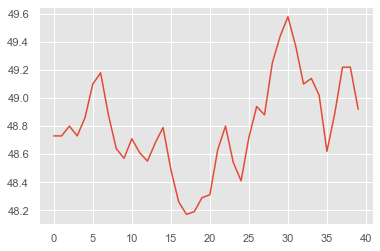

no_event no_event 1


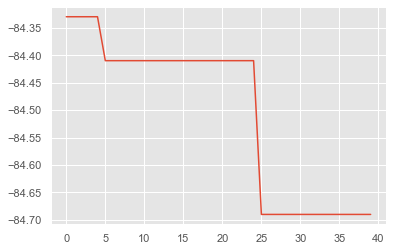

no_event no_event 2


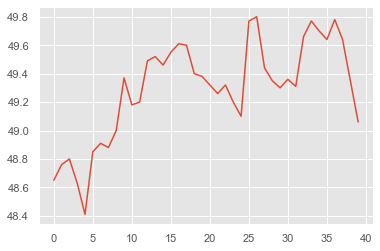

no_event no_event 1


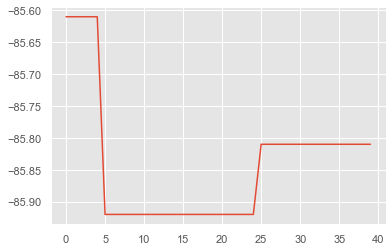

no_event no_event 2


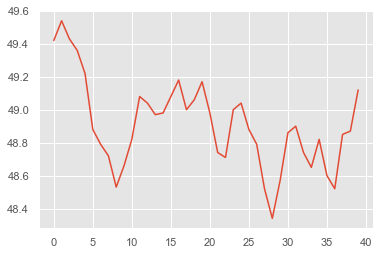

no_event no_event 1


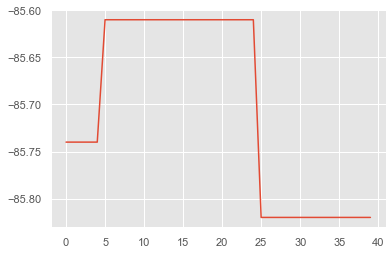

no_event no_event 2


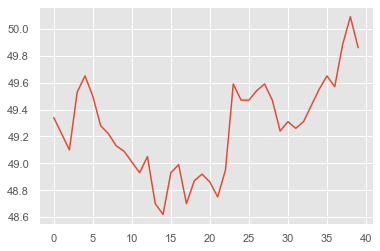

no_event no_event 1


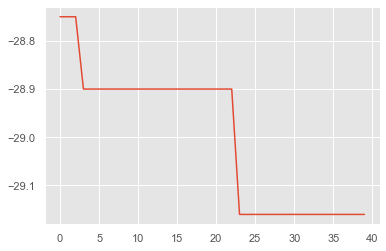

no_event no_event 1


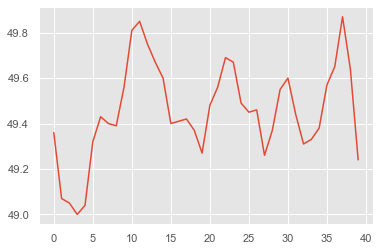

no_event no_event 2


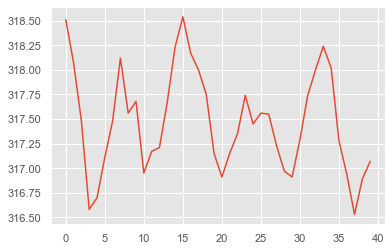

no_event no_event 1


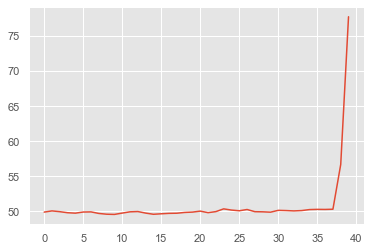

no_event no_event 1


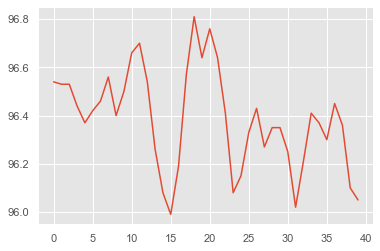

no_event no_event 1


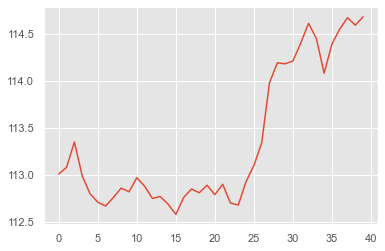

no_event no_event 1


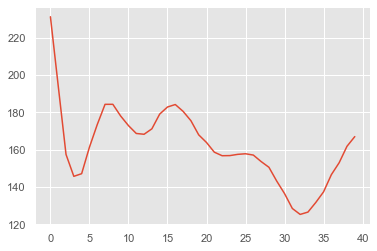

no_event no_event 2


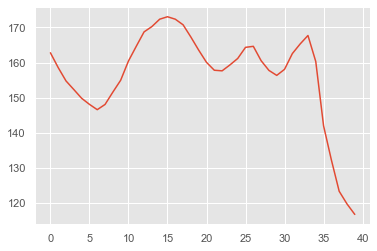

no_event no_event 1


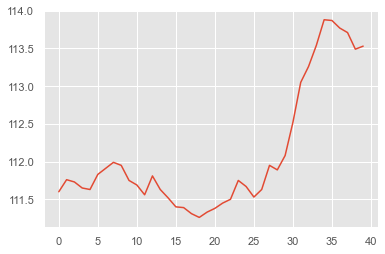

no_event no_event 2


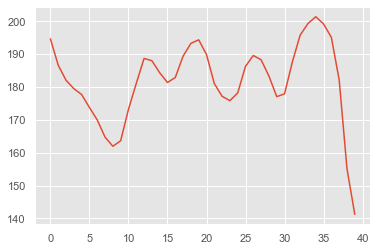

no_event no_event 1


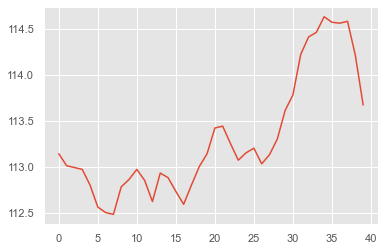

no_event no_event 1


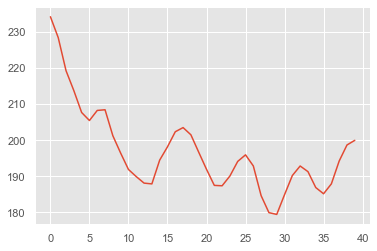

no_event no_event 2


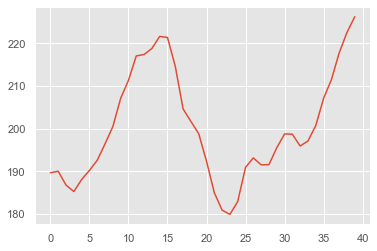

no_event no_event 1


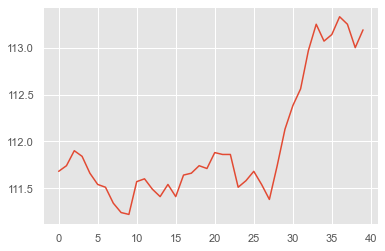

no_event no_event 2


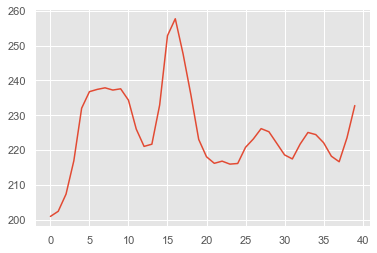

no_event no_event 1


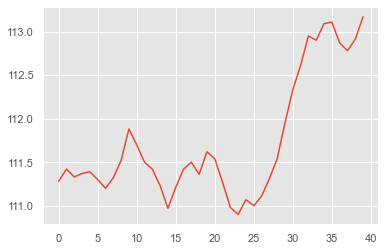

no_event no_event 2


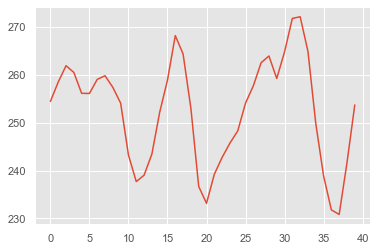

no_event no_event 1


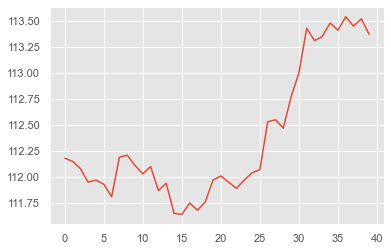

no_event no_event 1


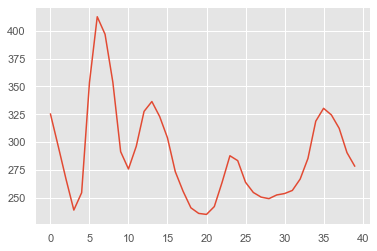

no_event no_event 2


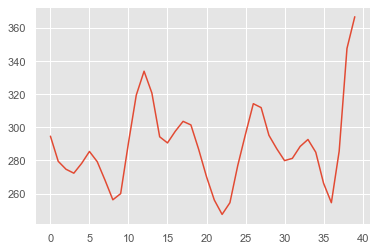

no_event no_event 1


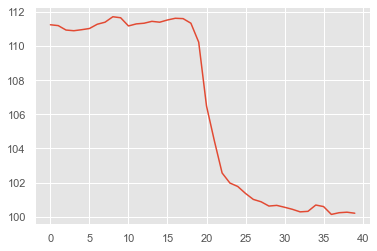

no_event no_event 1


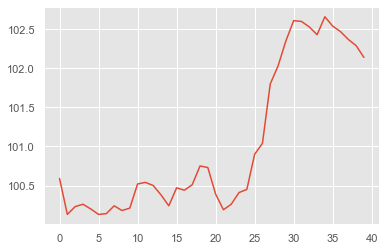

no_event no_event 2


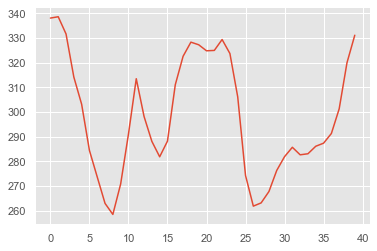

no_event no_event 1


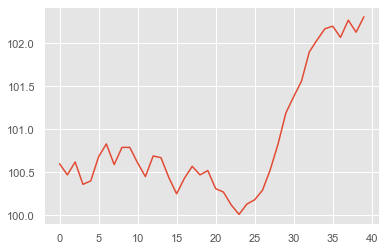

no_event no_event 2


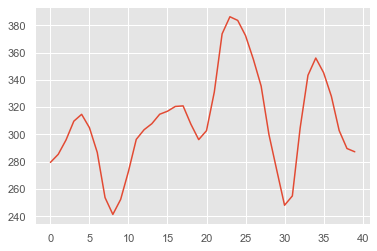

no_event no_event 1


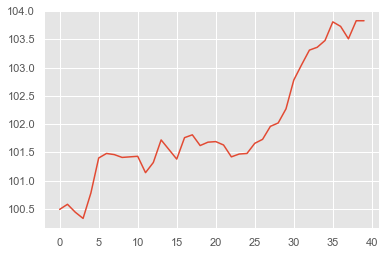

no_event no_event 2


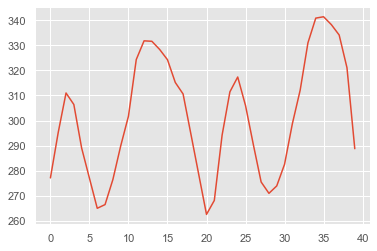

no_event no_event 1


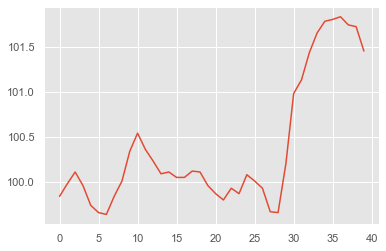

no_event no_event 2


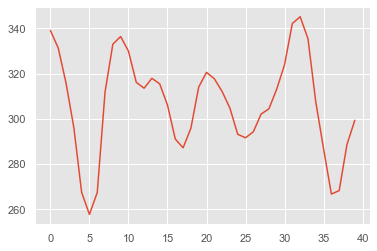

no_event no_event 1


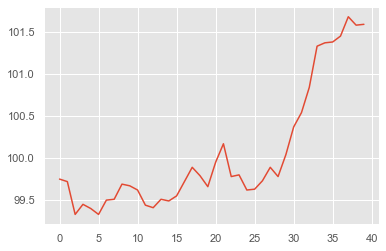

no_event no_event 1


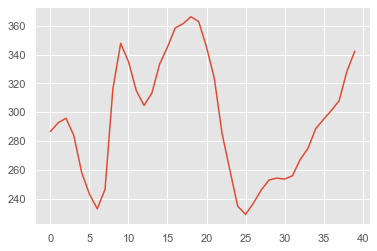

no_event no_event 2


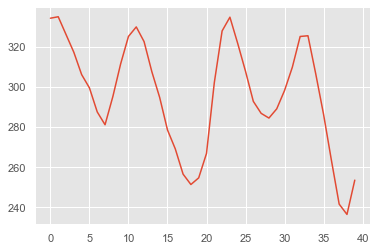

no_event no_event 1


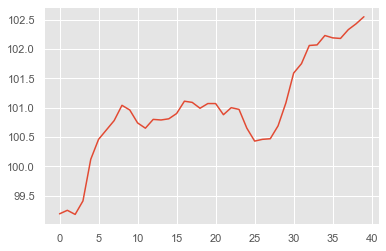

no_event no_event 2


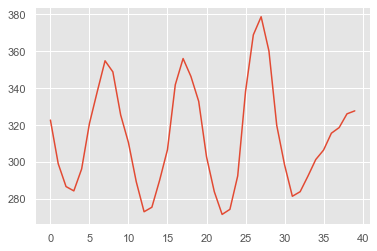

no_event no_event 1


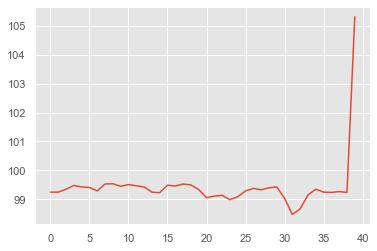

no_event no_event 1


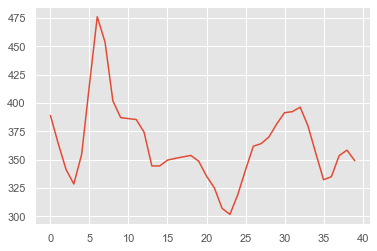

no_event no_event 1


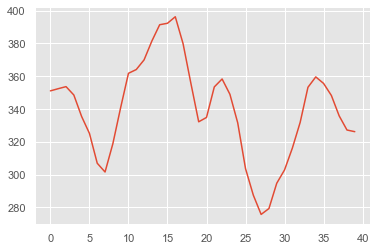

no_event no_event 2


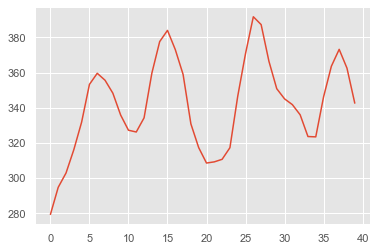

no_event no_event 2


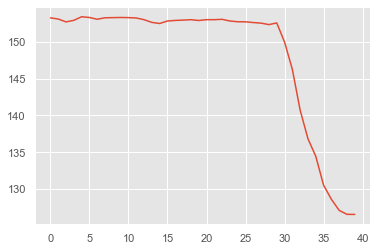

no_event no_event 2


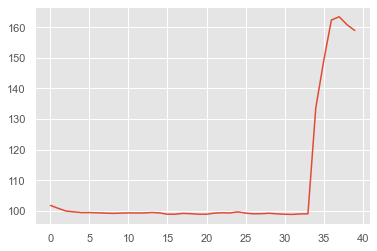

no_event no_event 1


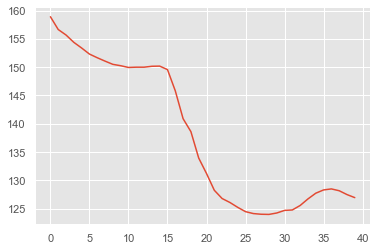

no_event no_event 1


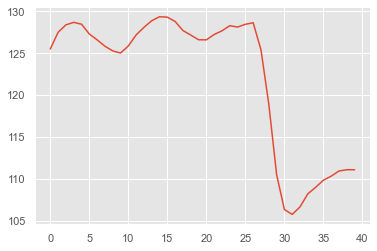

no_event no_event 1


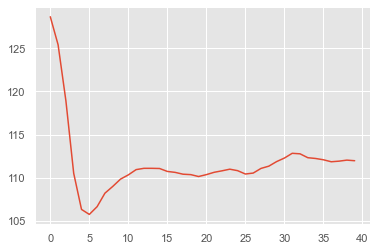

no_event no_event 2


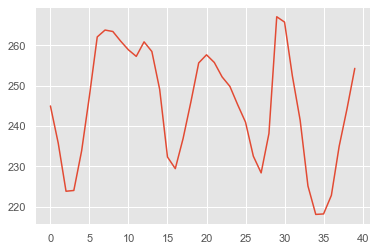

no_event no_event 2


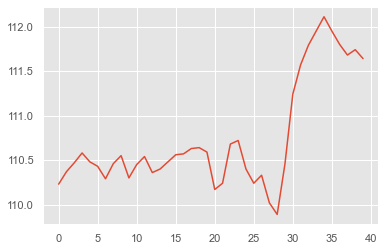

no_event no_event 2


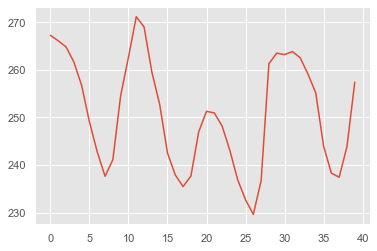

no_event no_event 2


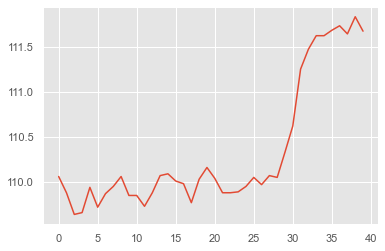

no_event no_event 2


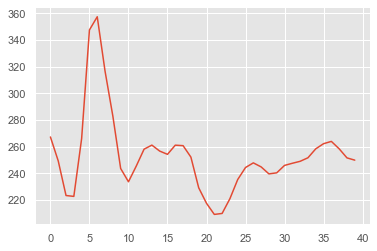

no_event no_event 2


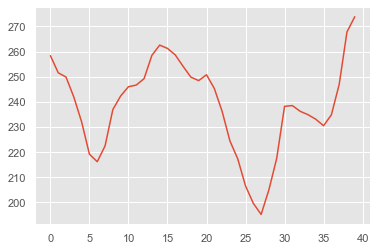

no_event no_event 2


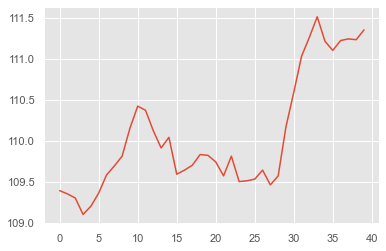

no_event no_event 2


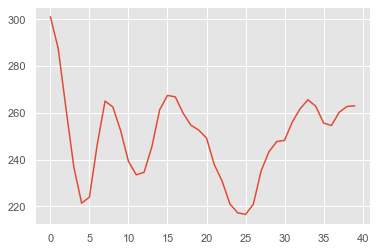

no_event no_event 2


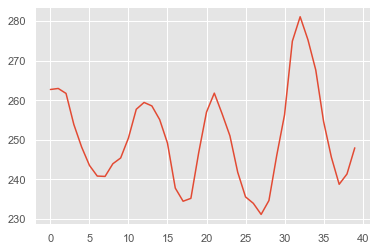

no_event no_event 2


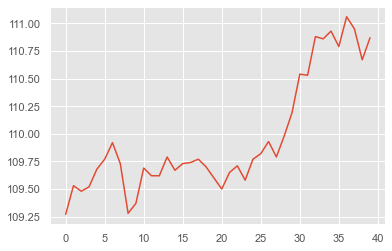

no_event no_event 2


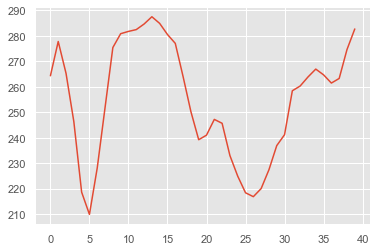

no_event no_event 2


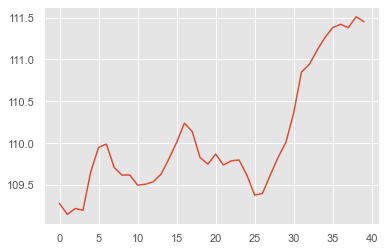

no_event no_event 2


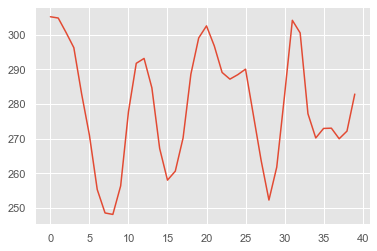

no_event no_event 2


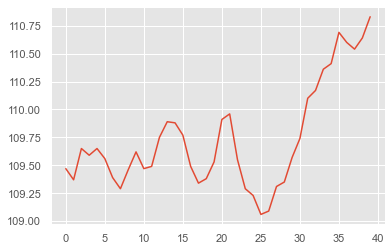

no_event no_event 1


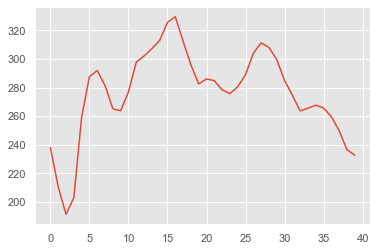

no_event no_event 2


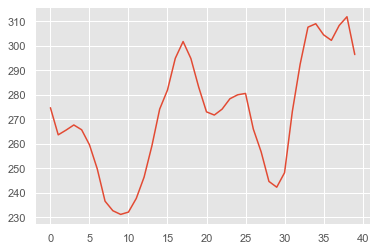

no_event no_event 2


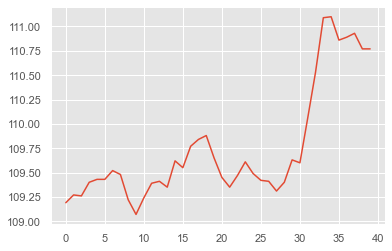

no_event no_event 2


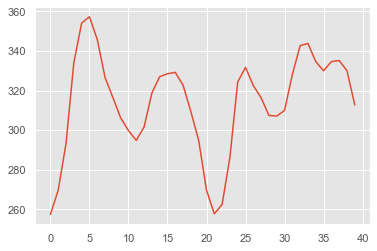

no_event no_event 2


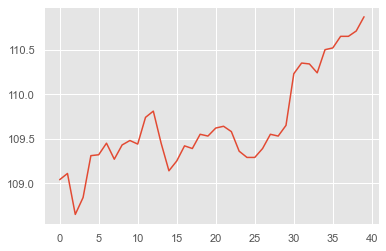

no_event no_event 2


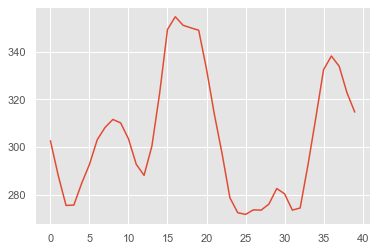

no_event no_event 2


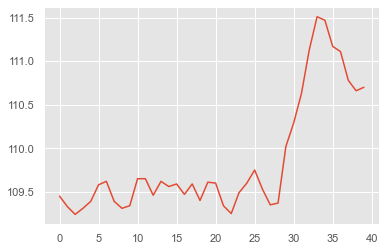

no_event no_event 2


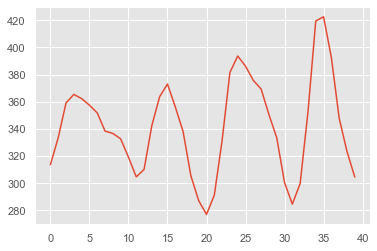

no_event no_event 2


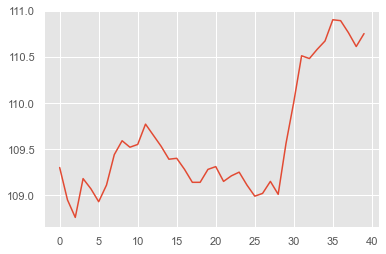

no_event no_event 1


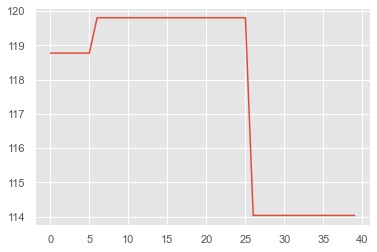

no_event no_event 1


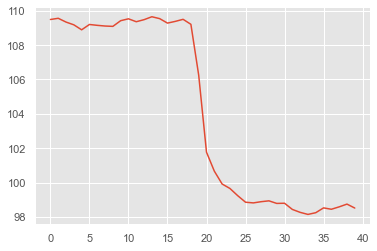

no_event no_event 1


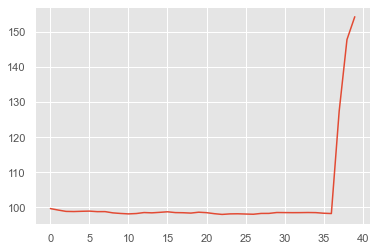

no_event no_event 2


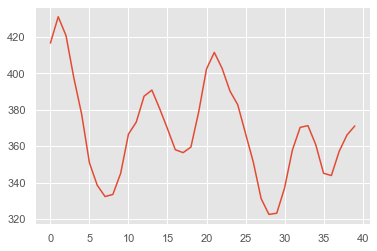

no_event no_event 2


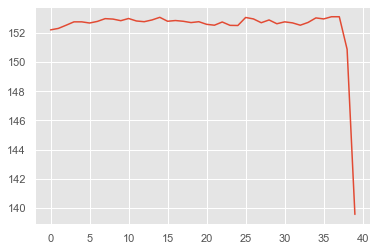

no_event no_event 2


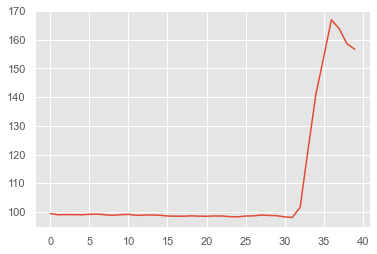

no_event no_event 1


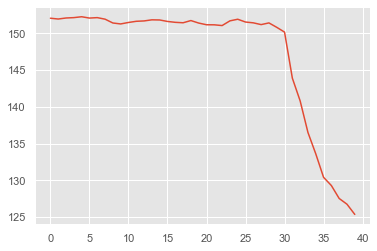

no_event no_event 1


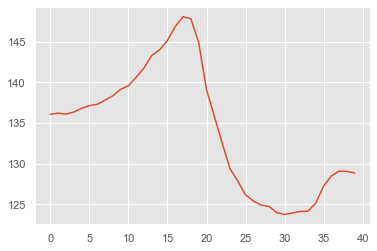

no_event no_event 2


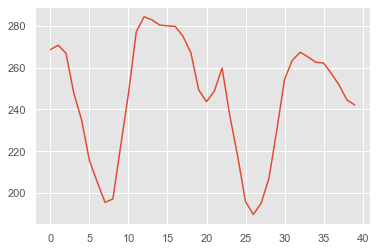

no_event no_event 2


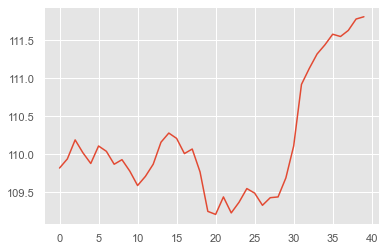

no_event no_event 2


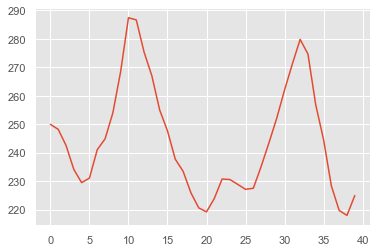

no_event no_event 2


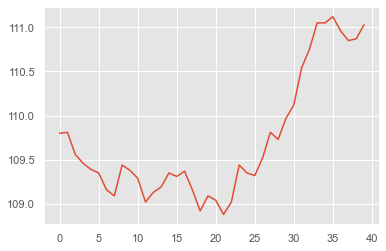

no_event no_event 2


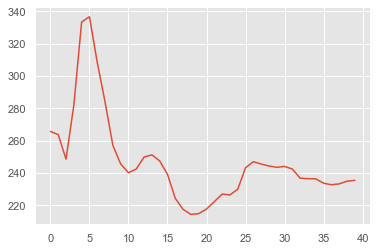

no_event no_event 2


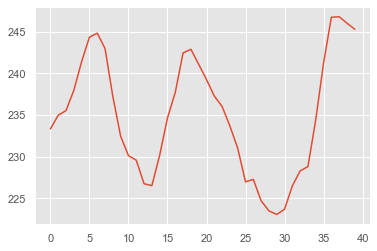

no_event no_event 2


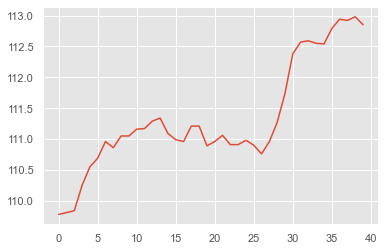

no_event no_event 2


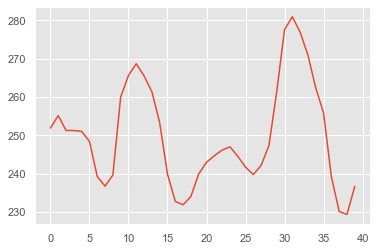

no_event no_event 2


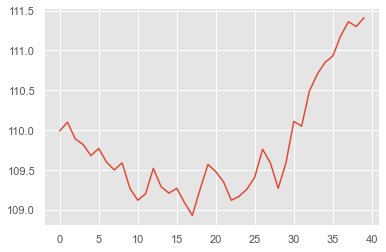

no_event no_event 2


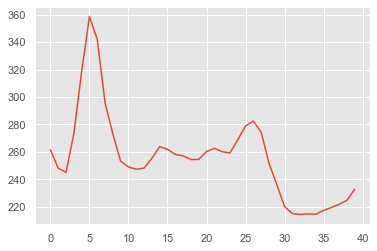

no_event no_event 2


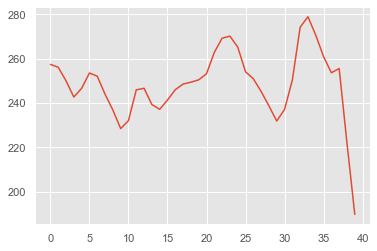

no_event no_event 2


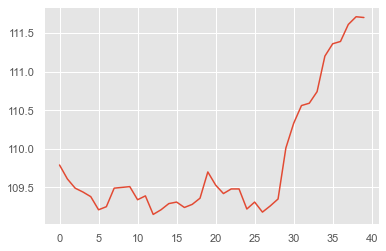

no_event no_event 2


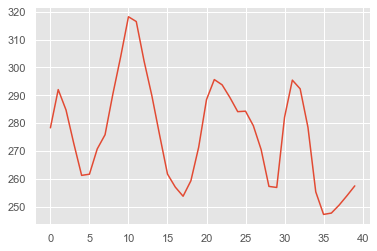

no_event no_event 2


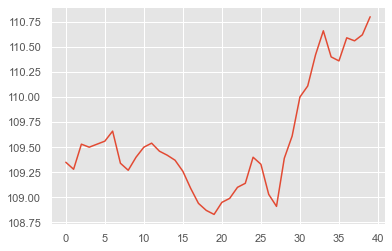

no_event no_event 2


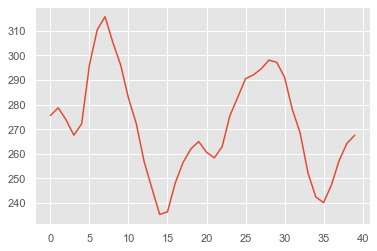

no_event no_event 2


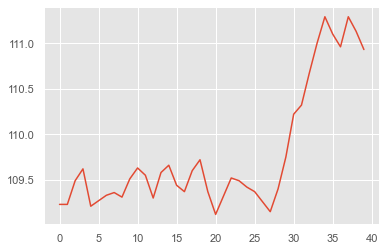

no_event no_event 2


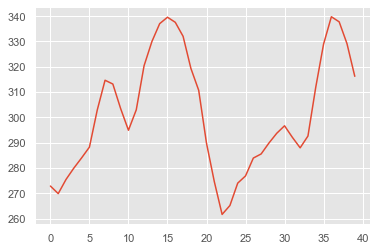

no_event no_event 2


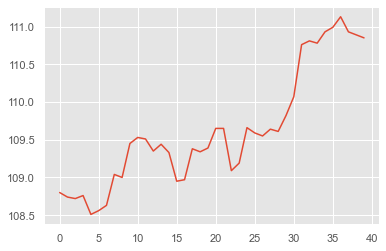

no_event no_event 2


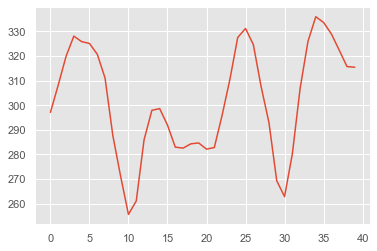

no_event no_event 2


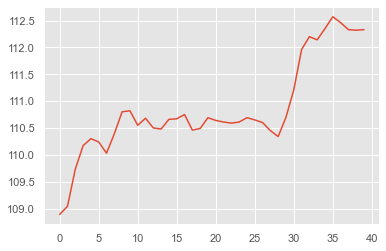

no_event no_event 2


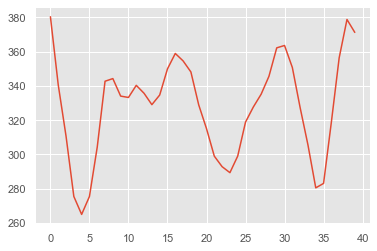

no_event no_event 2


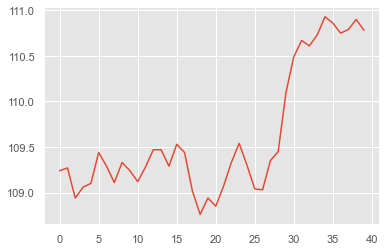

no_event no_event 2


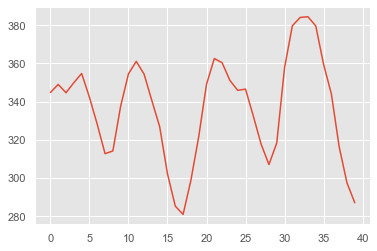

no_event no_event 2


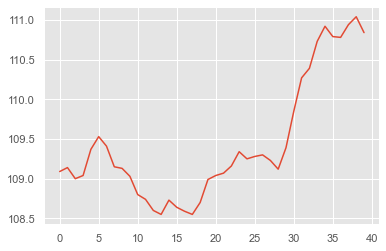

no_event no_event 2


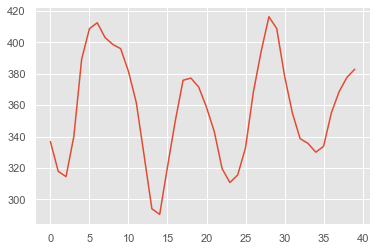

no_event no_event 1


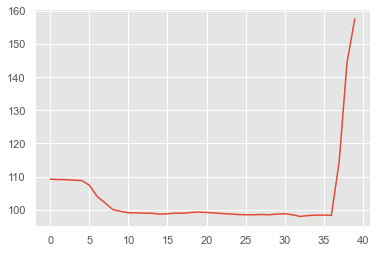

no_event no_event 2


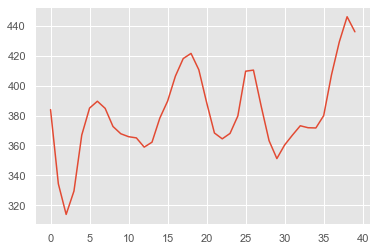

no_event no_event 2


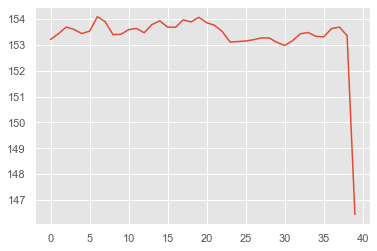

no_event no_event 2


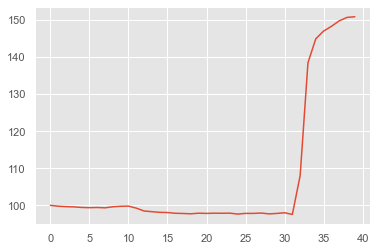

no_event no_event 1


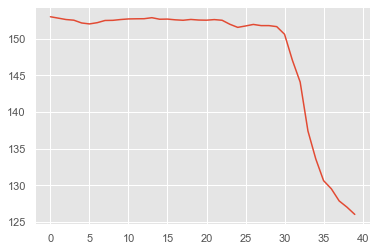

no_event no_event 1


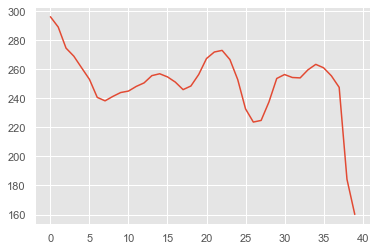

no_event no_event 2


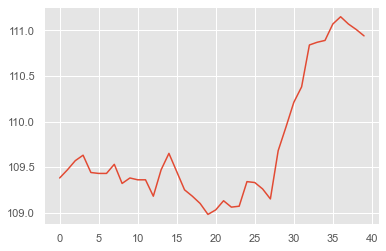

no_event no_event 2


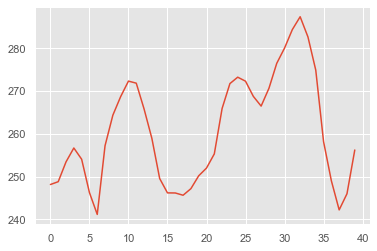

no_event no_event 2


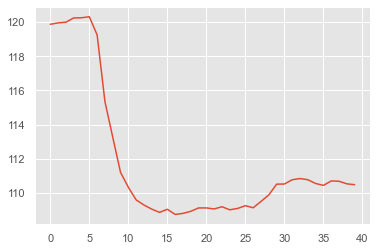

no_event no_event 1


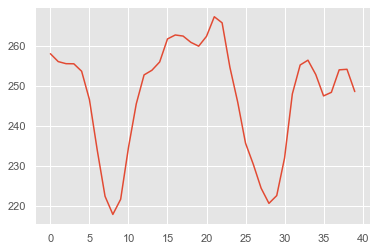

no_event no_event 2


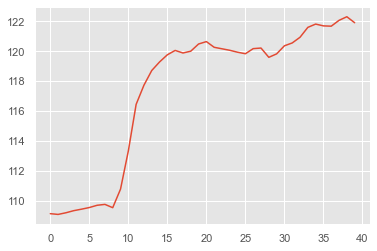

no_event no_event 2


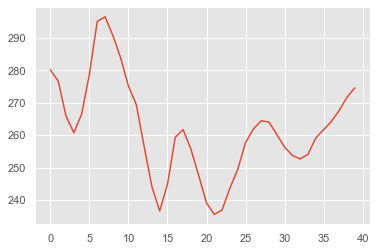

no_event no_event 2


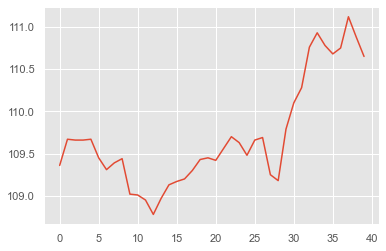

no_event no_event 1


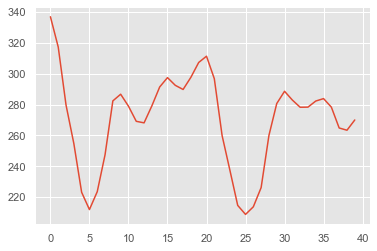

no_event no_event 2


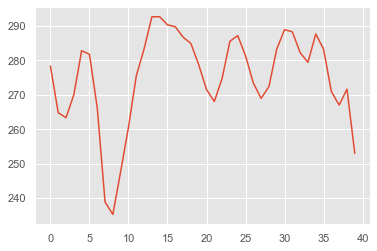

no_event no_event 2


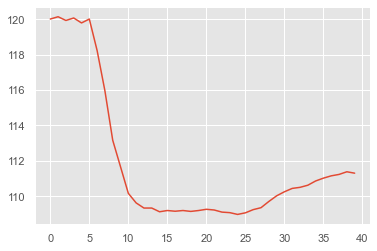

no_event no_event 2


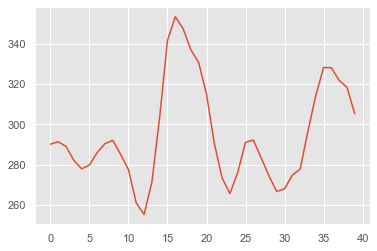

no_event no_event 2


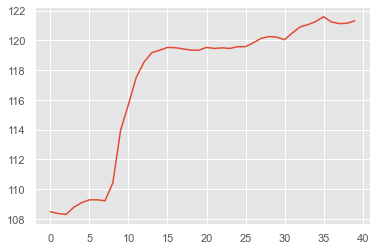

no_event no_event 2


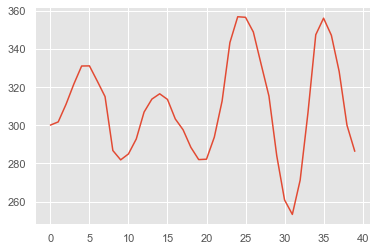

no_event no_event 2


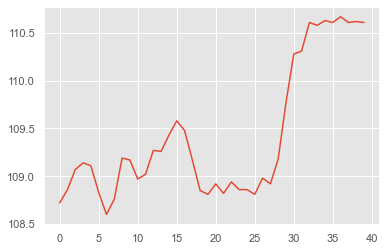

no_event no_event 1


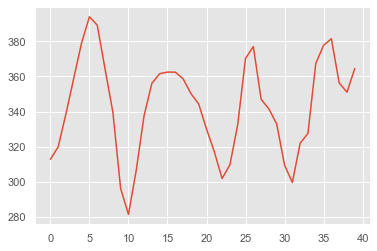

no_event no_event 1


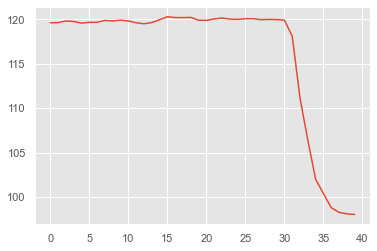

no_event no_event 1


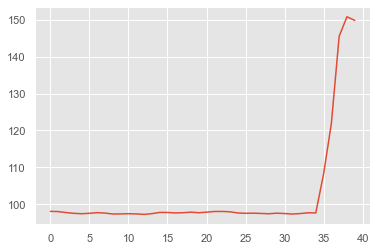

no_event no_event 2


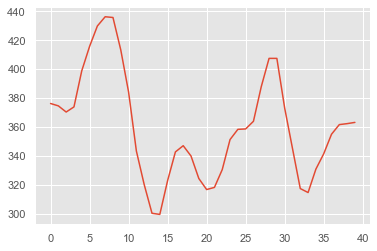

no_event no_event 2


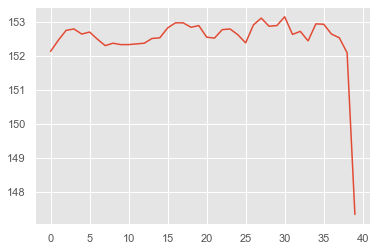

no_event no_event 2


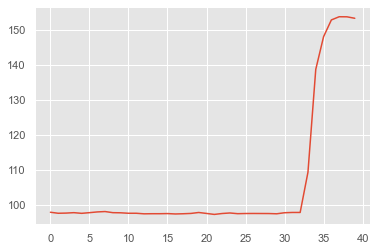

no_event no_event 1


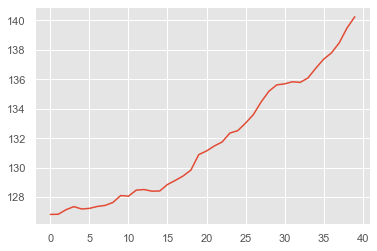

no_event no_event 1


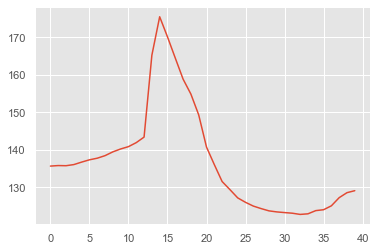

no_event no_event 1


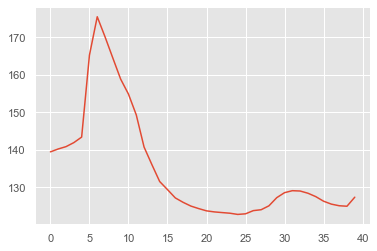

no_event no_event 1


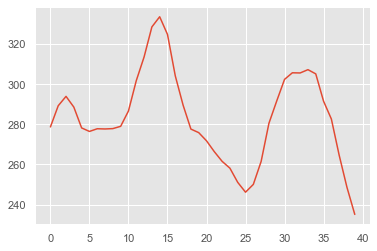

no_event no_event 2


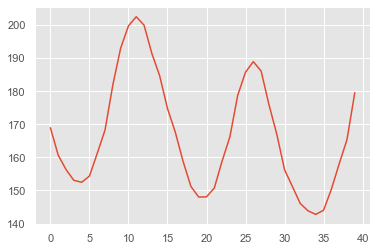

no_event no_event 2


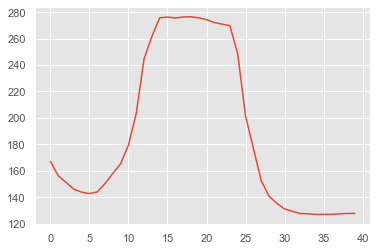

no_event no_event 1


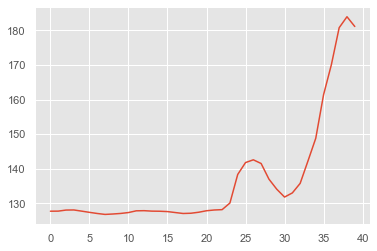

no_event no_event 2


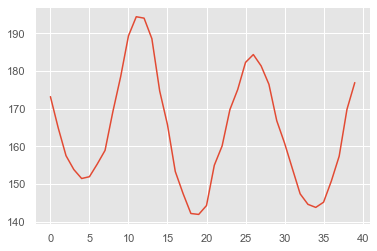

no_event no_event 2


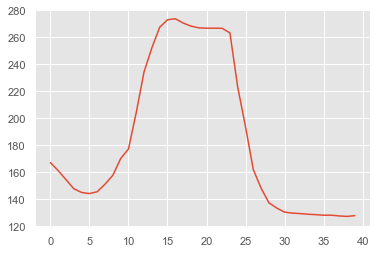

no_event no_event 1


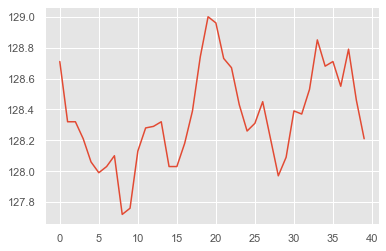

no_event no_event 2


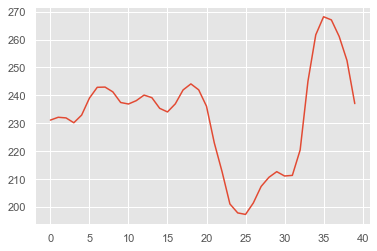

no_event no_event 2


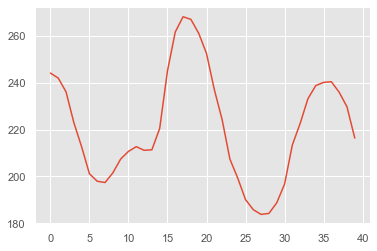

no_event no_event 2


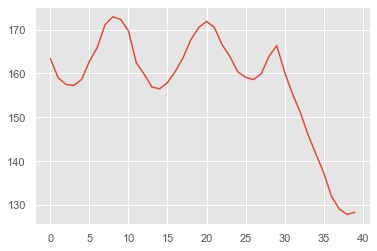

no_event no_event 1


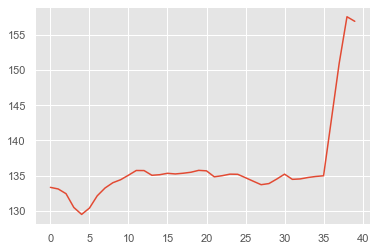

no_event no_event 1


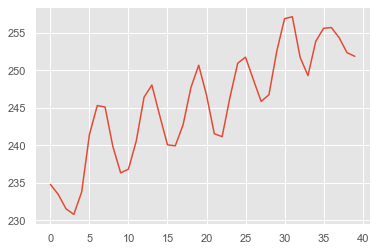

no_event no_event 2


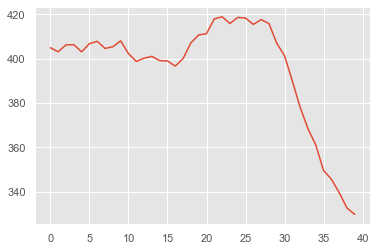

no_event no_event 1


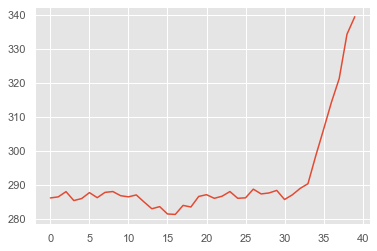

no_event no_event 2


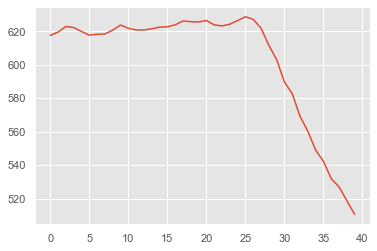

no_event no_event 2


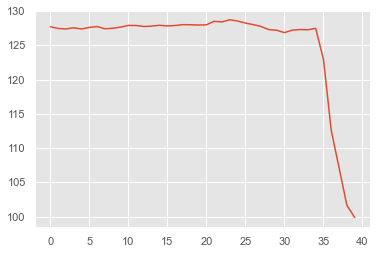

no_event no_event 1


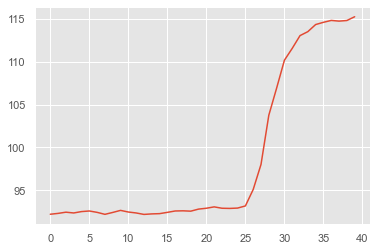

no_event no_event 1


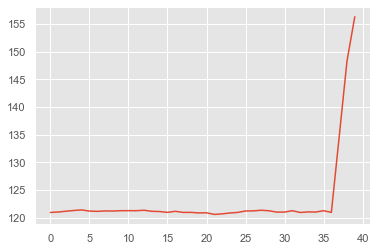

no_event no_event 2


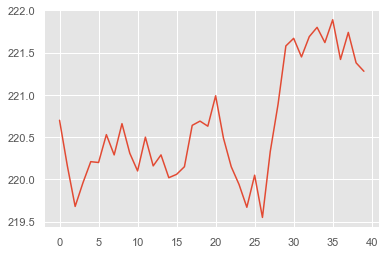

no_event no_event 1


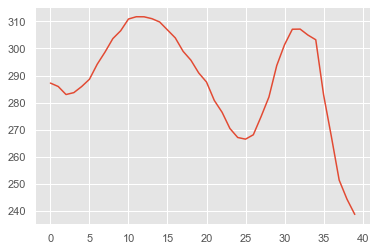

no_event no_event 2


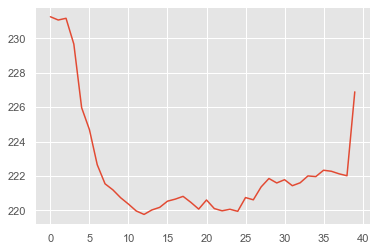

no_event no_event 1


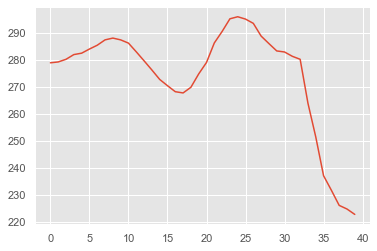

no_event no_event 2


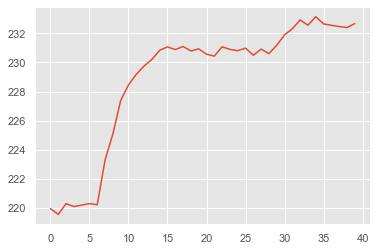

no_event no_event 2


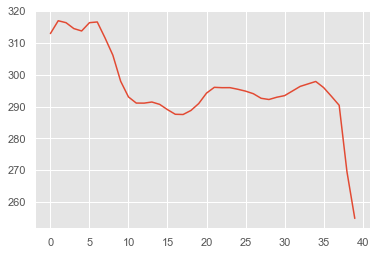

no_event no_event 1


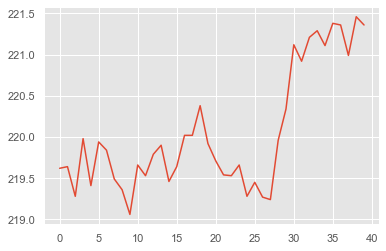

no_event no_event 1


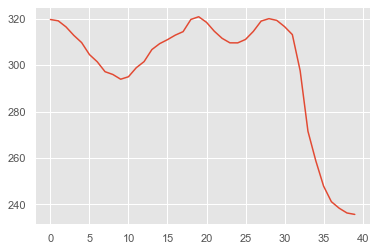

no_event no_event 2


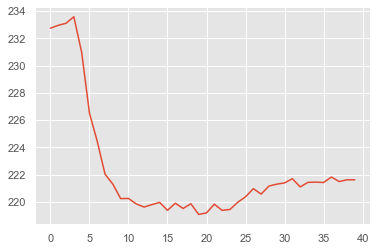

no_event no_event 1


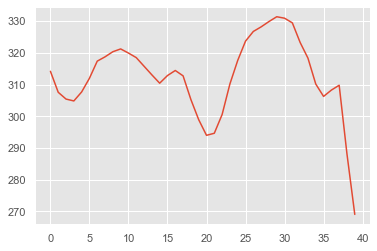

no_event no_event 2


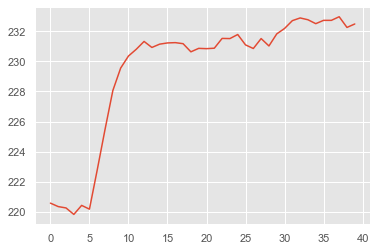

no_event no_event 1


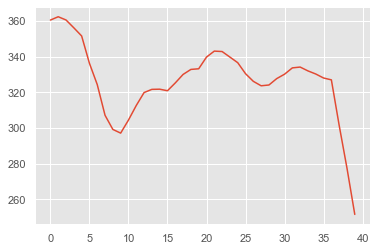

no_event no_event 2


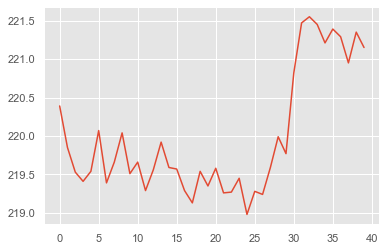

no_event no_event 2


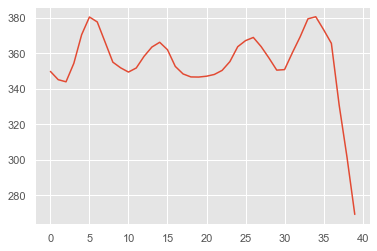

no_event no_event 2


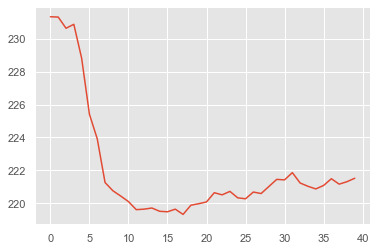

no_event no_event 1


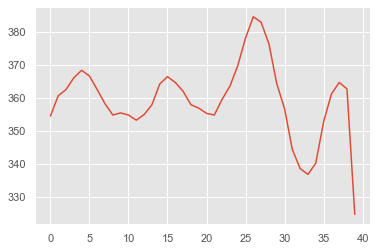

no_event no_event 2


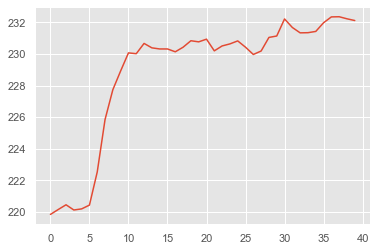

no_event no_event 2


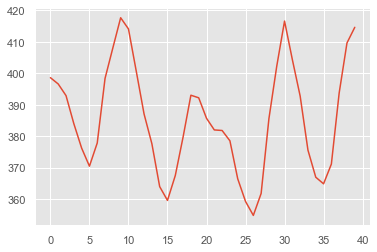

no_event no_event 2


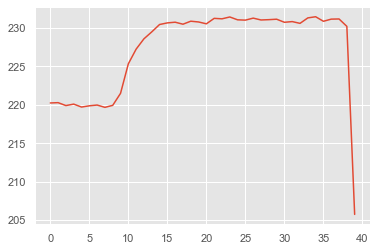

no_event no_event 1


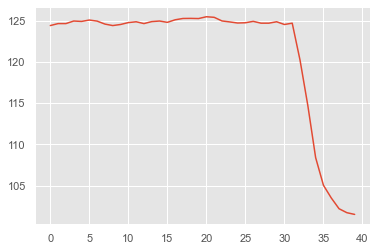

no_event no_event 1


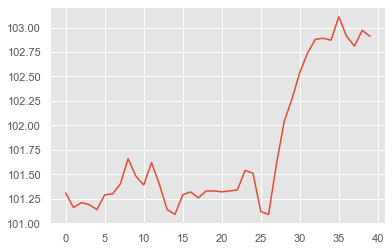

no_event no_event 2


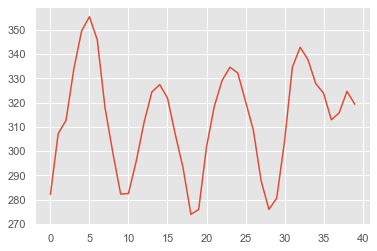

no_event no_event 1


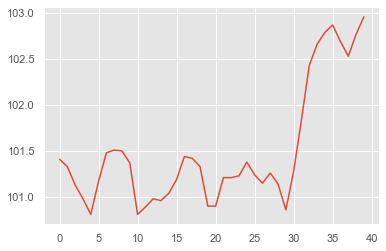

no_event no_event 2


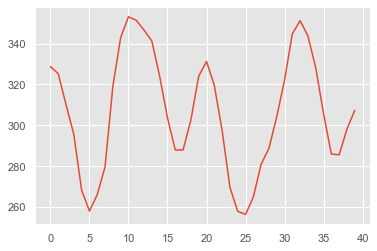

no_event no_event 1


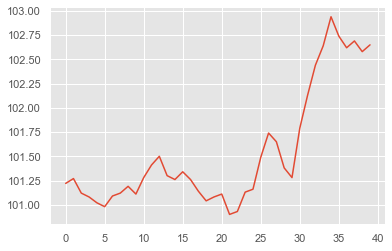

no_event no_event 2


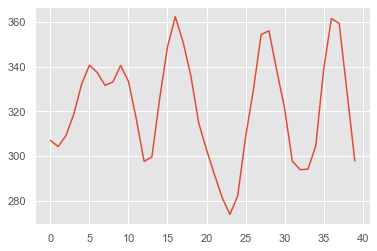

no_event no_event 1


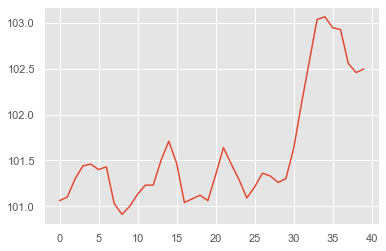

no_event no_event 2


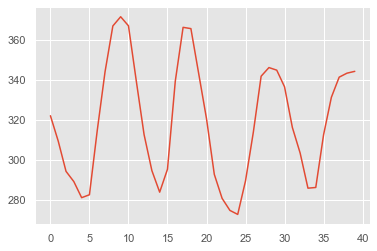

no_event no_event 1


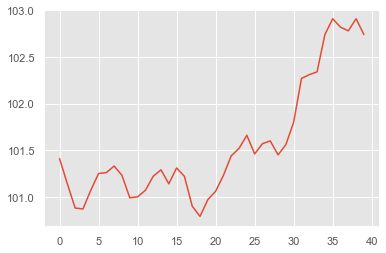

no_event no_event 2


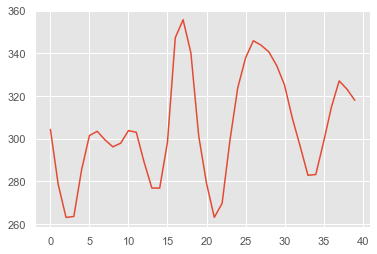

no_event no_event 1


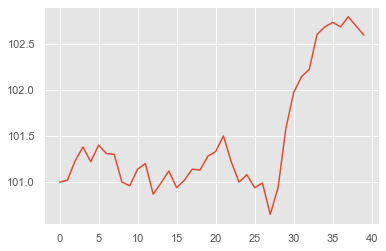

no_event no_event 2


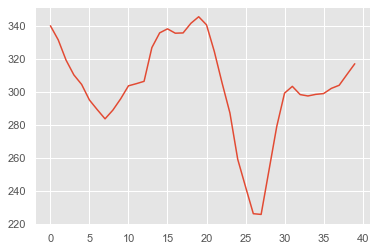

no_event no_event 2


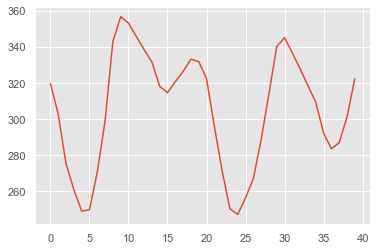

no_event no_event 1


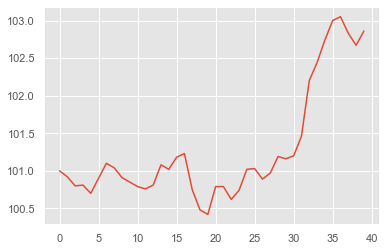

no_event no_event 2


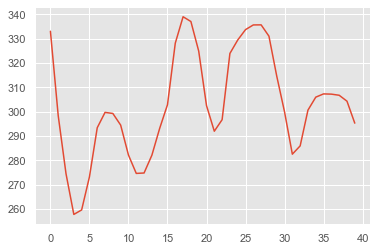

no_event no_event 1


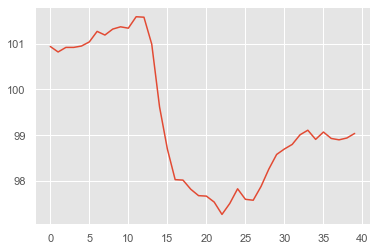

no_event no_event 2


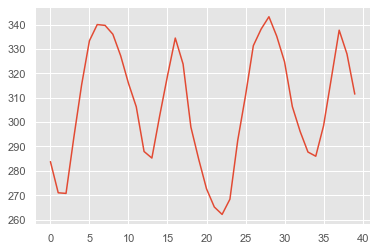

no_event no_event 1


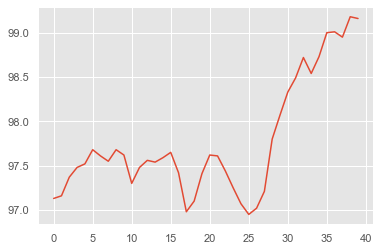

no_event no_event 2


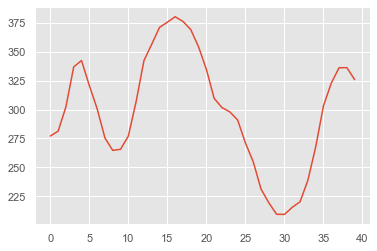

no_event no_event 2


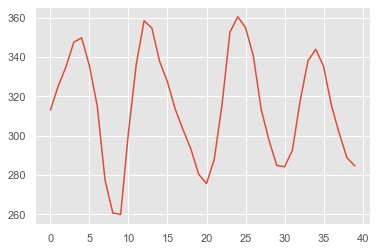

no_event no_event 1


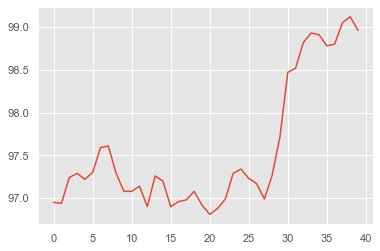

no_event no_event 2


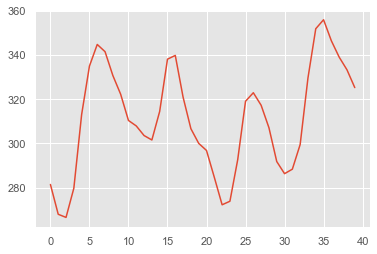

no_event no_event 1


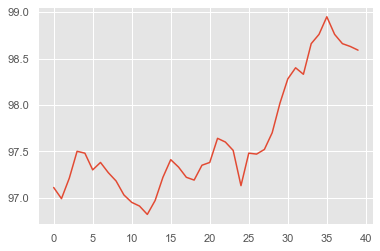

no_event no_event 2


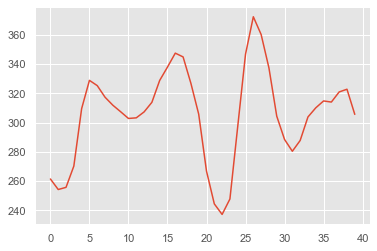

no_event no_event 2


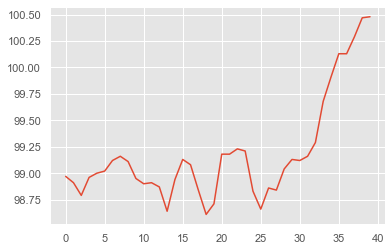

no_event no_event 2


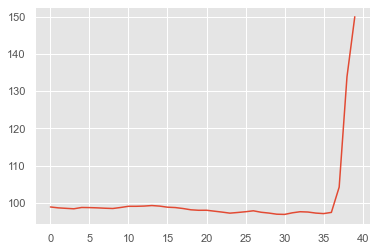

no_event no_event 2


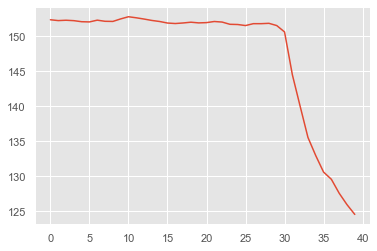

no_event no_event 1


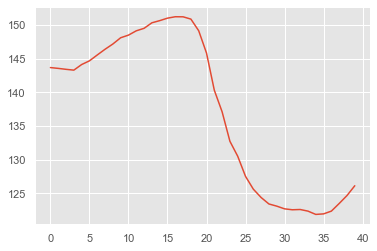

no_event no_event 1


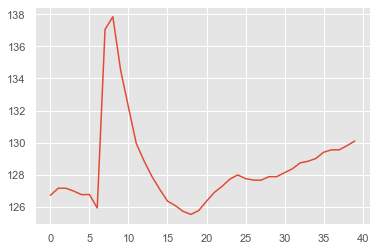

no_event no_event 1


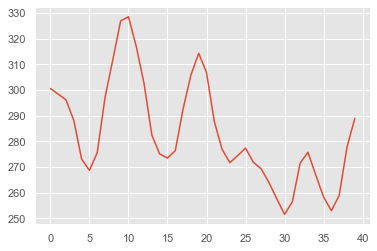

no_event no_event 2


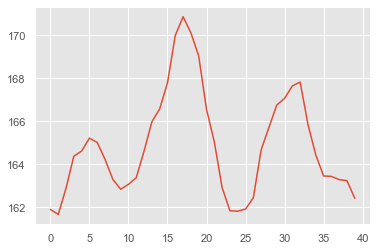

no_event no_event 2


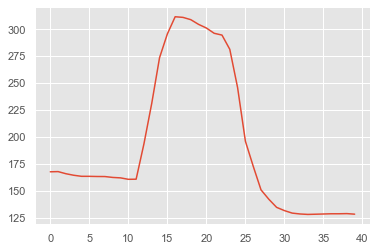

no_event no_event 2


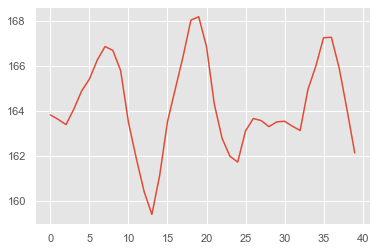

no_event no_event 2


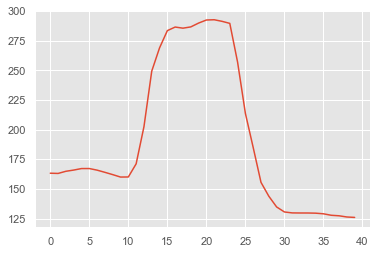

no_event no_event 1


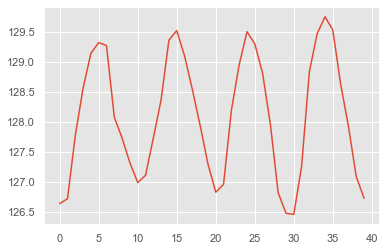

no_event no_event 1


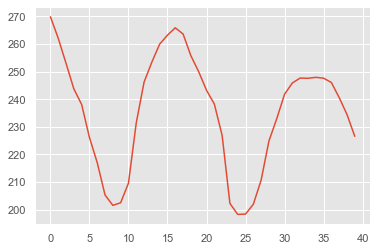

no_event no_event 2


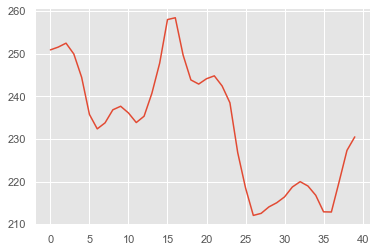

no_event no_event 2


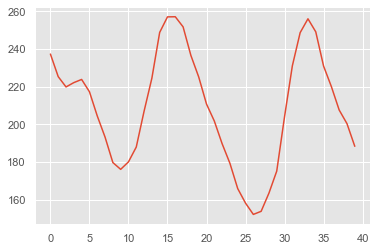

no_event no_event 2


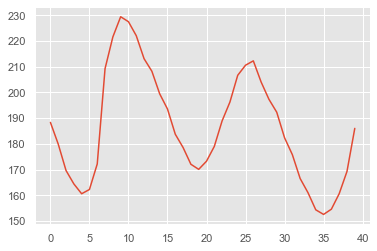

no_event no_event 2


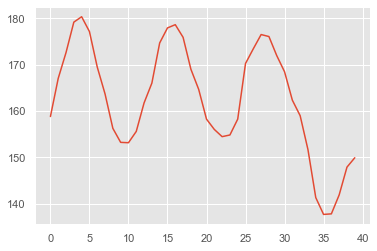

no_event no_event 2


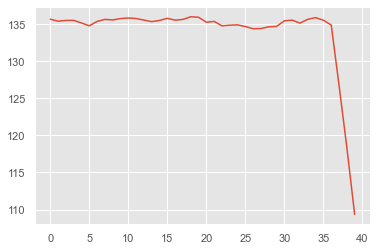

no_event no_event 1


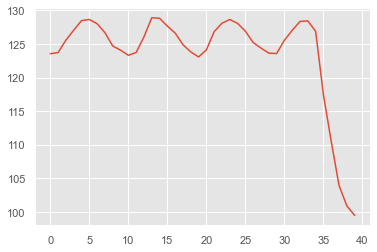

no_event no_event 2


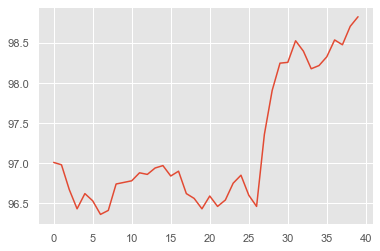

no_event no_event 2


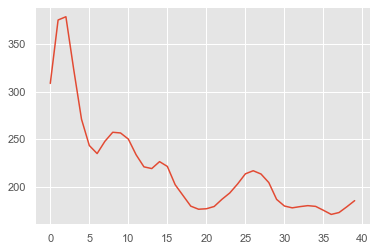

no_event no_event 2


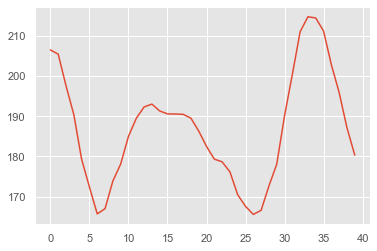

no_event no_event 1


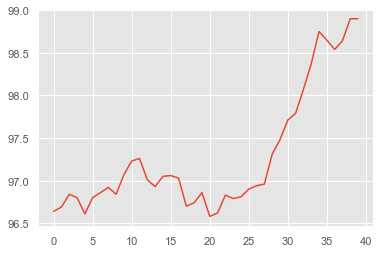

no_event no_event 1


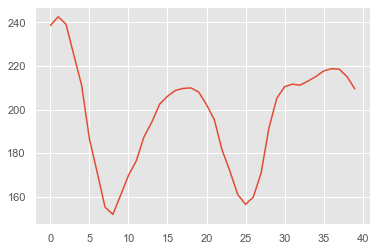

no_event no_event 2


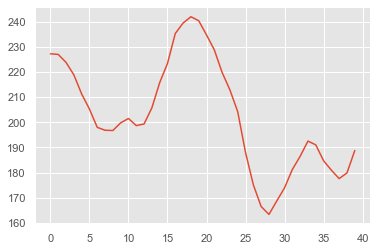

no_event no_event 1


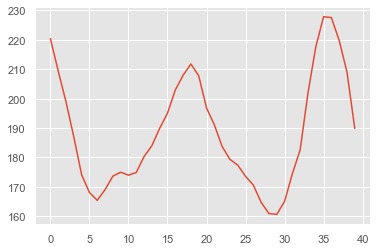

no_event no_event 2


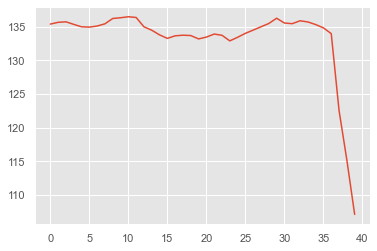

no_event no_event 1


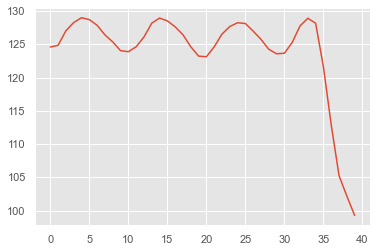

no_event no_event 2


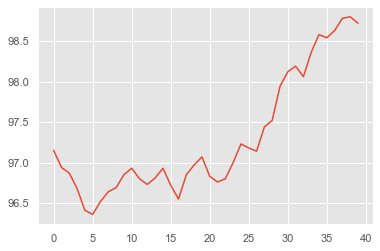

no_event no_event 2


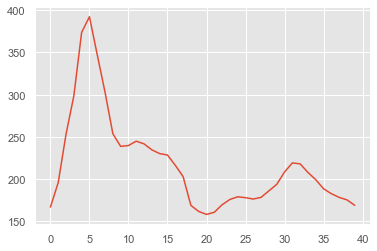

no_event no_event 2


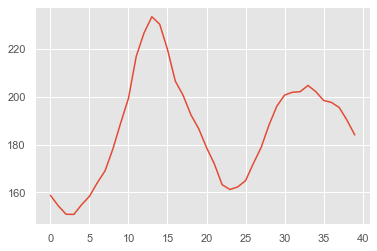

no_event no_event 1


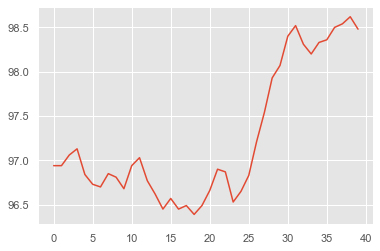

no_event no_event 1


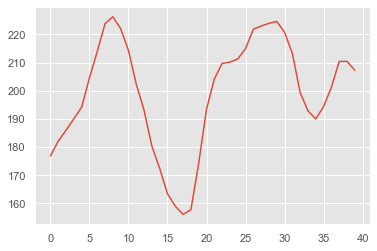

no_event no_event 2


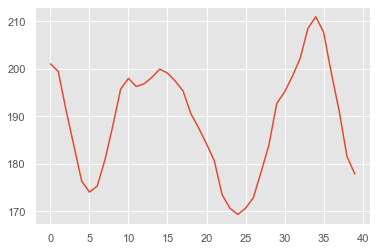

no_event no_event 1


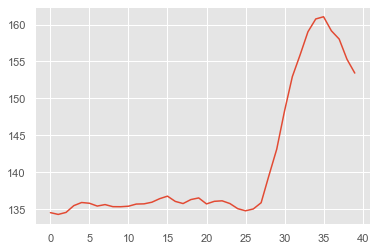

no_event no_event 1


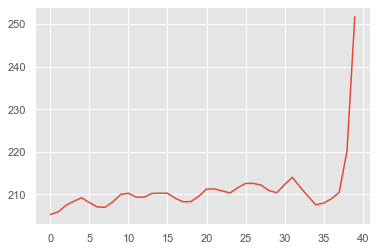

no_event no_event 2


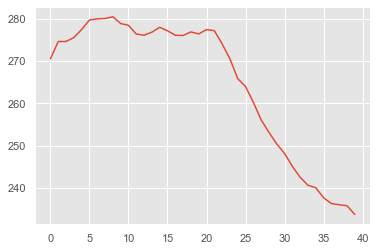

no_event no_event 1


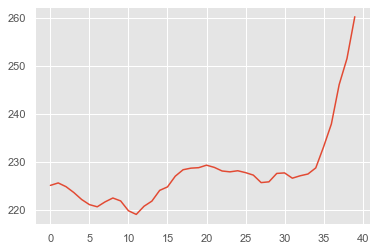

no_event no_event 2


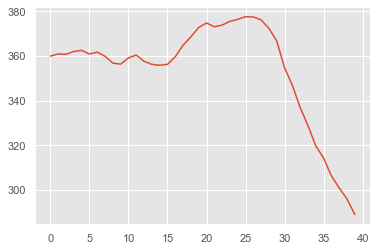

no_event no_event 2


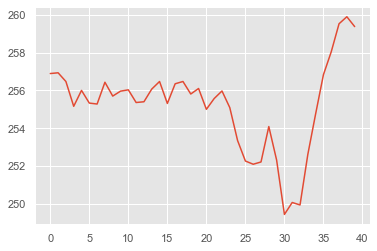

no_event no_event 1


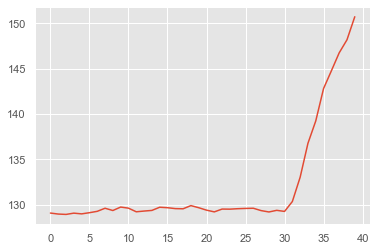

no_event no_event 1


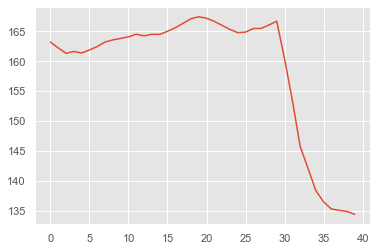

no_event no_event 1


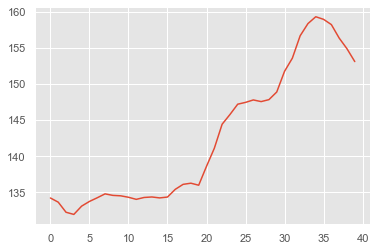

no_event no_event 1


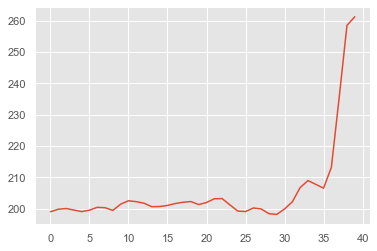

no_event no_event 1


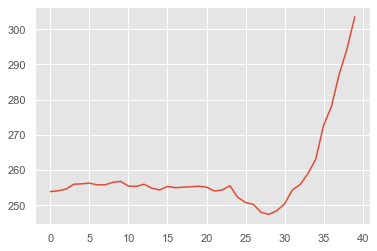

no_event no_event 2


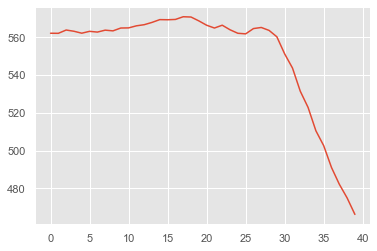

no_event no_event 1


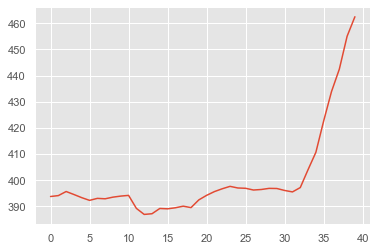

no_event no_event 2


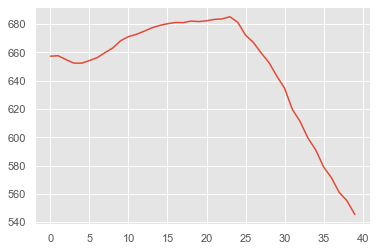

no_event no_event 2


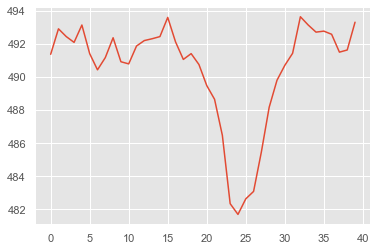

no_event no_event 1


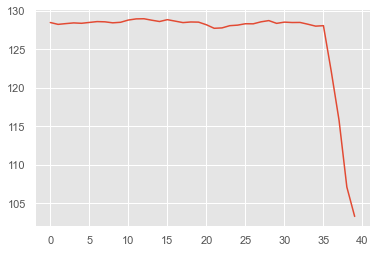

no_event no_event 1


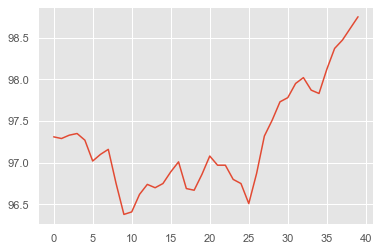

no_event no_event 2


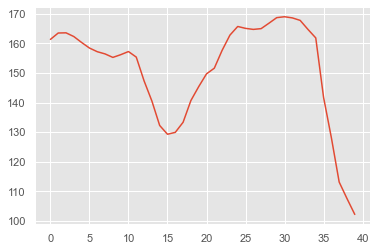

no_event no_event 1


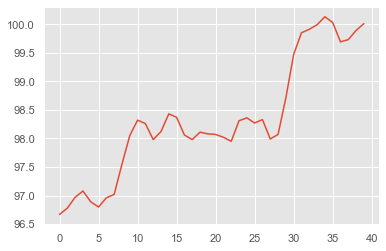

no_event no_event 1


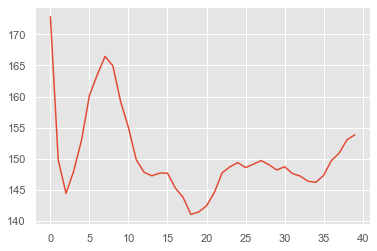

no_event no_event 2


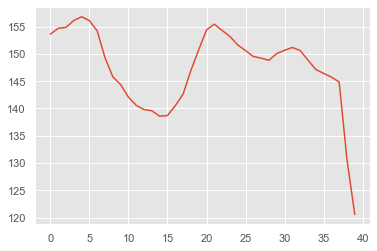

no_event no_event 1


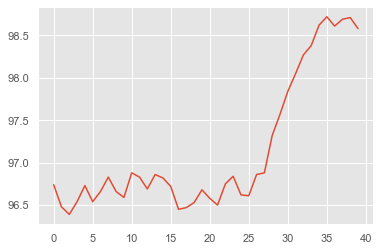

no_event no_event 1


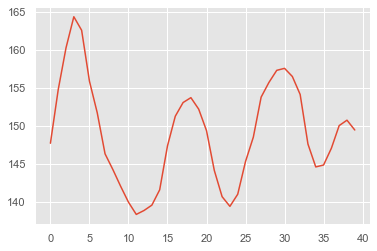

no_event no_event 2


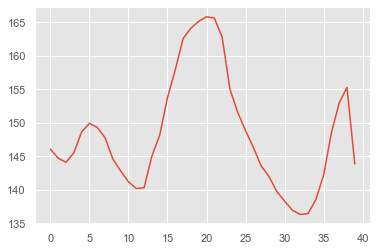

no_event no_event 1


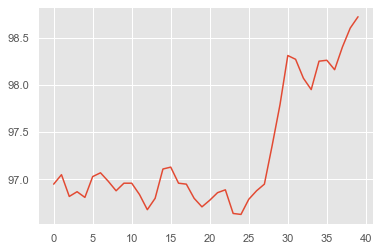

no_event no_event 1


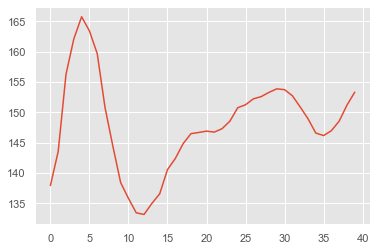

no_event no_event 2


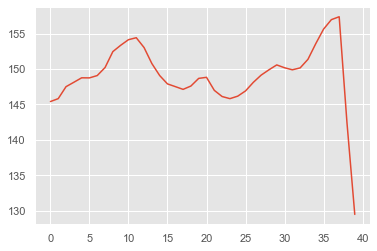

no_event Refrigerator_ON 1


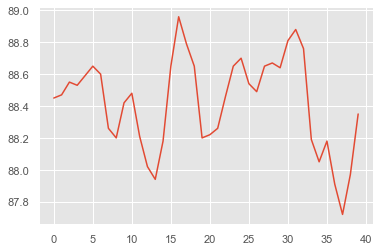

no_event no_event 2


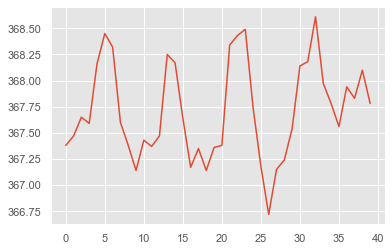

no_event Refrigerator_ON 1


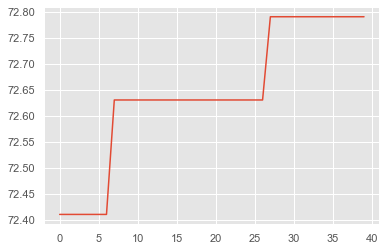

no_event no_event 2


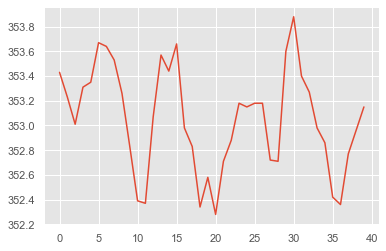

no_event no_event 1


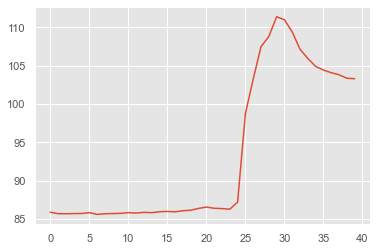

no_event no_event 1


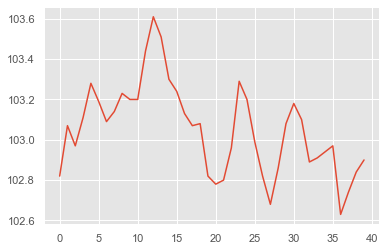

no_event no_event 1


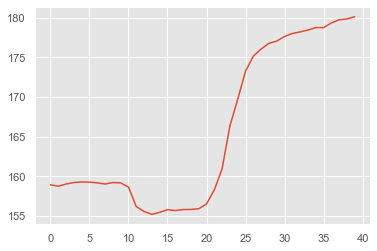

no_event no_event 1


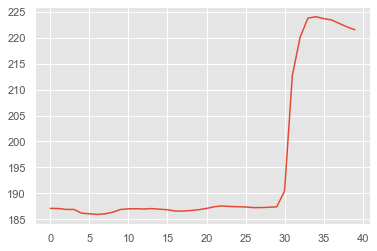

no_event no_event 1


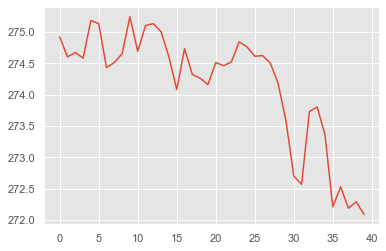

no_event Geyser_ON 2


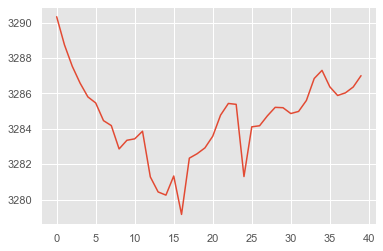

no_event no_event 1


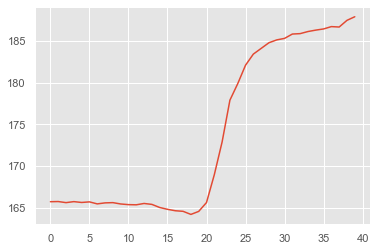

no_event no_event 1


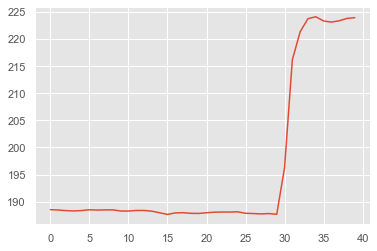

no_event no_event 2


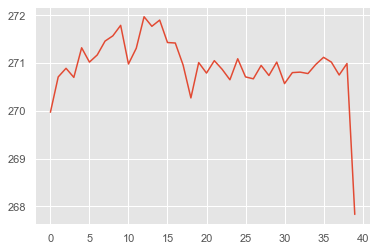

no_event no_event 1


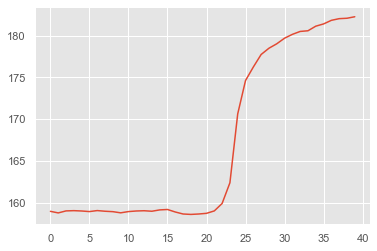

no_event no_event 1


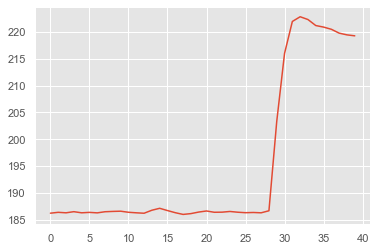

no_event no_event 1


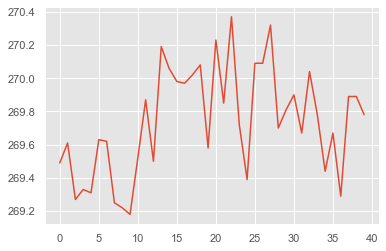

no_event no_event 2


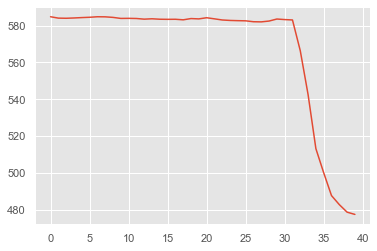

no_event no_event 2


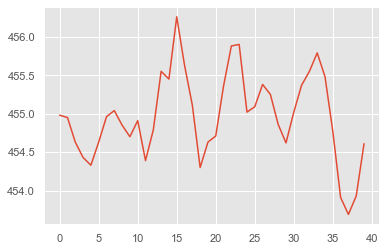

no_event Refrigerator_ON 1


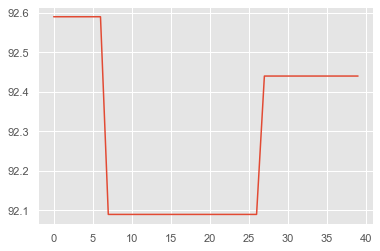

no_event no_event 2


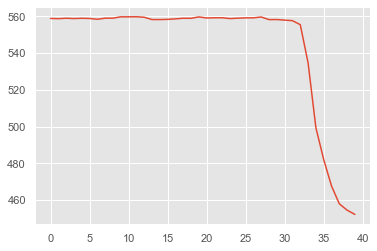

no_event no_event 2


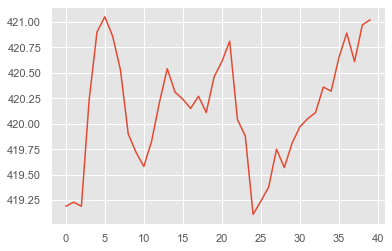

no_event no_event 2


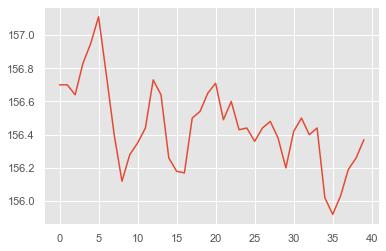

no_event no_event 1


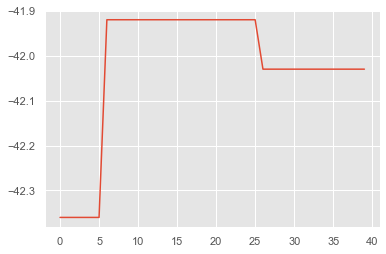

no_event no_event 2


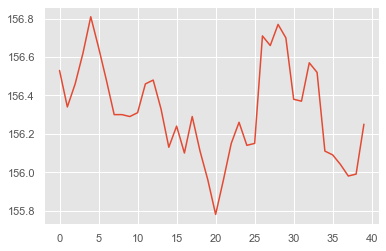

no_event no_event 1


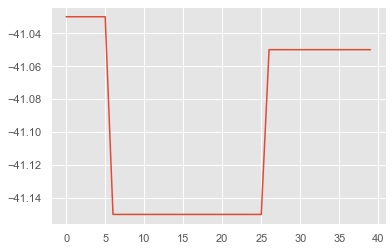

no_event no_event 1


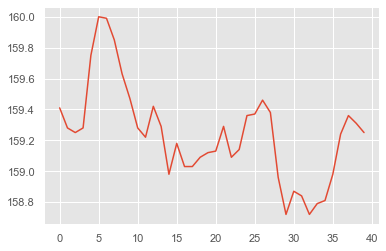

no_event no_event 2


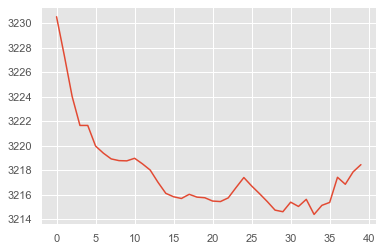

no_event no_event 1


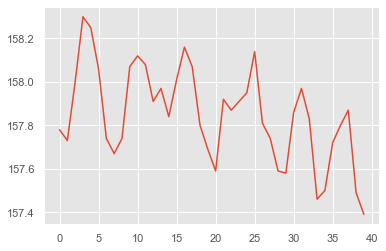

no_event no_event 2


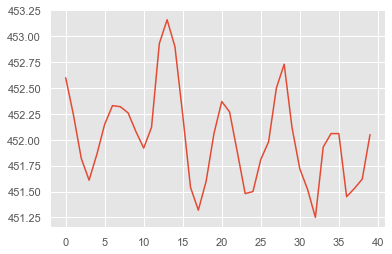

no_event no_event 1


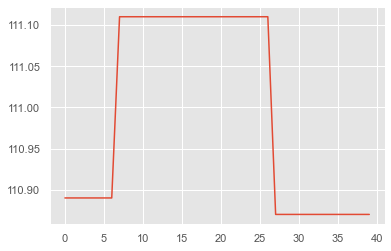

no_event no_event 2


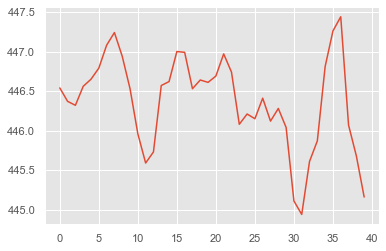

no_event Refrigerator_ON 1


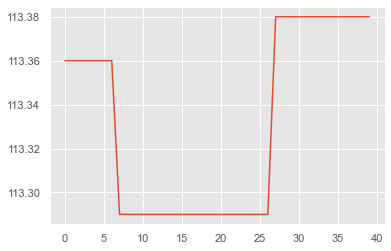

no_event no_event 2


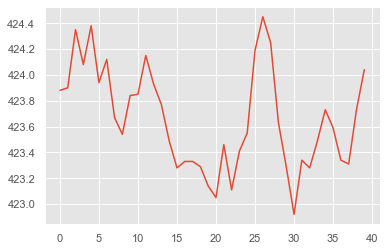

no_event no_event 1


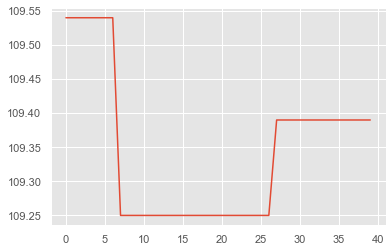

no_event no_event 2


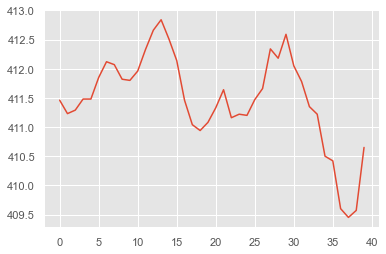

no_event no_event 2


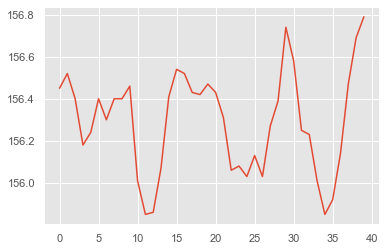

no_event no_event 1


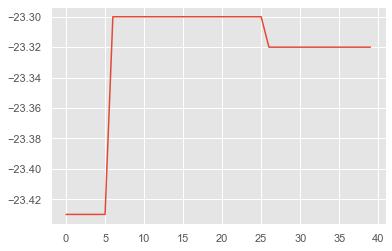

no_event no_event 2


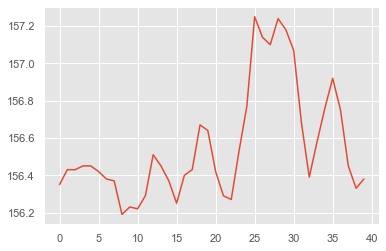

no_event no_event 1


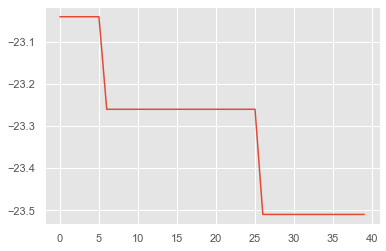

no_event no_event 2


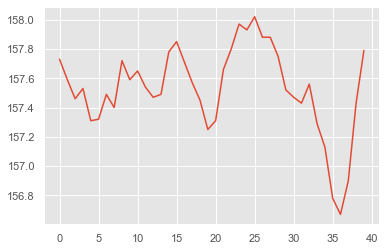

no_event no_event 1


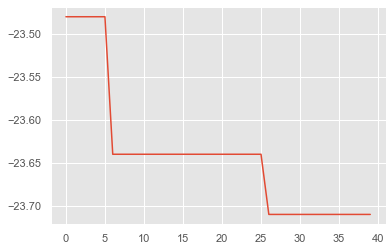

no_event no_event 2


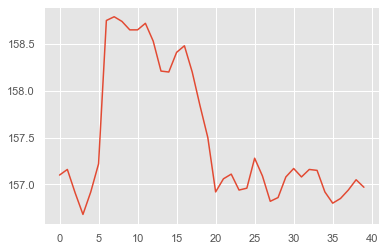

no_event no_event 1


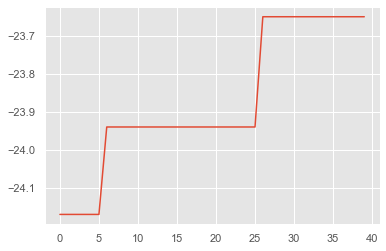

no_event no_event 2


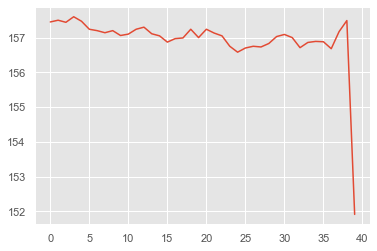

no_event no_event 2


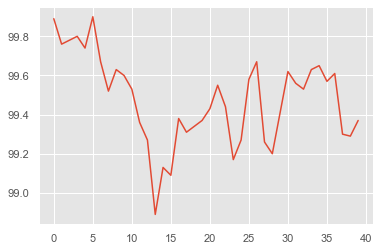

no_event no_event 1


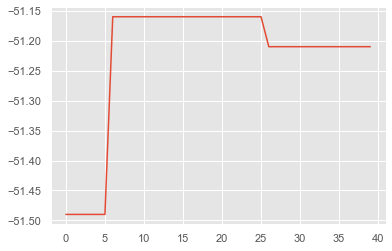

no_event no_event 2


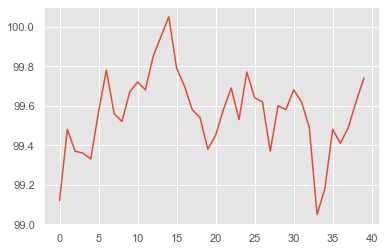

no_event no_event 2


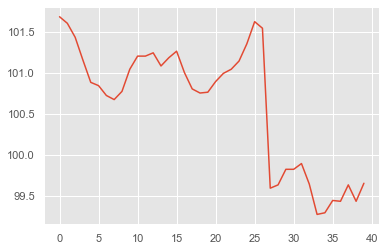

no_event no_event 1


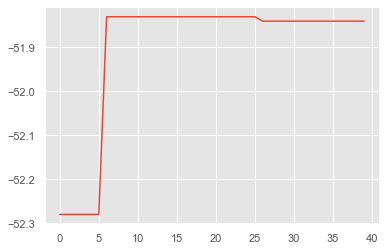

no_event no_event 2


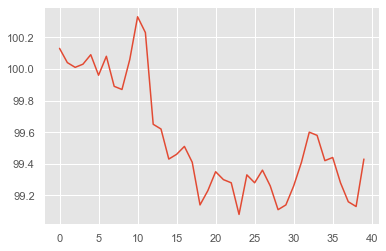

no_event no_event 1


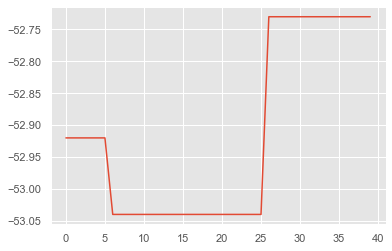

no_event no_event 1


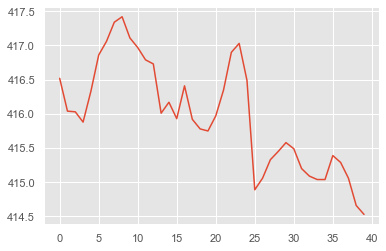

no_event no_event 1


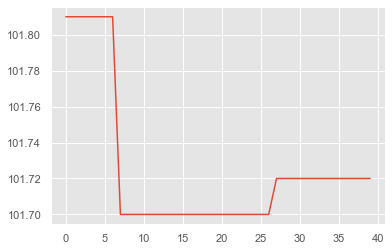

no_event no_event 2


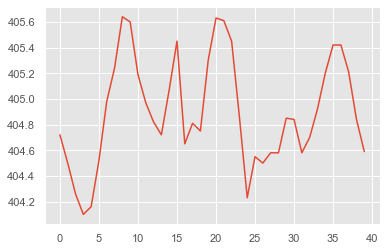

no_event no_event 2


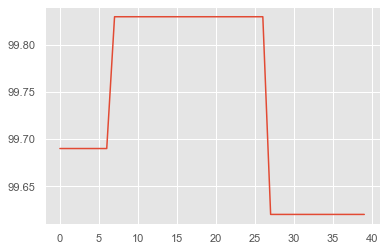

no_event no_event 1


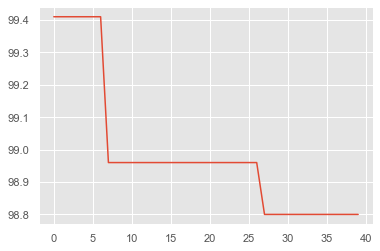

no_event no_event 1


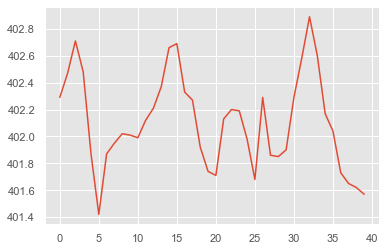

no_event no_event 1


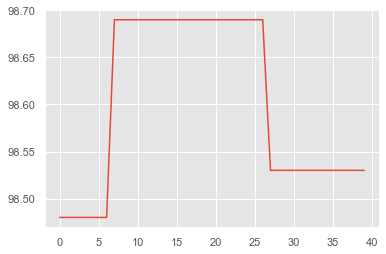

no_event no_event 2


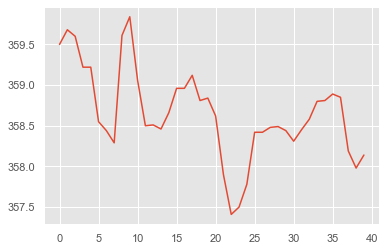

no_event no_event 1


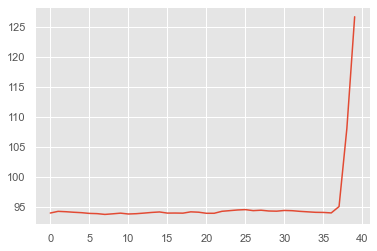

no_event no_event 1


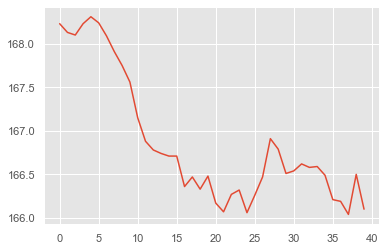

no_event no_event 2


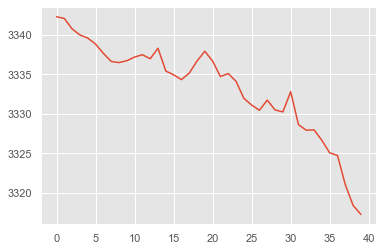

no_event no_event 2


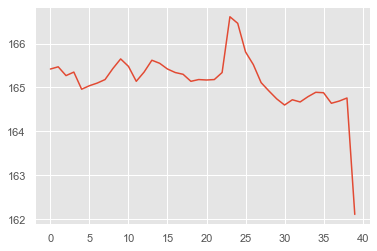

no_event no_event 2


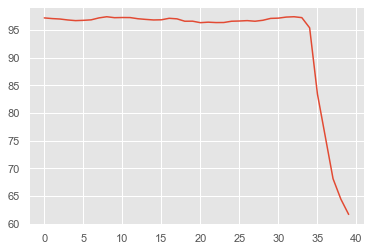

no_event no_event 1


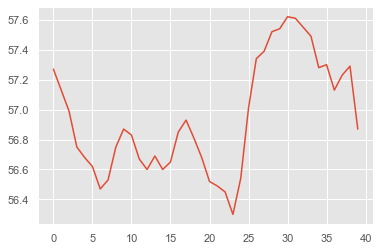

no_event no_event 2


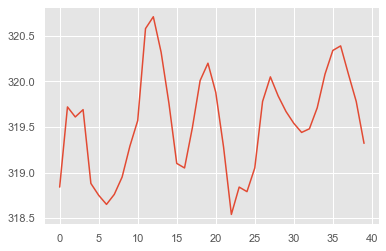

no_event no_event 1


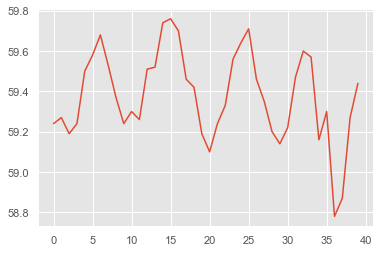

no_event no_event 2


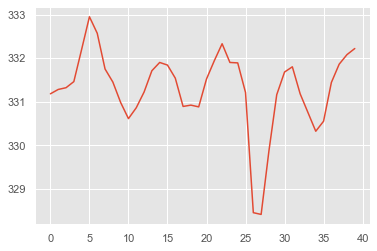

no_event no_event 1


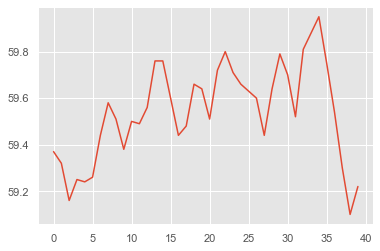

no_event no_event 2


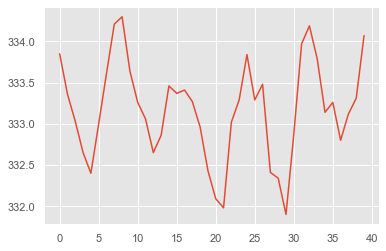

no_event no_event 1


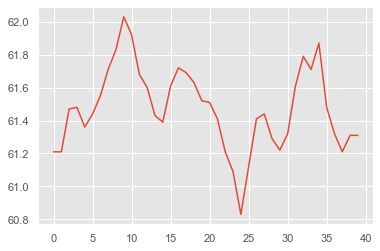

no_event no_event 2


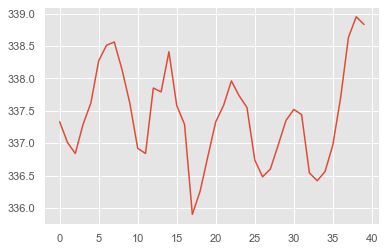

no_event no_event 2


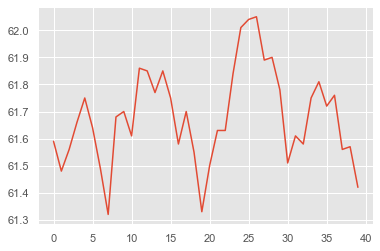

no_event Refrigerator_ON 1


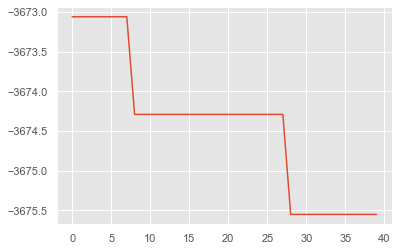

no_event no_event 1


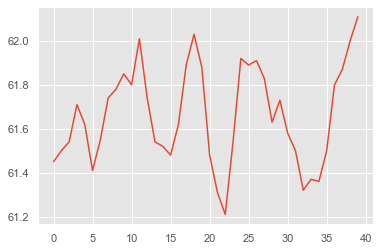

no_event no_event 2


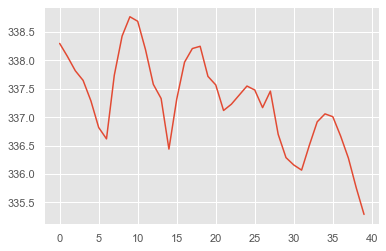

no_event no_event 2


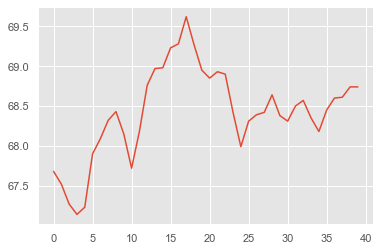

no_event no_event 1


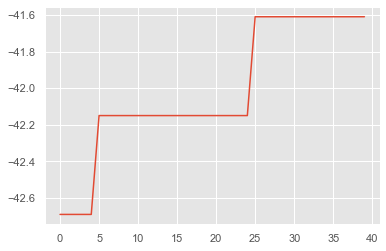

no_event no_event 2


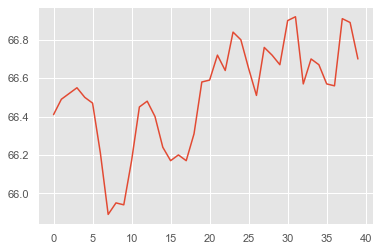

no_event no_event 1


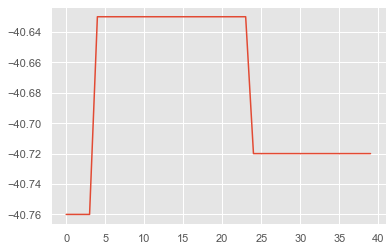

no_event no_event 1


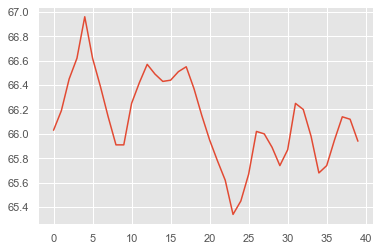

no_event no_event 2


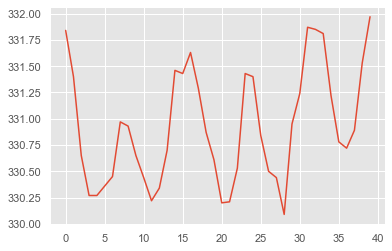

no_event no_event 2


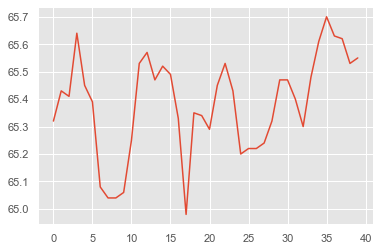

no_event no_event 1


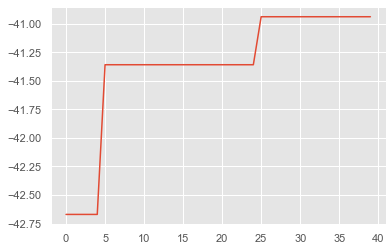

no_event no_event 1


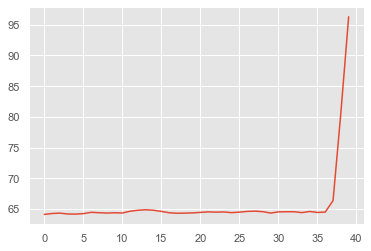

no_event no_event 1


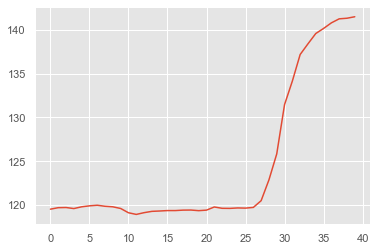

no_event no_event 1


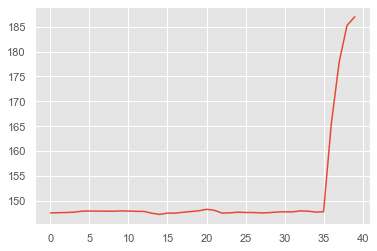

no_event no_event 2


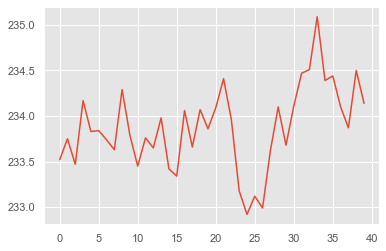

no_event no_event 1


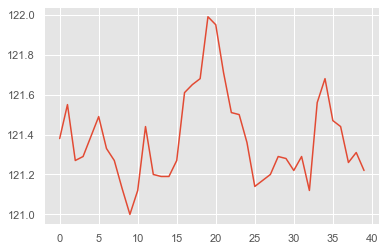

no_event no_event 2


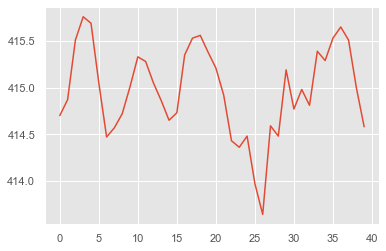

no_event Refrigerator_ON 1


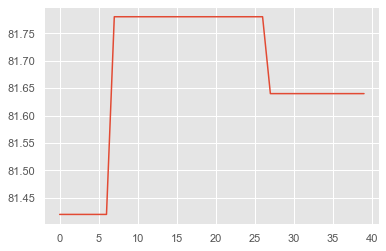

no_event no_event 1


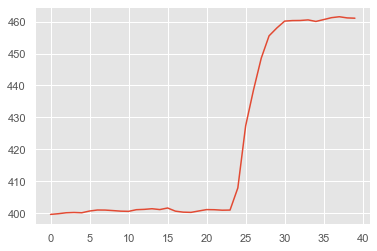

no_event no_event 2


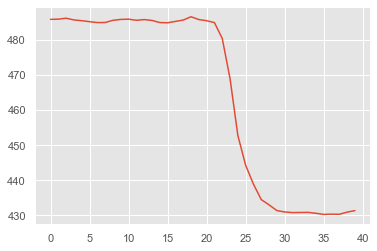

no_event no_event 2


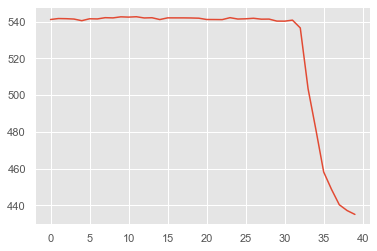

no_event Refrigerator_ON 2


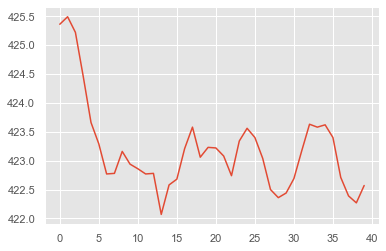

no_event no_event 1


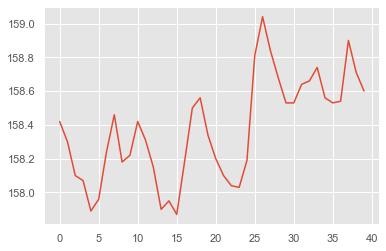

no_event no_event 2


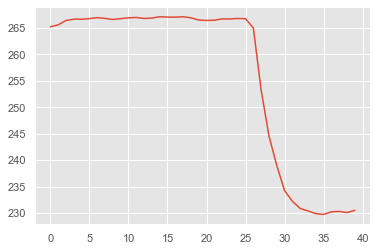

no_event no_event 1


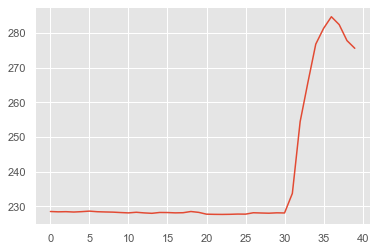

no_event no_event 2


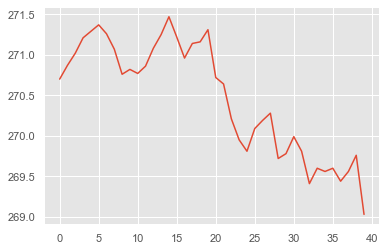

no_event no_event 1


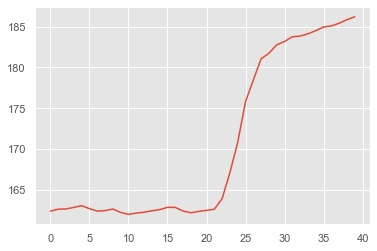

no_event no_event 1


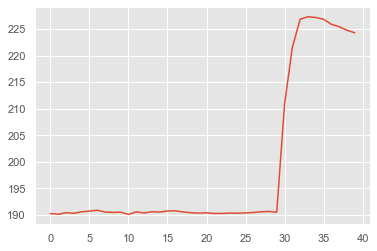

no_event no_event 2


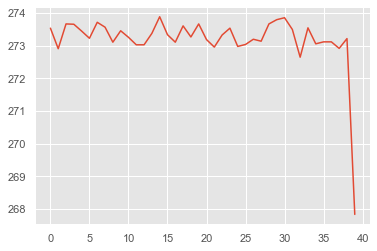

no_event no_event 2


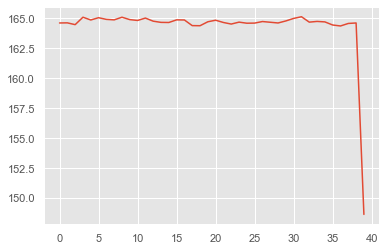

no_event no_event 2


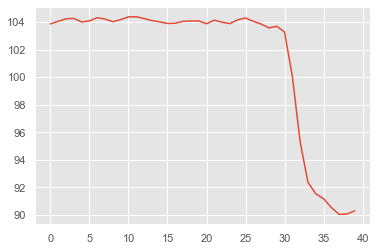

no_event no_event 1


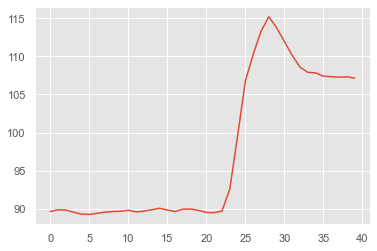

no_event no_event 1


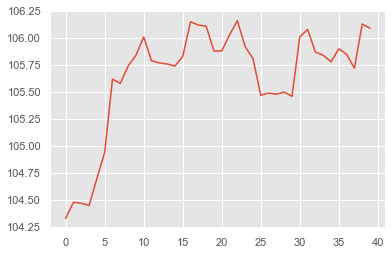

no_event Geyser_ON 1


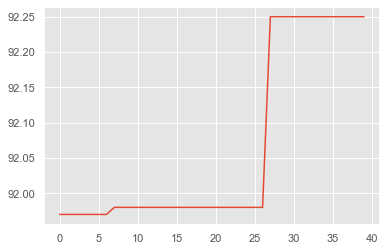

no_event no_event 1


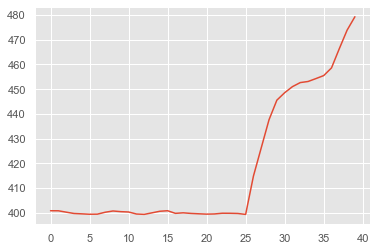

no_event no_event 2


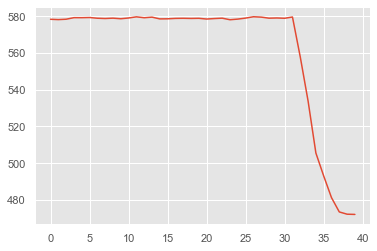

no_event no_event 2


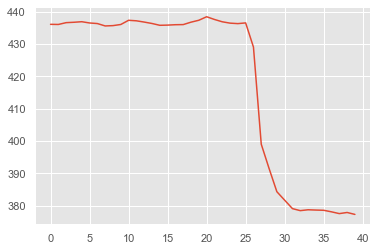

no_event no_event 2


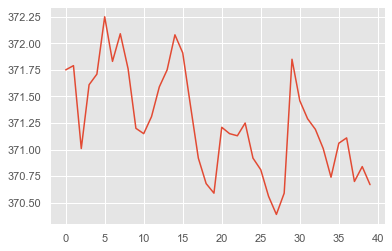

no_event no_event 2


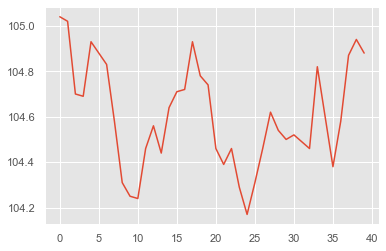

no_event no_event 1


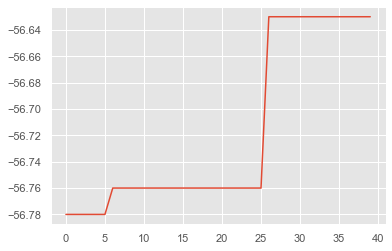

no_event no_event 2


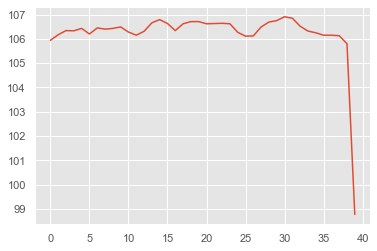

no_event no_event 2


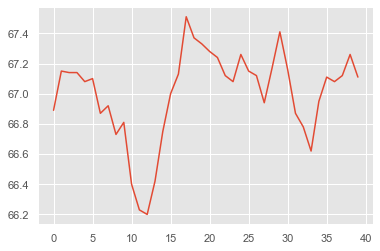

no_event no_event 1


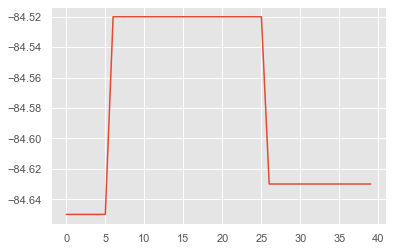

no_event no_event 2


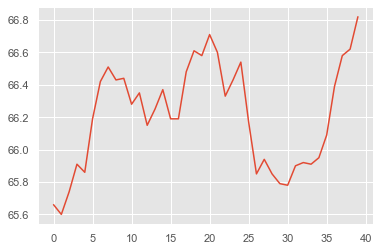

no_event no_event 1


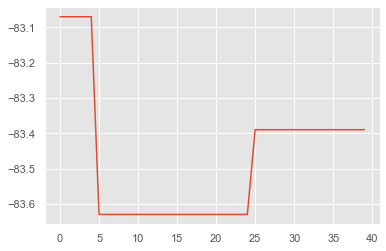

no_event no_event 1


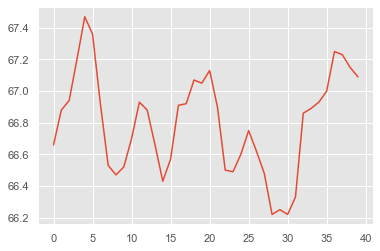

no_event no_event 2


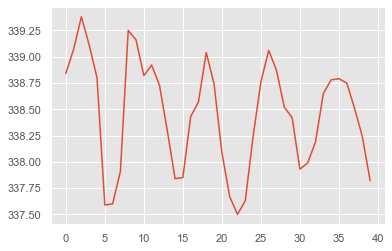

no_event no_event 2


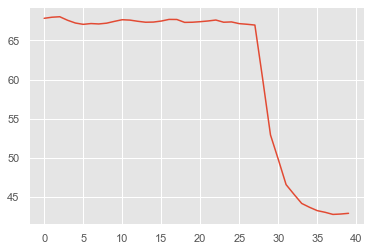

no_event no_event 1


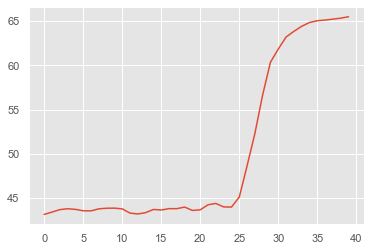

no_event no_event 1


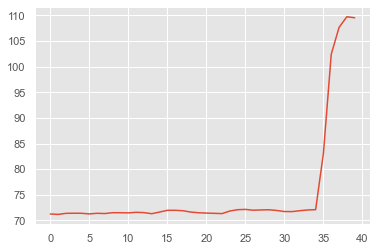

no_event no_event 1


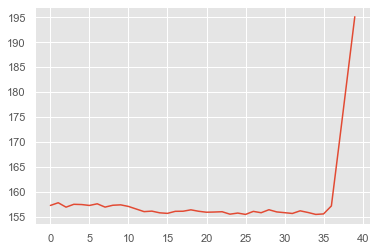

no_event no_event 2


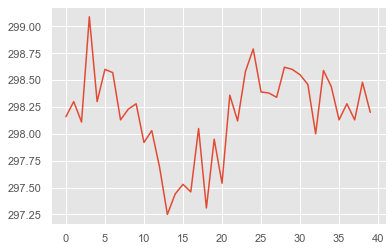

no_event no_event 2


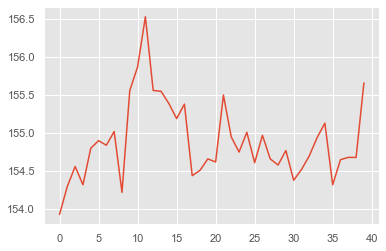

no_event no_event 1


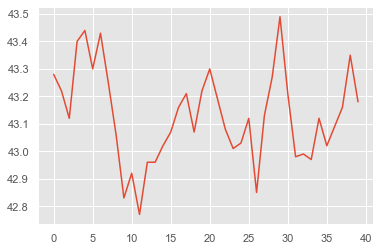

no_event no_event 2


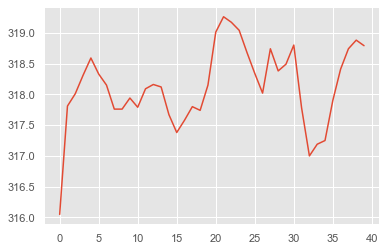

no_event no_event 2


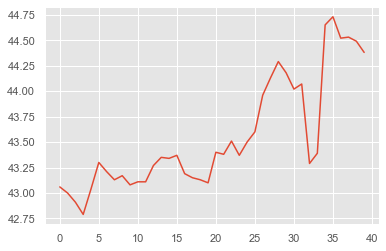

no_event no_event 1


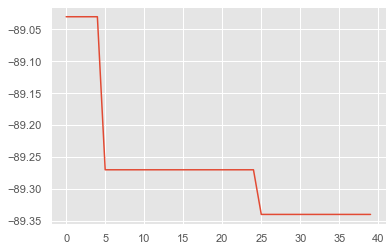

no_event no_event 2


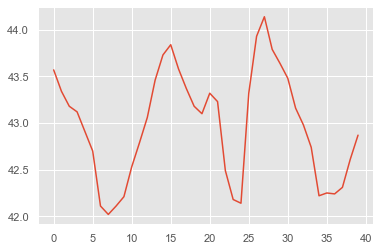

no_event no_event 1


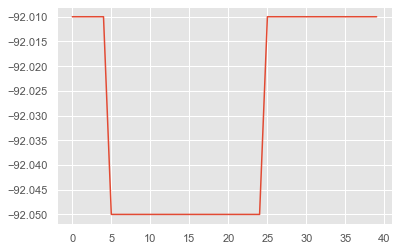

no_event no_event 1


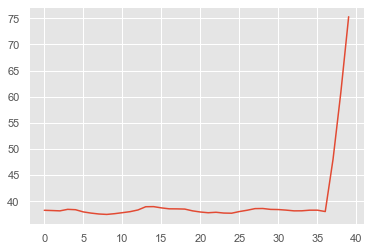

no_event no_event 1


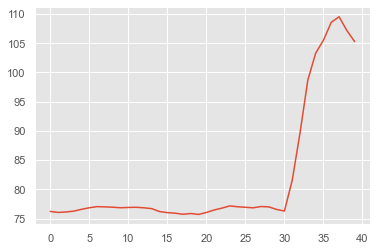

no_event no_event 1


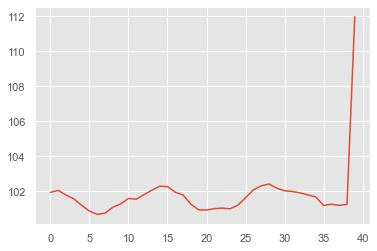

no_event no_event 1


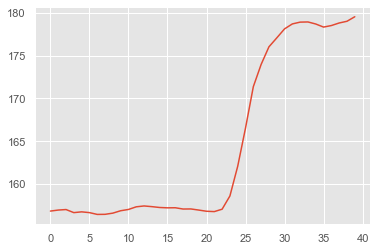

no_event no_event 1


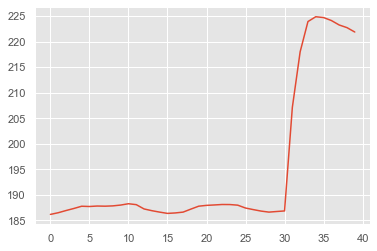

no_event no_event 2


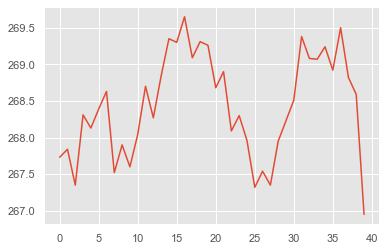

no_event no_event 1


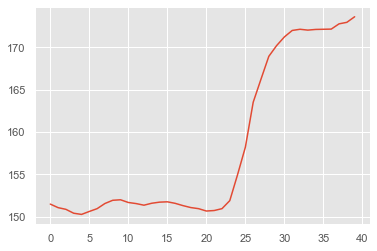

no_event no_event 1


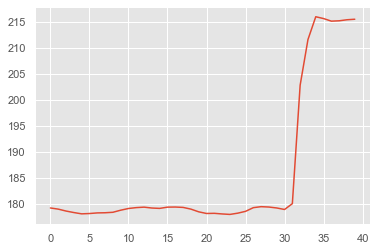

no_event no_event 1


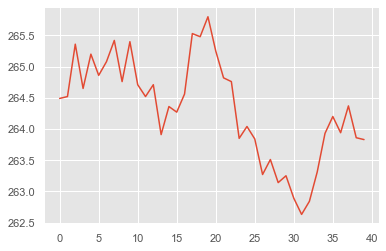

no_event no_event 2


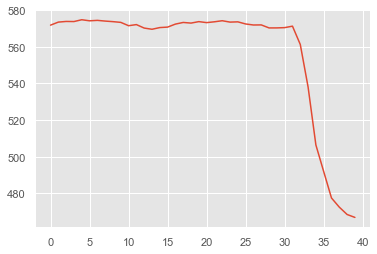

no_event no_event 2


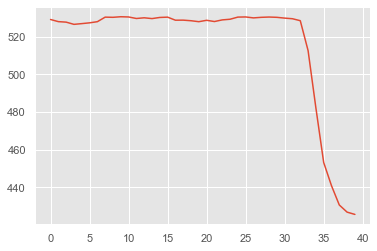

no_event no_event 2


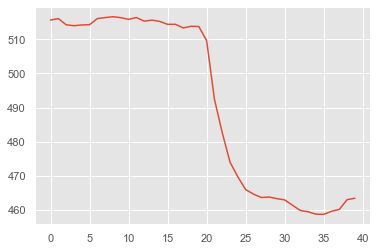

no_event no_event 2


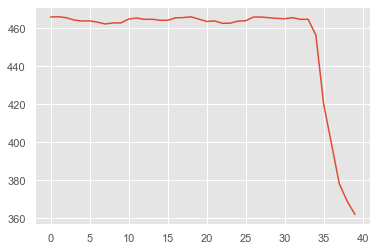

no_event no_event 2


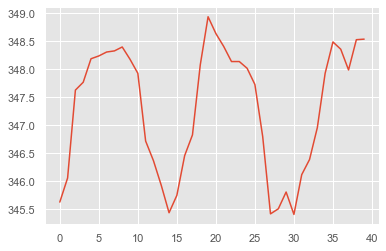

no_event no_event 1


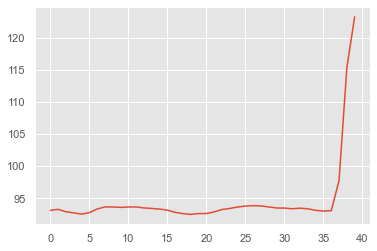

no_event no_event 1


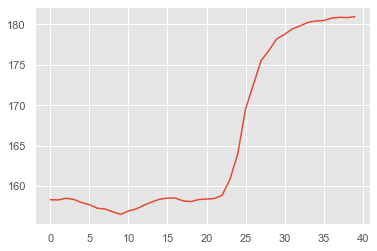

no_event no_event 1


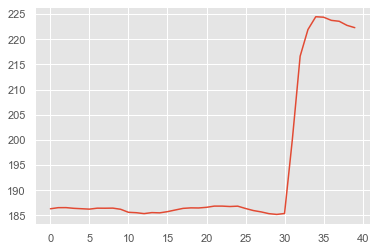

no_event no_event 2


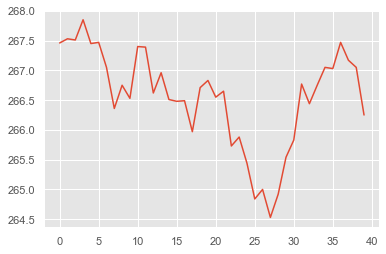

no_event no_event 1


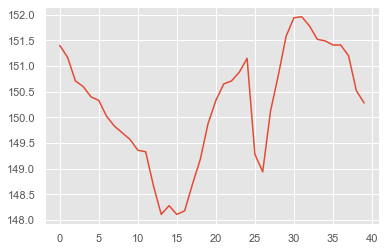

no_event no_event 2


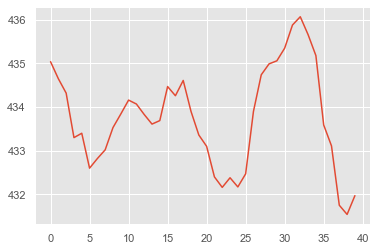

no_event no_event 2


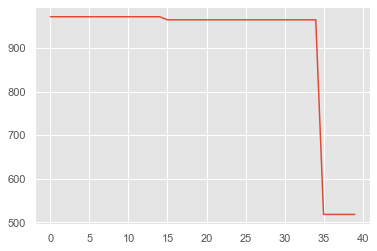

no_event no_event 1


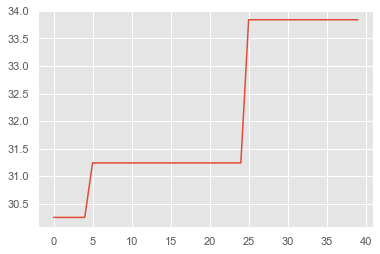

no_event no_event 1


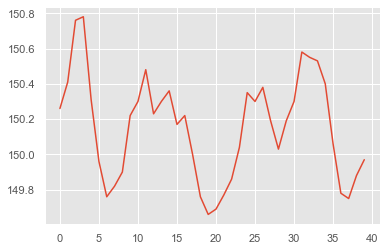

no_event no_event 2


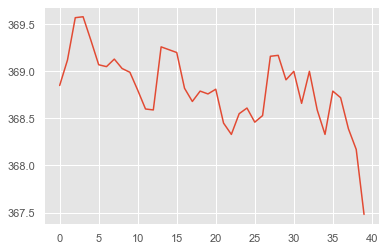

no_event no_event 1


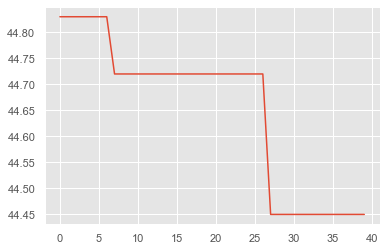

no_event no_event 2


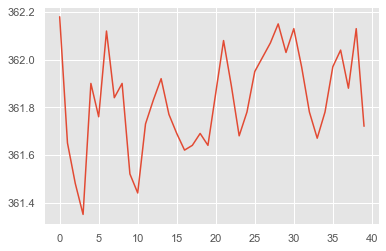

no_event no_event 1


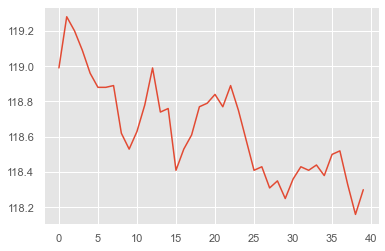

no_event no_event 1


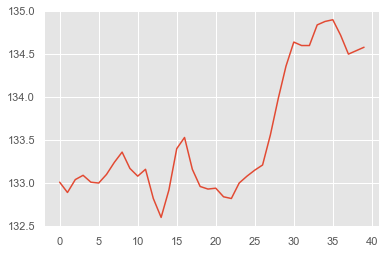

no_event no_event 2


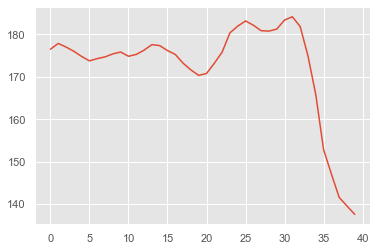

no_event no_event 1


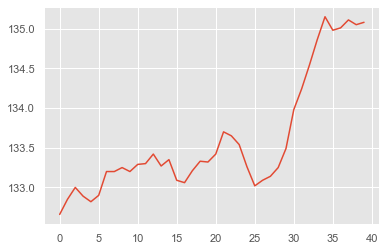

no_event no_event 2


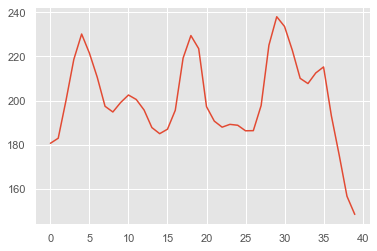

no_event no_event 1


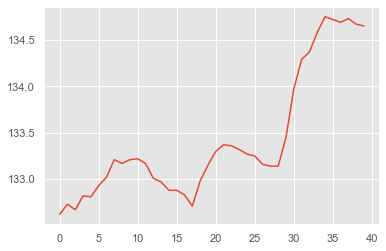

no_event no_event 2


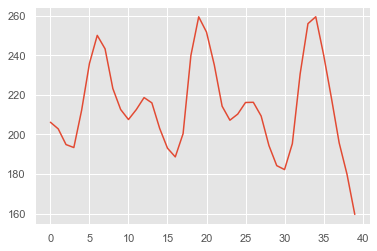

no_event no_event 1


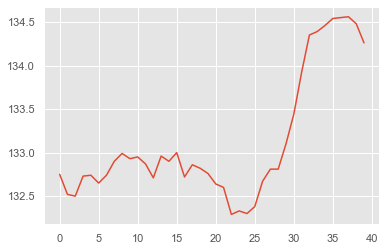

no_event no_event 2


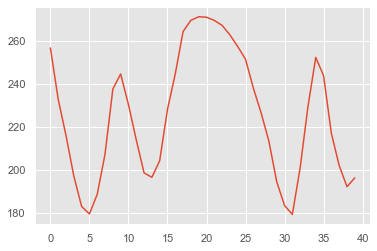

no_event no_event 1


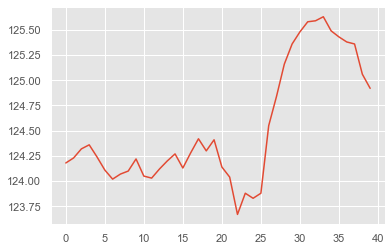

no_event no_event 1


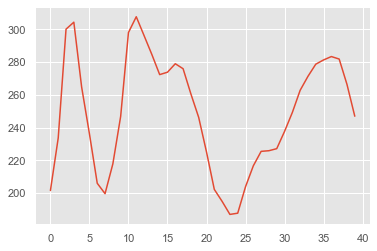

no_event no_event 2


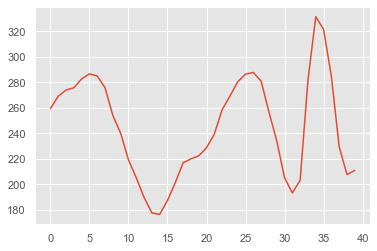

no_event no_event 2


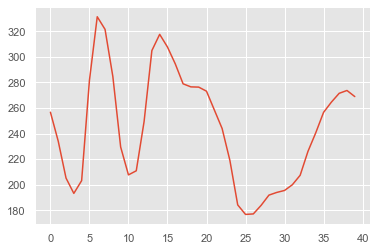

no_event no_event 2


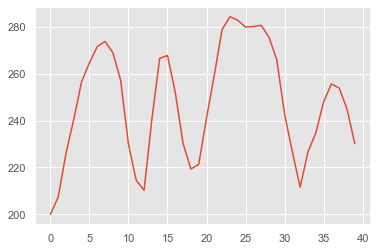

no_event no_event 2


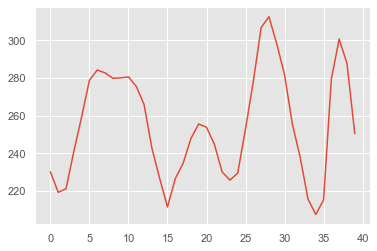

no_event no_event 1


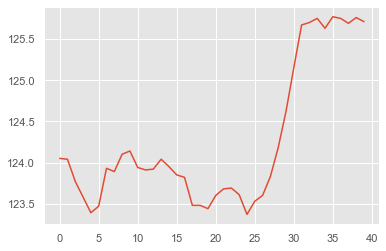

no_event no_event 1


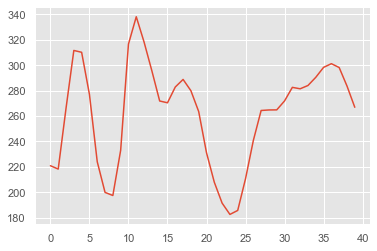

no_event no_event 1


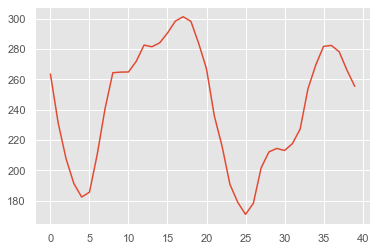

no_event no_event 2


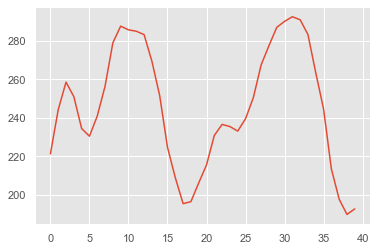

no_event no_event 1


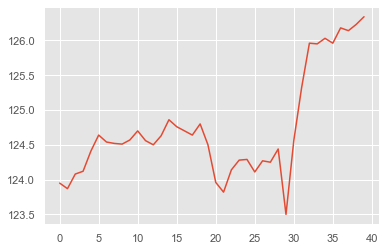

no_event no_event 2


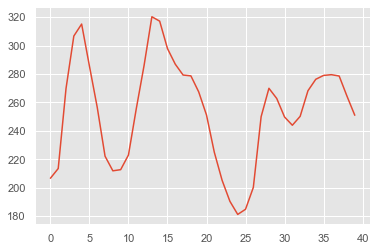

no_event no_event 2


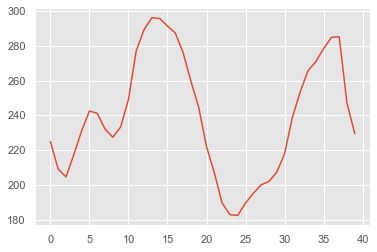

no_event no_event 1


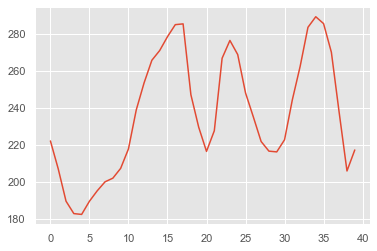

no_event no_event 1


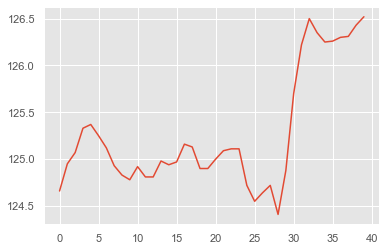

no_event no_event 1


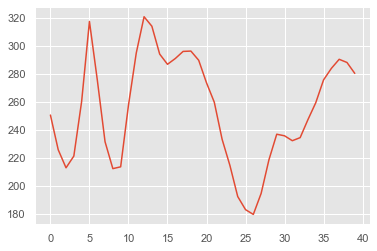

no_event no_event 2


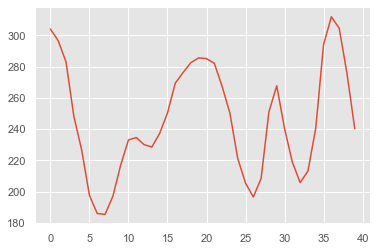

no_event no_event 1


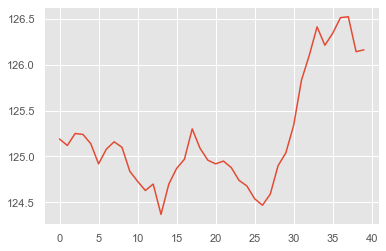

no_event no_event 2


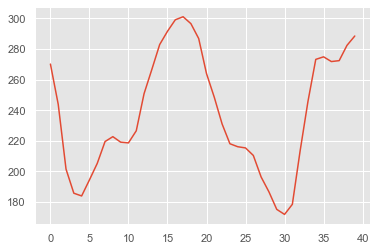

no_event no_event 1


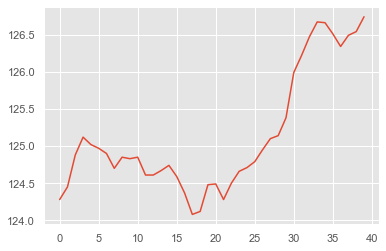

no_event no_event 1


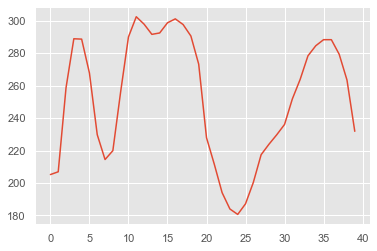

no_event no_event 2


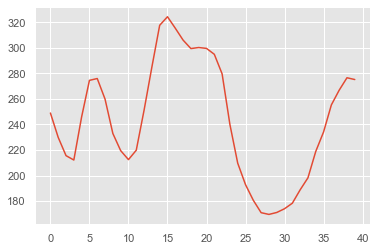

no_event no_event 2


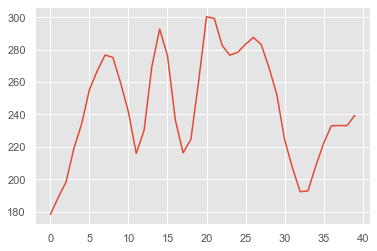

no_event no_event 2


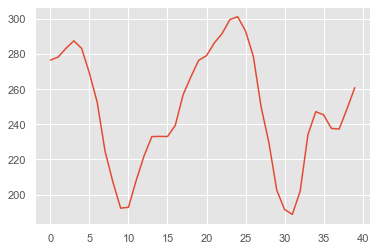

no_event no_event 1


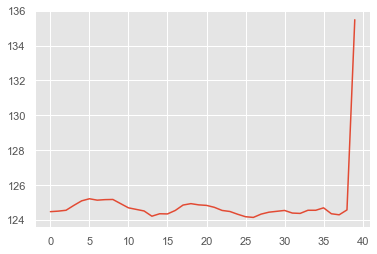

no_event no_event 2


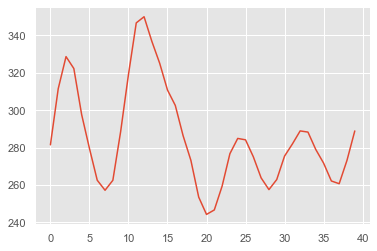

no_event no_event 2


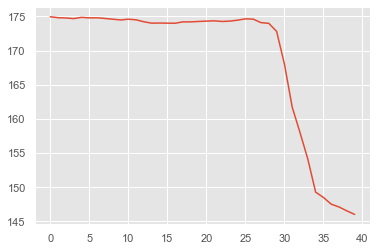

no_event no_event 1


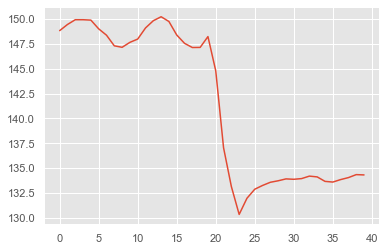

no_event no_event 1


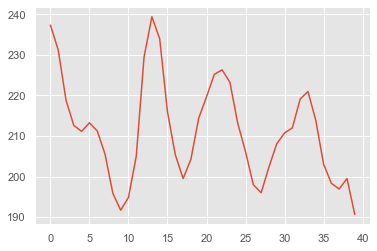

no_event no_event 2


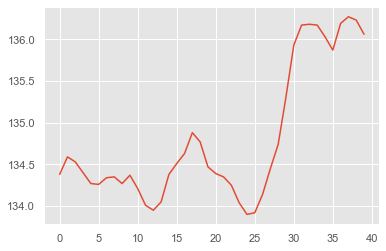

no_event no_event 1


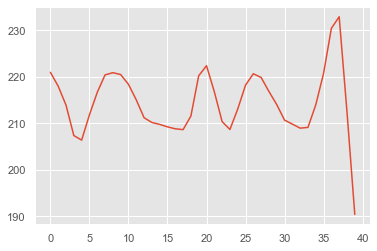

no_event no_event 2


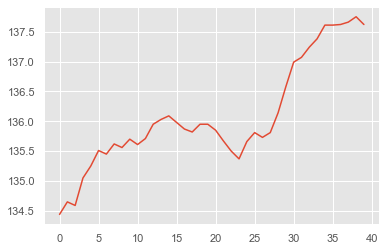

no_event no_event 1


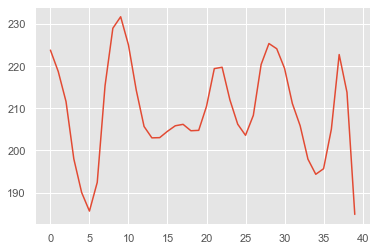

no_event no_event 2


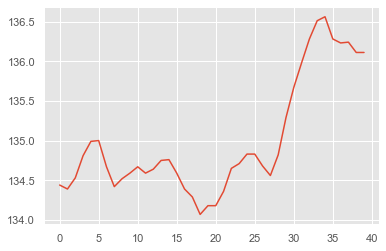

no_event no_event 2


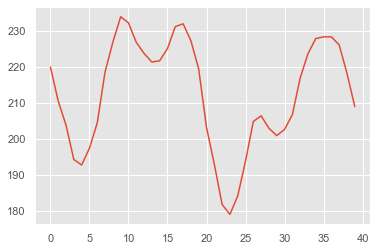

no_event no_event 2


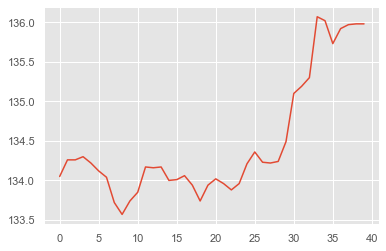

no_event no_event 1


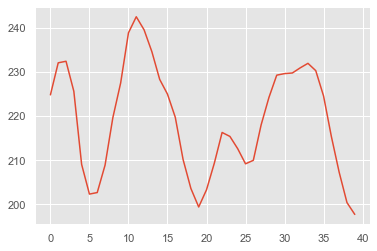

no_event no_event 2


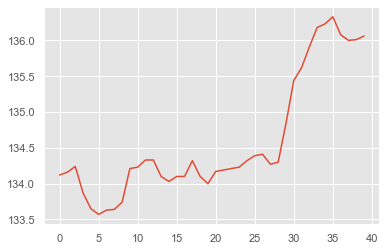

no_event no_event 1


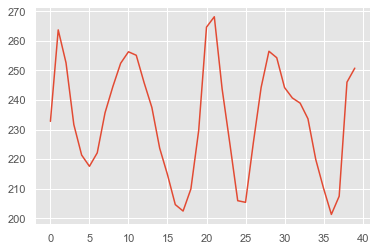

no_event no_event 2


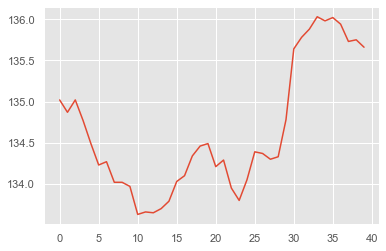

no_event no_event 1


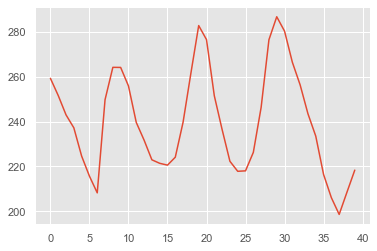

no_event no_event 2


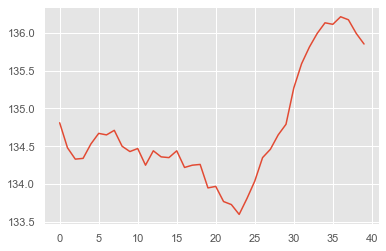

no_event no_event 2


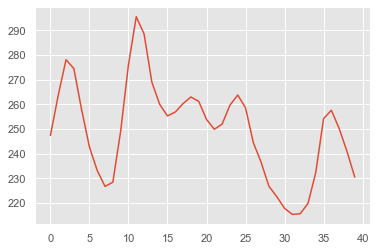

no_event no_event 2


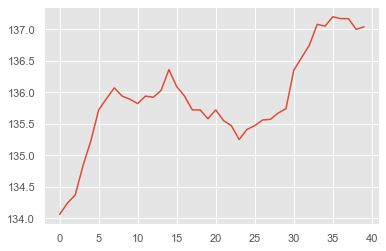

no_event no_event 1


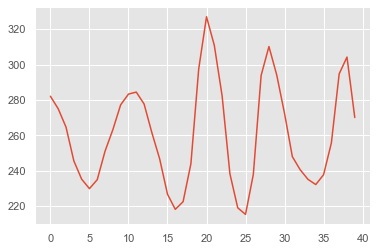

no_event no_event 2


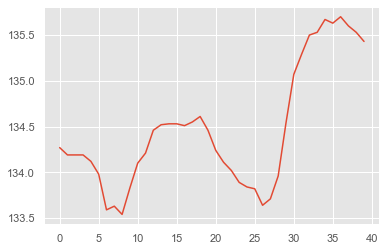

no_event no_event 2


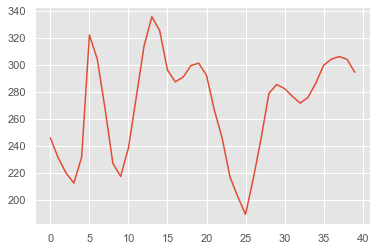

no_event no_event 2


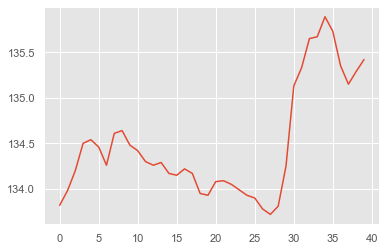

no_event no_event 2


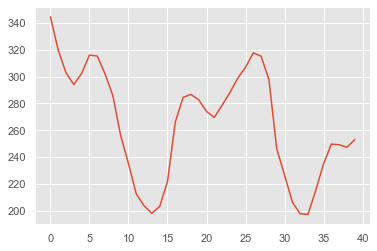

no_event no_event 2


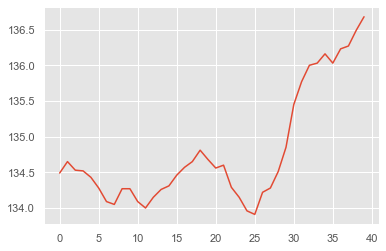

no_event no_event 2


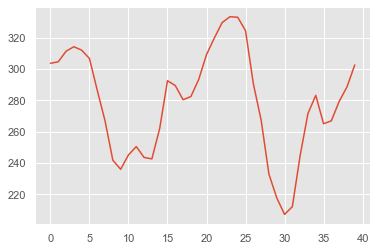

no_event no_event 1


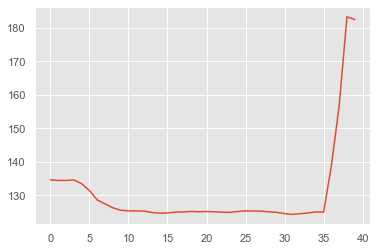

no_event no_event 2


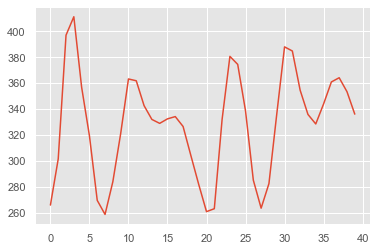

no_event no_event 2


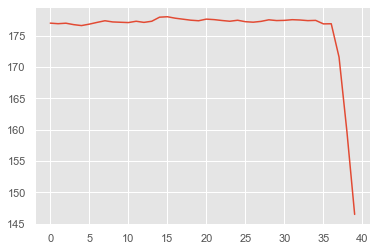

no_event no_event 2


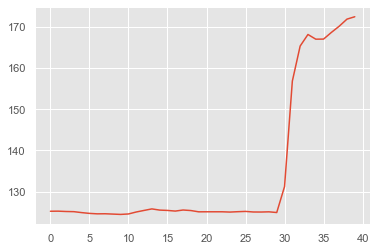

no_event no_event 2


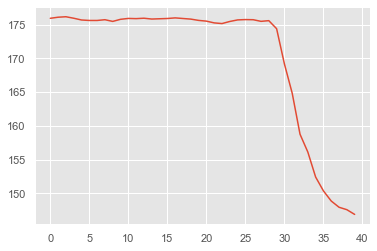

no_event no_event 1


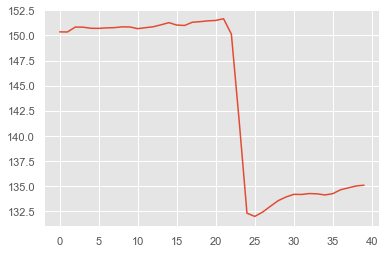

no_event no_event 1


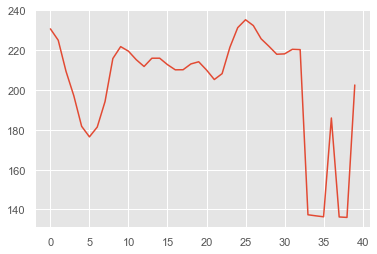

no_event no_event 2


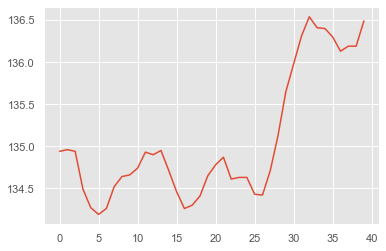

no_event no_event 1


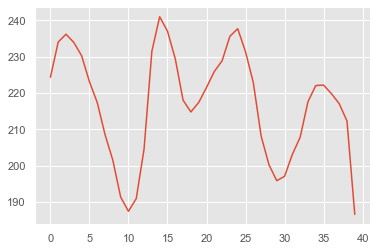

no_event no_event 2


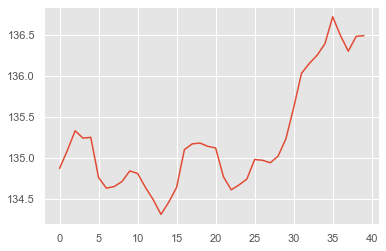

no_event no_event 1


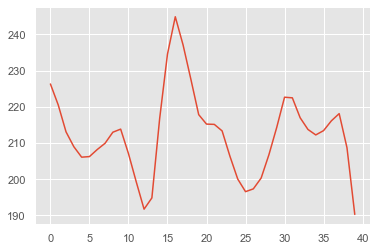

no_event no_event 2


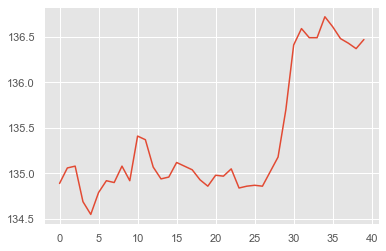

no_event no_event 2


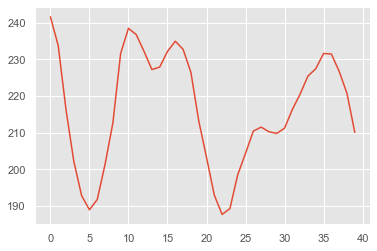

no_event no_event 1


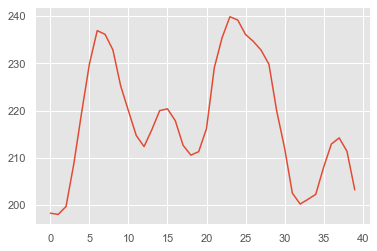

no_event no_event 2


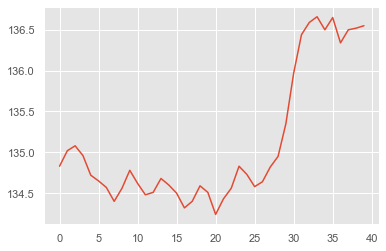

no_event no_event 1


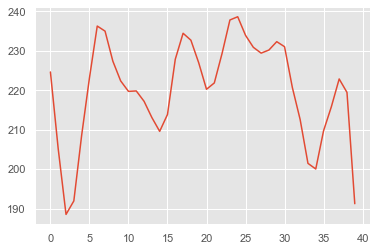

no_event no_event 2


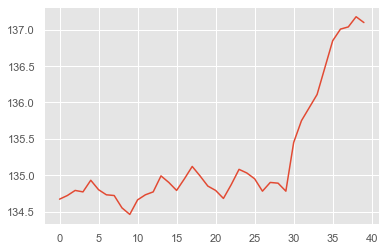

no_event no_event 2


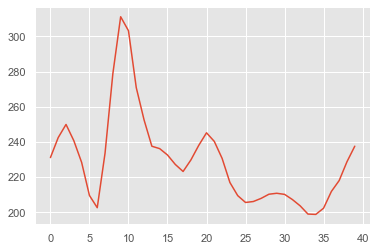

no_event no_event 1


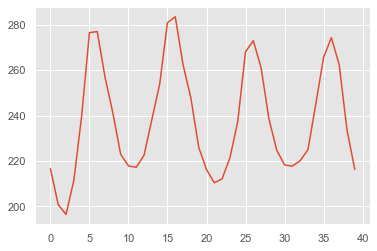

no_event no_event 2


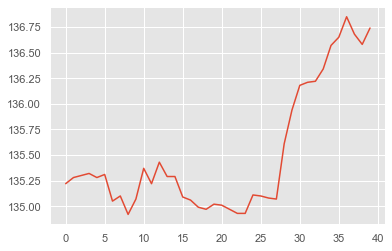

no_event no_event 1


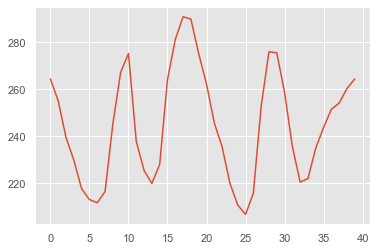

no_event no_event 2


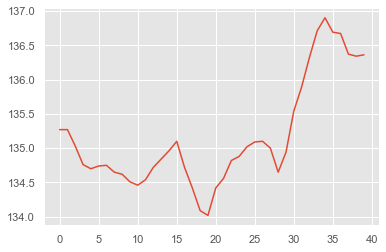

no_event no_event 2


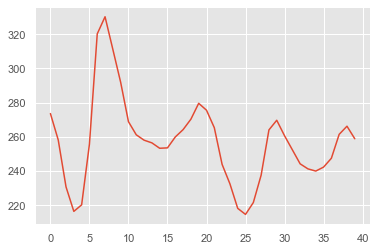

no_event no_event 2


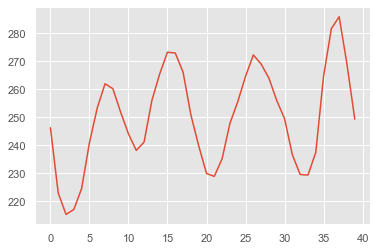

no_event no_event 2


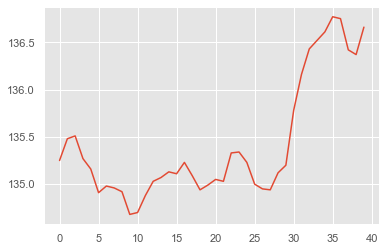

no_event no_event 2


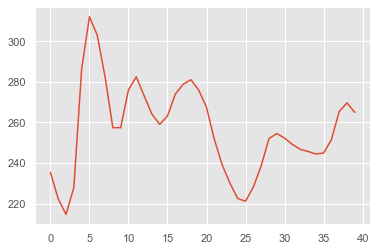

no_event no_event 1


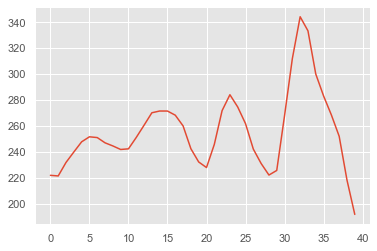

no_event no_event 2


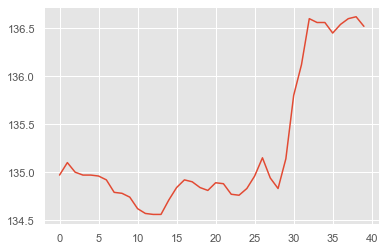

no_event no_event 2


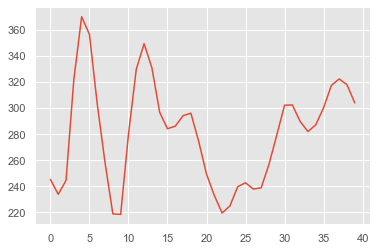

no_event no_event 2


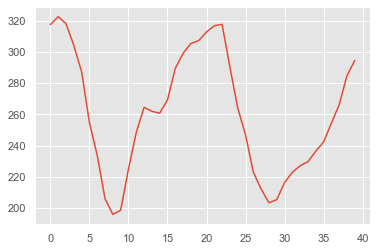

no_event no_event 2


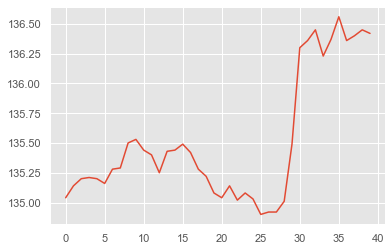

no_event no_event 1


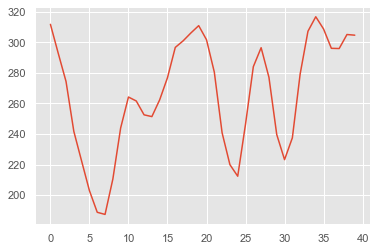

no_event no_event 2


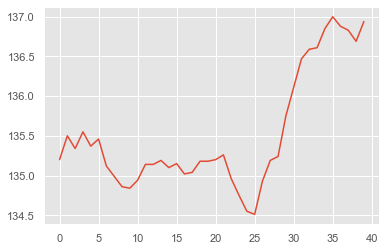

no_event no_event 2


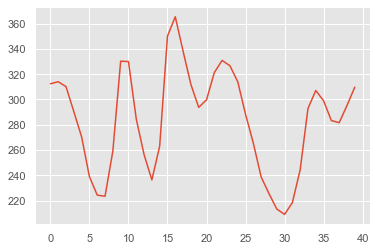

no_event no_event 1


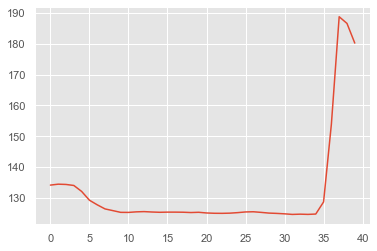

no_event no_event 2


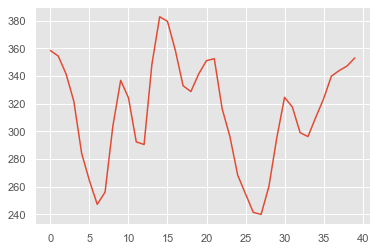

no_event no_event 2


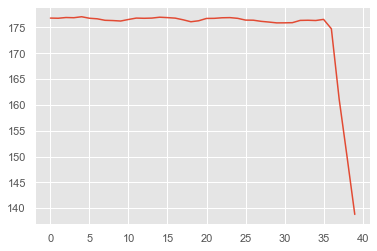

no_event no_event 2


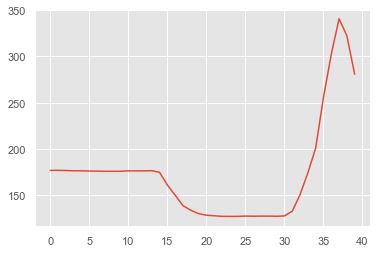

no_event no_event 2


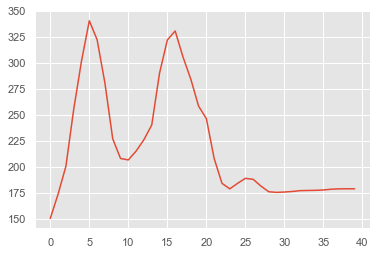

no_event no_event 2


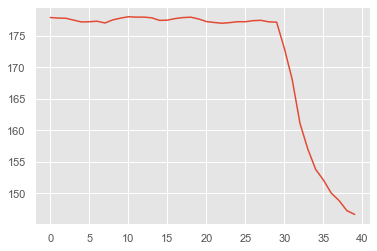

no_event no_event 2


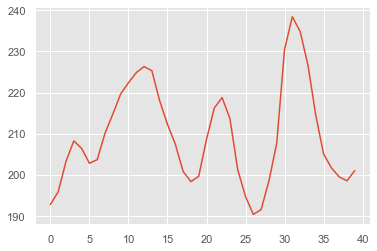

no_event no_event 2


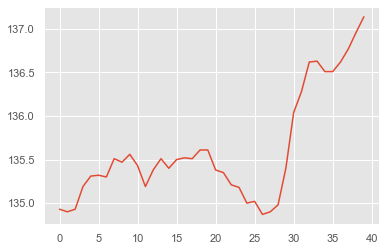

no_event no_event 1


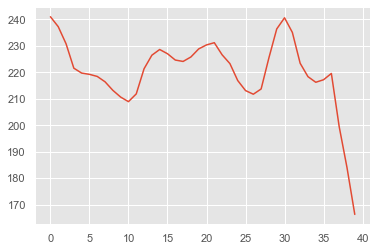

no_event no_event 2


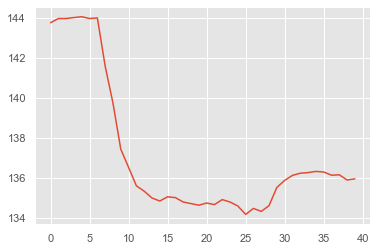

no_event no_event 1


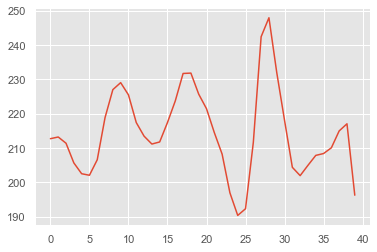

no_event no_event 2


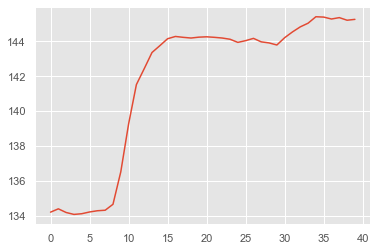

no_event no_event 2


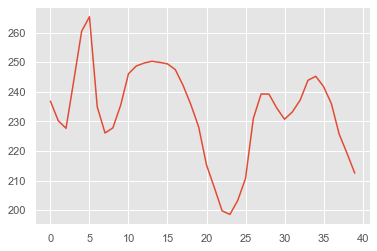

no_event no_event 1


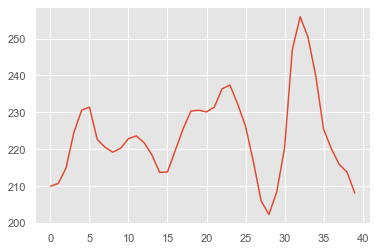

no_event no_event 2


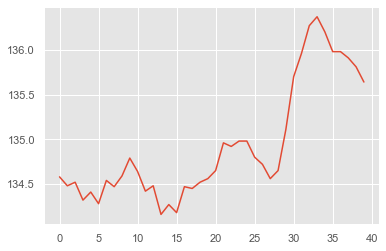

no_event no_event 1


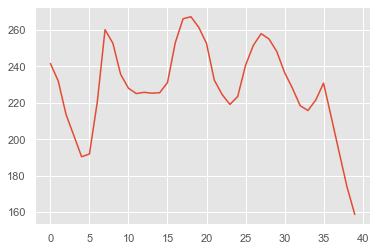

no_event no_event 2


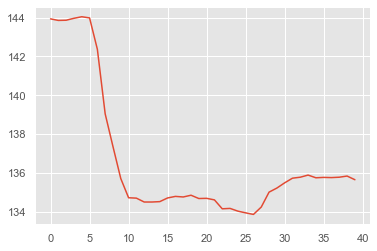

no_event no_event 1


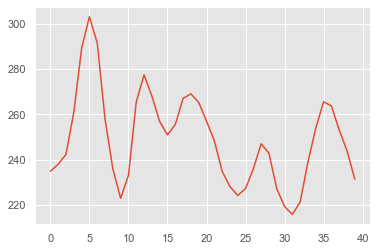

no_event no_event 2


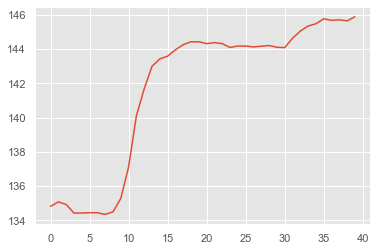

no_event no_event 2


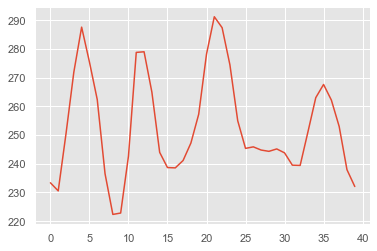

no_event no_event 2


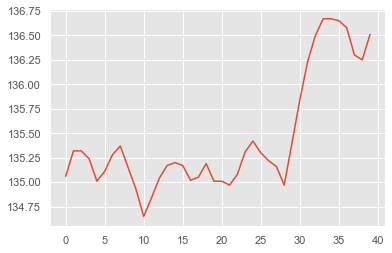

no_event no_event 1


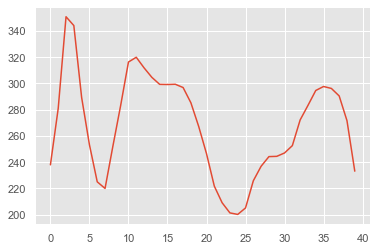

no_event no_event 2


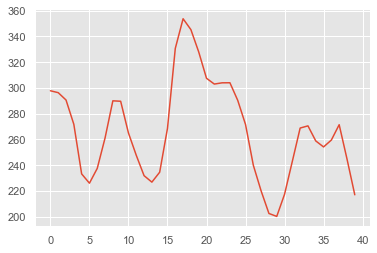

no_event no_event 1


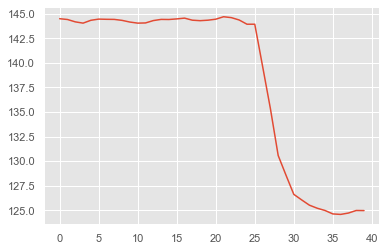

no_event no_event 1


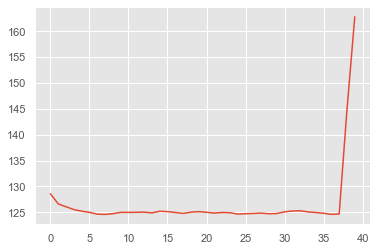

no_event no_event 2


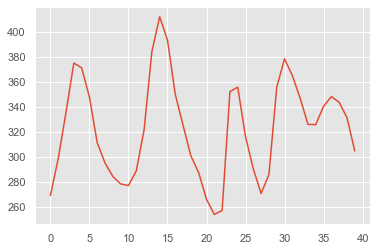

no_event no_event 2


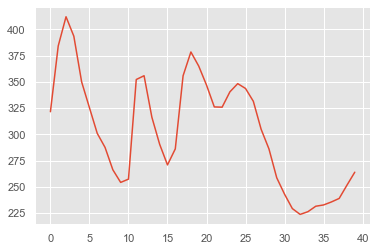

no_event no_event 2


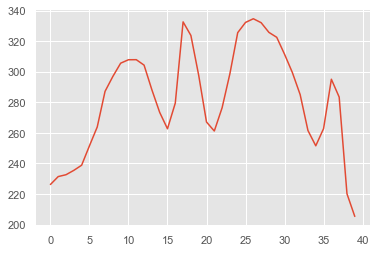

no_event no_event 2


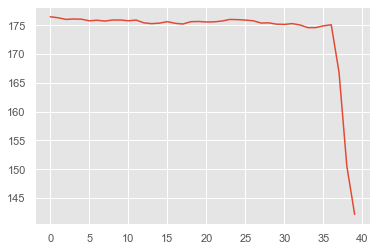

no_event no_event 2


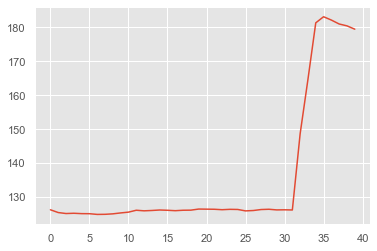

no_event no_event 1


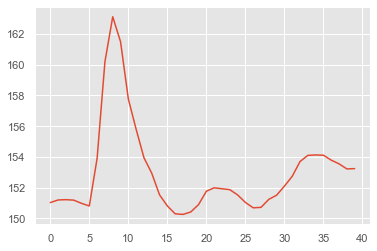

no_event no_event 1


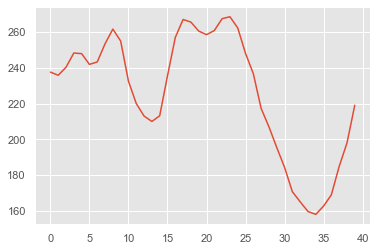

no_event no_event 2


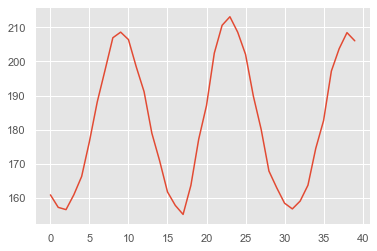

no_event no_event 2


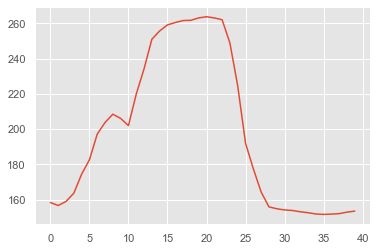

no_event no_event 2


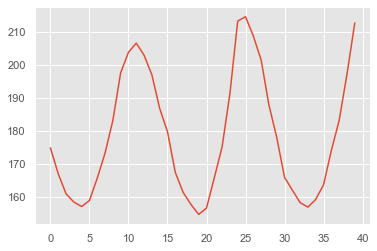

no_event no_event 2


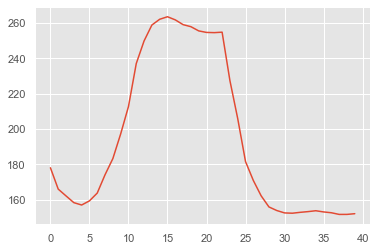

no_event no_event 1


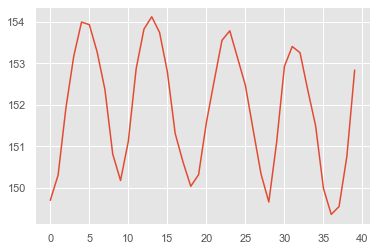

no_event no_event 2


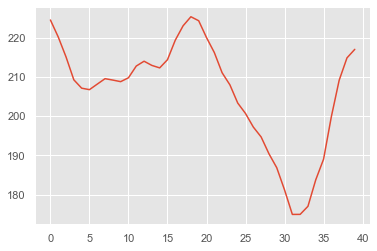

no_event no_event 2


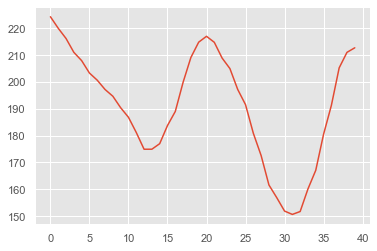

no_event no_event 1


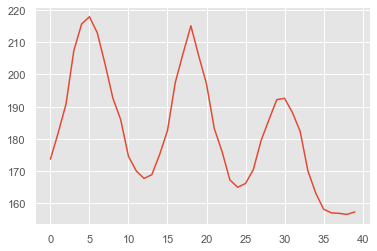

no_event no_event 1


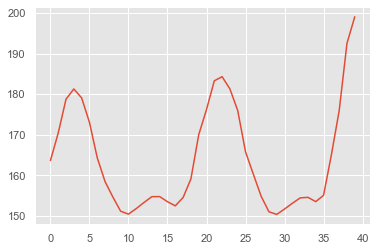

no_event no_event 1


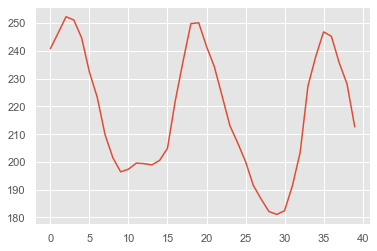

no_event no_event 1


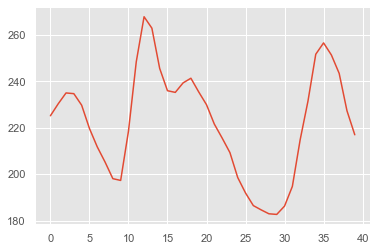

no_event no_event 2


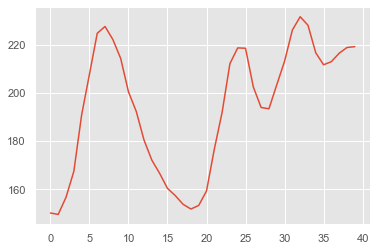

no_event no_event 2


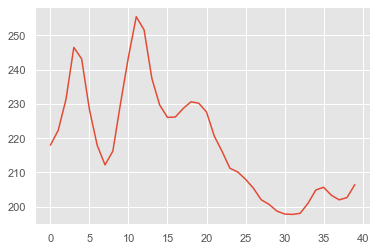

no_event no_event 2


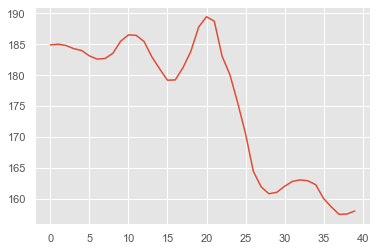

no_event no_event 1


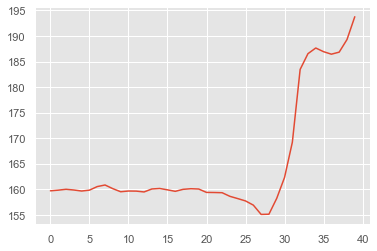

no_event no_event 1


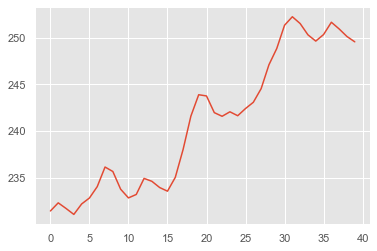

no_event no_event 2


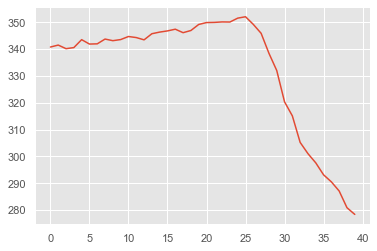

no_event no_event 1


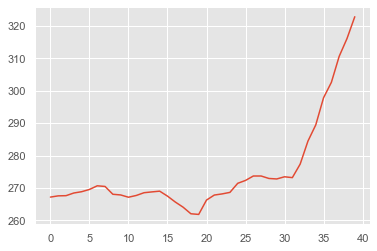

no_event no_event 2


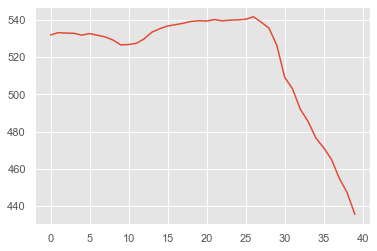

no_event no_event 2


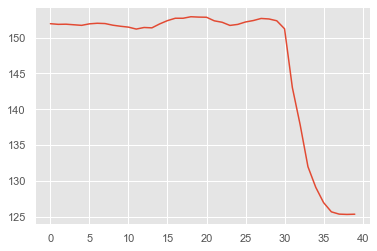

no_event no_event 1


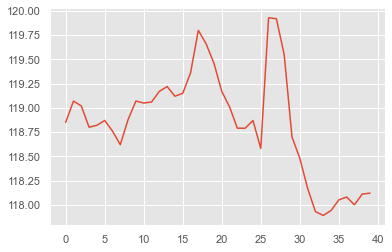

no_event no_event 2


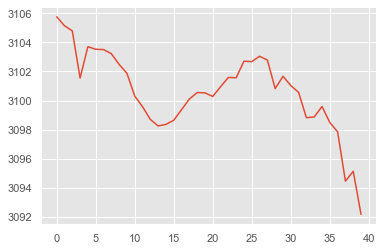

no_event no_event 2


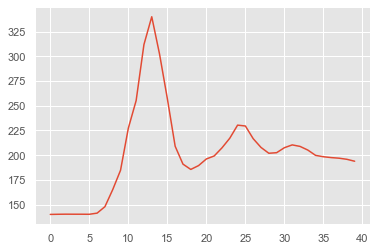

no_event no_event 1


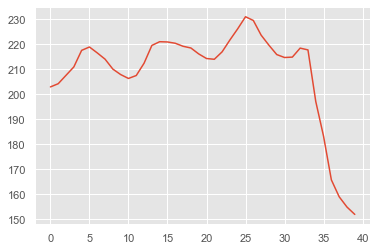

no_event no_event 2


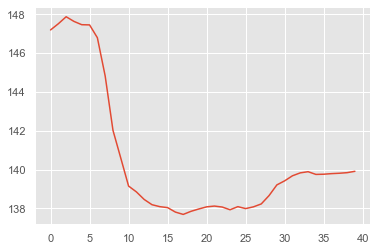

no_event no_event 1


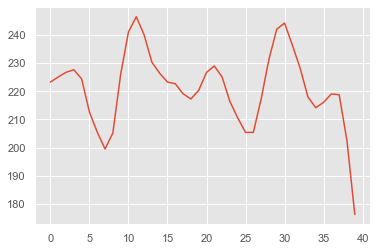

no_event no_event 2


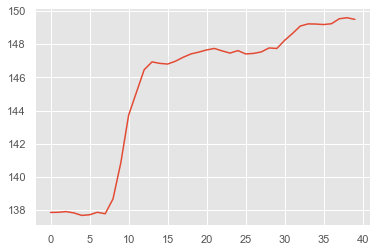

no_event no_event 1


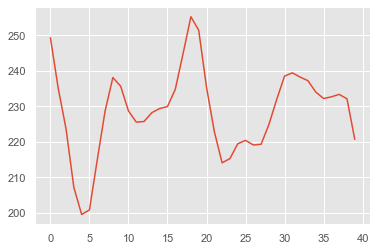

no_event no_event 2


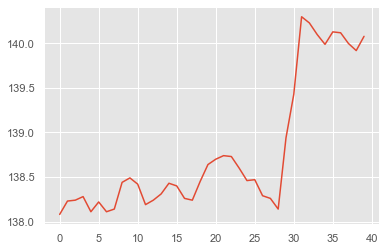

no_event no_event 1


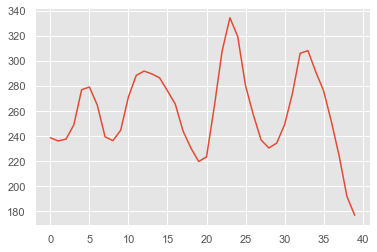

no_event no_event 2


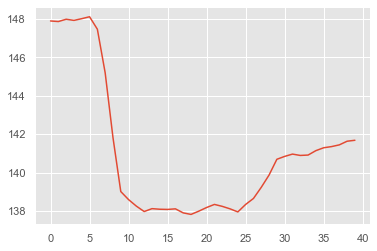

no_event no_event 2


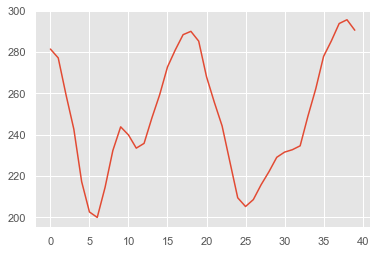

no_event no_event 1


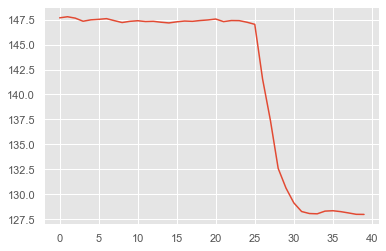

no_event no_event 1


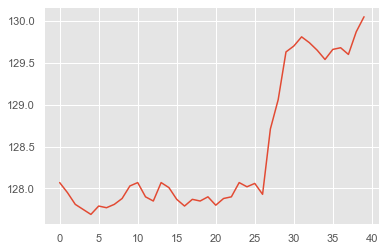

no_event no_event 1


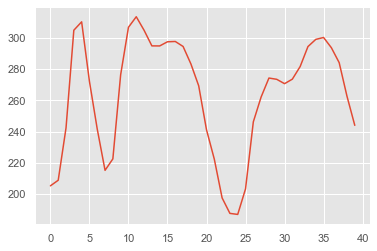

no_event no_event 2


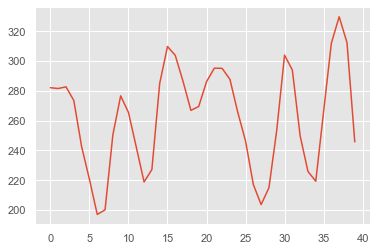

no_event no_event 1


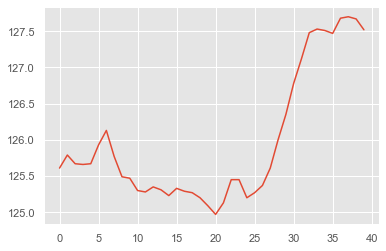

no_event no_event 1


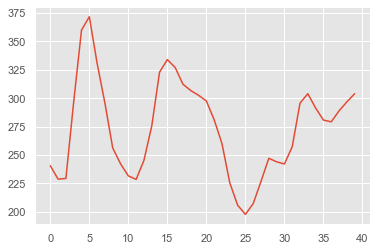

no_event no_event 2


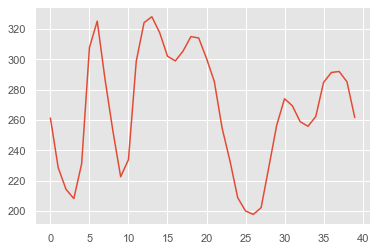

no_event no_event 2


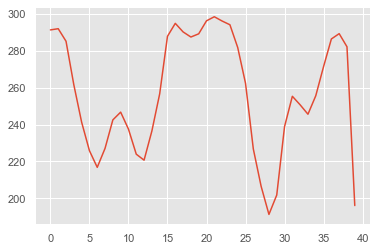

no_event no_event 1


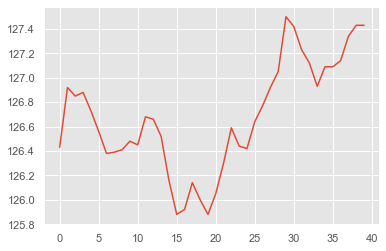

no_event no_event 1


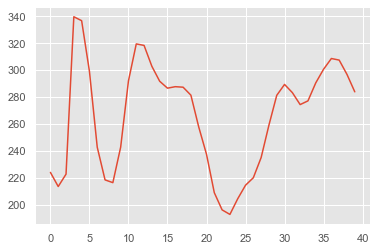

no_event no_event 2


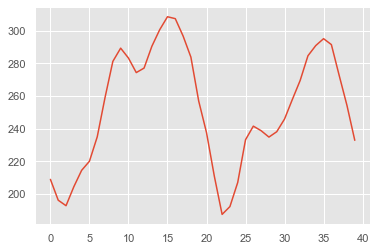

no_event no_event 2


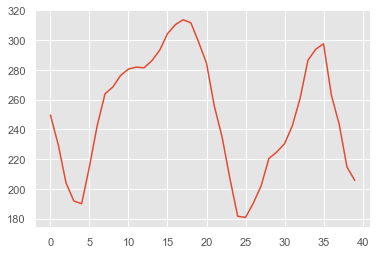

no_event no_event 2


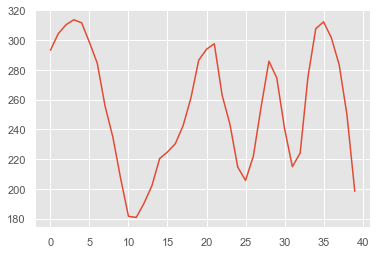

no_event no_event 1


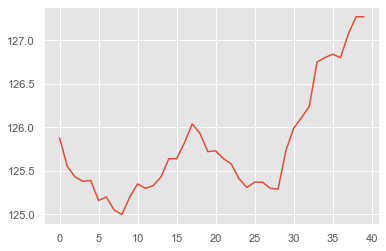

no_event no_event 2


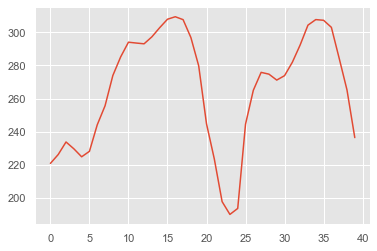

no_event no_event 2


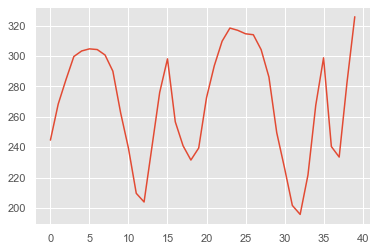

no_event no_event 2


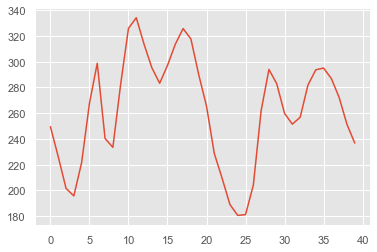

no_event no_event 2


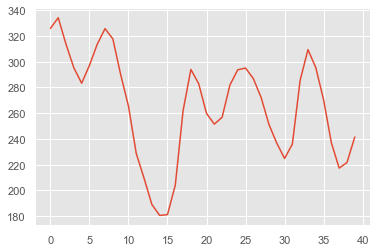

no_event no_event 1


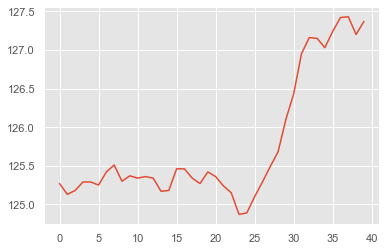

no_event no_event 1


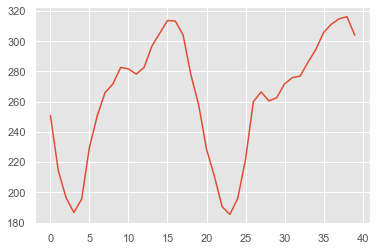

no_event no_event 2


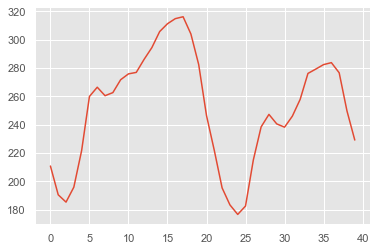

no_event no_event 2


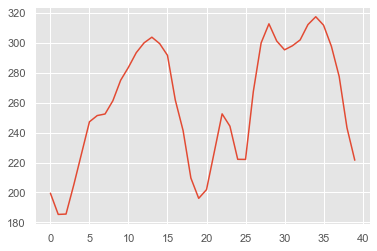

no_event no_event 1


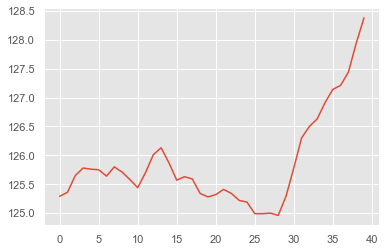

no_event no_event 1


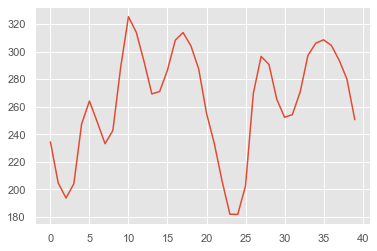

no_event no_event 2


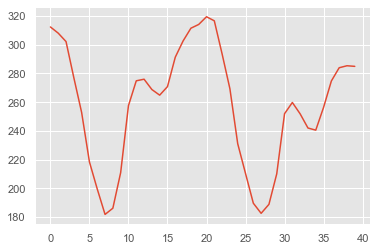

no_event no_event 1


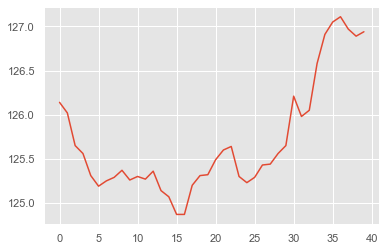

no_event no_event 2


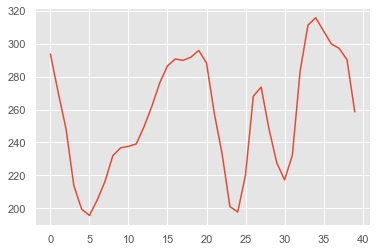

no_event no_event 1


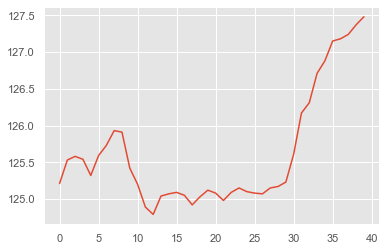

no_event no_event 1


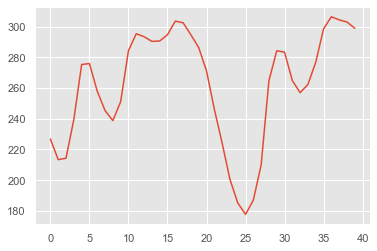

no_event no_event 2


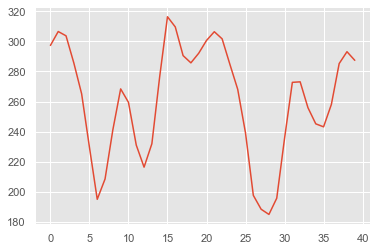

no_event no_event 1


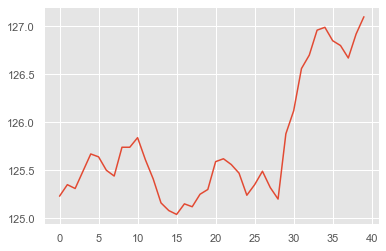

no_event no_event 1


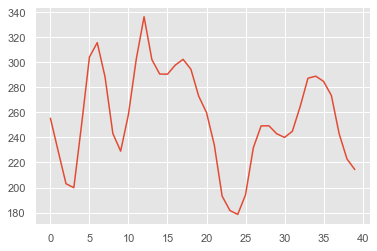

no_event no_event 2


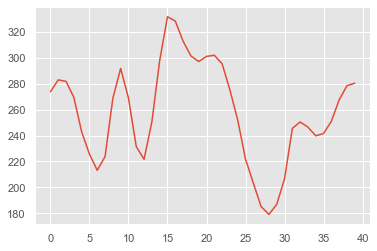

no_event no_event 2


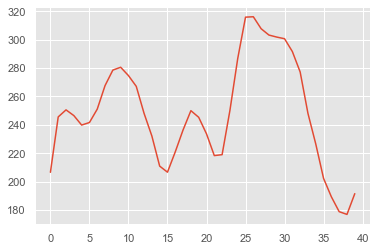

no_event no_event 1


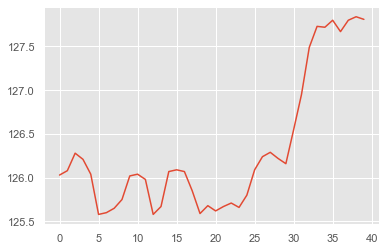

no_event no_event 2


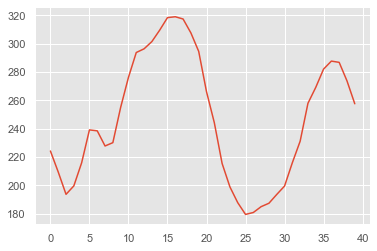

no_event no_event 2


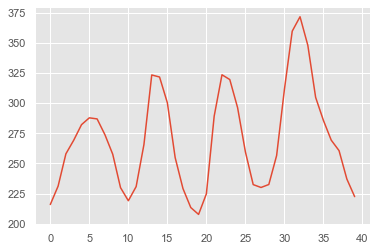

no_event no_event 2


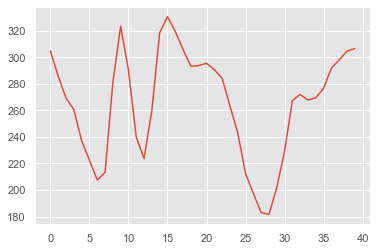

no_event no_event 2


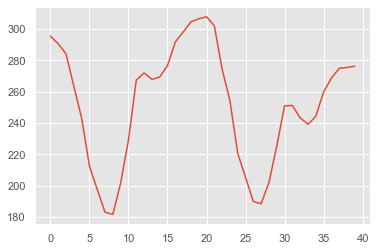

no_event no_event 1


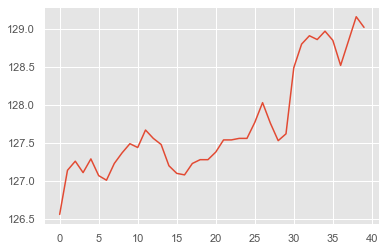

no_event no_event 2


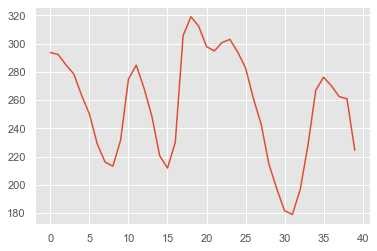

no_event no_event 1


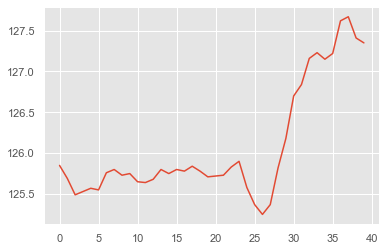

no_event no_event 1


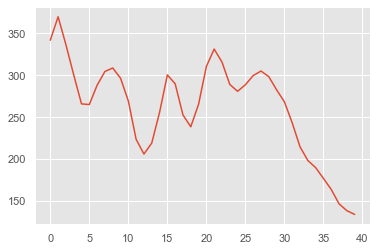

no_event no_event 1


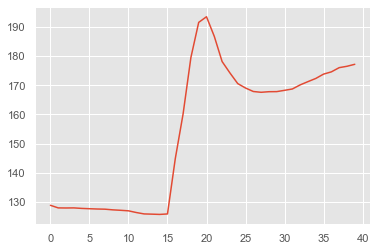

no_event no_event 2


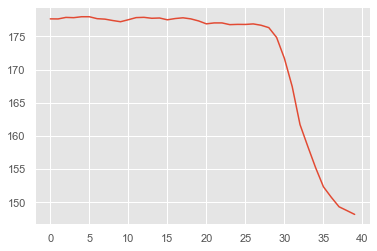

no_event no_event 2


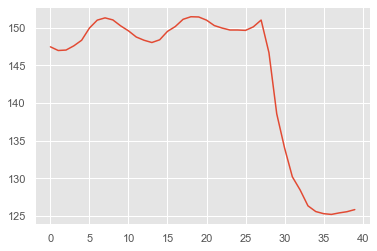

no_event no_event 1


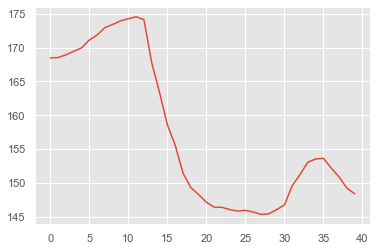

no_event no_event 1


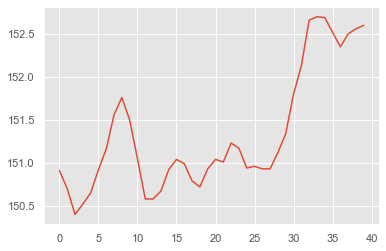

no_event no_event 2


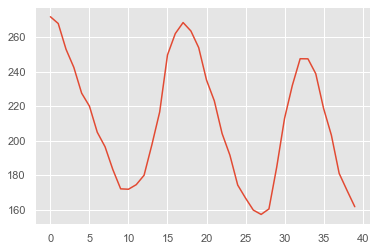

no_event no_event 2


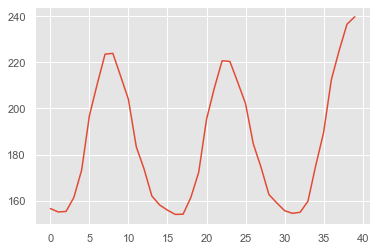

no_event no_event 1


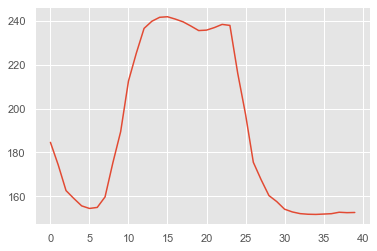

no_event no_event 1


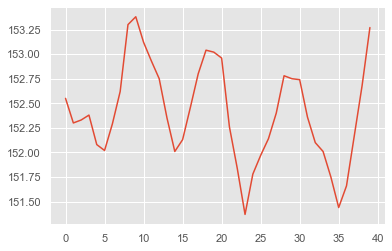

no_event no_event 2


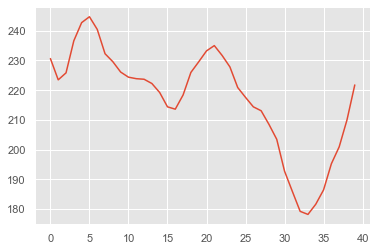

no_event no_event 2


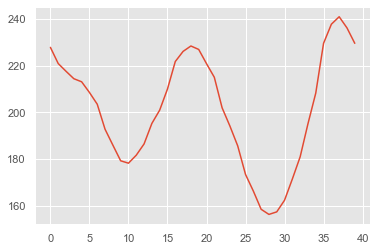

no_event no_event 1


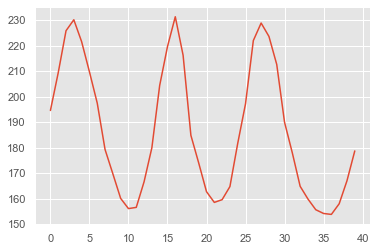

no_event no_event 1


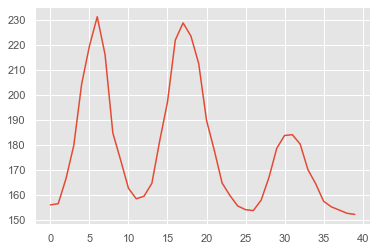

no_event no_event 1


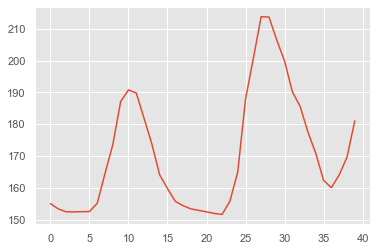

no_event no_event 1


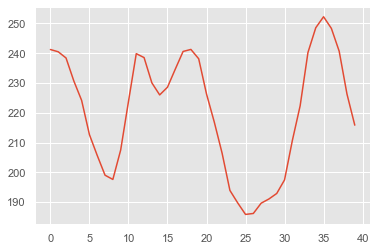

no_event no_event 1


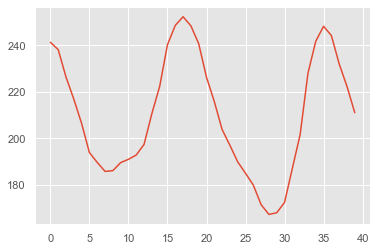

no_event no_event 1


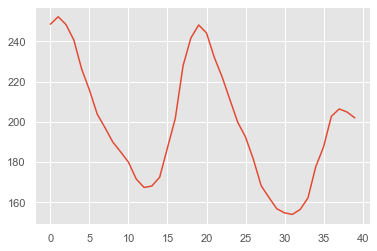

no_event no_event 1


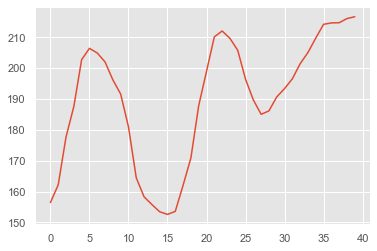

no_event no_event 2


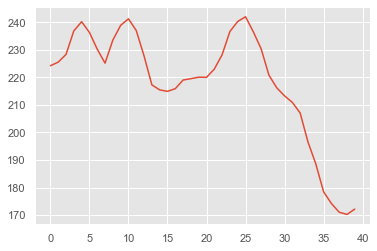

no_event no_event 2


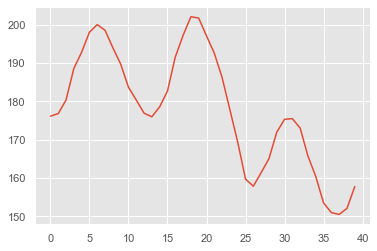

no_event no_event 1


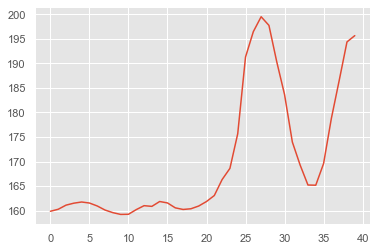

no_event no_event 1


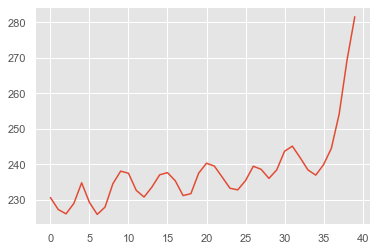

no_event no_event 1


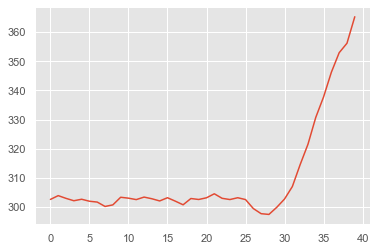

no_event no_event 2


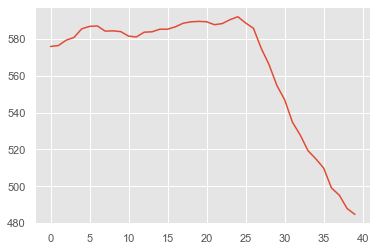

no_event no_event 1


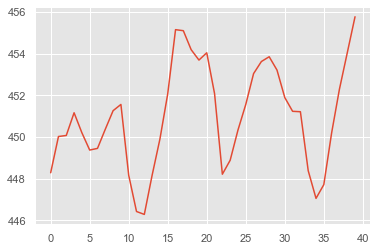

no_event no_event 2


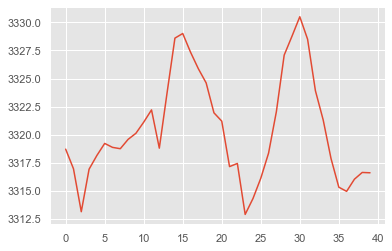

no_event no_event 2


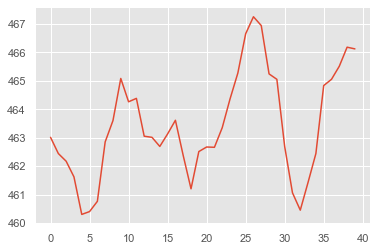

no_event no_event 1


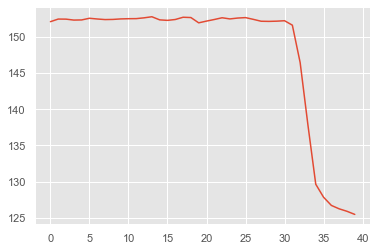

no_event no_event 1


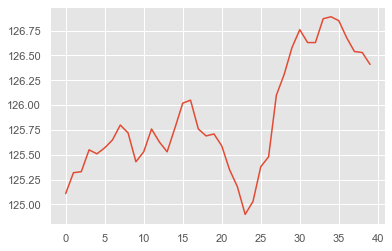

no_event no_event 2


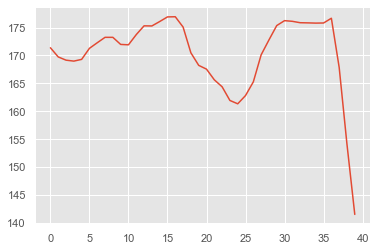

no_event no_event 1


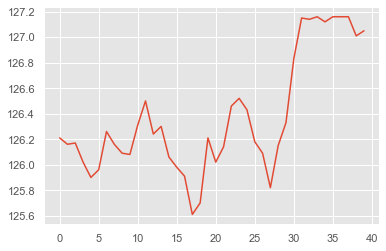

no_event no_event 2


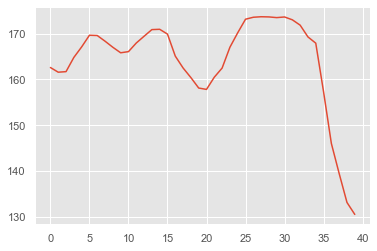

no_event no_event 1


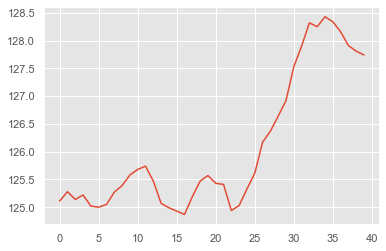

no_event no_event 2


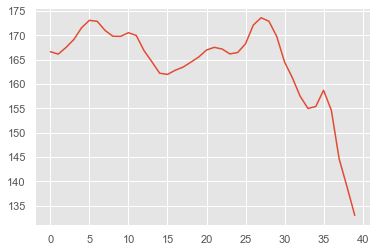

no_event no_event 1


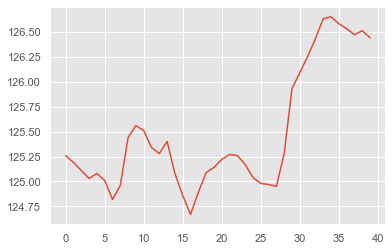

no_event no_event 2


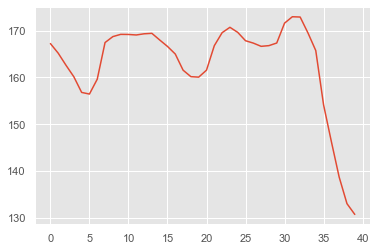

no_event no_event 1


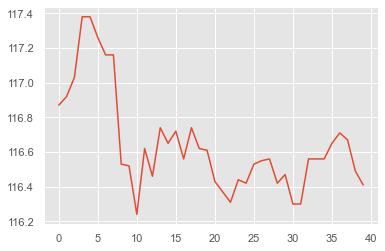

no_event no_event 2


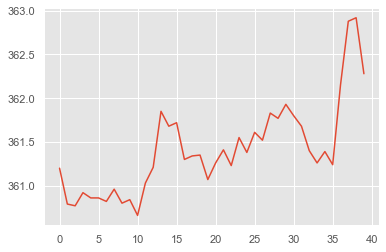

no_event no_event 1


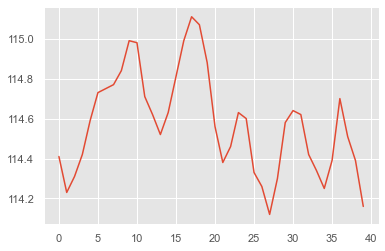

no_event no_event 2


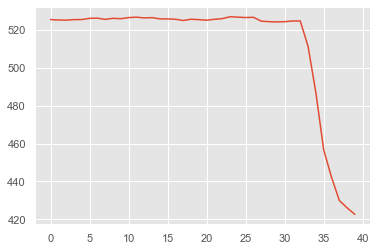

no_event no_event 2


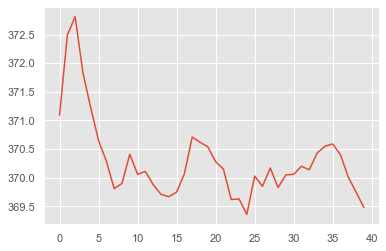

no_event no_event 1


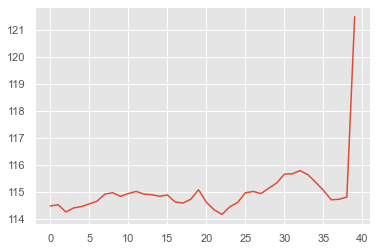

no_event no_event 1


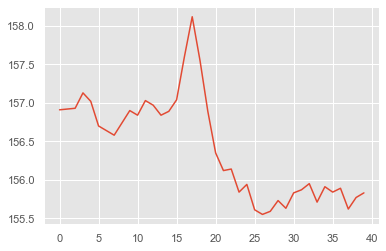

no_event no_event 2


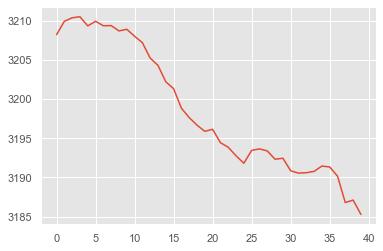

no_event no_event 1


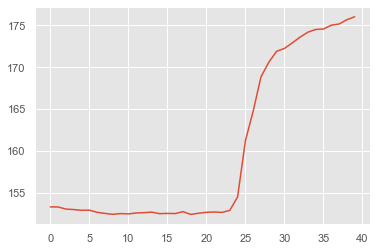

no_event no_event 1


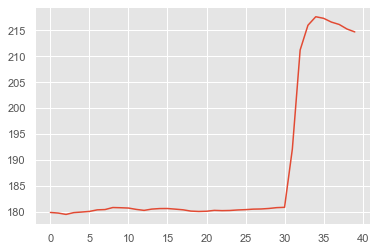

no_event no_event 2


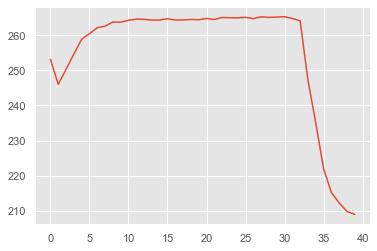

no_event no_event 2


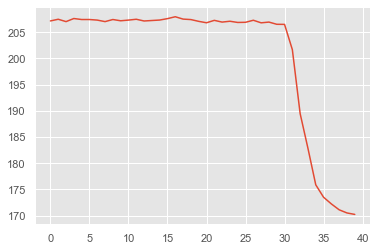

no_event no_event 2


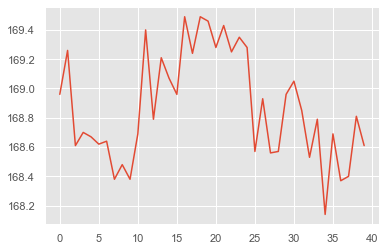

no_event no_event 1


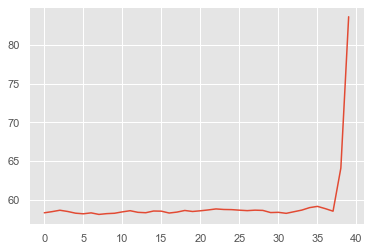

no_event no_event 1


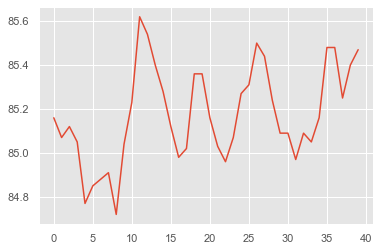

no_event no_event 2


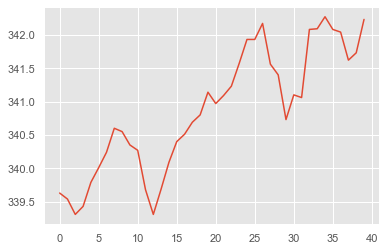

no_event no_event 2


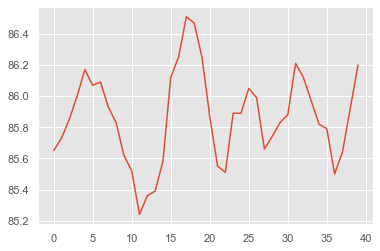

no_event Refrigerator_ON 1


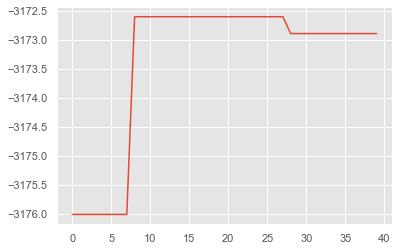

no_event no_event 1


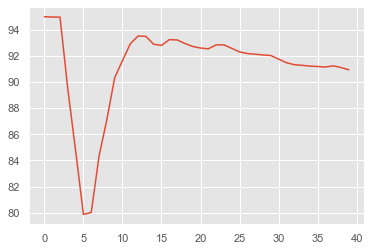

no_event no_event 2


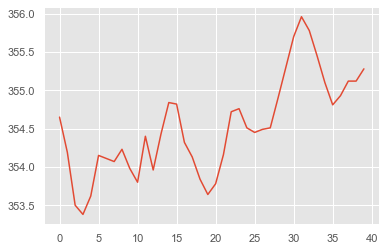

no_event no_event 1


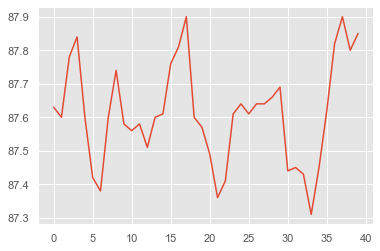

no_event no_event 2


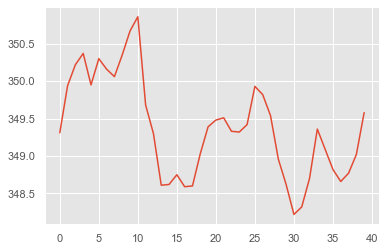

no_event no_event 1


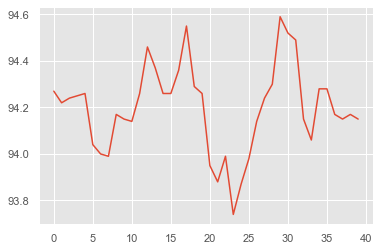

no_event no_event 2


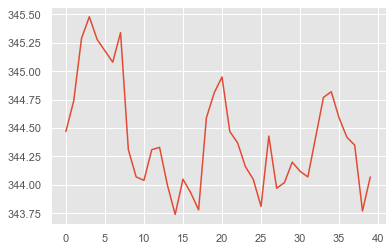

no_event no_event 1


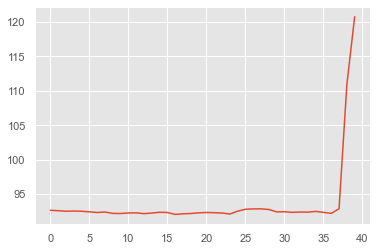

no_event no_event 1


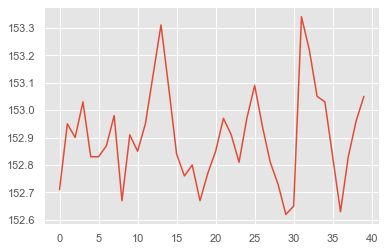

no_event no_event 2


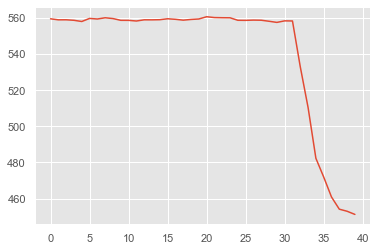

no_event no_event 2


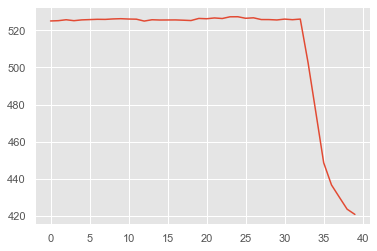

no_event no_event 1


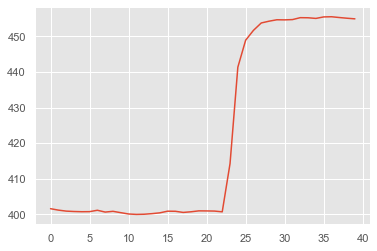

no_event no_event 2


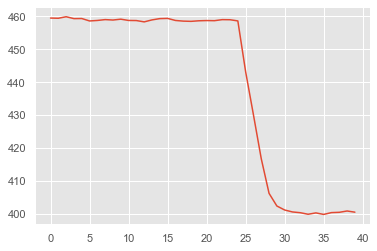

no_event no_event 1


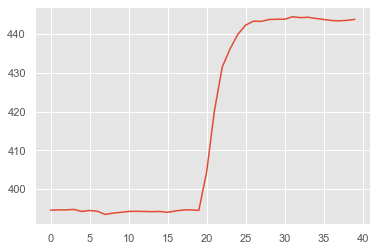

no_event no_event 2


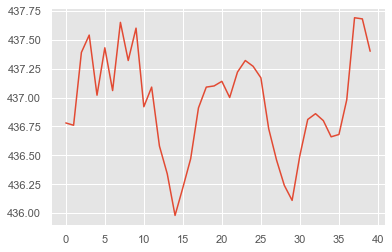

no_event no_event 1


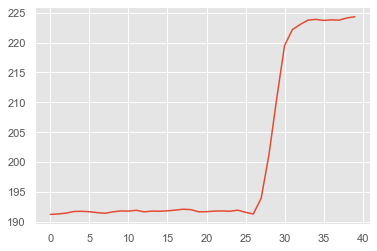

no_event no_event 1


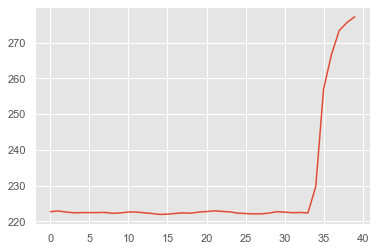

no_event no_event 2


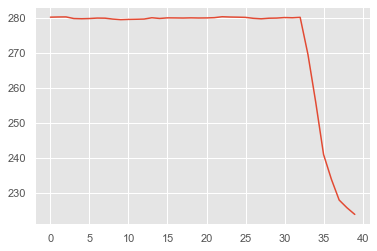

no_event no_event 1


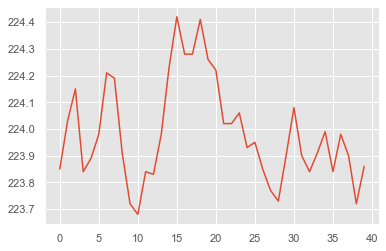

no_event no_event 2


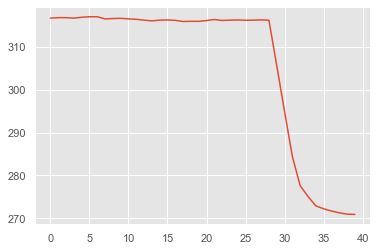

no_event no_event 2


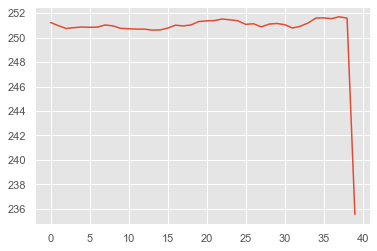

no_event no_event 1


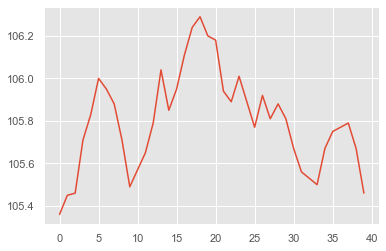

no_event no_event 2


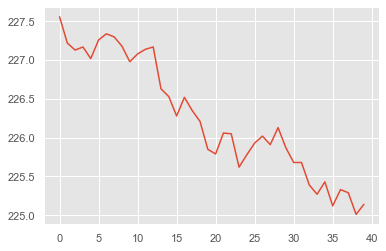

no_event no_event 1


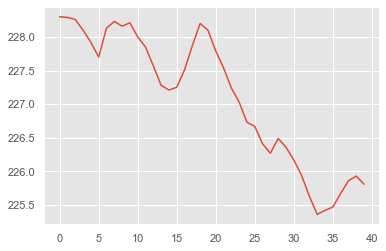

no_event no_event 2


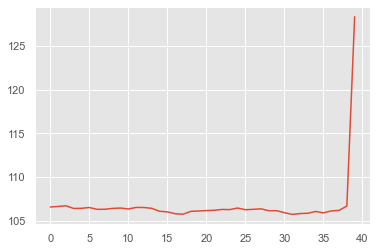

no_event no_event 2


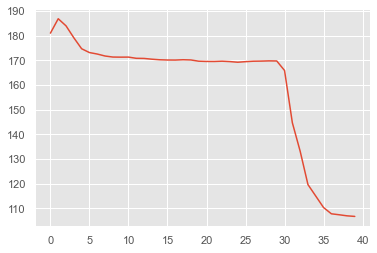

no_event no_event 2


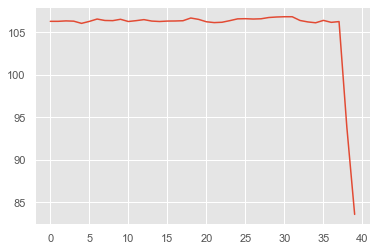

no_event no_event 1


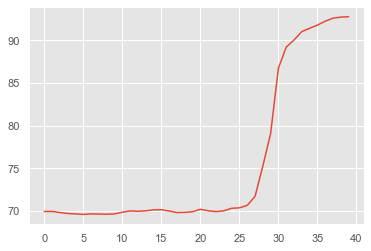

no_event no_event 1


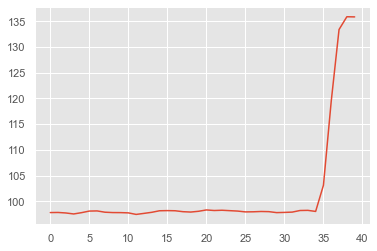

no_event no_event 1


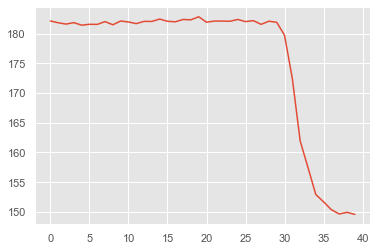

no_event no_event 2


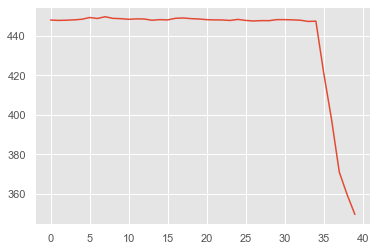

no_event no_event 2


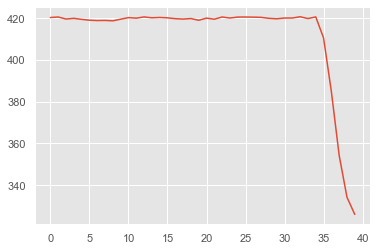

no_event no_event 1


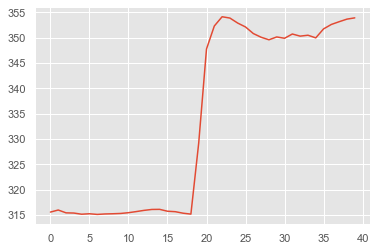

no_event no_event 2


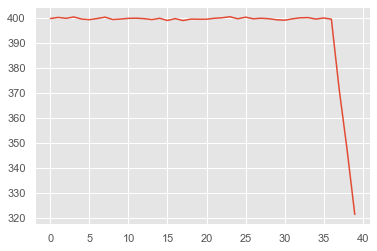

no_event no_event 1


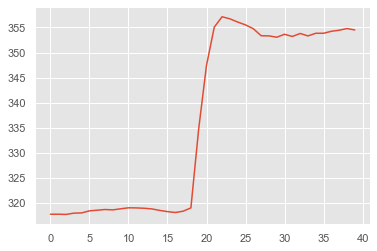

no_event no_event 2


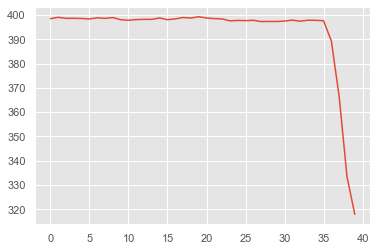

no_event no_event 1


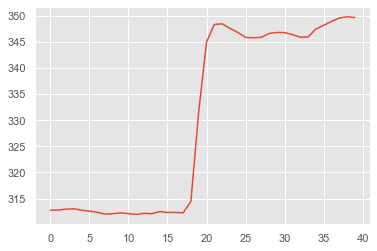

no_event no_event 2


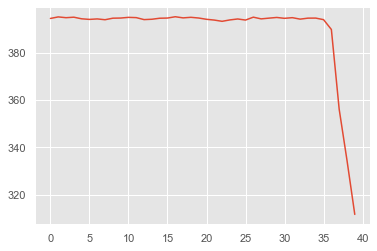

no_event no_event 2


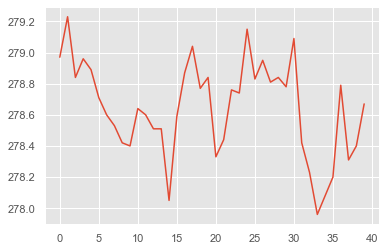

no_event no_event 2


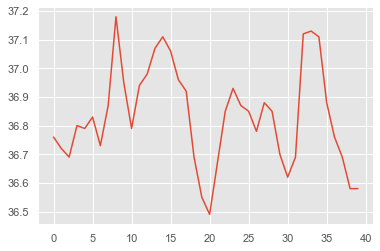

no_event no_event 1


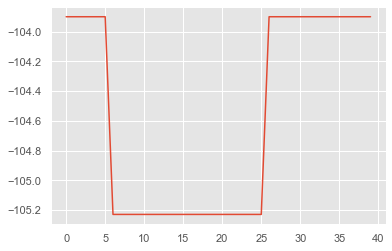

no_event no_event 1


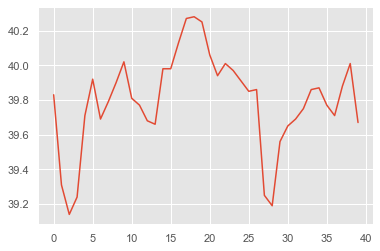

no_event no_event 2


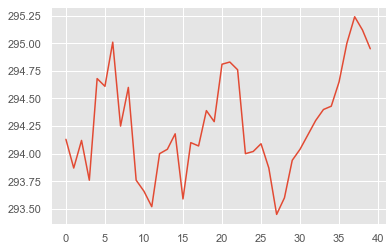

no_event no_event 1


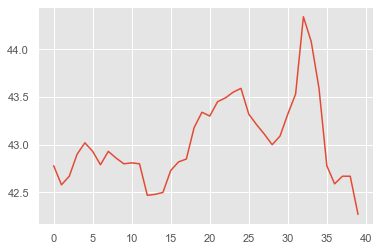

no_event no_event 2


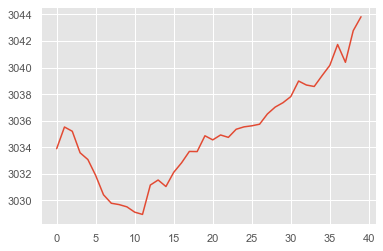

no_event no_event 1


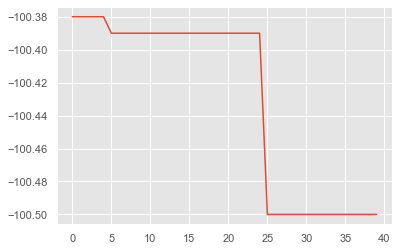

no_event no_event 1


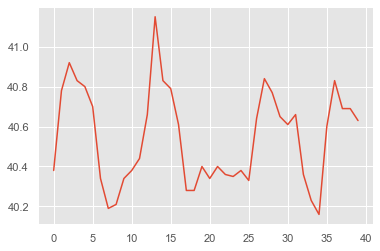

no_event no_event 2


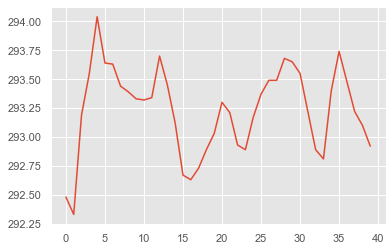

no_event no_event 1


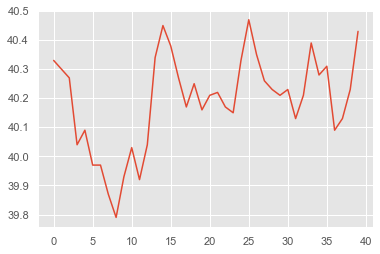

no_event no_event 2


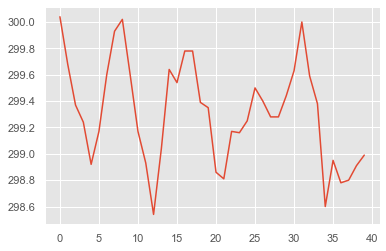

no_event no_event 1


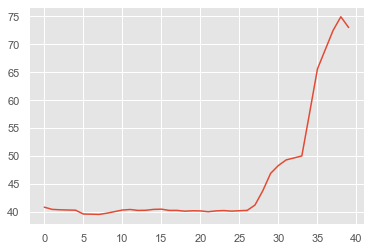

no_event no_event 1


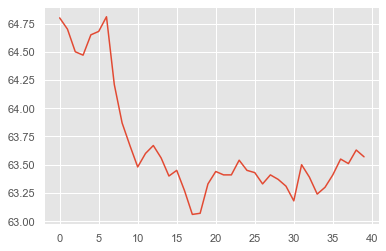

no_event no_event 1


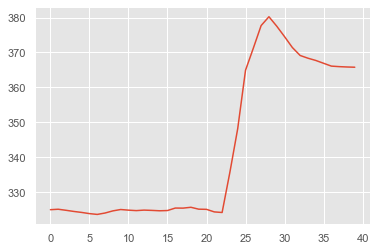

no_event no_event 2


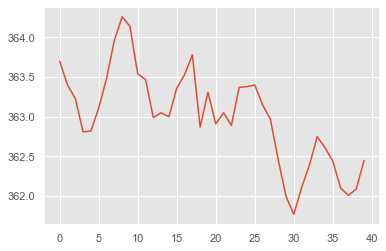

no_event no_event 1


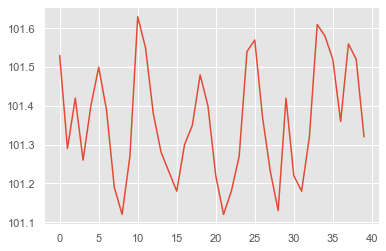

no_event no_event 1


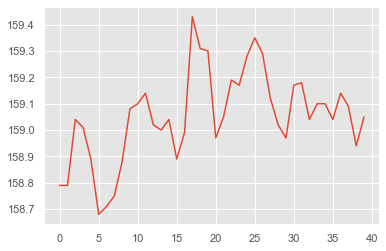

no_event no_event 2


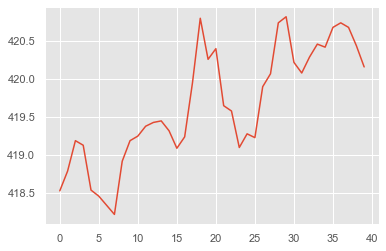

no_event no_event 1


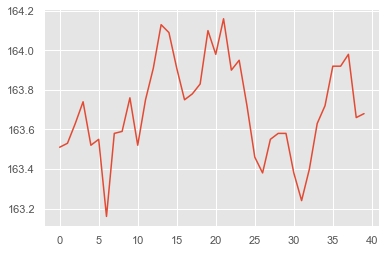

no_event no_event 1


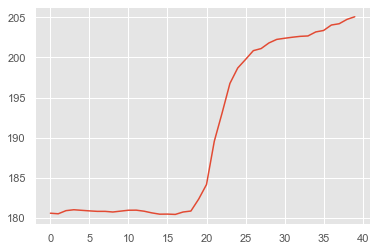

no_event no_event 1


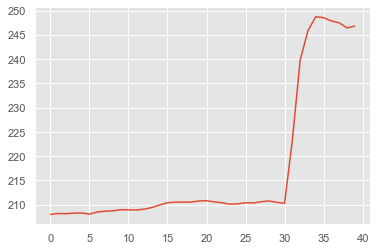

no_event no_event 1


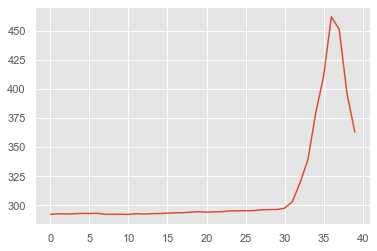

no_event no_event 2


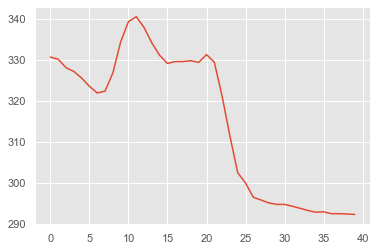

no_event no_event 1


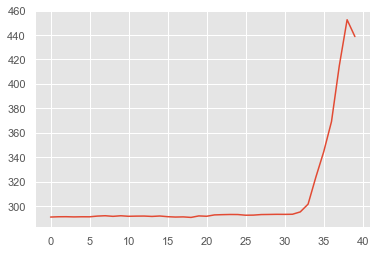

no_event no_event 2


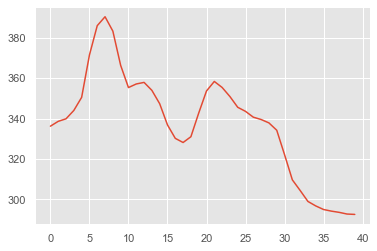

no_event no_event 1


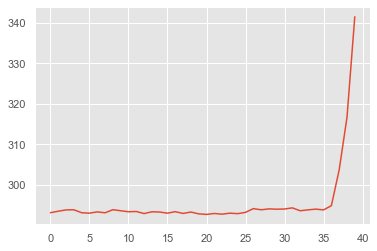

no_event no_event 2


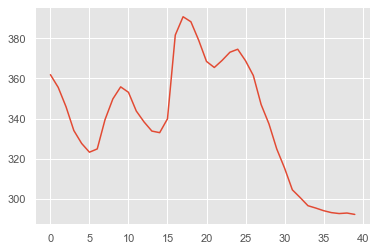

no_event no_event 1


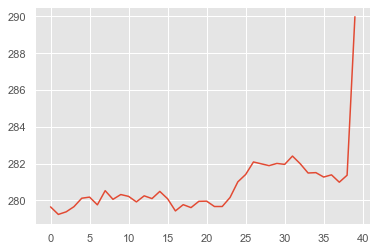

no_event no_event 2


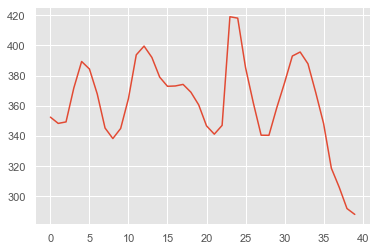

no_event no_event 1


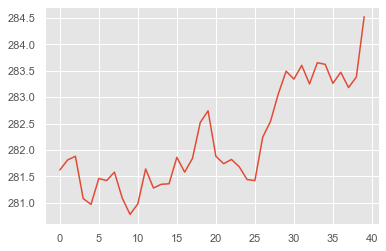

no_event no_event 2


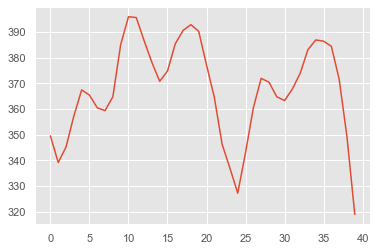

no_event no_event 1


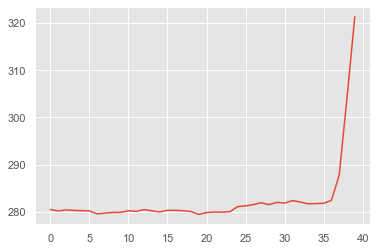

no_event no_event 2


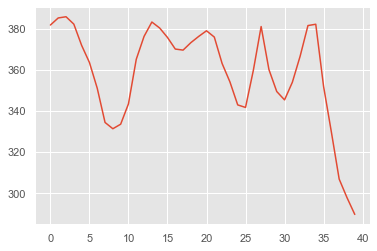

no_event no_event 2


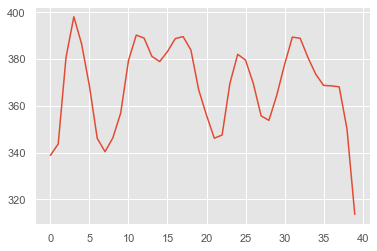

no_event no_event 2


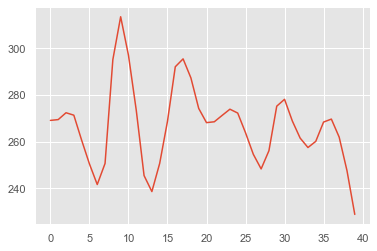

no_event no_event 1


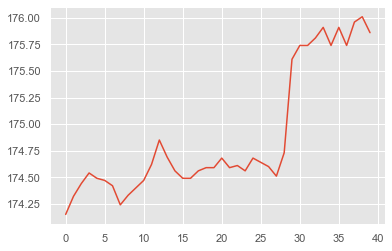

no_event no_event 2


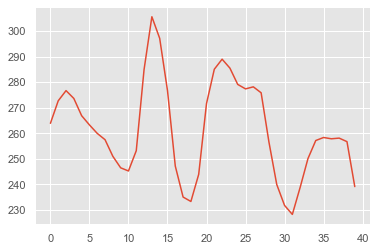

no_event no_event 1


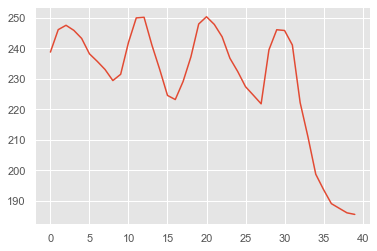

no_event no_event 1


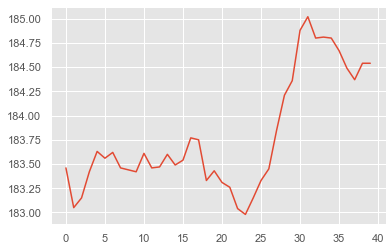

no_event no_event 1


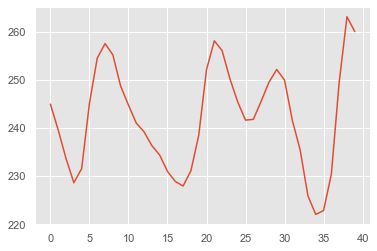

no_event no_event 2


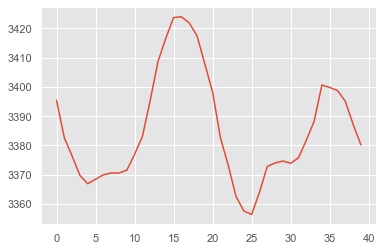

no_event no_event 2


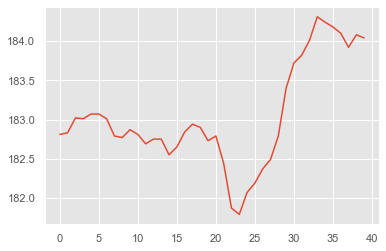

no_event no_event 1


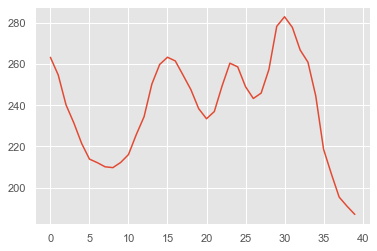

no_event no_event 2


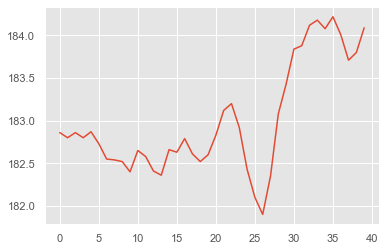

no_event no_event 2


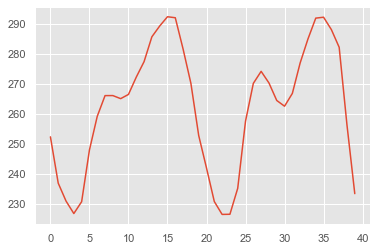

no_event no_event 2


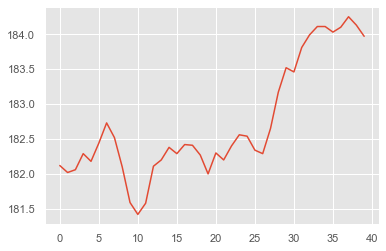

no_event no_event 1


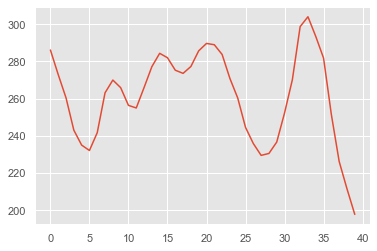

no_event no_event 1


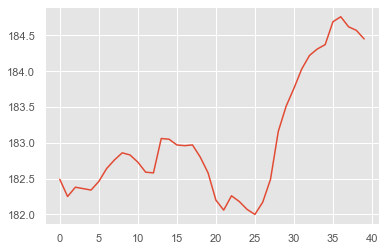

no_event no_event 1


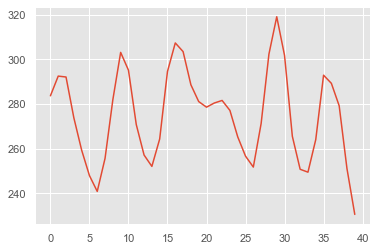

no_event no_event 1


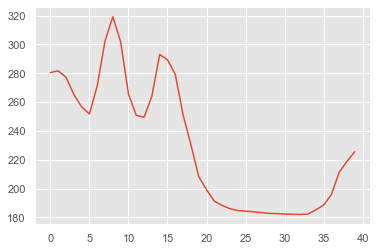

no_event no_event 2


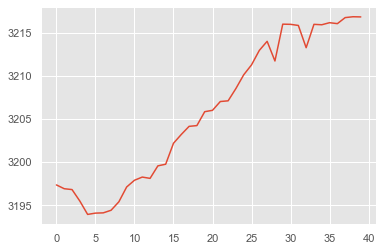

no_event no_event 2


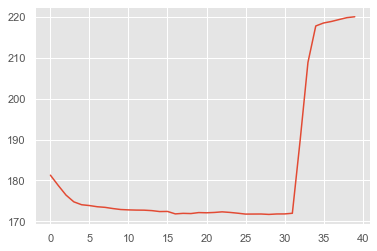

no_event no_event 2


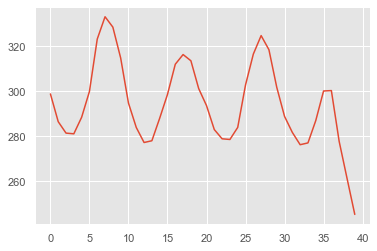

no_event no_event 2


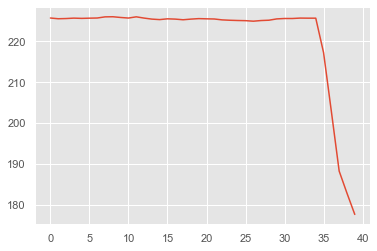

no_event no_event 2


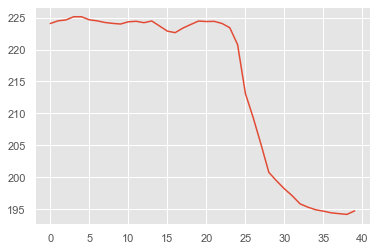

no_event no_event 1


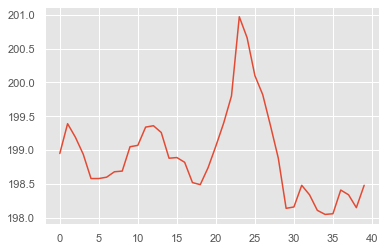

no_event no_event 2


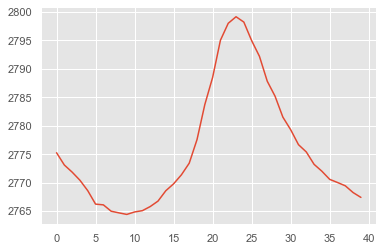

no_event no_event 2


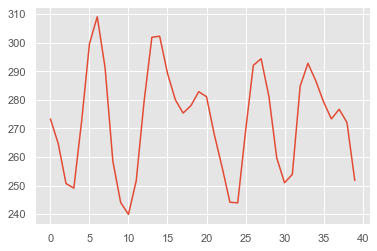

no_event no_event 2


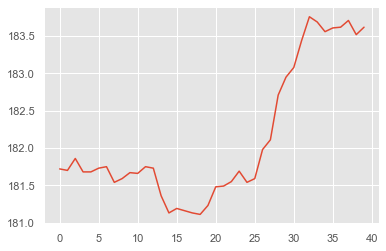

no_event no_event 2


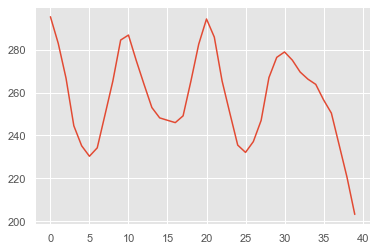

no_event no_event 2


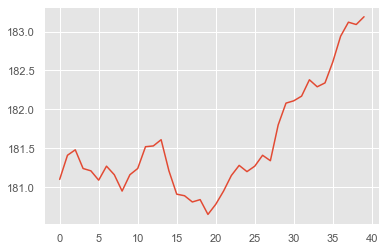

no_event no_event 1


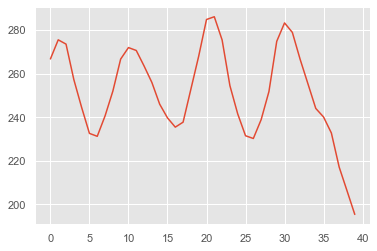

no_event no_event 2


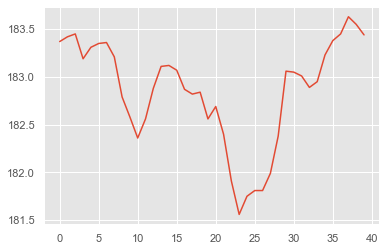

no_event no_event 2


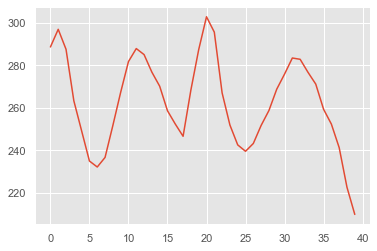

no_event no_event 1


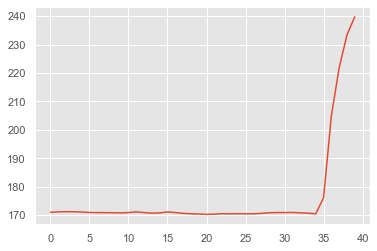

no_event no_event 2


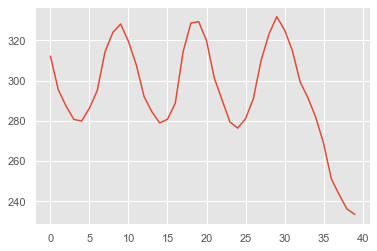

no_event no_event 2


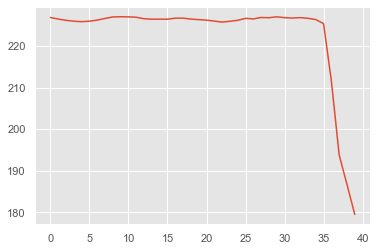

no_event no_event 2


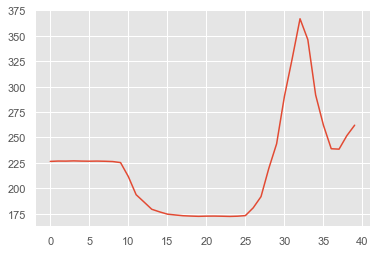

no_event no_event 2


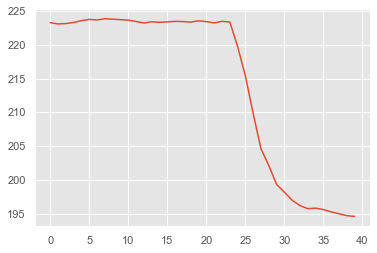

no_event no_event 1


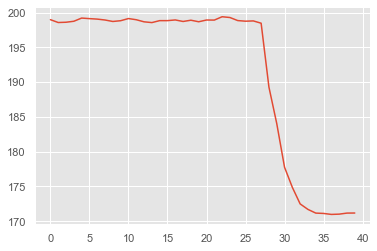

no_event no_event 2


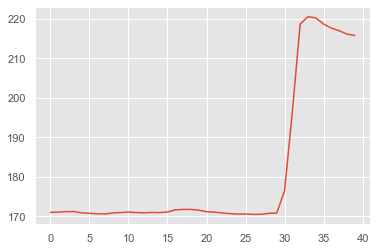

no_event no_event 1


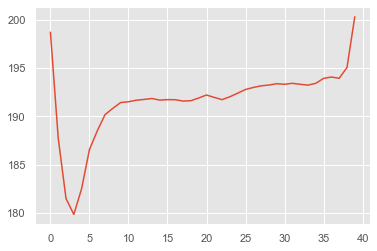

no_event no_event 2


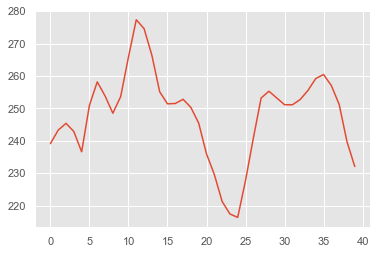

no_event no_event 2


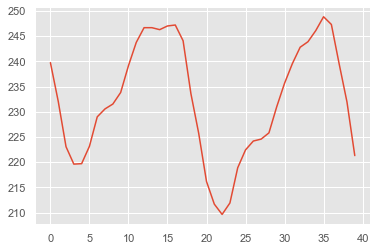

no_event no_event 1


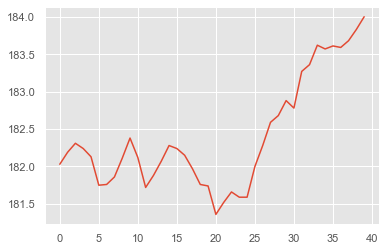

no_event no_event 1


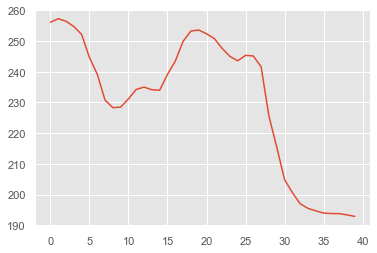

no_event no_event 2


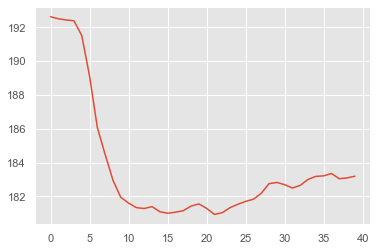

no_event no_event 1


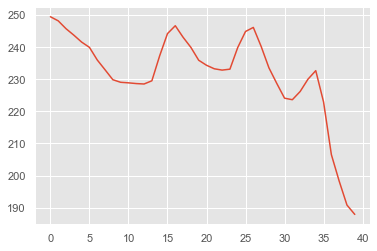

no_event no_event 2


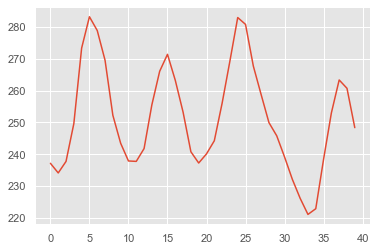

no_event no_event 2


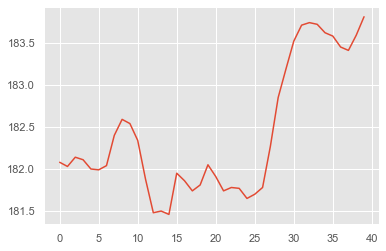

no_event no_event 1


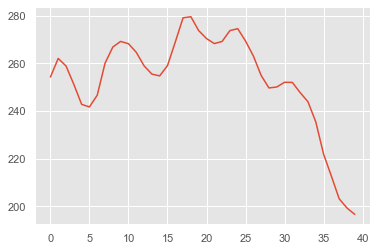

no_event no_event 2


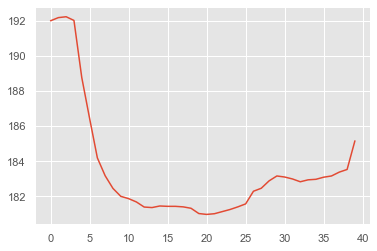

no_event no_event 1


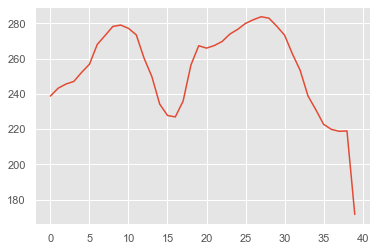

no_event no_event 2


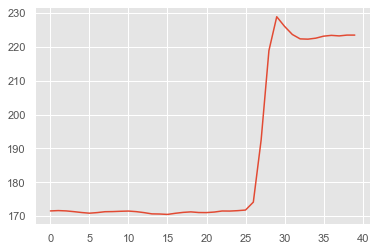

no_event no_event 1


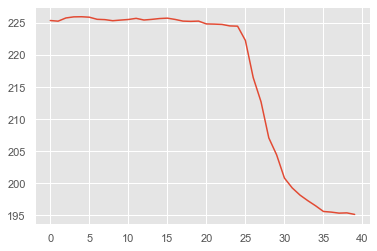

no_event no_event 1


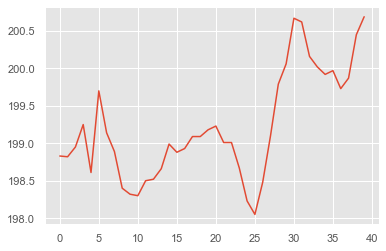

no_event no_event 2


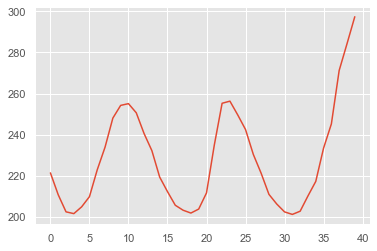

no_event no_event 2


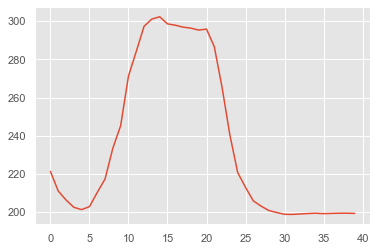

no_event no_event 1


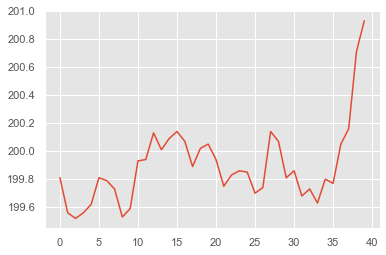

no_event no_event 2


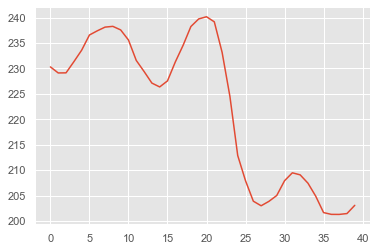

no_event no_event 1


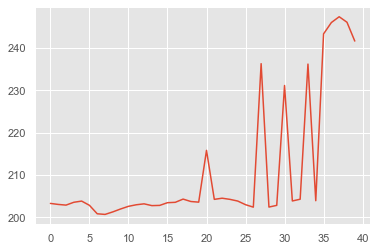

no_event no_event 1


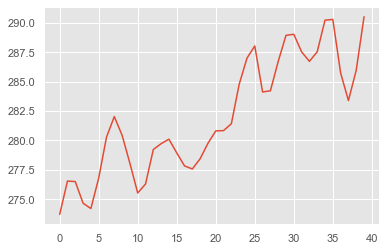

no_event no_event 2


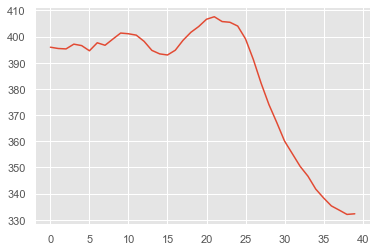

no_event no_event 1


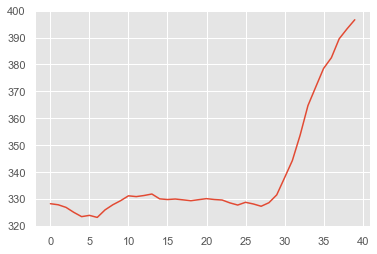

no_event no_event 2


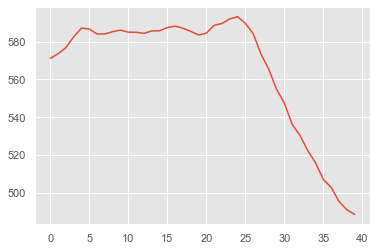

no_event no_event 2


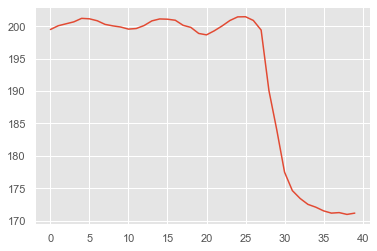

no_event no_event 1


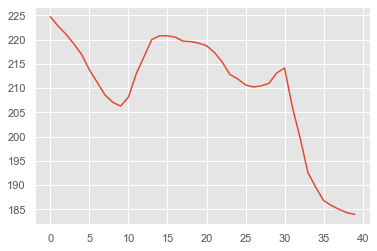

no_event no_event 1


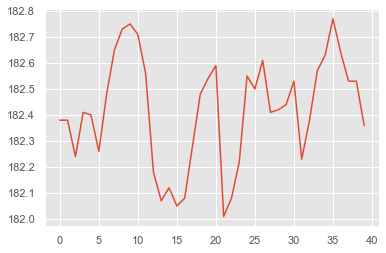

no_event no_event 1


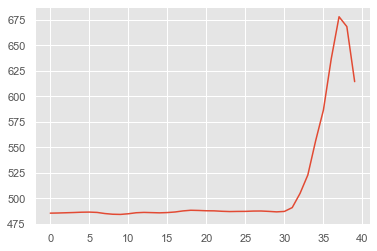

no_event no_event 2


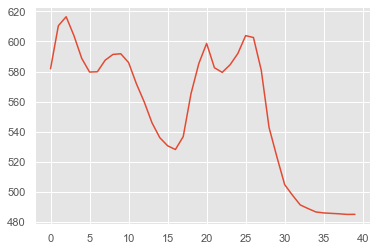

no_event no_event 1


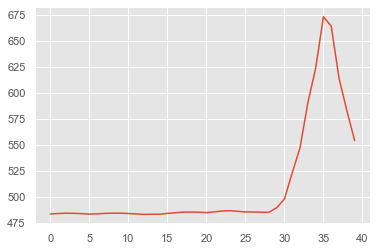

no_event no_event 2


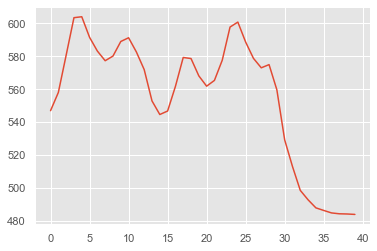

no_event no_event 1


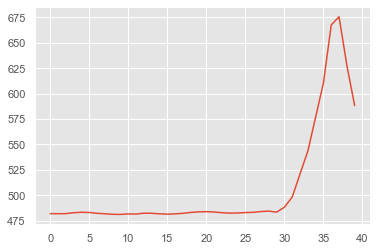

no_event no_event 2


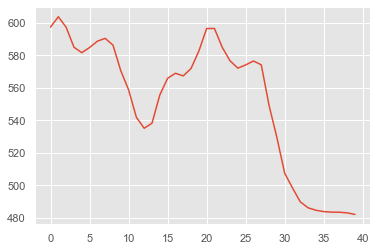

no_event no_event 1


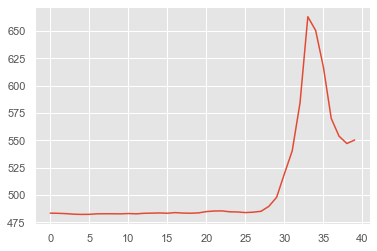

no_event no_event 2


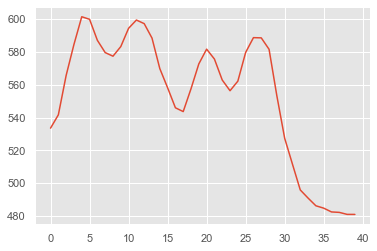

no_event no_event 1


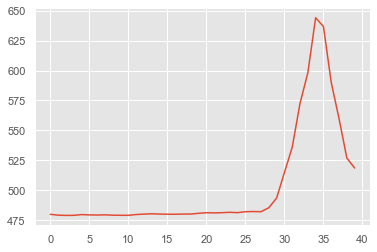

no_event no_event 2


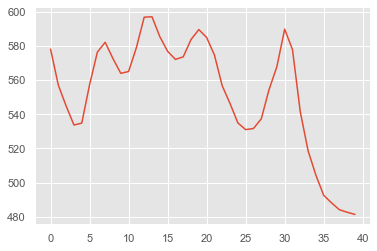

no_event no_event 1


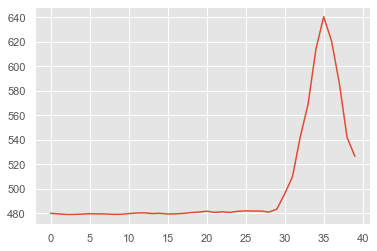

no_event no_event 2


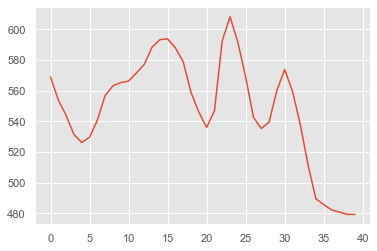

no_event no_event 1


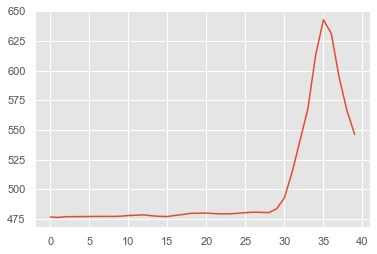

no_event no_event 2


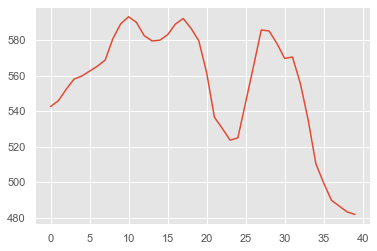

no_event no_event 1


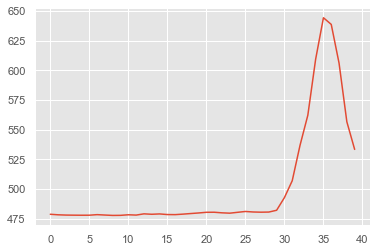

no_event no_event 2


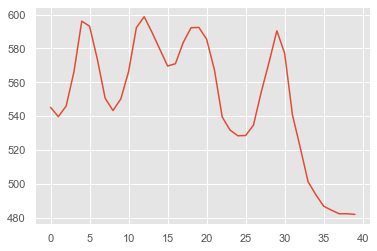

no_event no_event 1


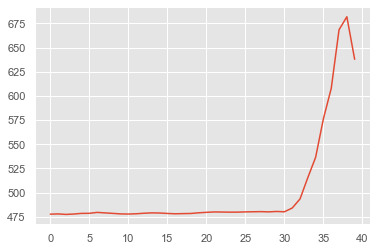

no_event no_event 2


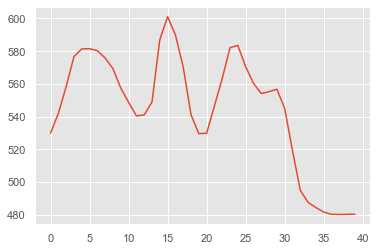

no_event no_event 1


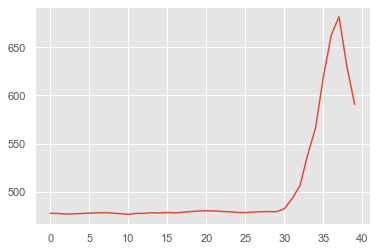

no_event no_event 2


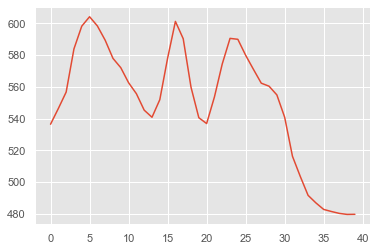

no_event no_event 1


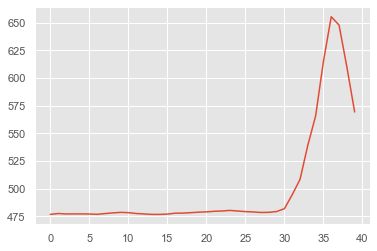

no_event no_event 2


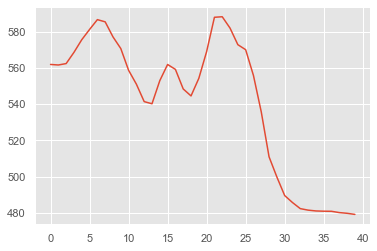

no_event no_event 1


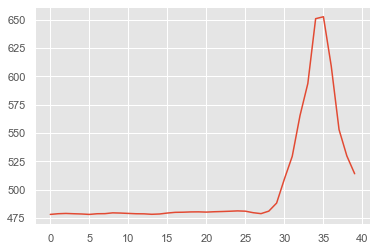

no_event no_event 1


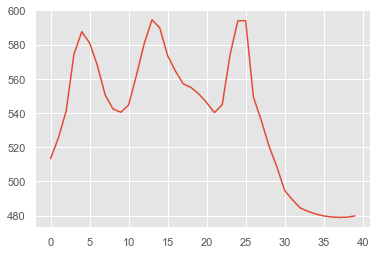

no_event no_event 1


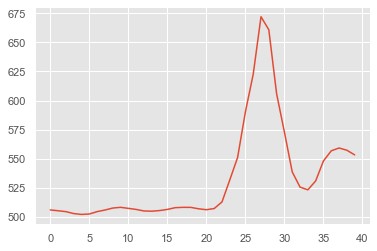

no_event no_event 2


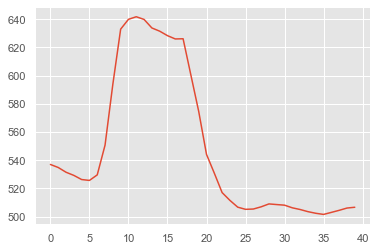

no_event no_event 1


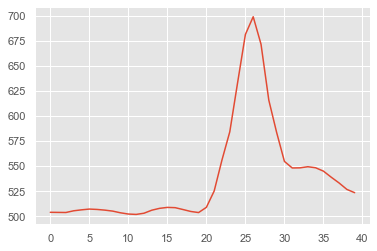

no_event no_event 1


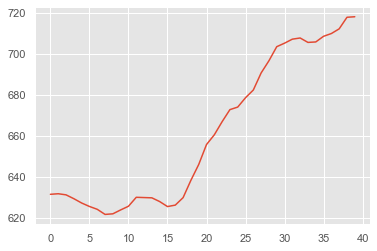

no_event no_event 2


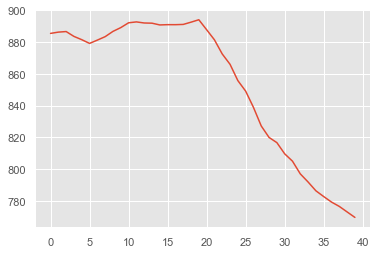

no_event no_event 1


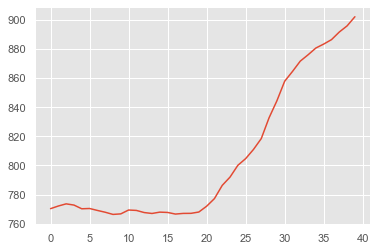

no_event no_event 2


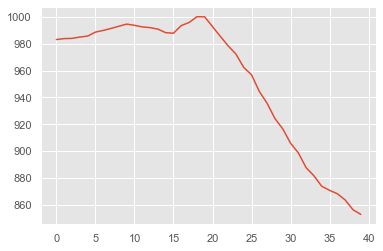

no_event no_event 2


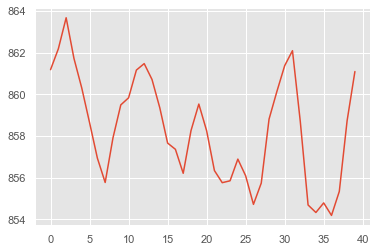

no_event no_event 2


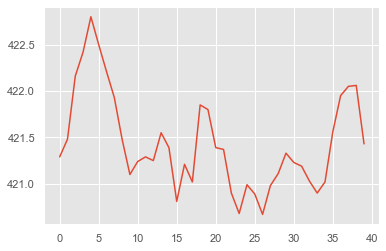

no_event Refrigerator_ON 1


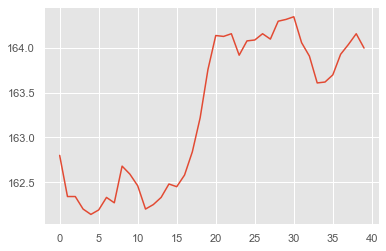

no_event no_event 2


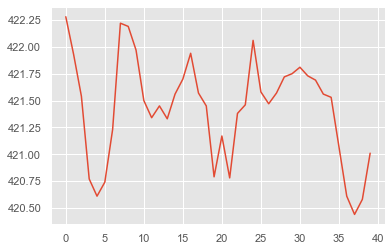

In [39]:
def read_series(vc):
    if vc.index[0] != 'no_event':
        return vc.index[0]
    elif len(vc) > 1:
        if vc[1] > 2:
            return vc.index[1]
    return vc.index[0]

def plot_around_observed_events(indice, data):
    frequency = 20
    timewindow = 1
    startindice = max(0, indice - frequency * timewindow)
    endindice = min(len(data) - 1, indice + frequency * timewindow)
    data = (data[startindice:endindice][['mains_power']]).to_numpy()
    plt.plot(data)
    plt.show()
    return 

act_list = []
pre_list = []

for i in range(len(ind_obser_events)):
    fvc = label_list[i]
    pvc = pred_list[i]
    act_list.append(read_series(fvc))
    pre_list.append(read_series(pvc))
    print(read_series(fvc), read_series(pvc), tr_data.observable_event[ind_obser_events[i]])
#     if read_series(fvc)!= read_series(pvc):
    plot_around_observed_events(ind_obser_events[i], tr_data)
    
    

In [40]:
ylab = act_list
pred = pre_list
print(f1_score(y_true=ylab, y_pred=pred,average="macro"))
print(accuracy_score(y_true=ylab, y_pred=pred))
cf1 = confusion_matrix(y_true=ylab, y_pred=pred)
calculate_metrics(cf1)

0.2139975456358337
0.9719202898550725
For label  0
tp:  0  fp:  3  fn:  0  tn:  1101
For label  1
tp:  0  fp:  4  fn:  0  tn:  1100
For label  2
tp:  0  fp:  1  fn:  3  tn:  1100
For label  3
tp:  1  fp:  22  fn:  0  tn:  1081
For label  4
tp:  1072  fp:  1  fn:  28  tn:  3


In [41]:
len(ind_obser_events)

1104

In [22]:
ylab = np.argmax(y_train, axis=1)
print(f1_score(y_true=ylab, y_pred=pred,average="macro"))
print(accuracy_score(y_true=ylab, y_pred=pred))
cf1 = confusion_matrix(y_true=ylab, y_pred=pred) # x_axis = predicted, y_axis = ground_truth
print(cf1)
calculate_metrics(cf1)

0.34773894647926884
0.9879779107059206
[[    229      73      15]
 [    189     207      18]
 [  19568   14834 2850971]]
For label  0
tp:  229  fp:  19757  fn:  88  tn:  2866030
For label  1
tp:  207  fp:  14907  fn:  207  tn:  2870783
For label  2
tp:  2850971  fp:  33  fn:  34402  tn:  698


AC_ON


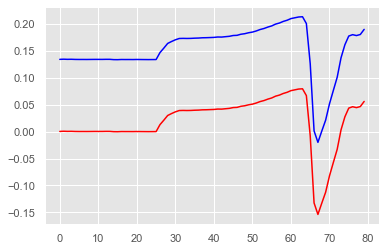

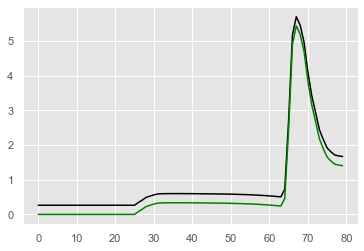

AC_ON


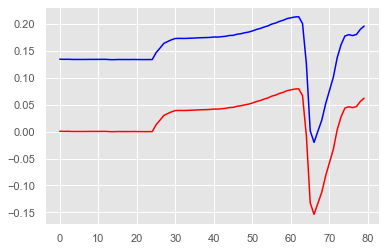

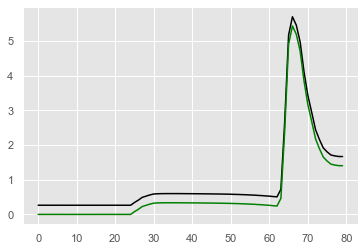

AC_ON


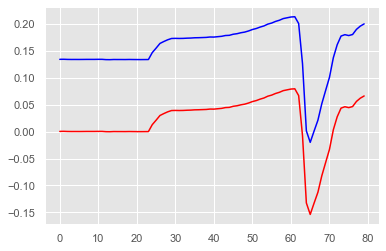

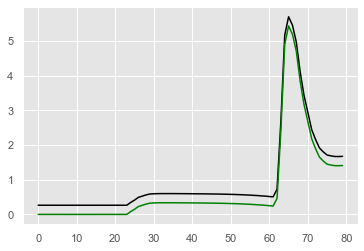

AC_ON


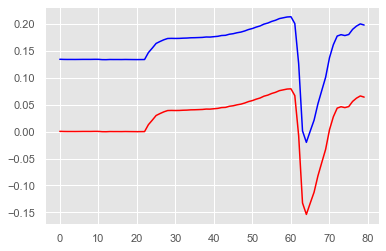

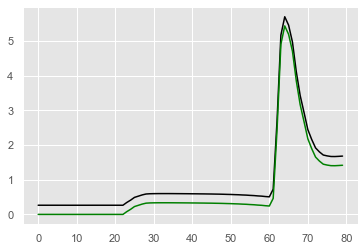

AC_ON


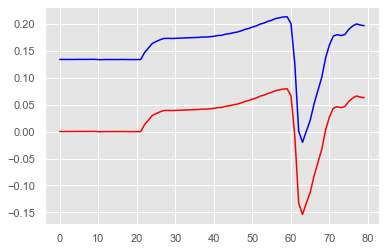

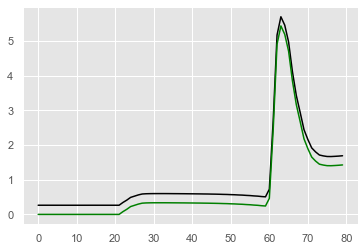

AC_ON


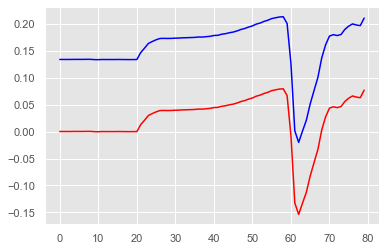

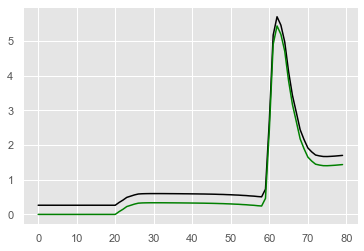

AC_ON


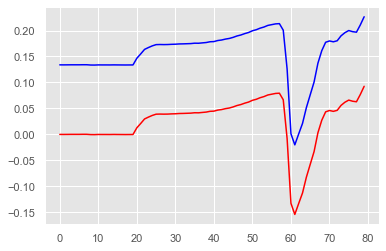

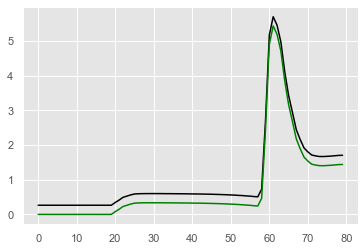

AC_ON


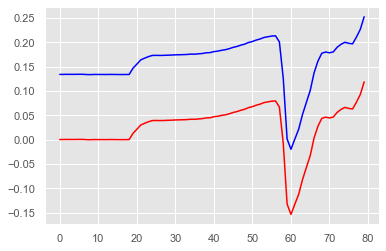

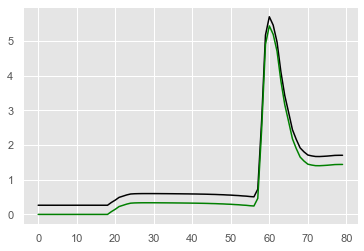

AC_ON


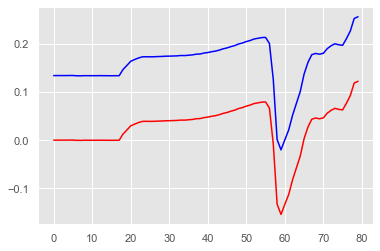

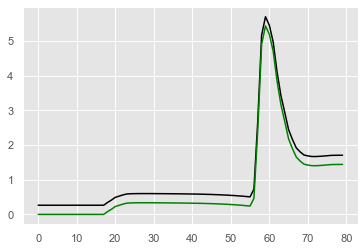

AC_ON


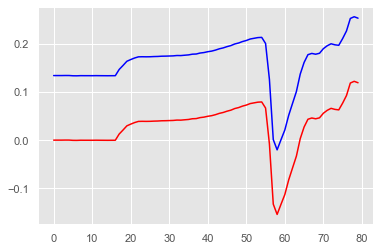

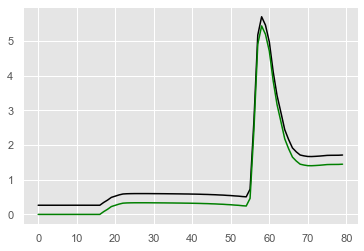

AC_ON


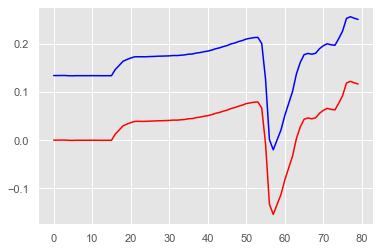

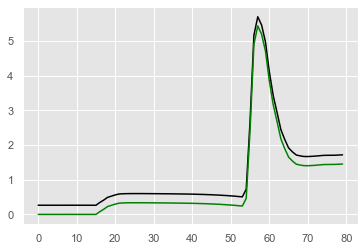

AC_ON


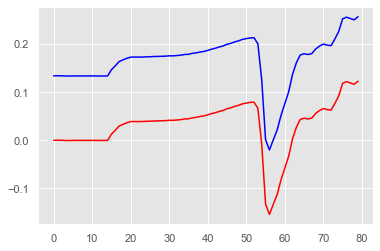

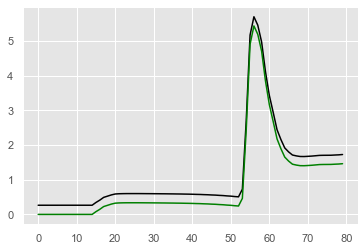

AC_ON


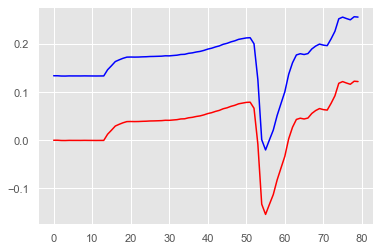

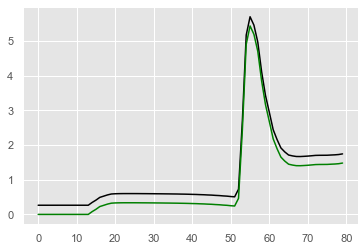

AC_ON


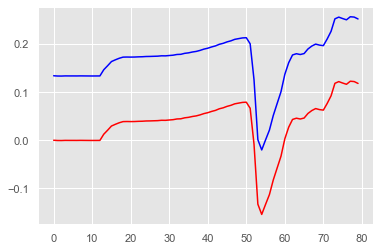

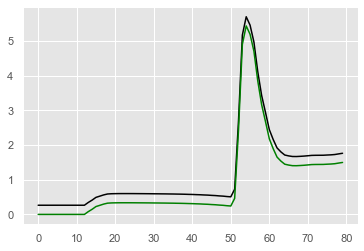

AC_ON


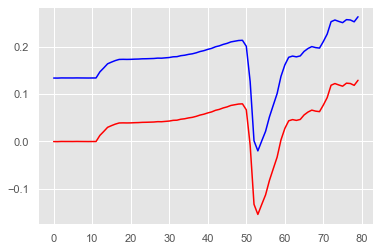

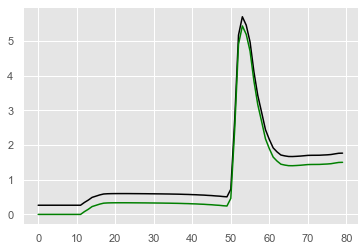

AC_ON


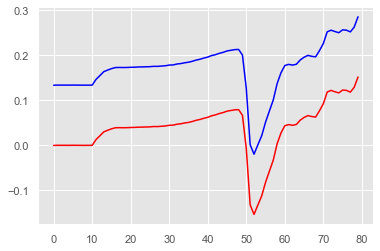

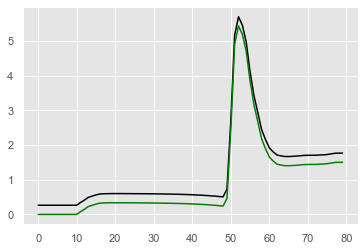

AC_ON


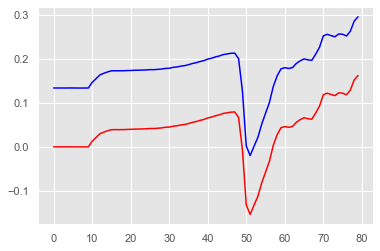

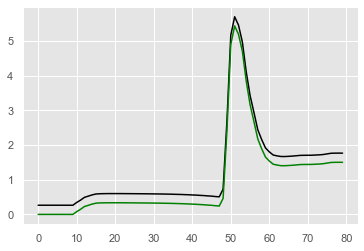

AC_ON


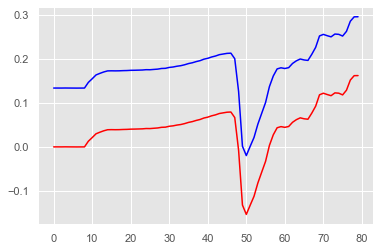

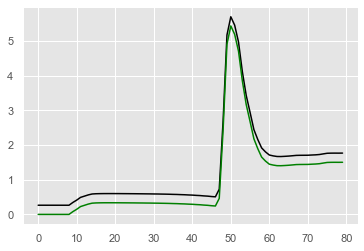

AC_ON


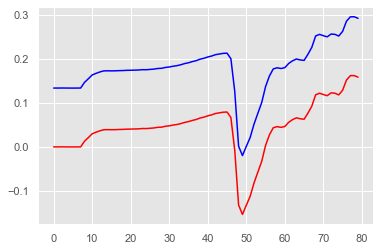

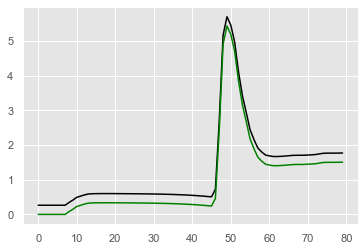

AC_ON


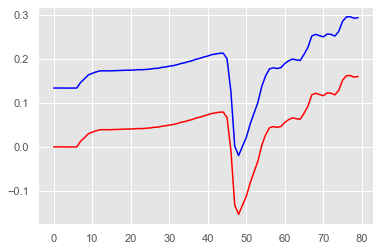

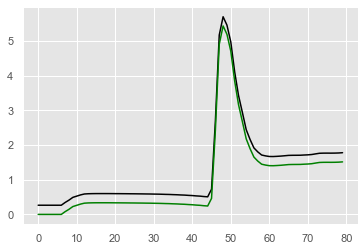

AC_OFF


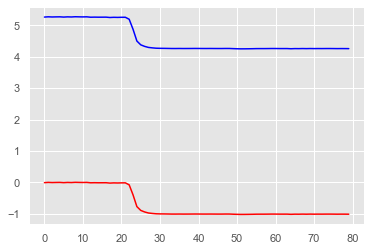

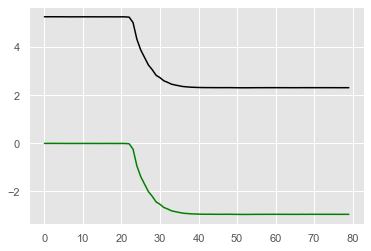

AC_OFF


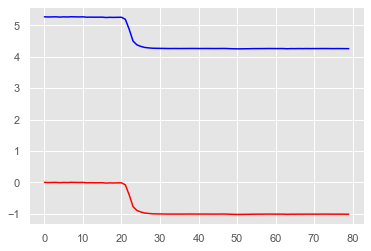

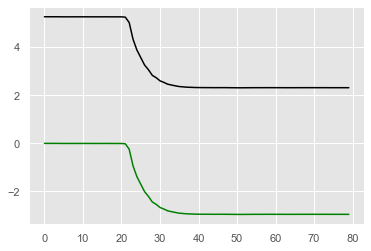

AC_OFF


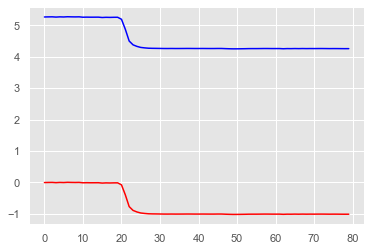

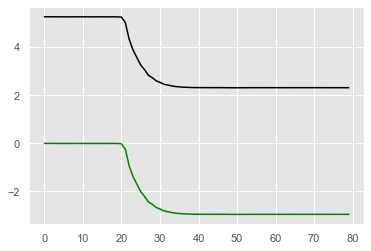

AC_OFF


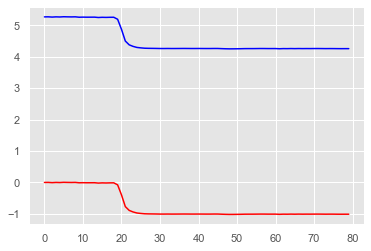

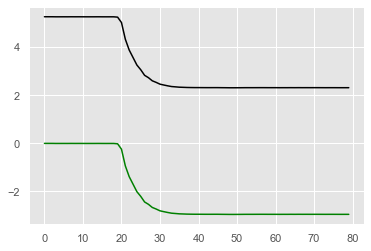

AC_OFF


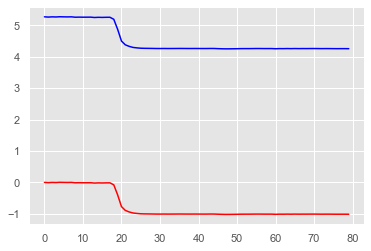

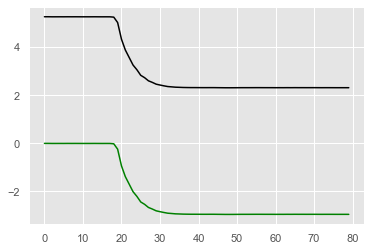

AC_OFF


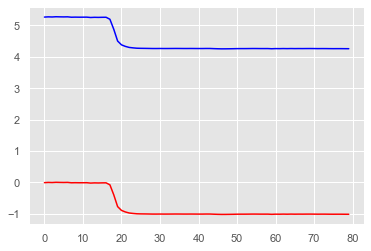

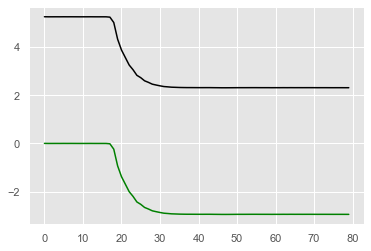

AC_OFF


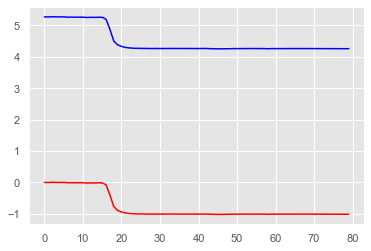

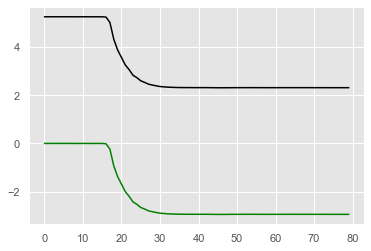

AC_OFF


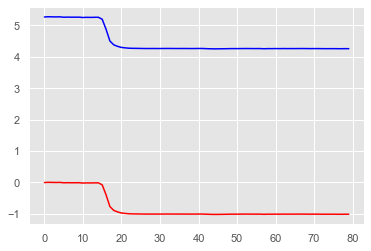

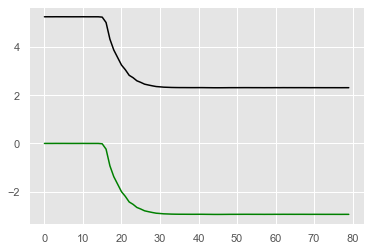

AC_OFF


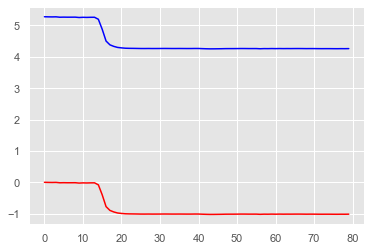

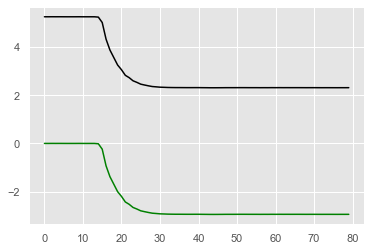

AC_OFF


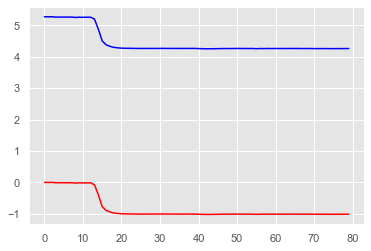

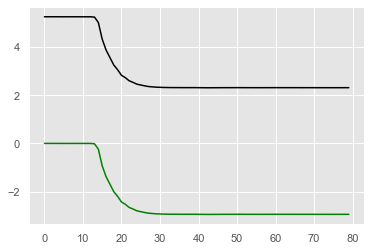

AC_OFF


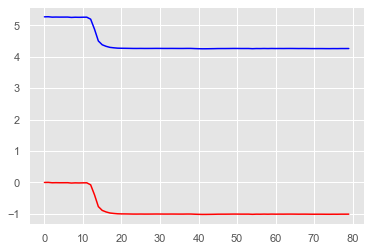

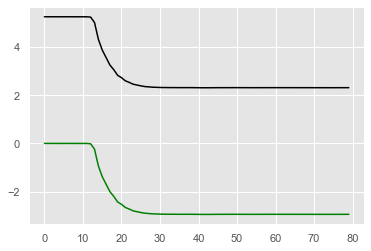

AC_OFF


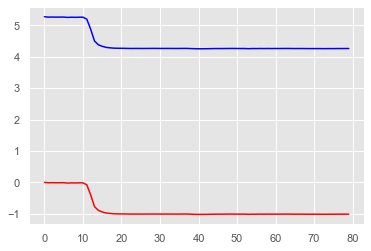

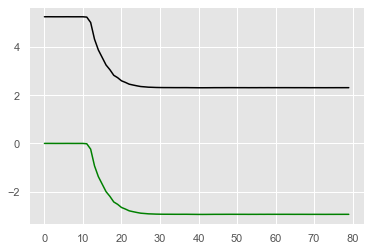

AC_OFF


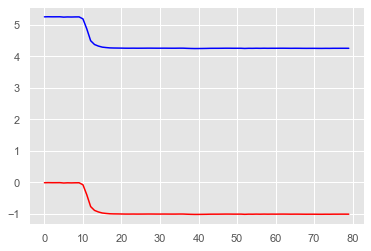

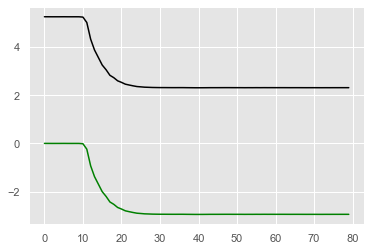

AC_OFF


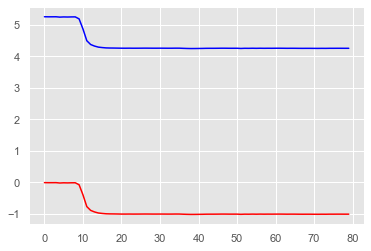

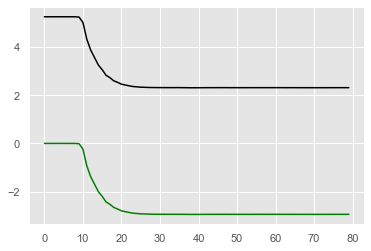

AC_OFF


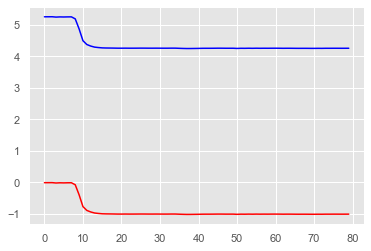

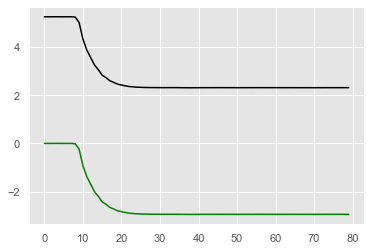

AC_OFF


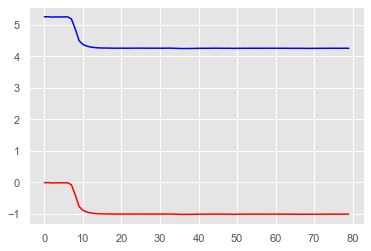

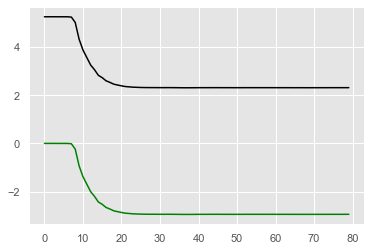

AC_OFF


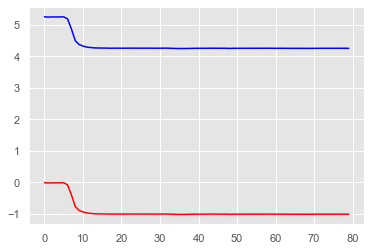

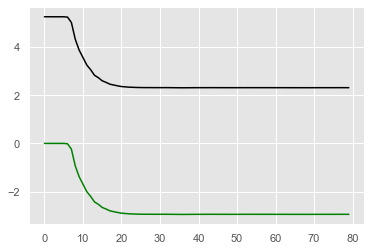

AC_OFF


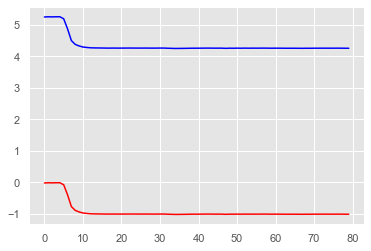

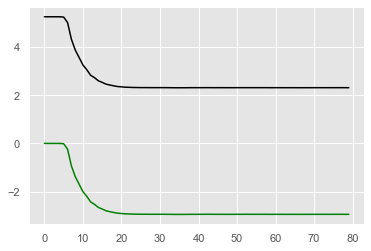

AC_OFF


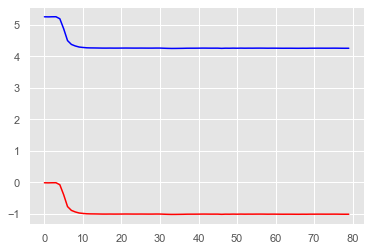

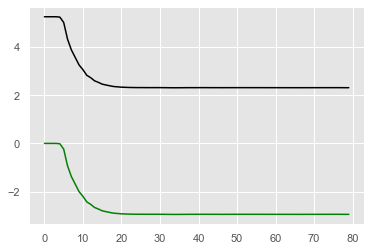

AC_OFF


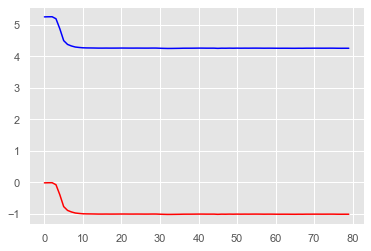

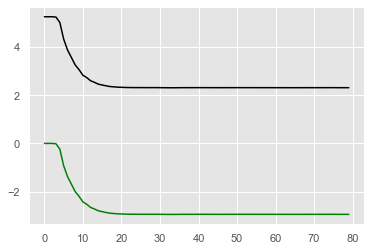

Microwave_ON


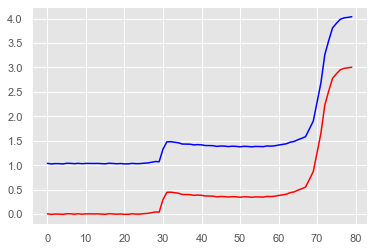

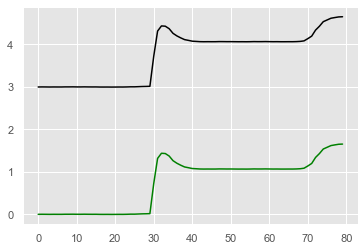

Microwave_ON


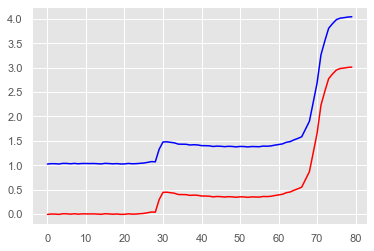

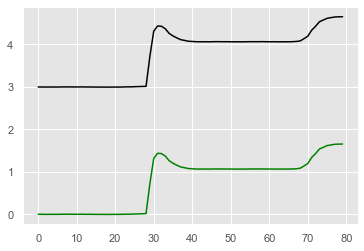

Microwave_ON


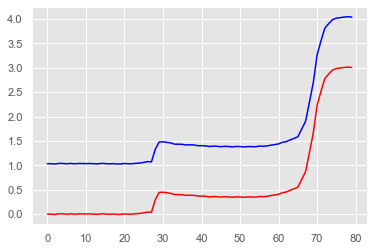

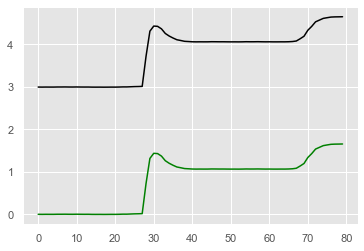

Microwave_ON


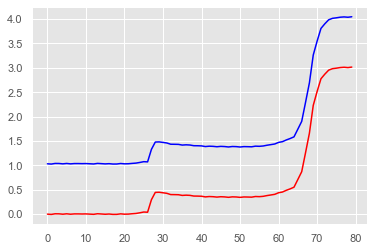

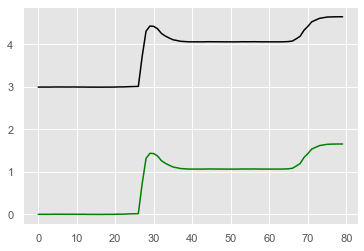

Microwave_ON


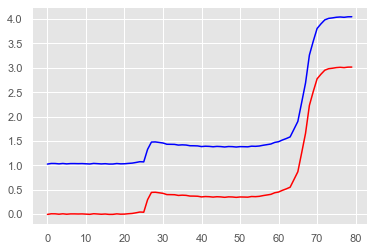

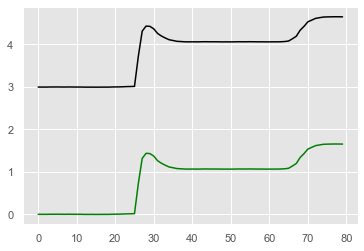

Microwave_ON


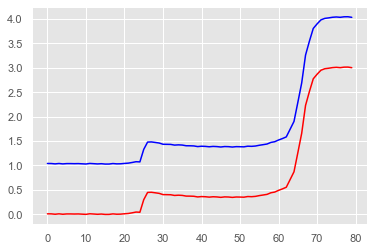

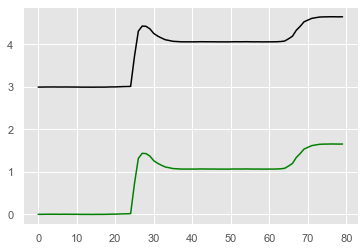

Microwave_ON


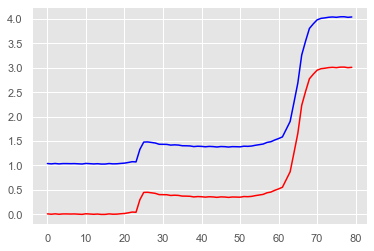

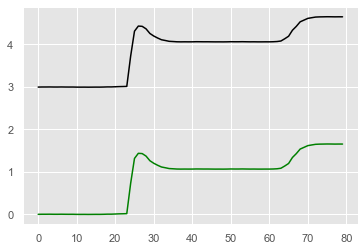

Microwave_ON


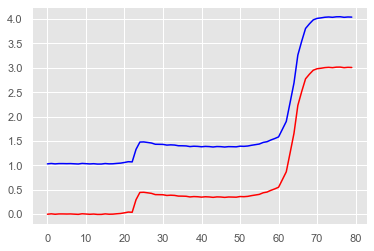

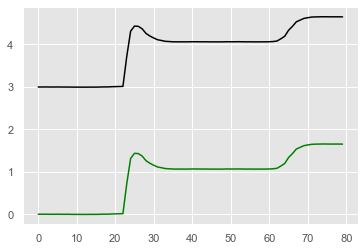

Microwave_ON


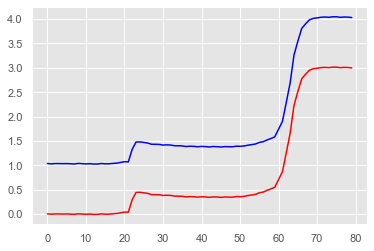

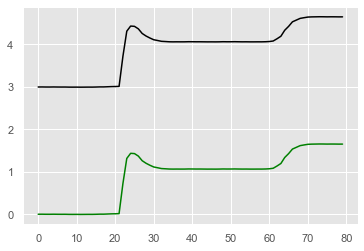

Microwave_ON


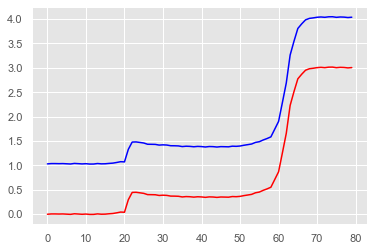

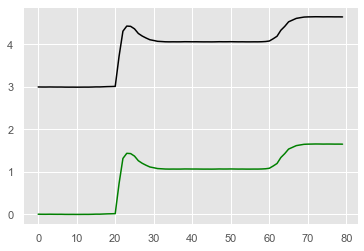

Microwave_ON


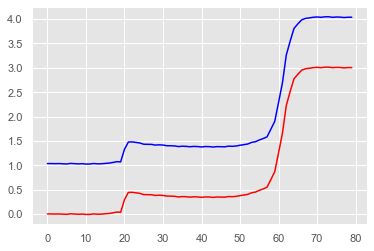

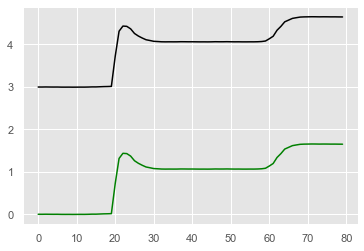

Microwave_ON


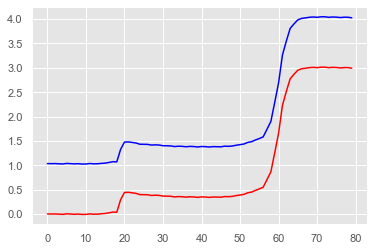

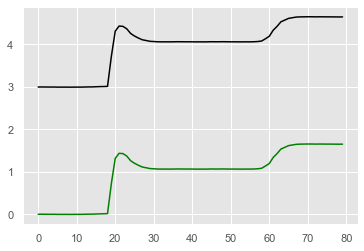

Microwave_ON


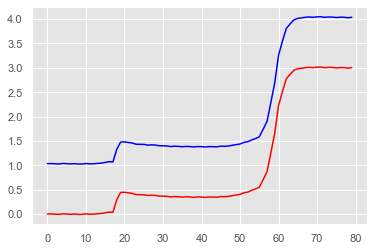

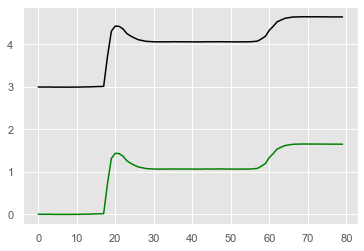

Microwave_ON


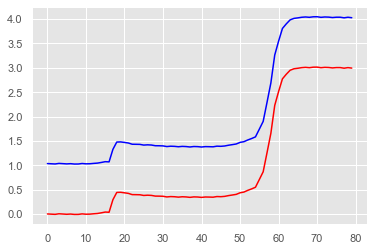

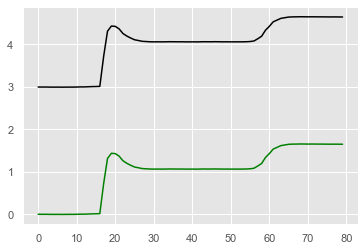

Microwave_ON


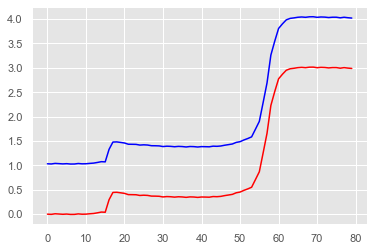

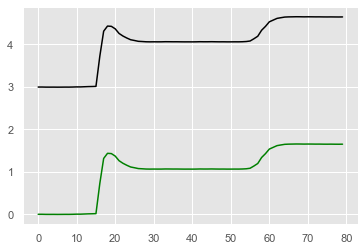

Microwave_ON


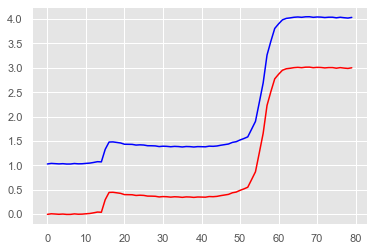

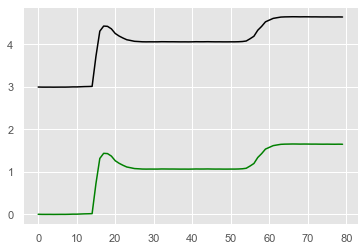

Microwave_ON


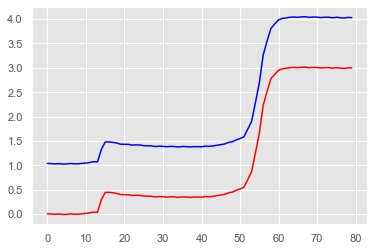

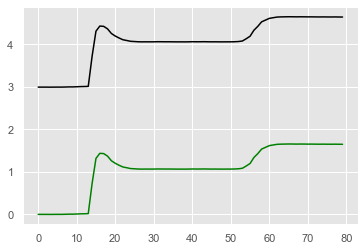

Microwave_ON


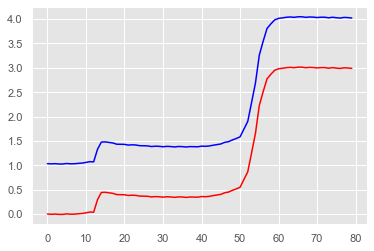

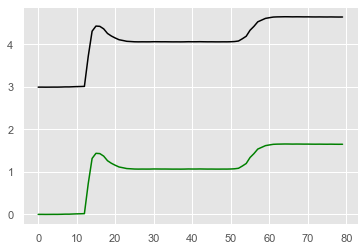

Microwave_ON


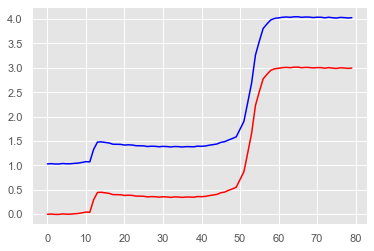

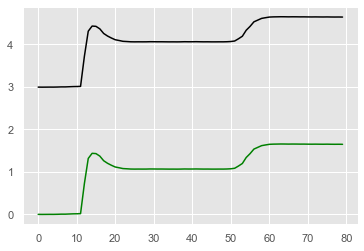

Microwave_ON


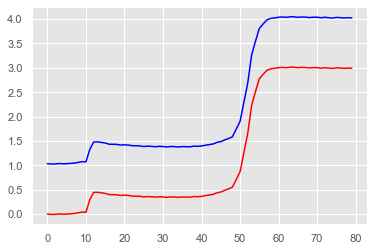

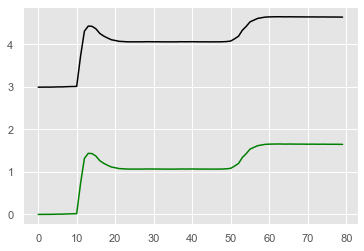

Geyser_ON


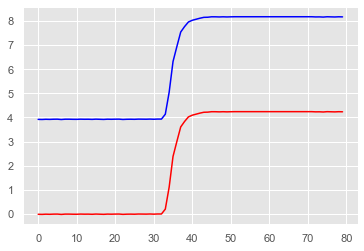

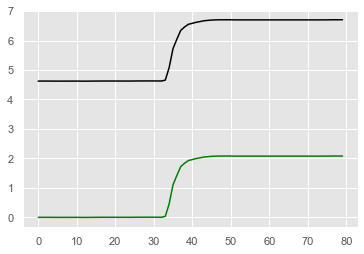

Geyser_ON


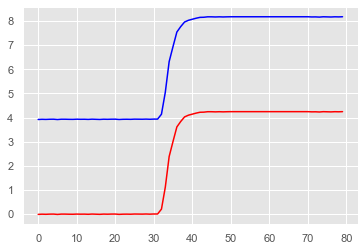

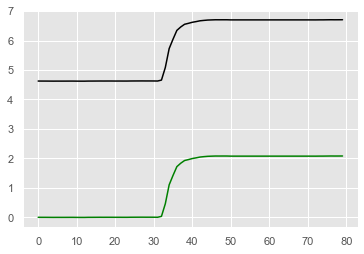

Geyser_ON


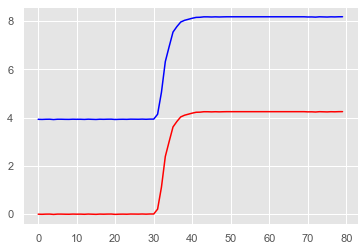

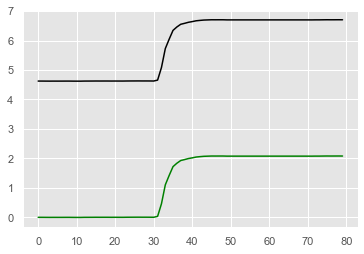

Geyser_ON


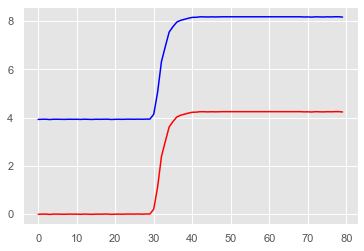

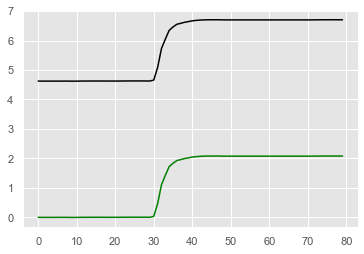

Geyser_ON


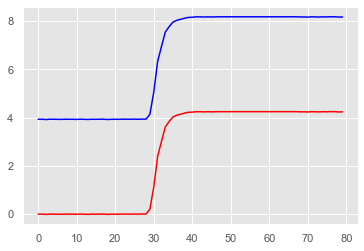

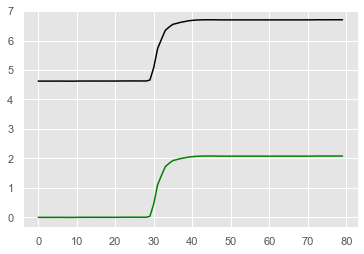

Geyser_ON


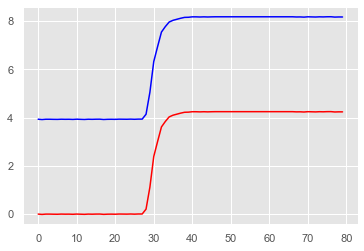

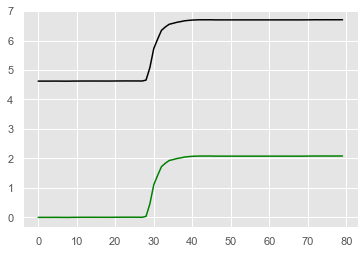

Geyser_ON


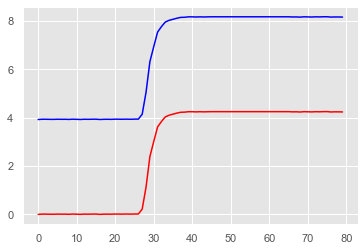

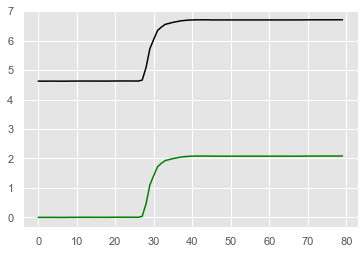

Geyser_ON


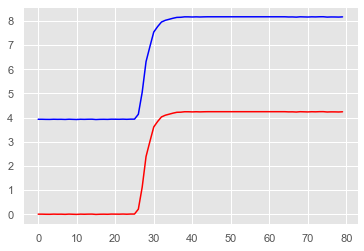

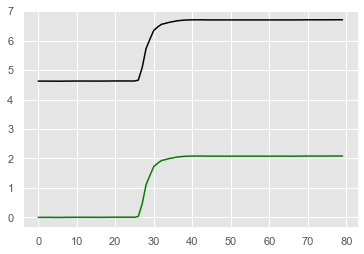

Geyser_ON


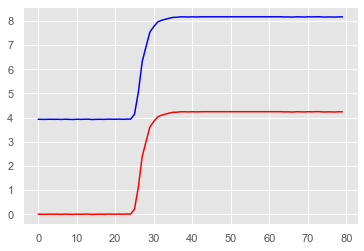

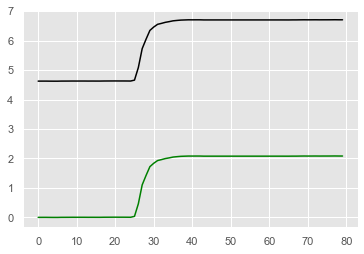

Geyser_ON


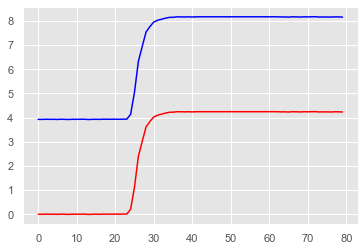

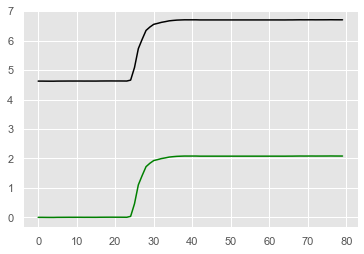

Geyser_ON


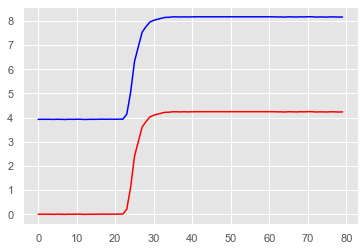

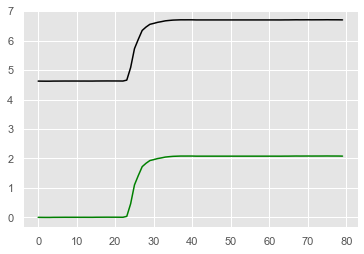

Geyser_ON


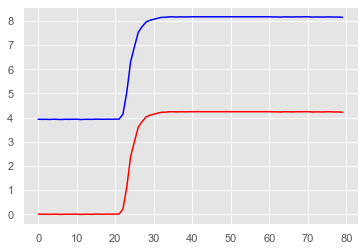

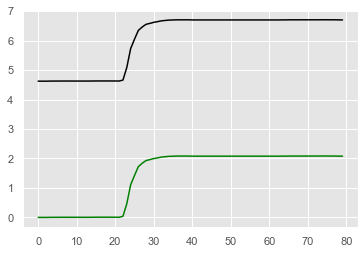

Geyser_ON


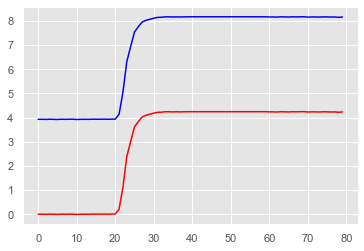

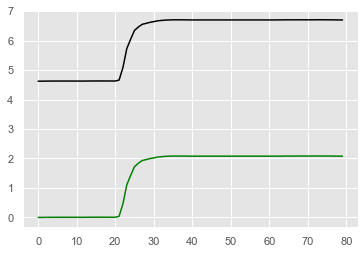

Geyser_ON


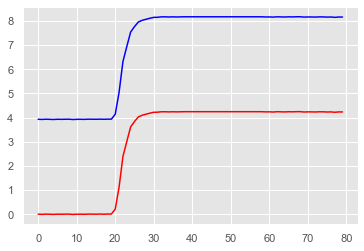

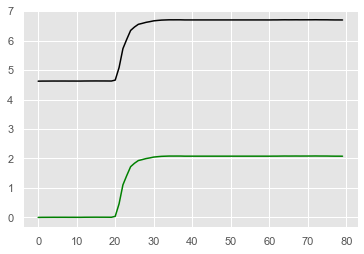

Geyser_ON


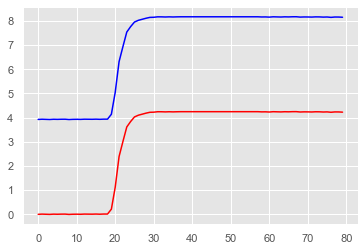

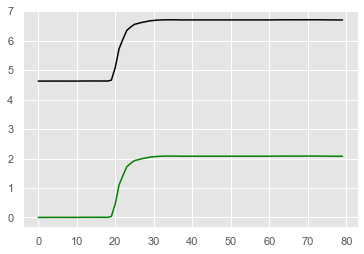

Geyser_ON


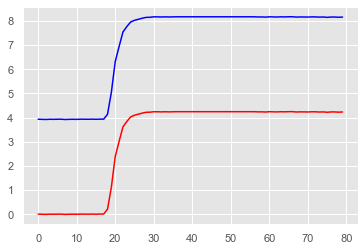

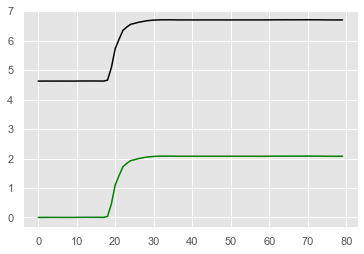

Geyser_ON


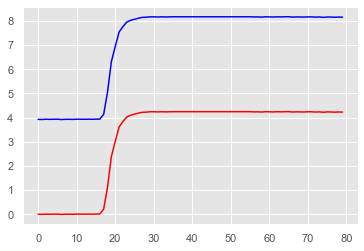

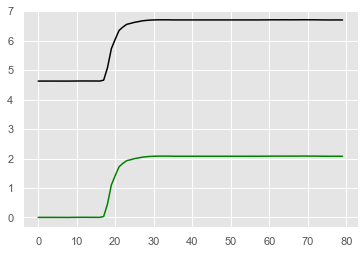

Geyser_ON


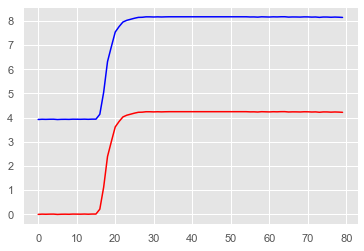

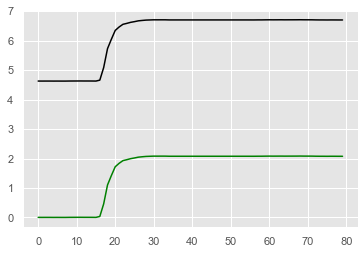

Geyser_ON


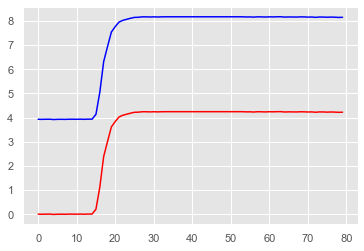

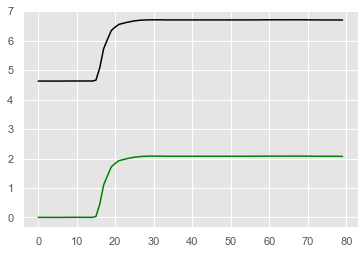

Geyser_ON


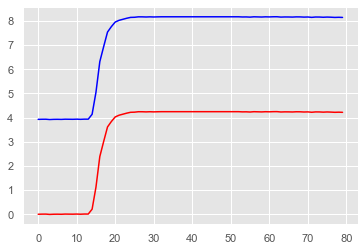

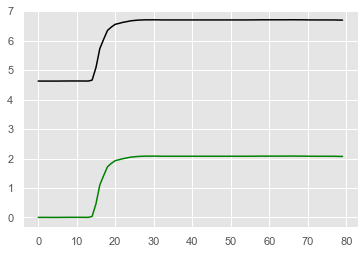

Microwave_OFF


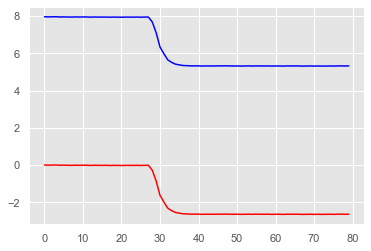

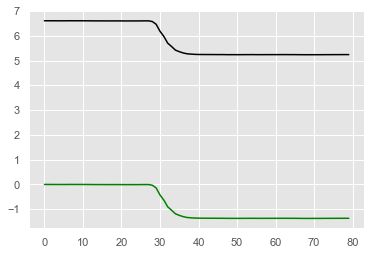

Microwave_OFF


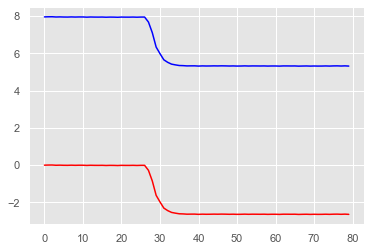

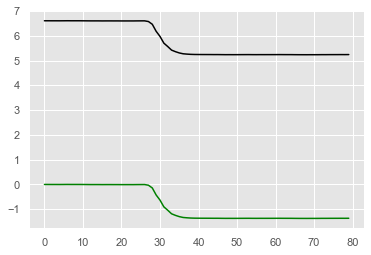

Microwave_OFF


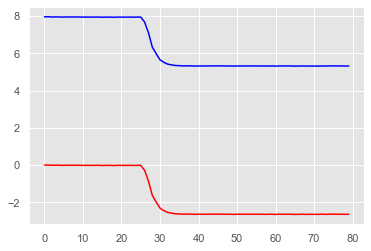

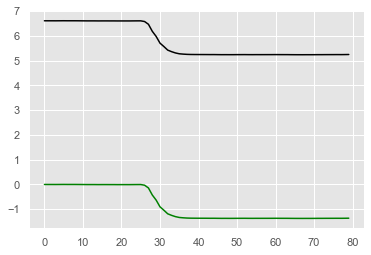

Microwave_OFF


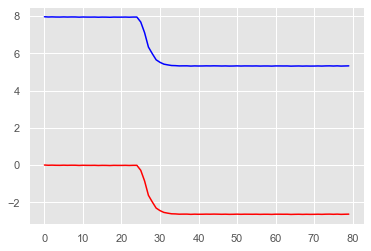

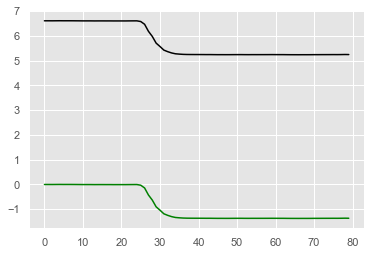

Microwave_OFF


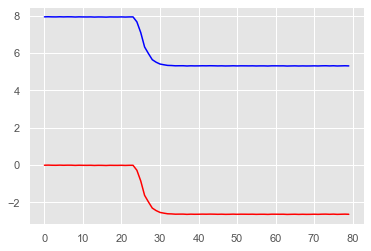

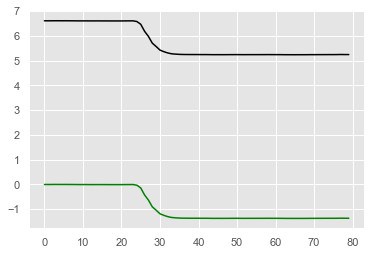

Microwave_OFF


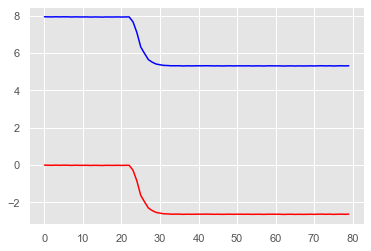

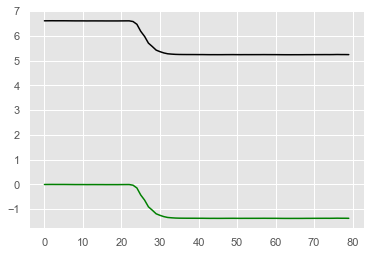

Microwave_OFF


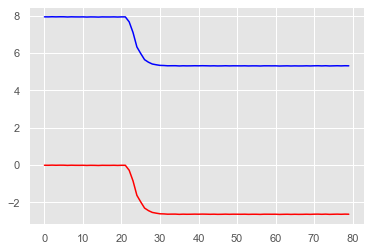

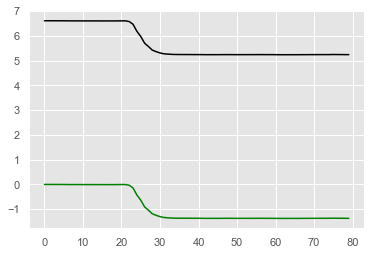

Microwave_OFF


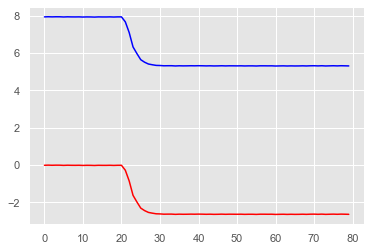

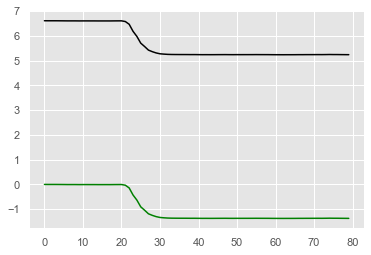

Microwave_OFF


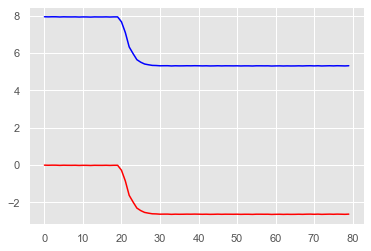

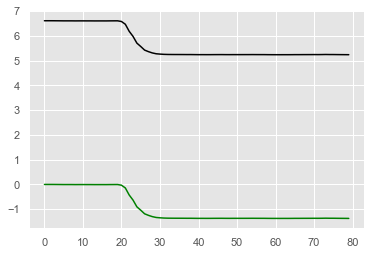

Microwave_OFF


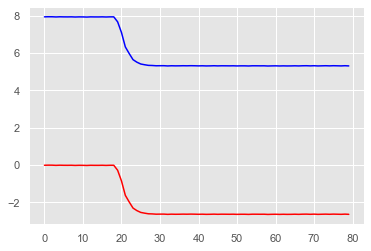

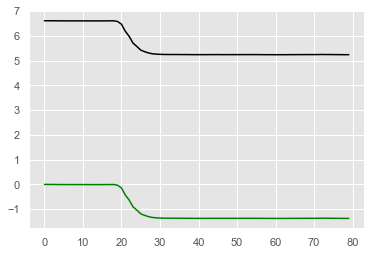

Microwave_OFF


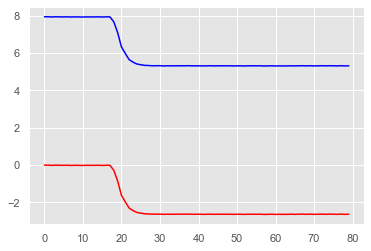

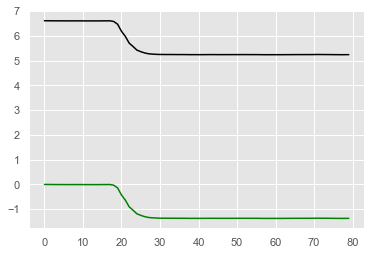

Microwave_OFF


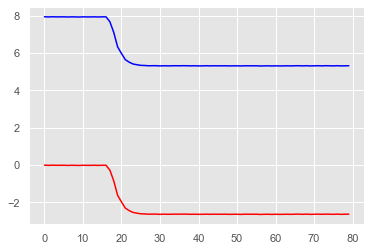

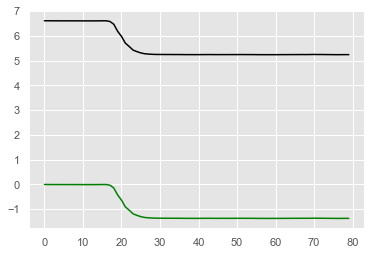

Microwave_OFF


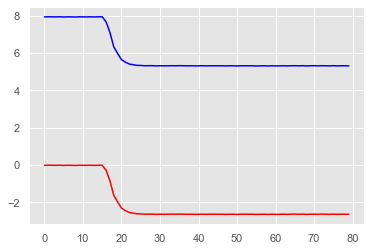

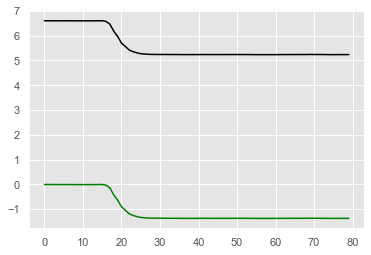

Microwave_OFF


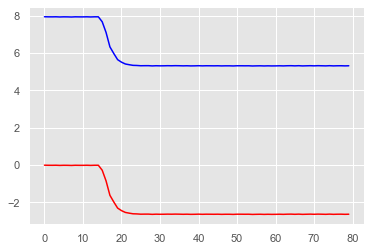

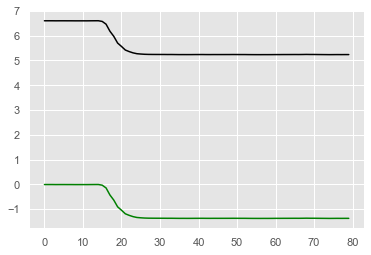

Microwave_OFF


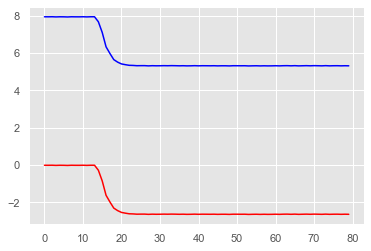

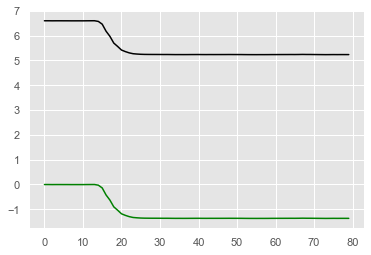

Microwave_OFF


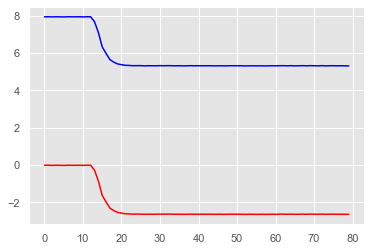

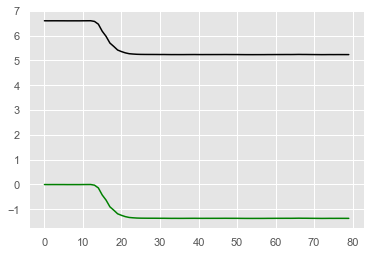

Microwave_OFF


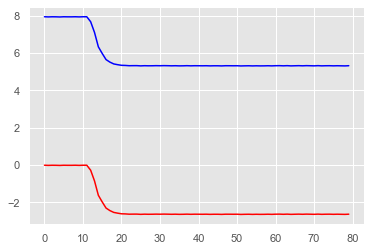

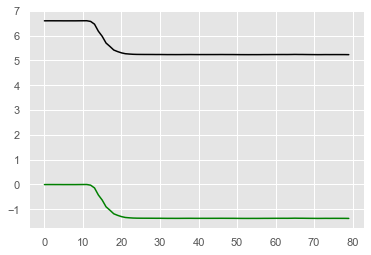

Microwave_OFF


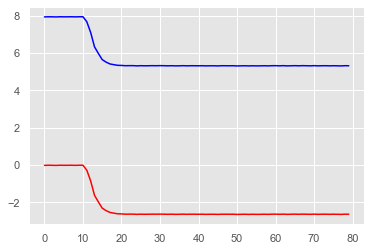

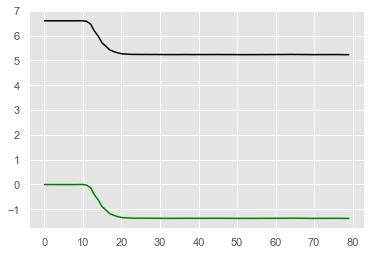

Microwave_OFF


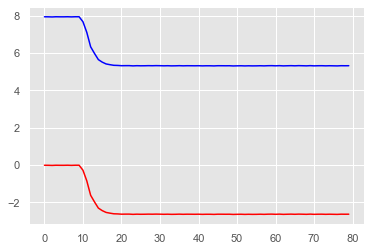

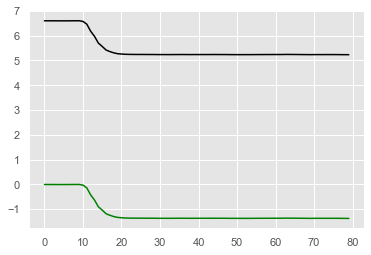

Microwave_OFF


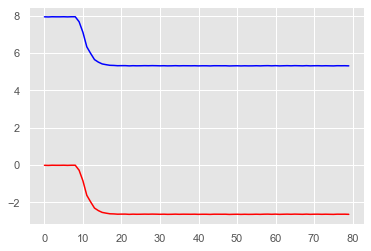

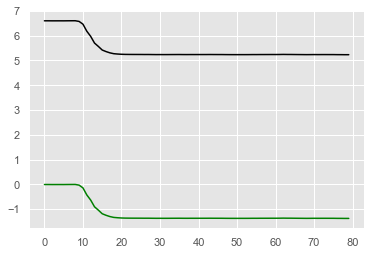

Geyser_OFF


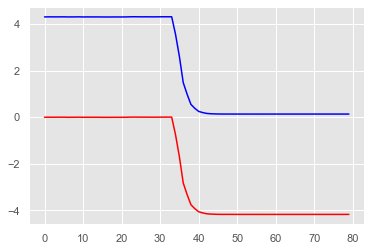

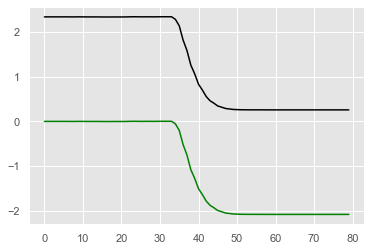

Geyser_OFF


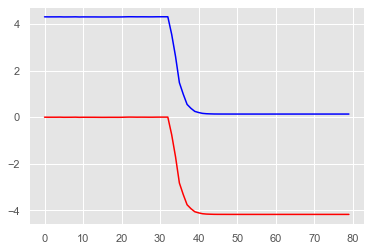

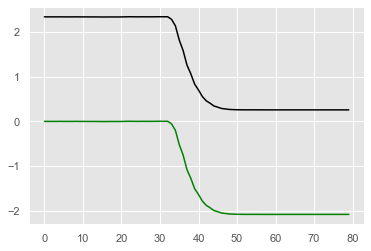

Geyser_OFF


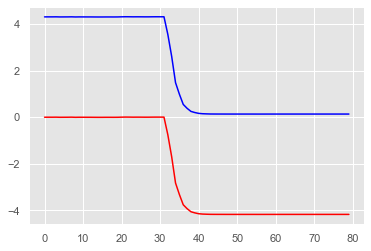

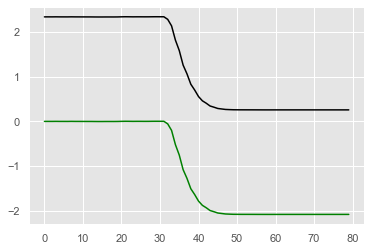

Geyser_OFF


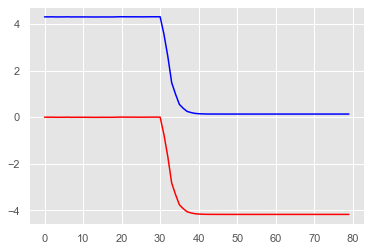

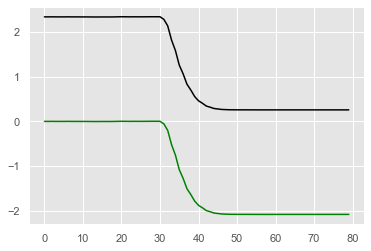

Geyser_OFF


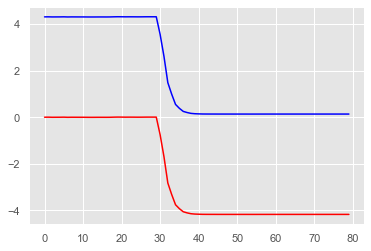

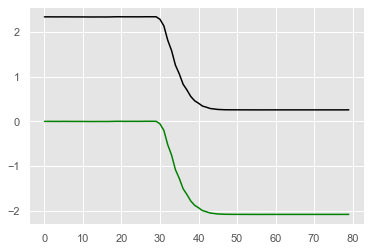

Geyser_OFF


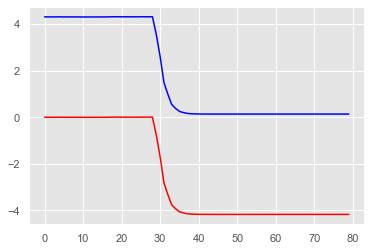

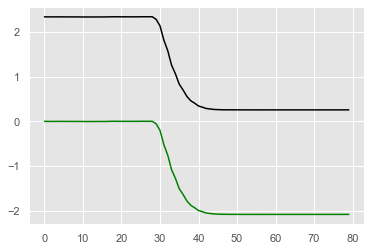

Geyser_OFF


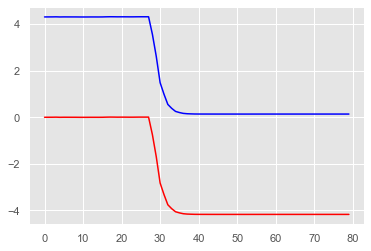

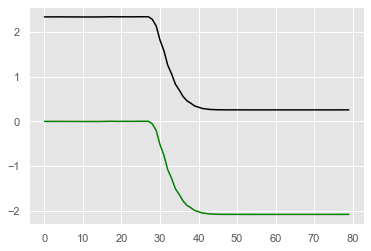

Geyser_OFF


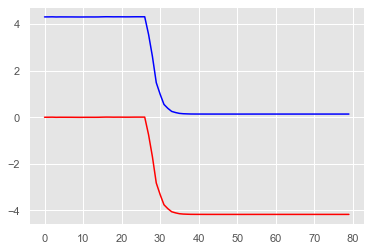

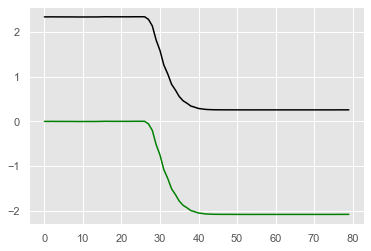

Geyser_OFF


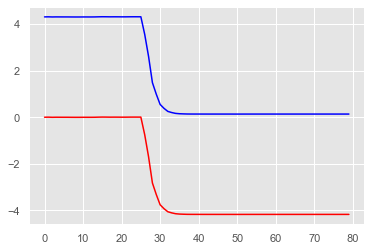

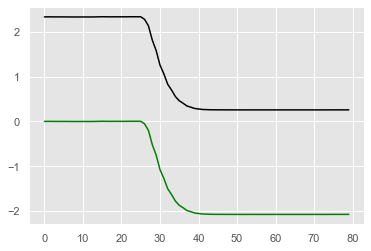

Geyser_OFF


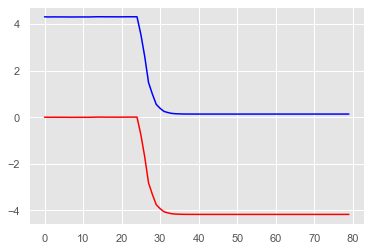

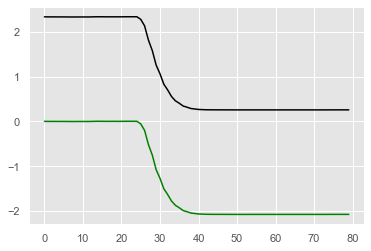

Geyser_OFF


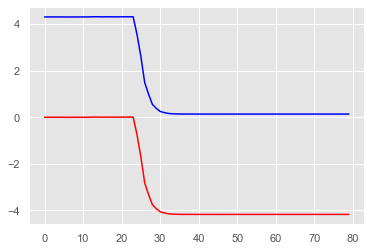

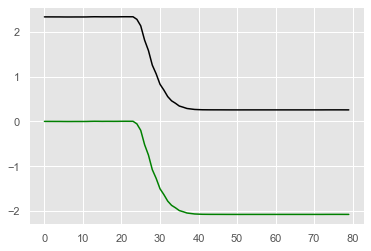

Geyser_OFF


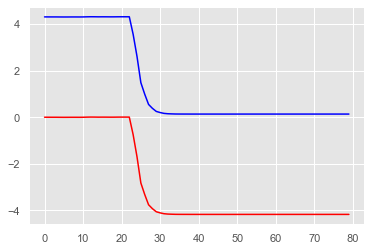

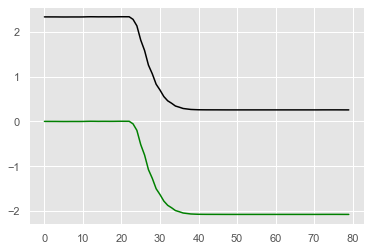

Geyser_OFF


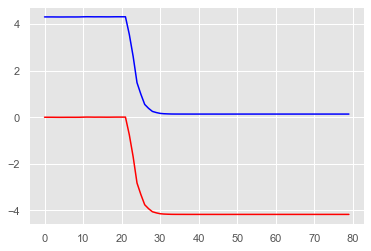

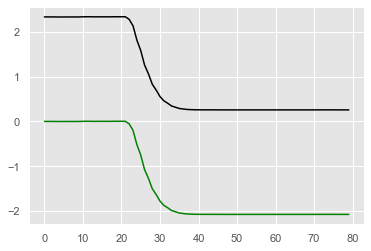

Geyser_OFF


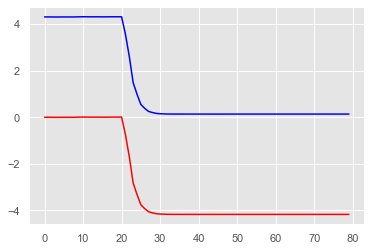

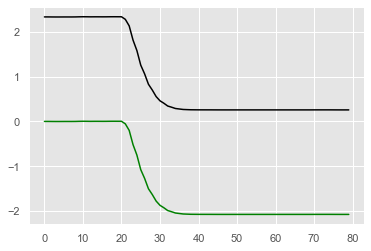

Geyser_OFF


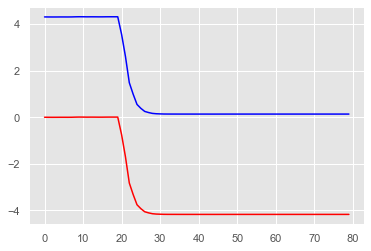

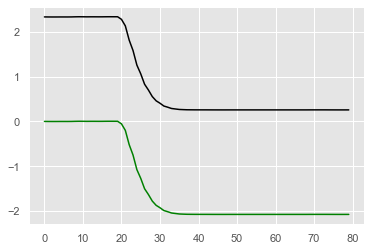

Geyser_OFF


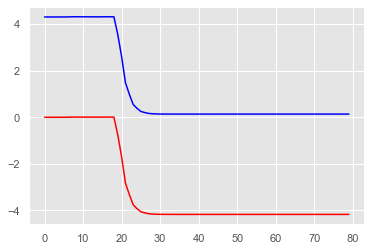

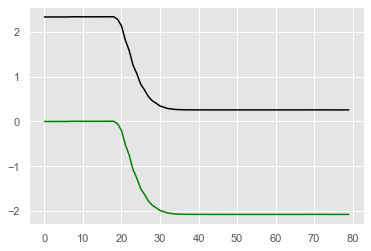

Geyser_OFF


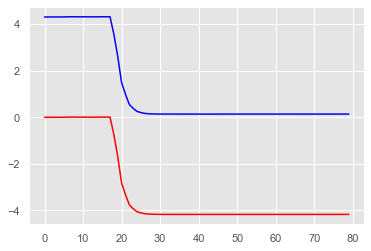

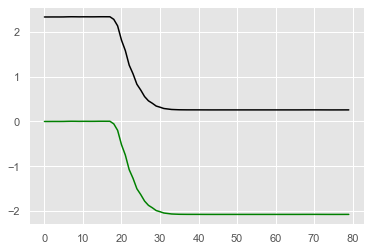

Geyser_OFF


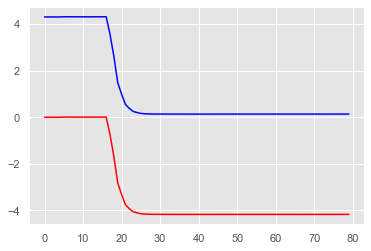

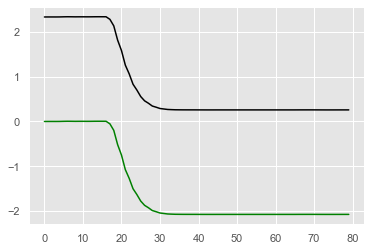

Geyser_OFF


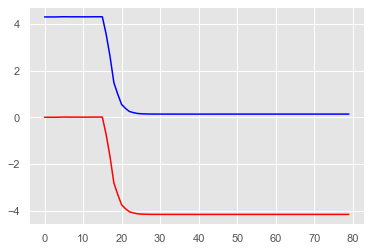

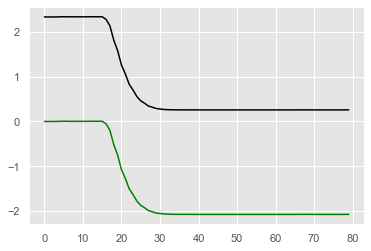

Geyser_OFF


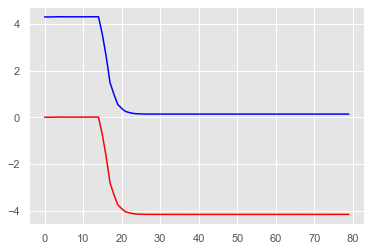

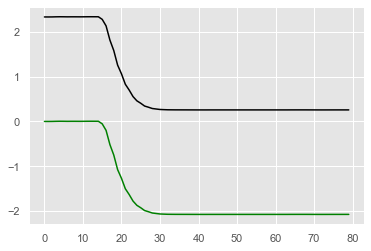

Microwave_ON


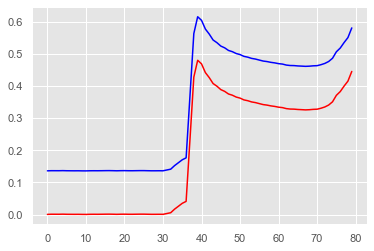

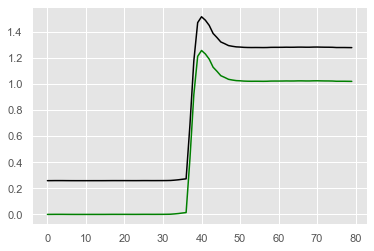

Microwave_ON


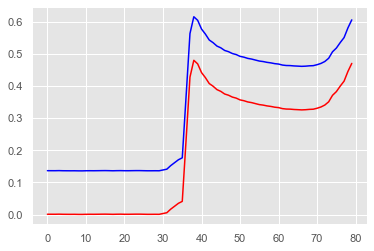

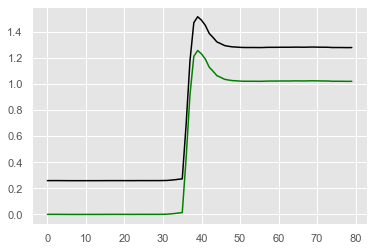

Microwave_ON


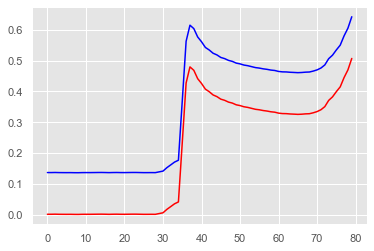

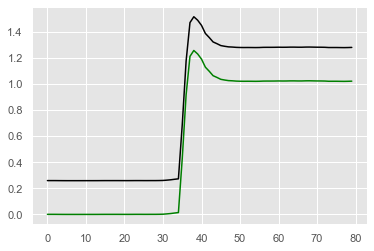

Microwave_ON


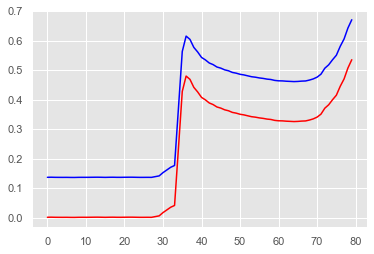

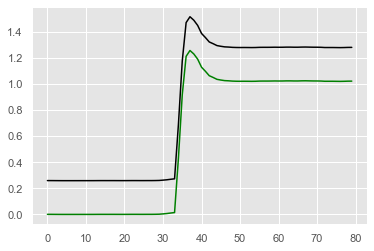

Microwave_ON


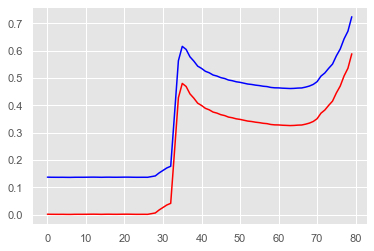

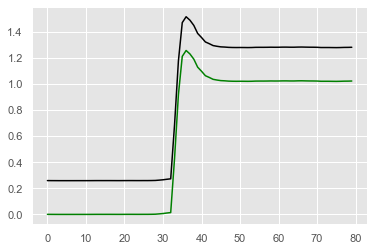

Microwave_ON


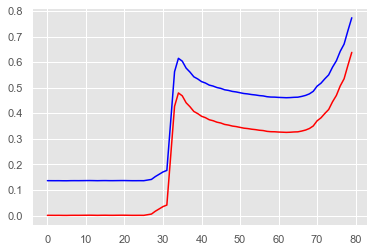

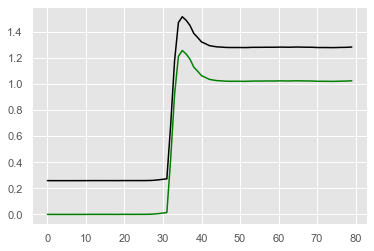

Microwave_ON


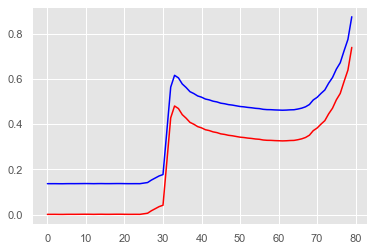

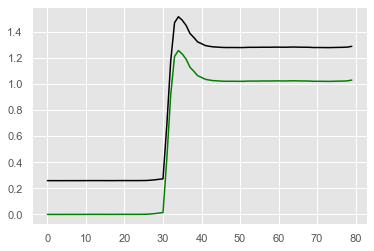

Microwave_ON


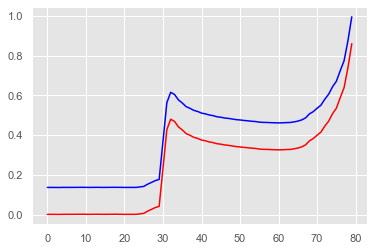

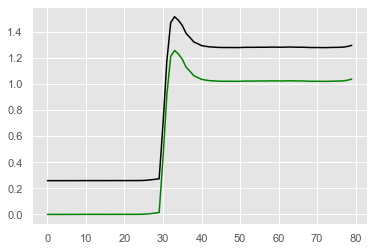

Microwave_ON


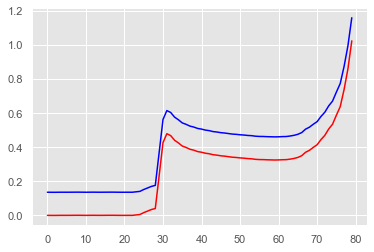

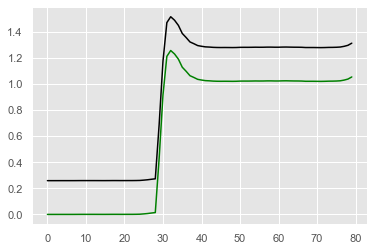

Microwave_ON


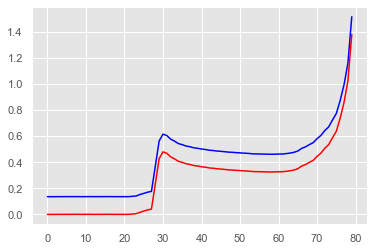

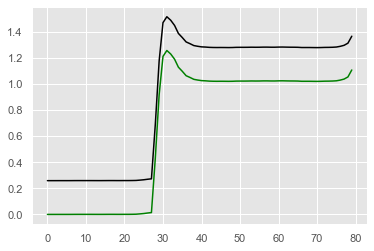

Microwave_ON


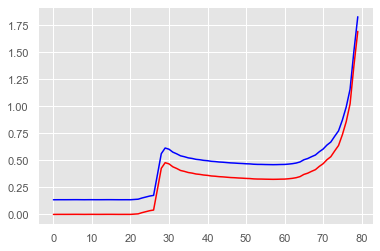

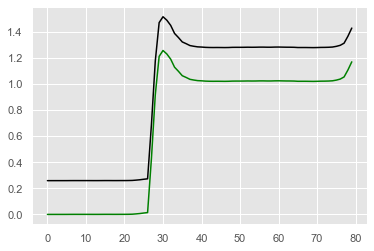

Microwave_ON


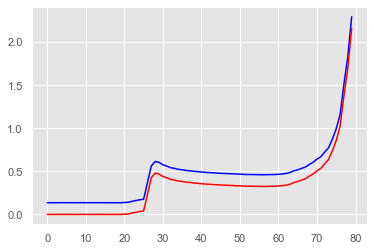

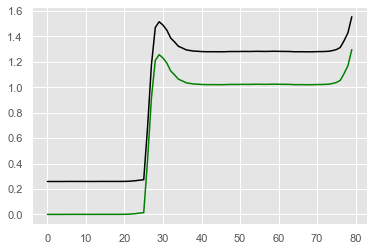

Microwave_ON


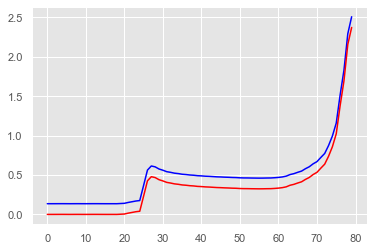

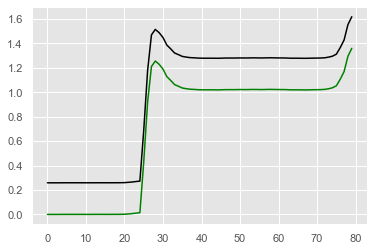

Microwave_ON


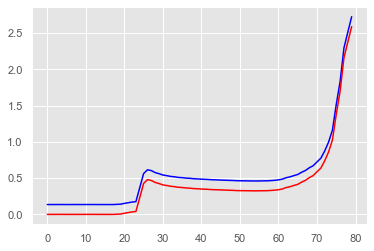

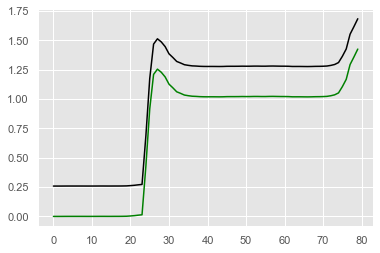

Microwave_ON


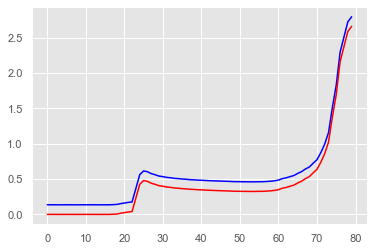

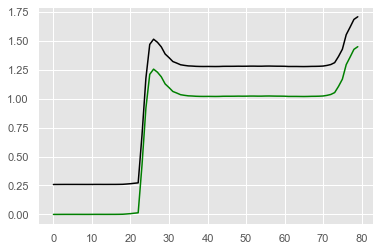

Microwave_ON


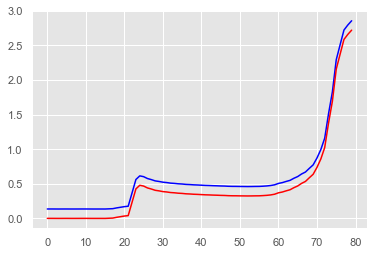

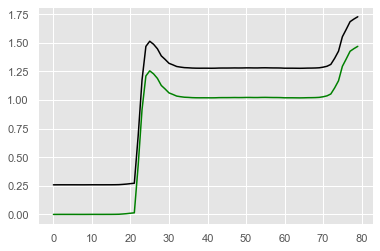

Microwave_ON


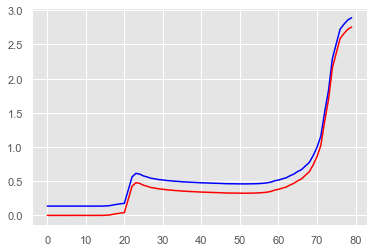

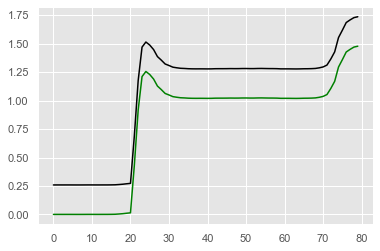

Microwave_ON


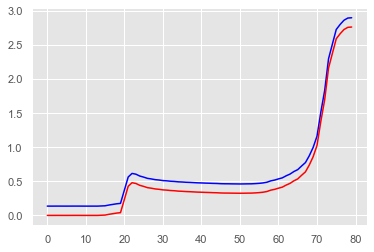

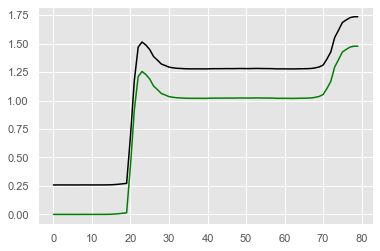

Microwave_ON


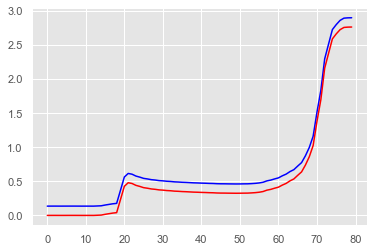

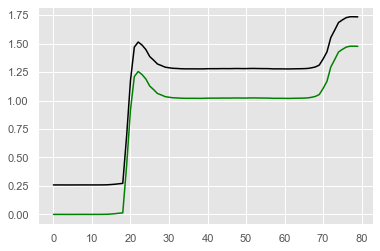

Microwave_ON


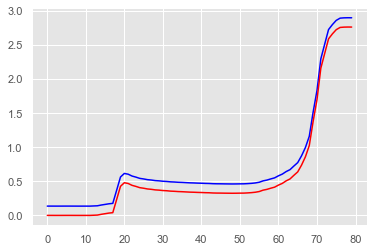

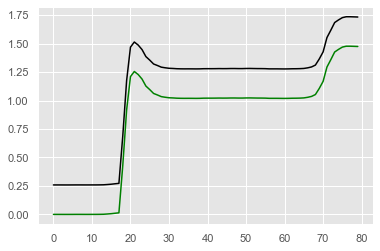

Microwave_OFF


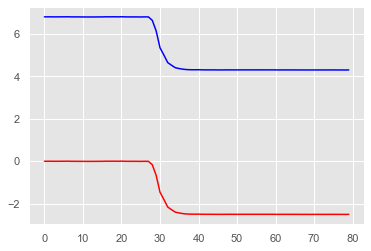

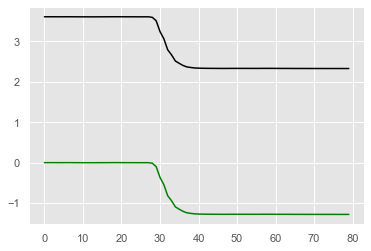

Microwave_OFF


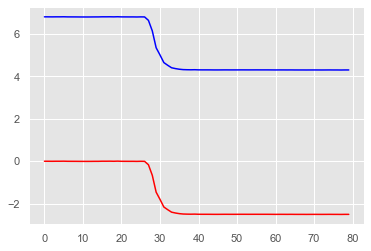

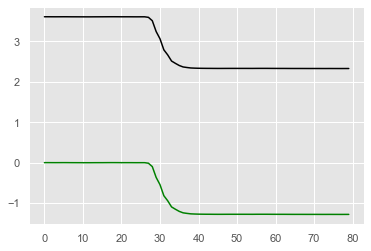

Microwave_OFF


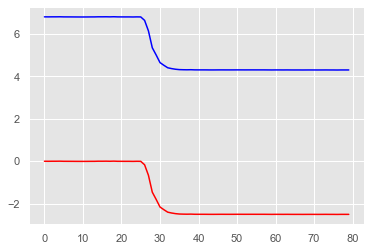

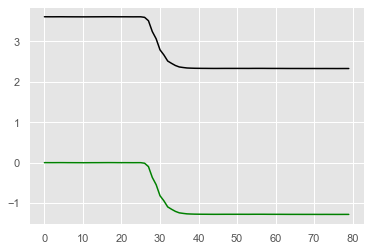

Microwave_OFF


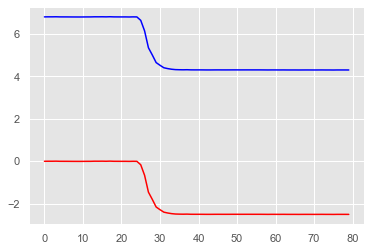

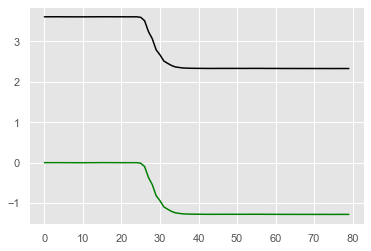

Microwave_OFF


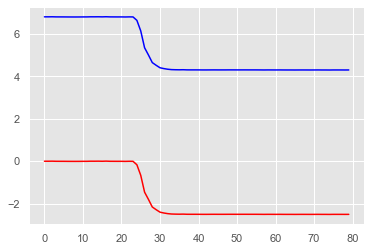

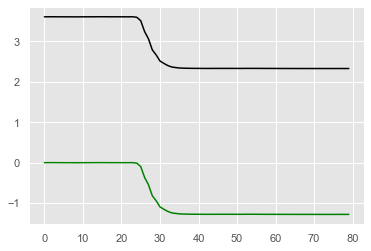

Microwave_OFF


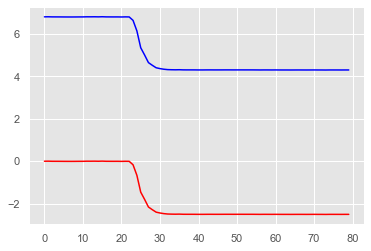

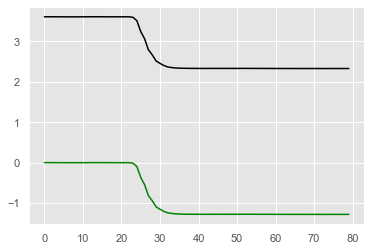

Microwave_OFF


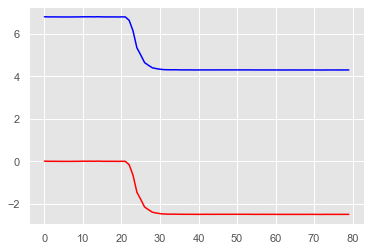

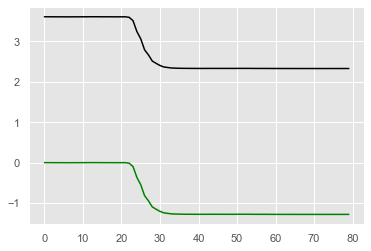

Microwave_OFF


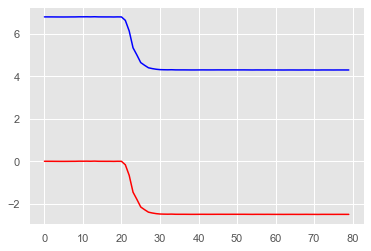

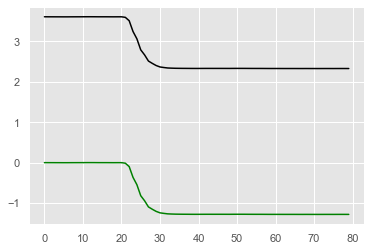

Microwave_OFF


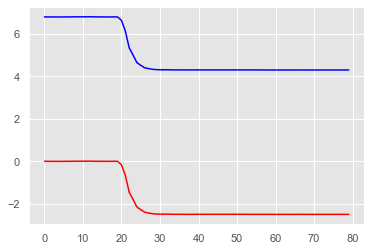

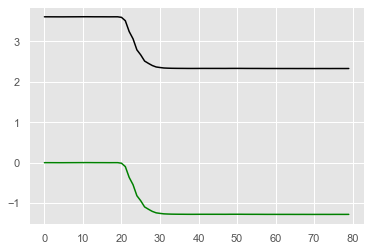

Microwave_OFF


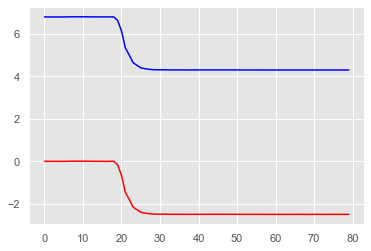

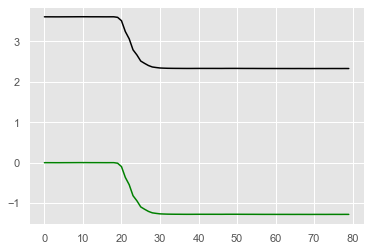

Microwave_OFF


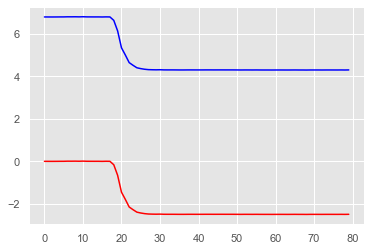

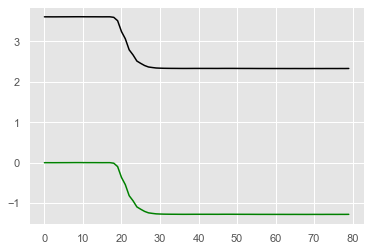

Microwave_OFF


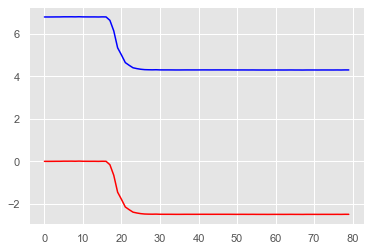

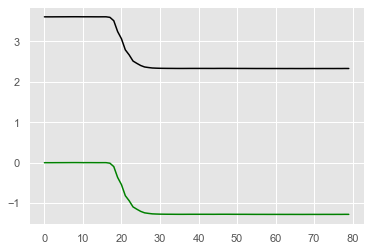

Microwave_OFF


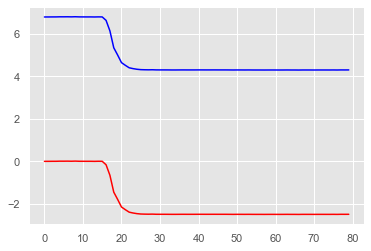

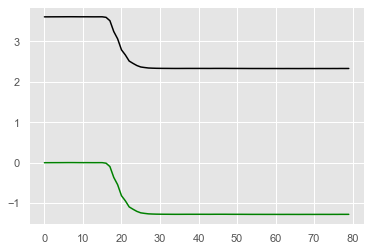

Microwave_OFF


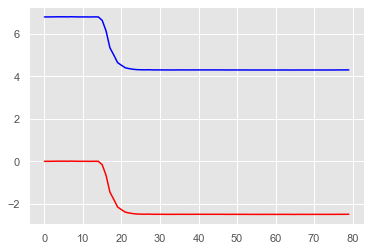

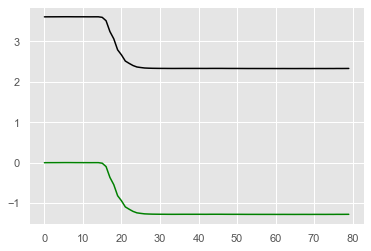

Microwave_OFF


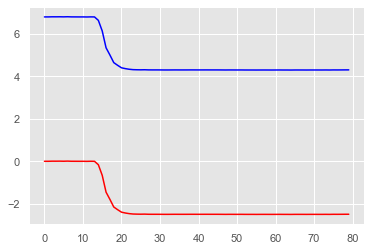

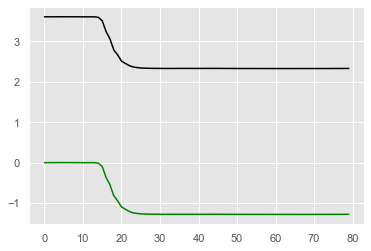

Microwave_OFF


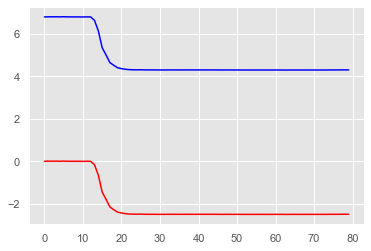

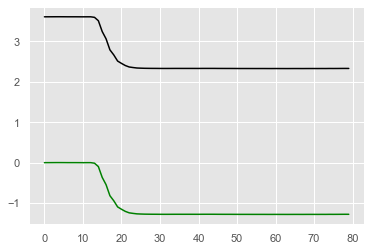

Microwave_OFF


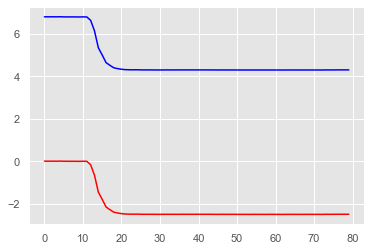

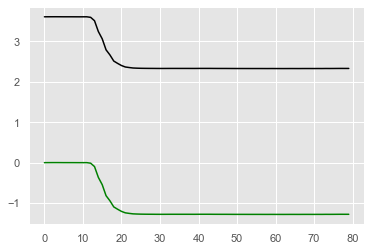

Microwave_OFF


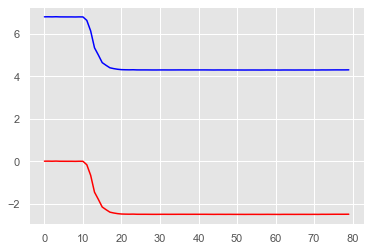

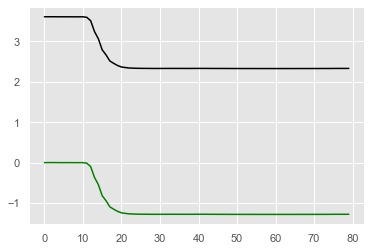

Microwave_OFF


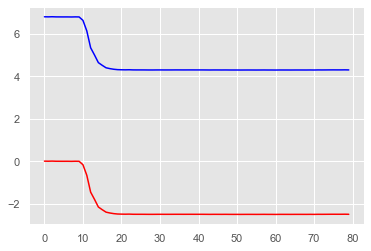

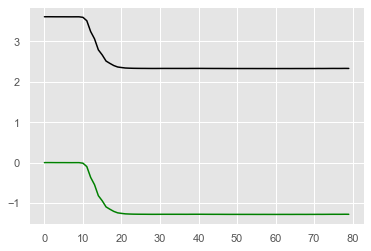

Microwave_OFF


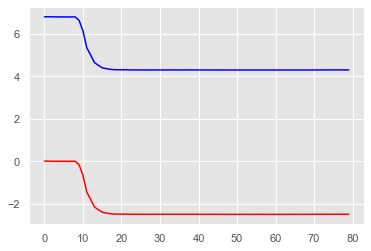

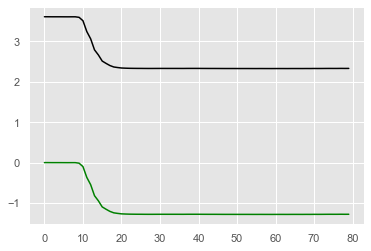

AC_ON


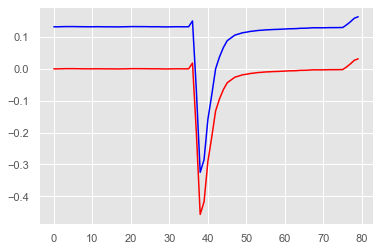

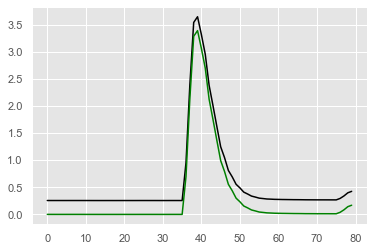

AC_ON


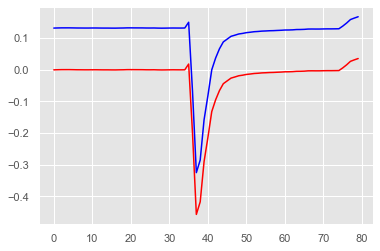

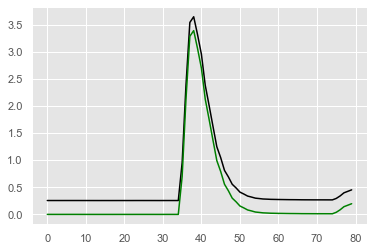

AC_ON


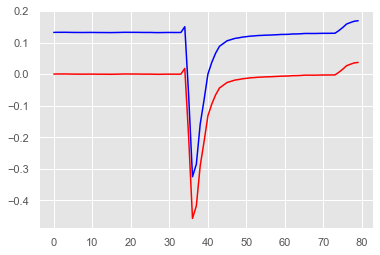

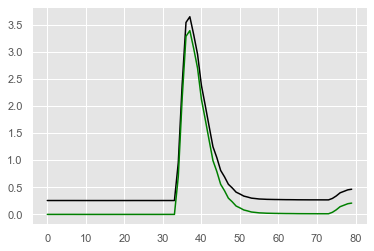

AC_ON


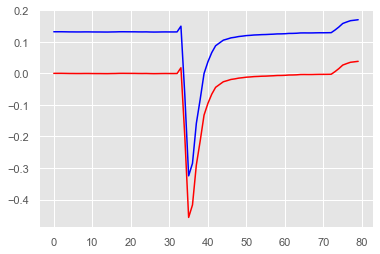

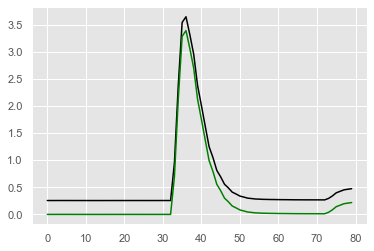

AC_ON


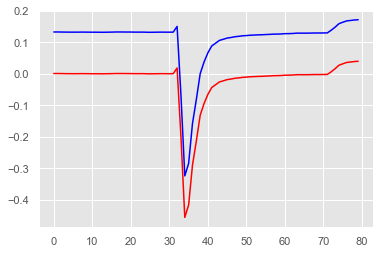

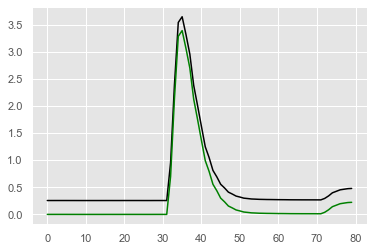

AC_ON


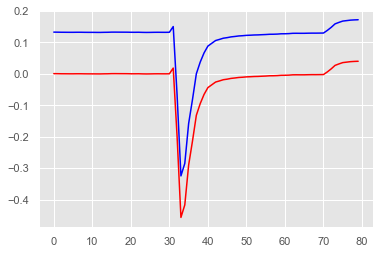

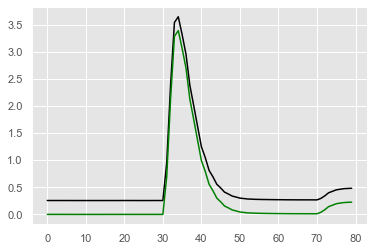

AC_ON


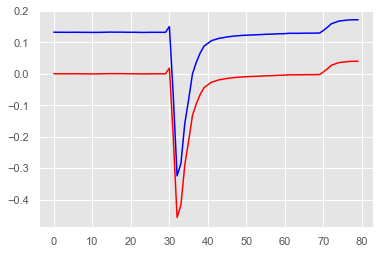

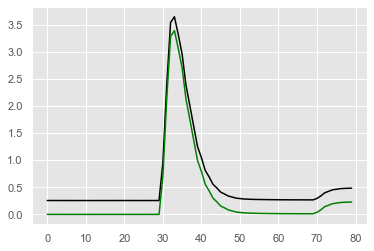

AC_ON


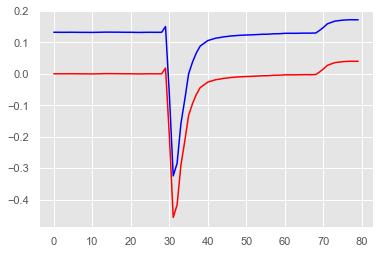

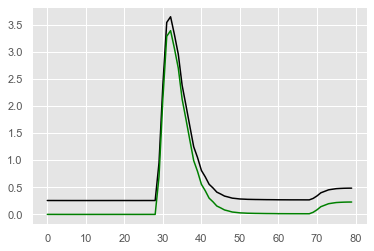

AC_ON


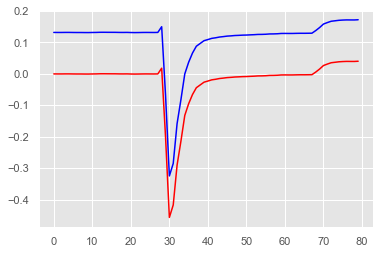

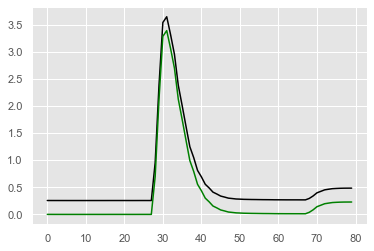

AC_ON


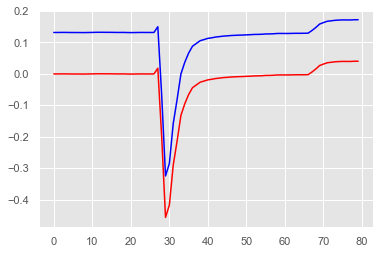

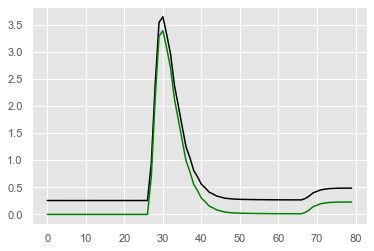

AC_ON


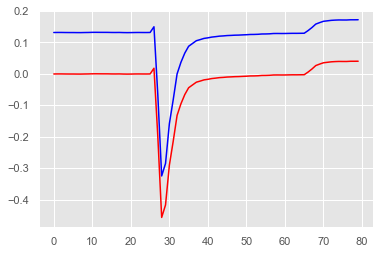

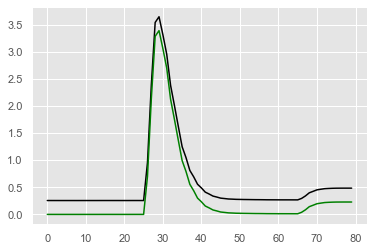

AC_ON


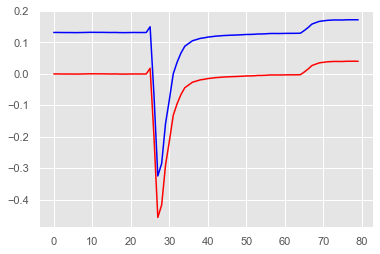

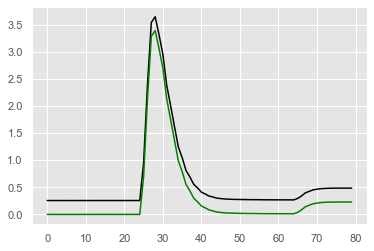

AC_ON


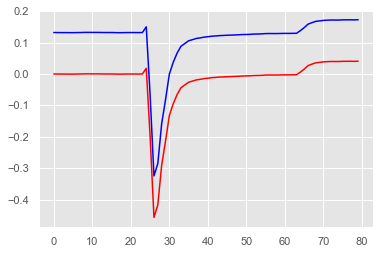

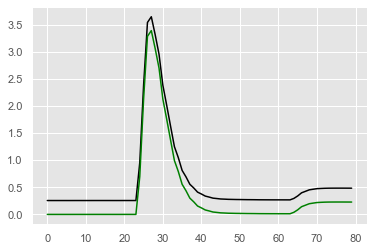

AC_ON


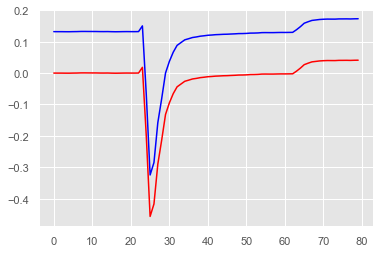

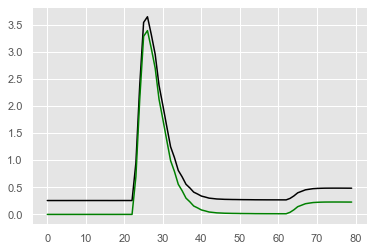

AC_ON


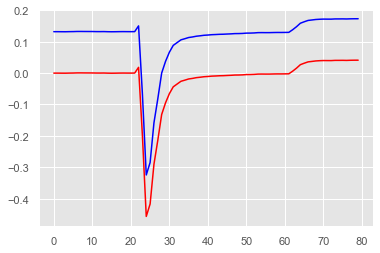

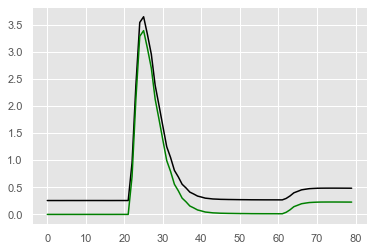

AC_ON


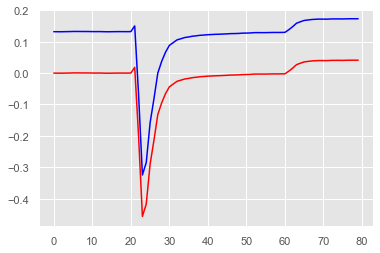

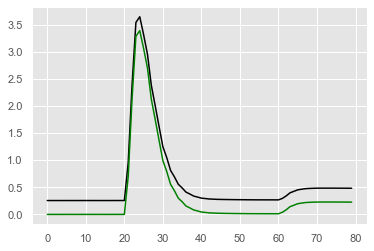

AC_ON


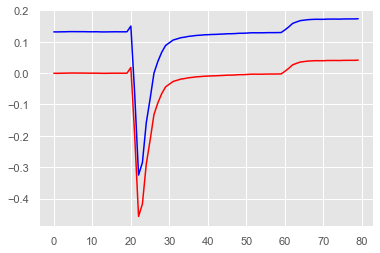

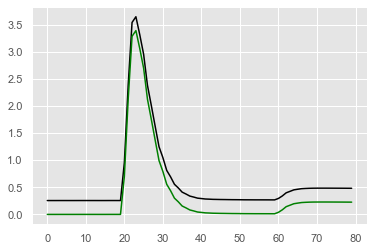

AC_ON


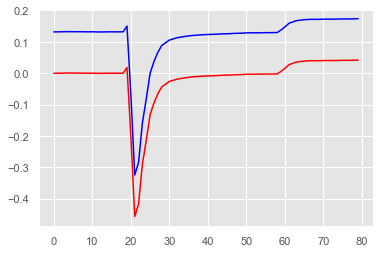

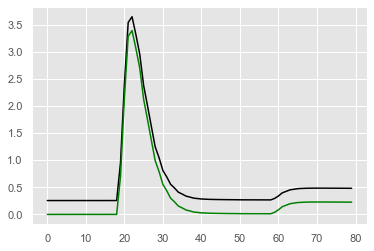

AC_ON


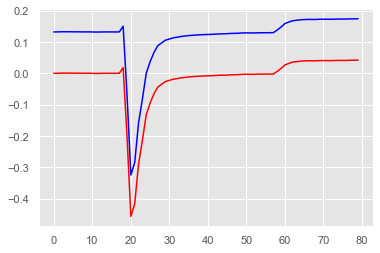

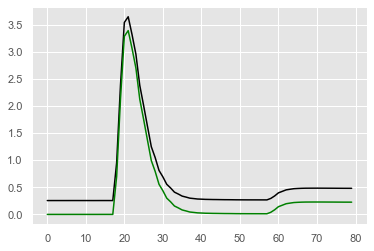

AC_ON


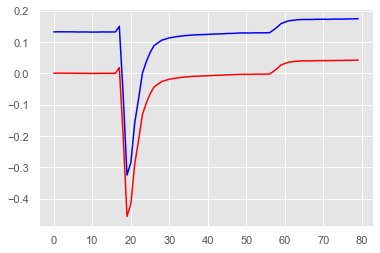

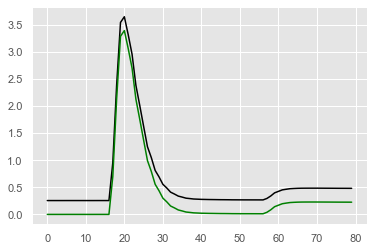

Geyser_ON


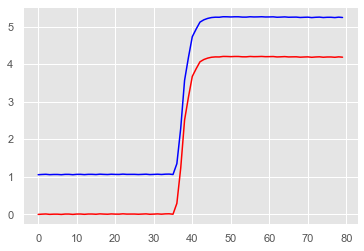

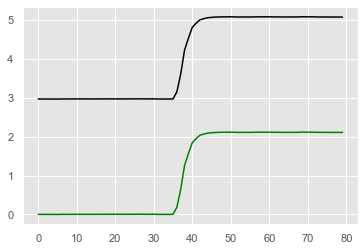

Geyser_ON


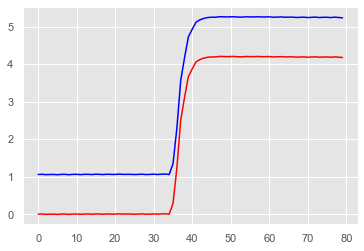

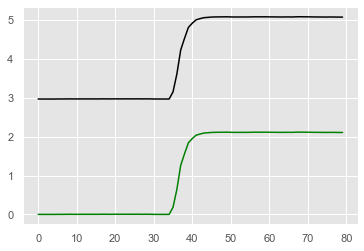

Geyser_ON


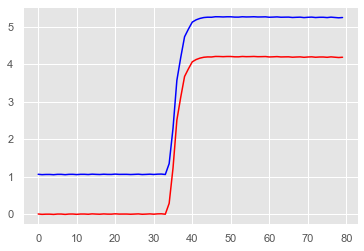

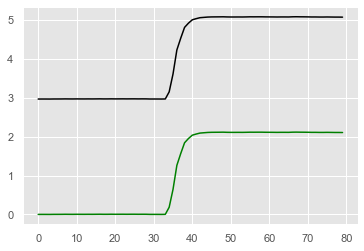

Geyser_ON


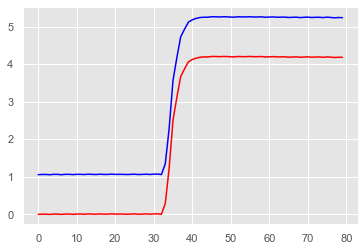

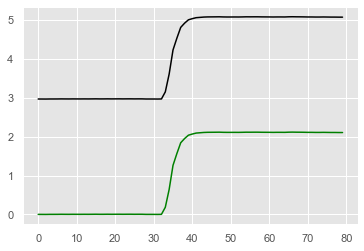

Geyser_ON


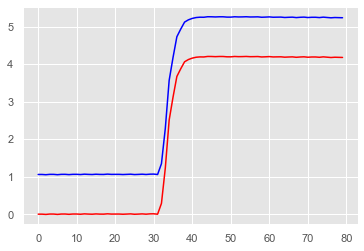

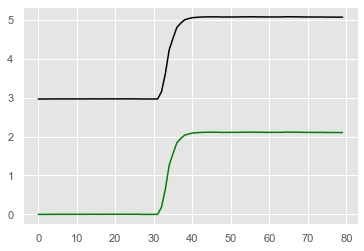

Geyser_ON


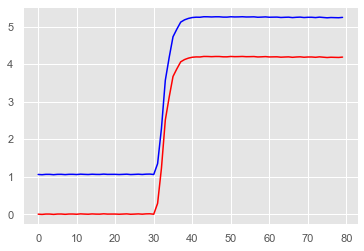

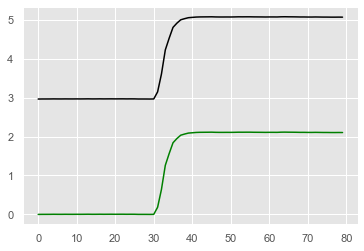

Geyser_ON


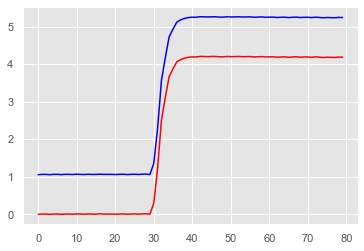

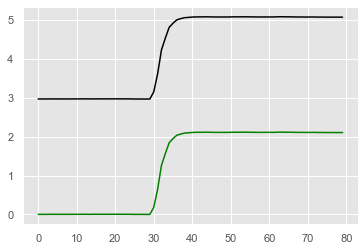

Geyser_ON


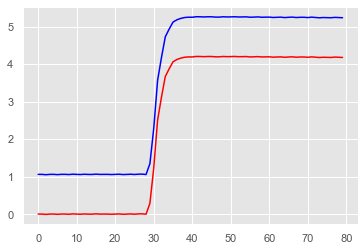

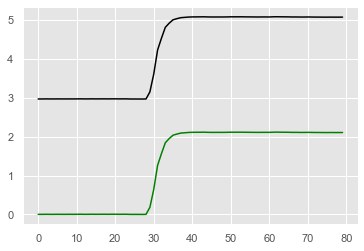

Geyser_ON


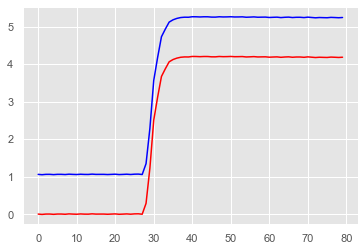

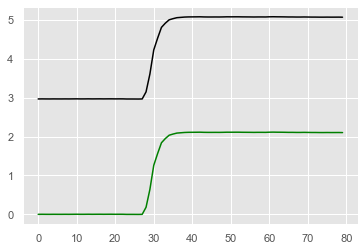

Geyser_ON


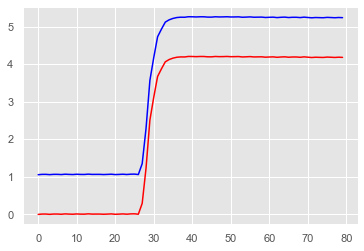

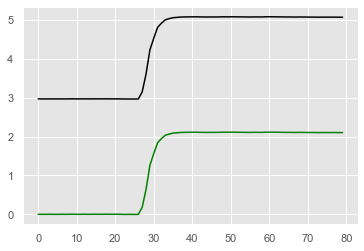

Geyser_ON


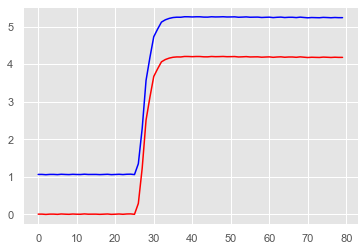

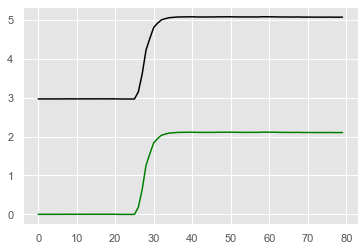

Geyser_ON


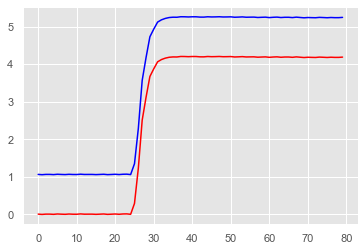

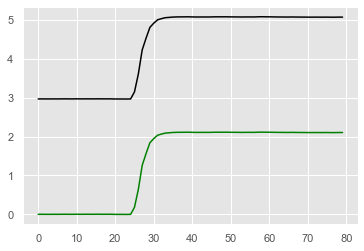

Geyser_ON


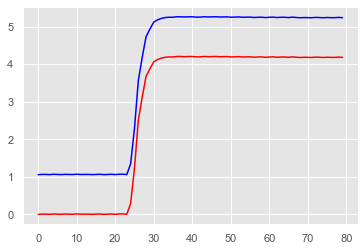

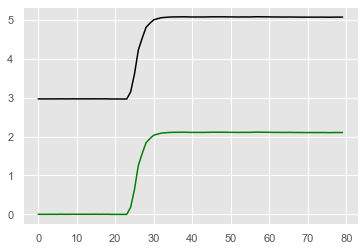

Geyser_ON


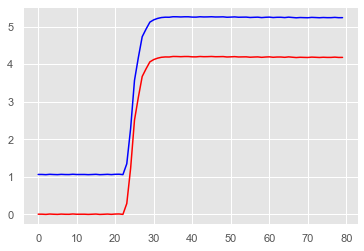

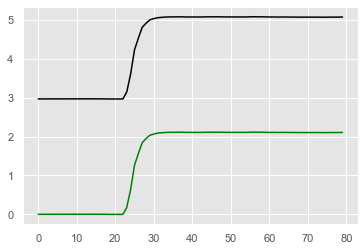

Geyser_ON


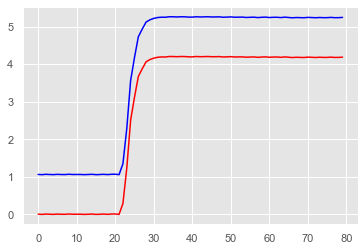

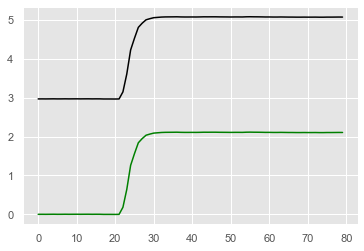

Geyser_ON


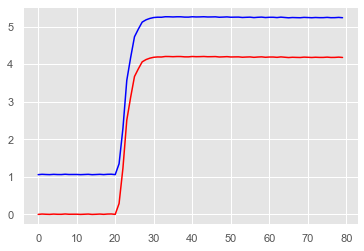

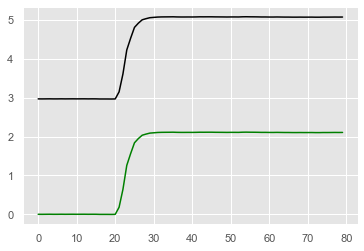

Geyser_ON


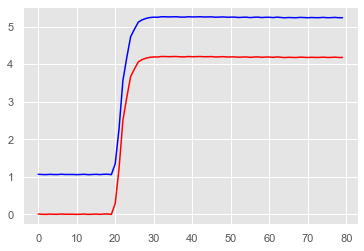

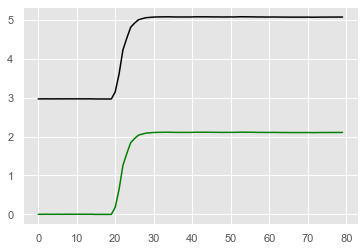

Geyser_ON


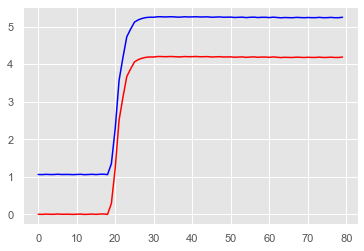

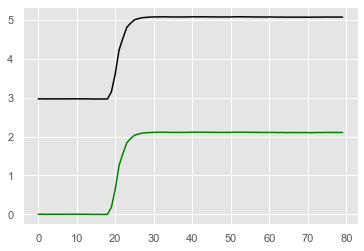

Geyser_ON


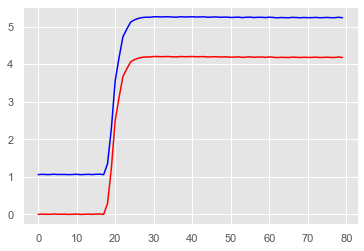

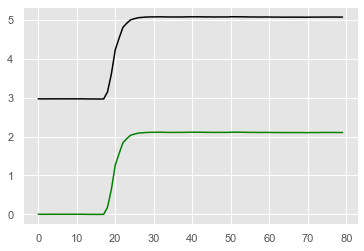

Geyser_ON


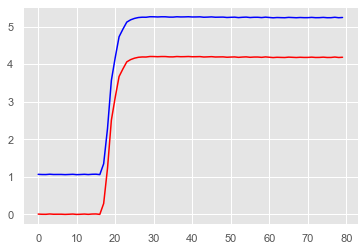

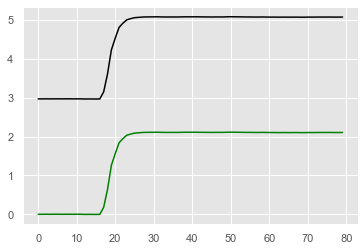

AC_OFF


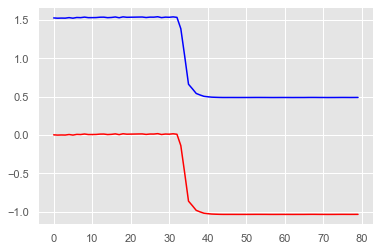

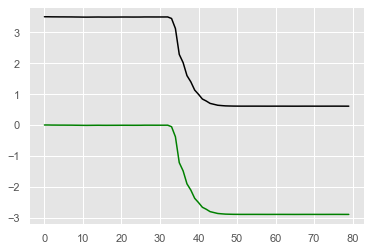

AC_OFF


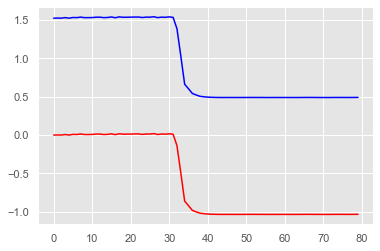

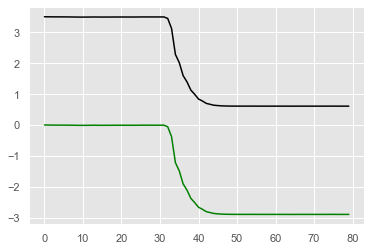

AC_OFF


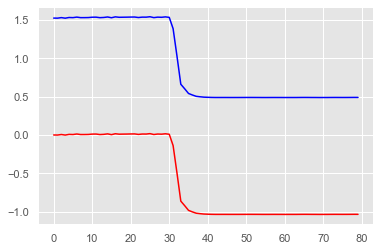

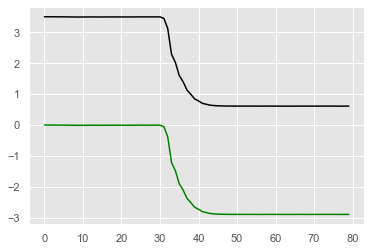

AC_OFF


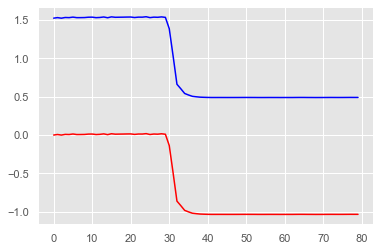

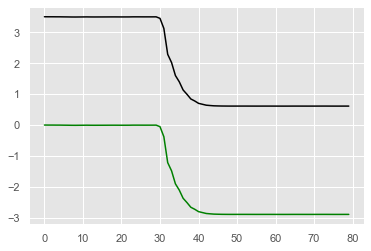

AC_OFF


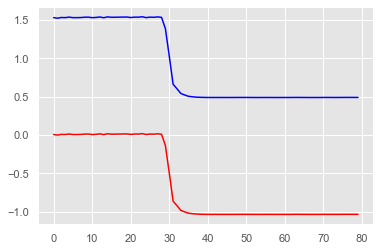

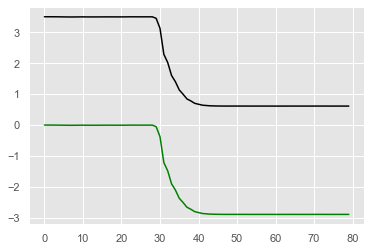

AC_OFF


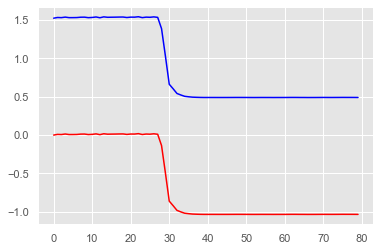

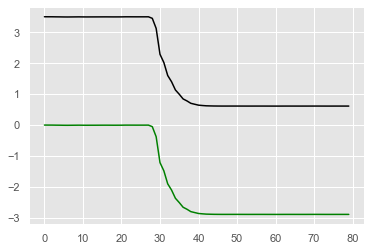

AC_OFF


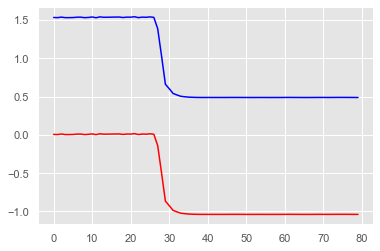

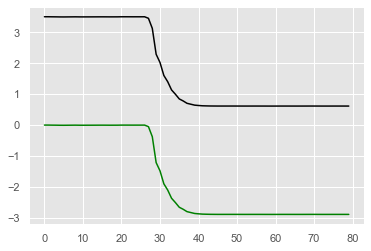

AC_OFF


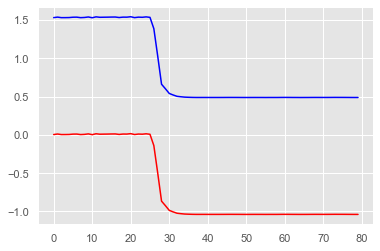

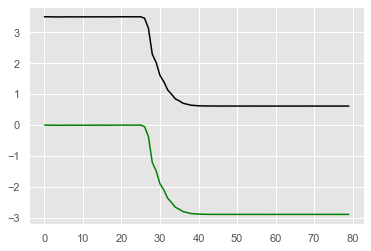

AC_OFF


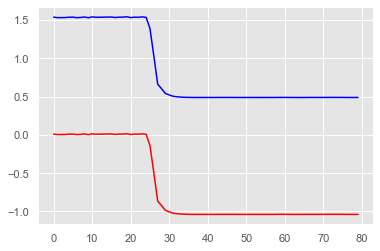

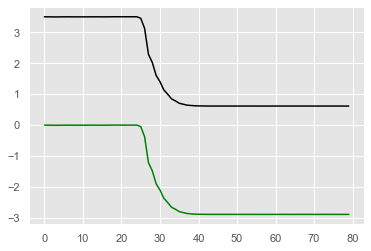

AC_OFF


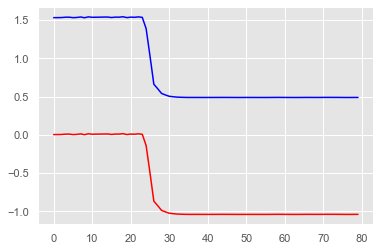

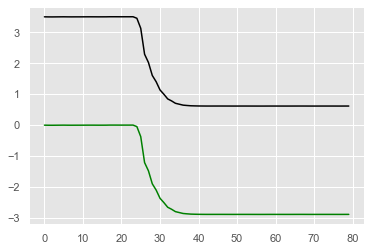

AC_OFF


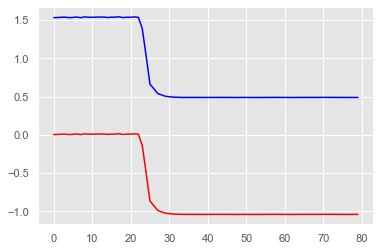

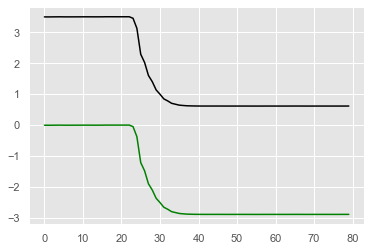

AC_OFF


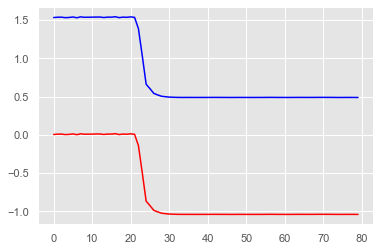

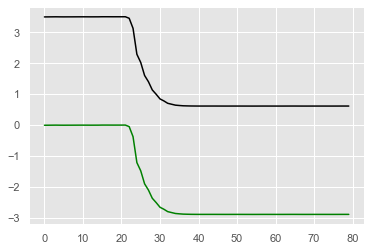

AC_OFF


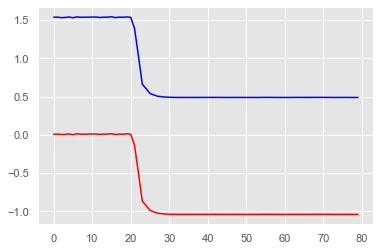

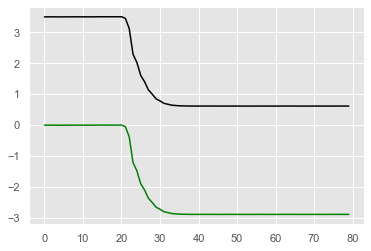

AC_OFF


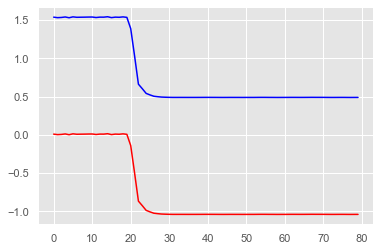

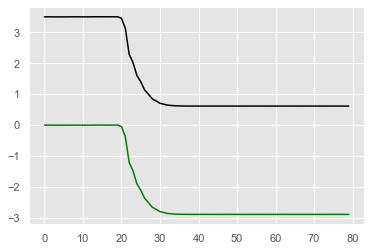

AC_OFF


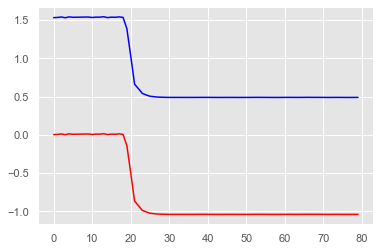

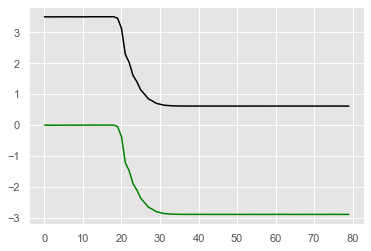

AC_OFF


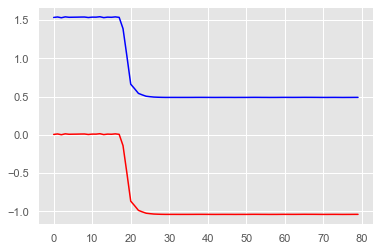

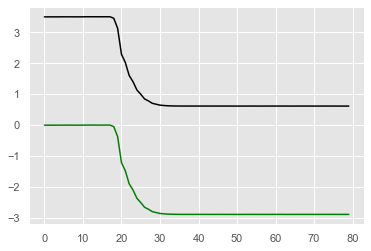

AC_OFF


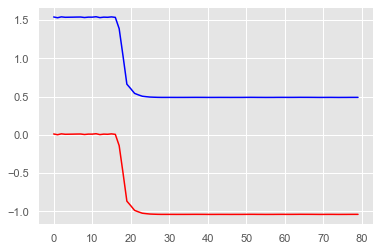

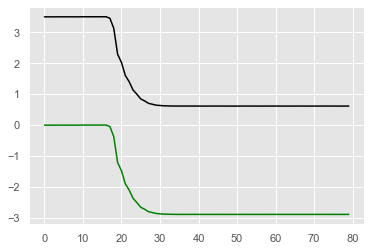

AC_OFF


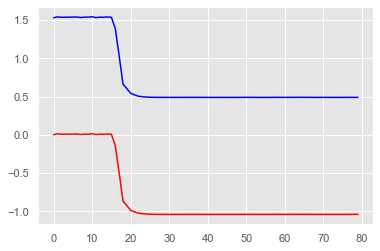

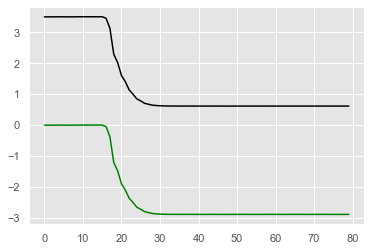

AC_OFF


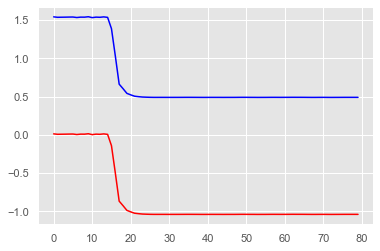

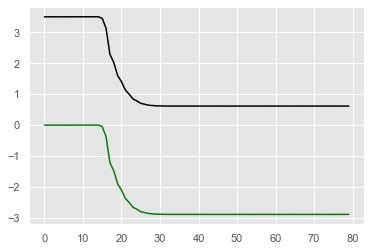

AC_OFF


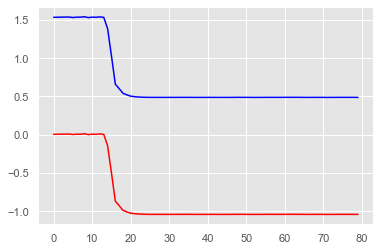

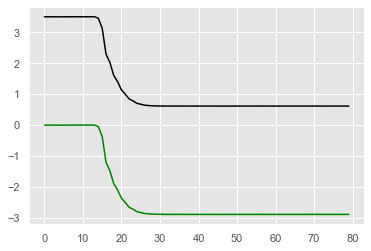

Geyser_OFF


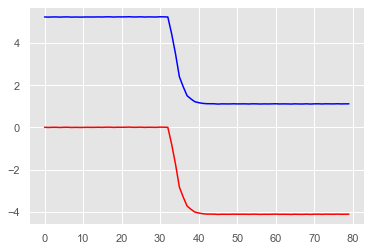

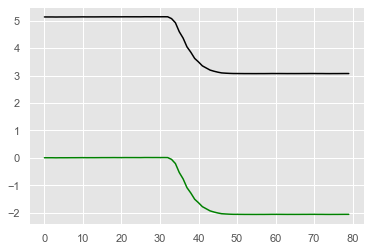

Geyser_OFF


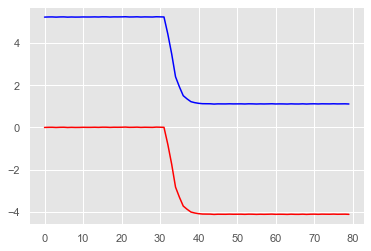

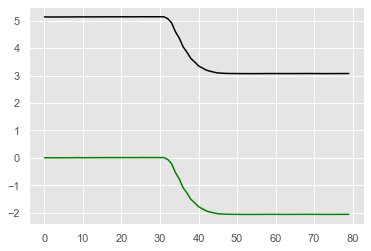

Geyser_OFF


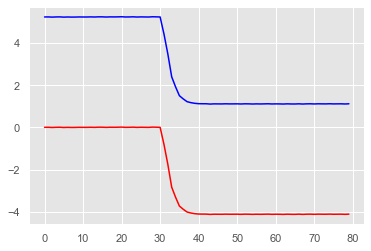

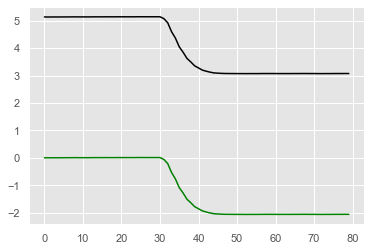

Geyser_OFF


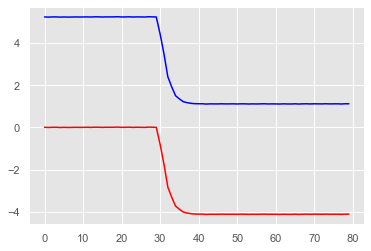

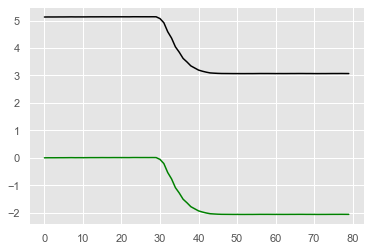

Geyser_OFF


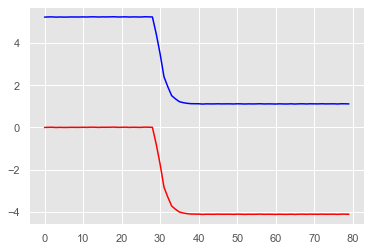

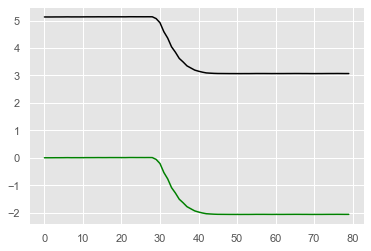

Geyser_OFF


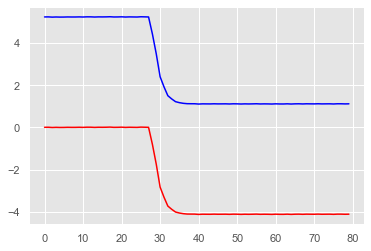

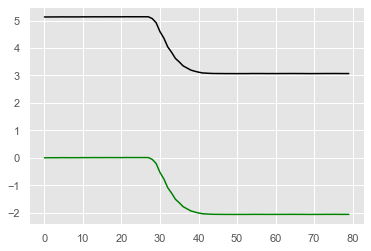

Geyser_OFF


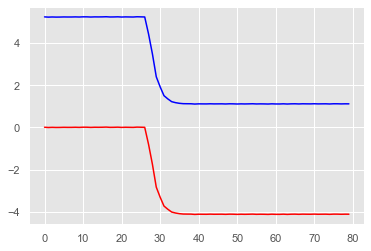

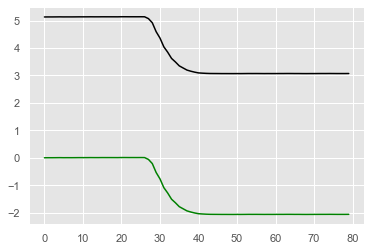

Geyser_OFF


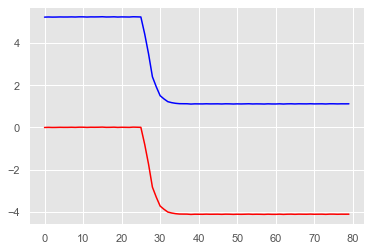

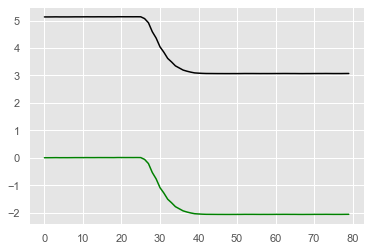

Geyser_OFF


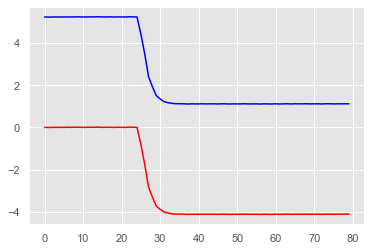

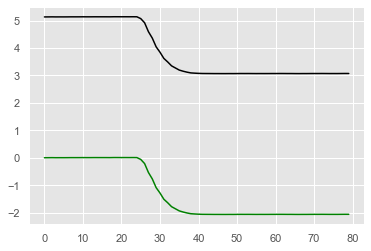

Geyser_OFF


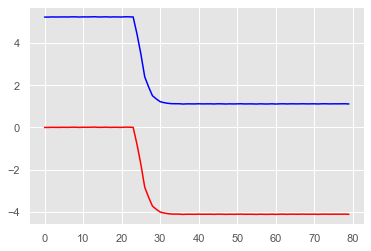

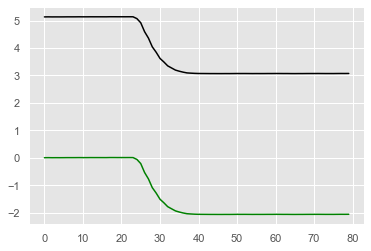

Geyser_OFF


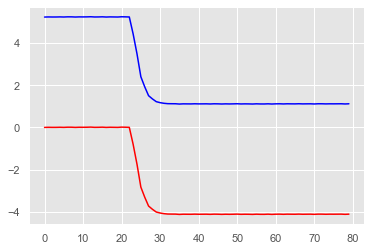

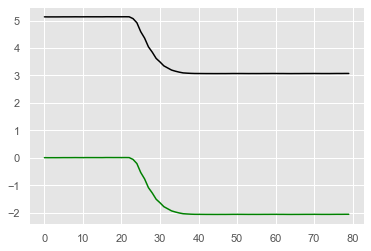

Geyser_OFF


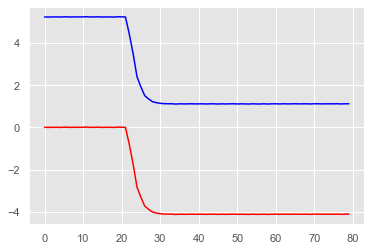

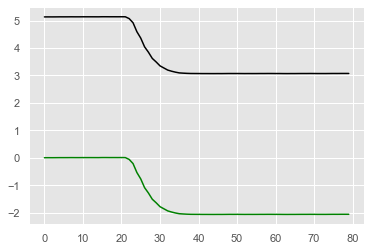

Geyser_OFF


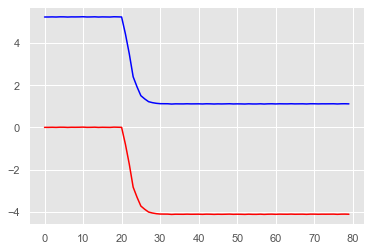

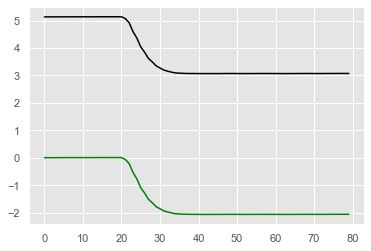

Geyser_OFF


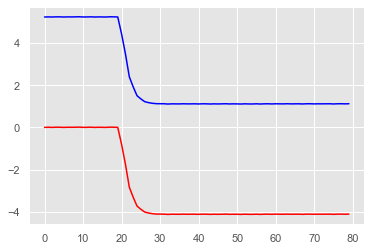

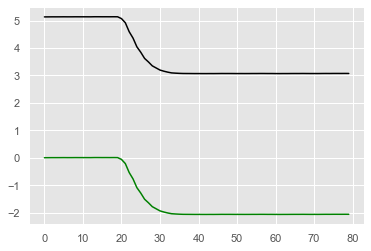

Geyser_OFF


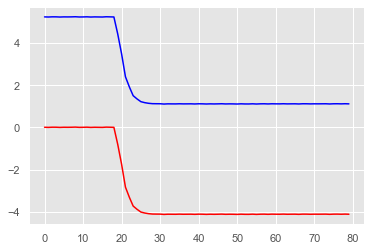

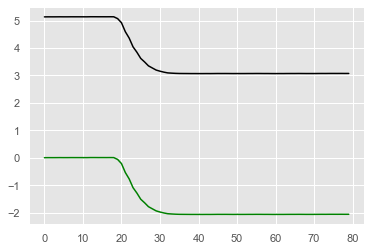

Geyser_OFF


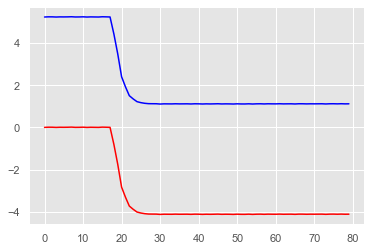

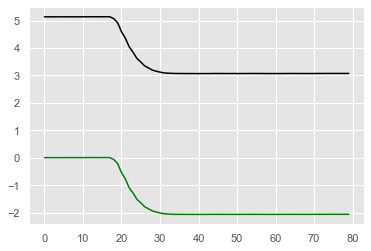

Geyser_OFF


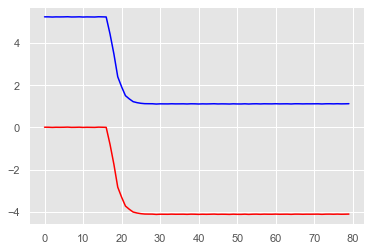

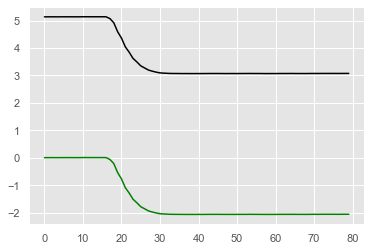

Geyser_OFF


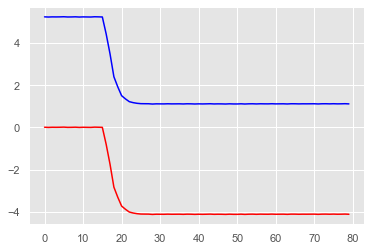

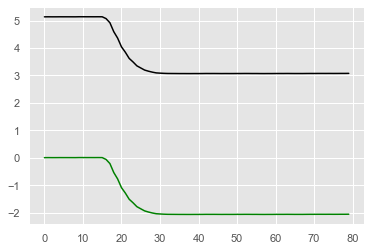

Geyser_OFF


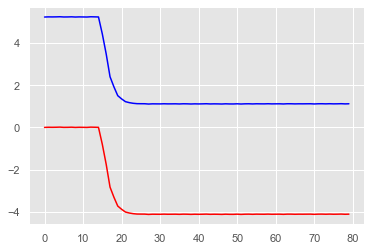

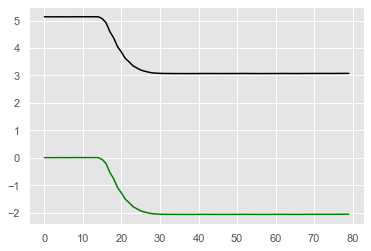

Geyser_OFF


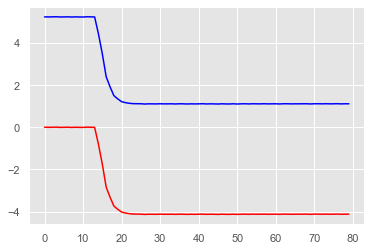

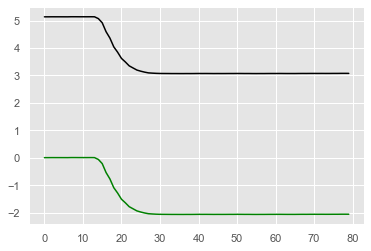

AC_ON


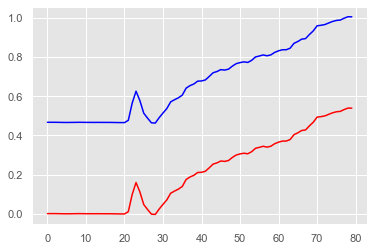

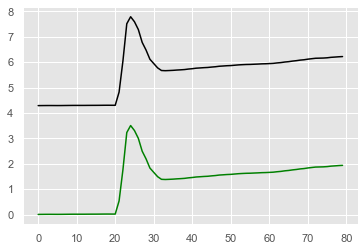

AC_ON


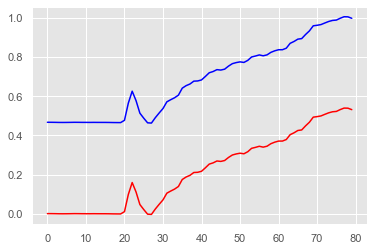

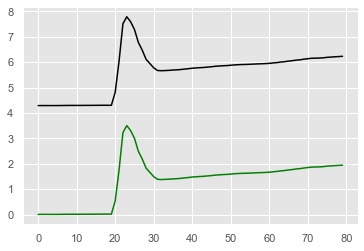

AC_ON


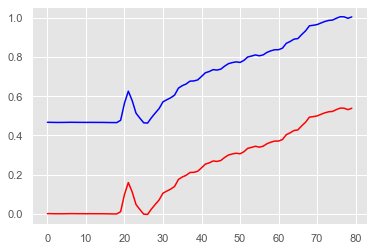

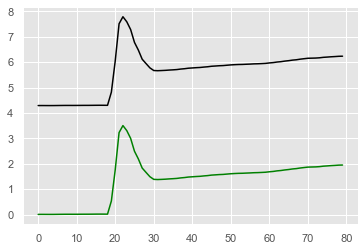

AC_ON


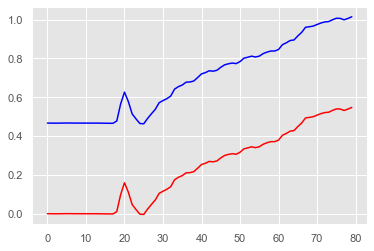

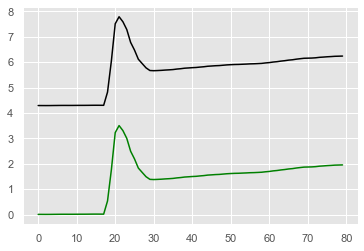

AC_ON


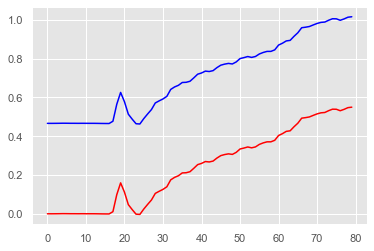

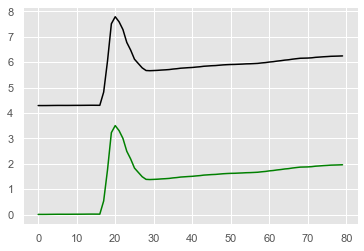

AC_ON


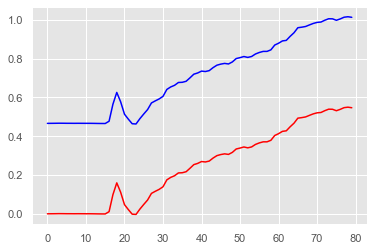

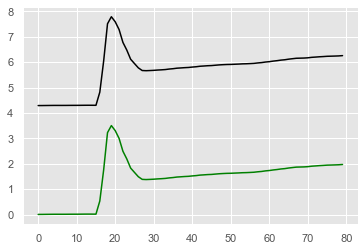

AC_ON


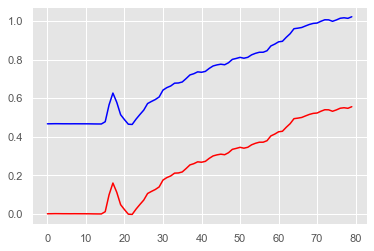

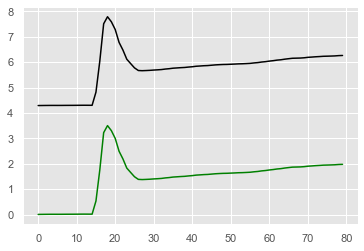

AC_ON


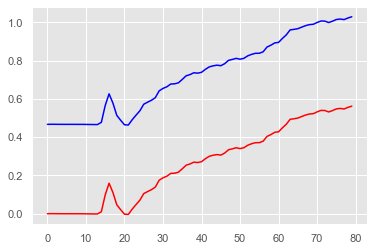

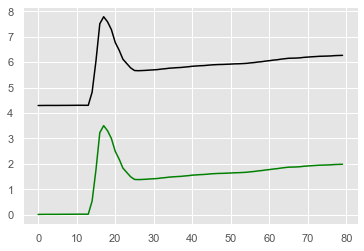

AC_ON


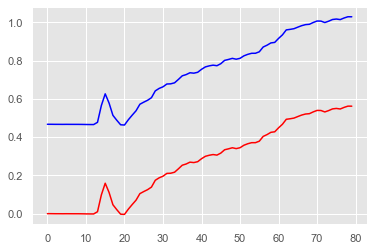

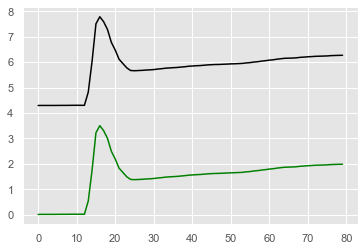

AC_ON


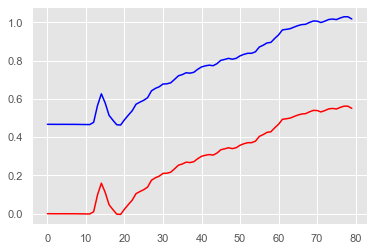

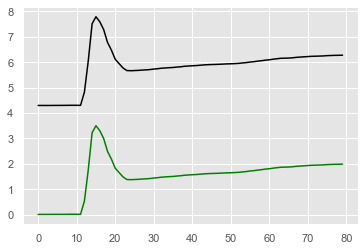

AC_ON


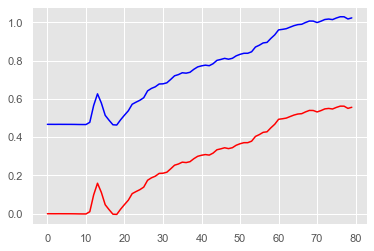

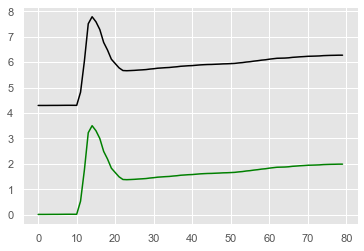

AC_ON


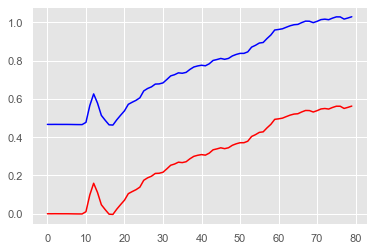

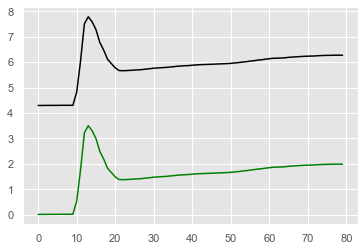

AC_ON


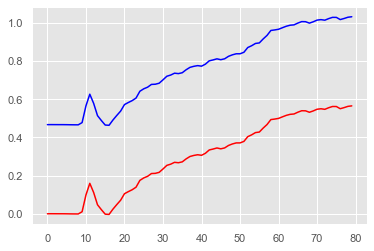

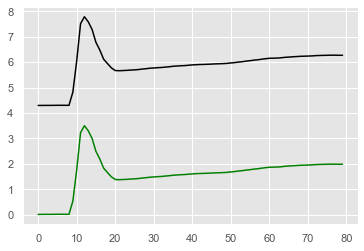

AC_ON


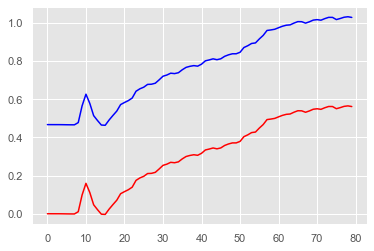

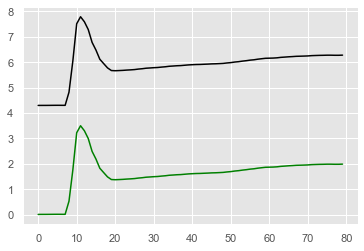

AC_ON


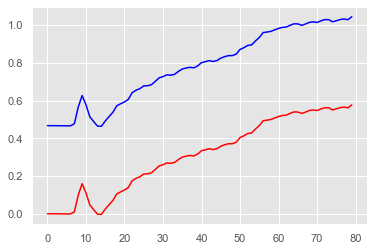

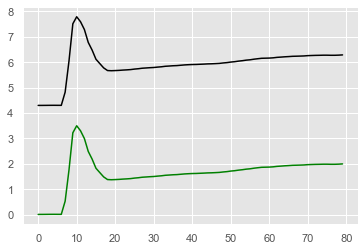

AC_ON


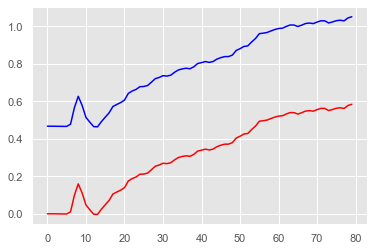

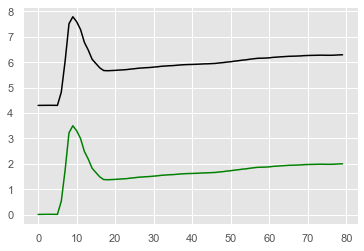

AC_ON


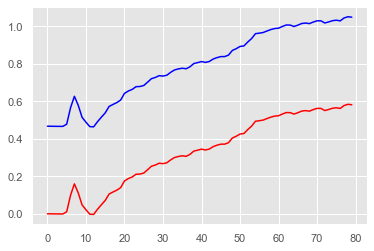

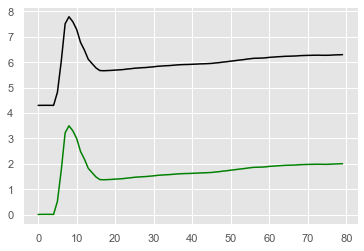

AC_ON


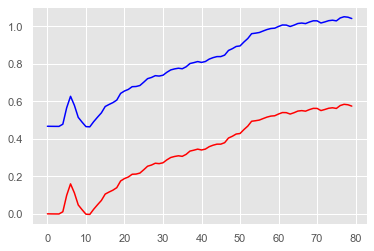

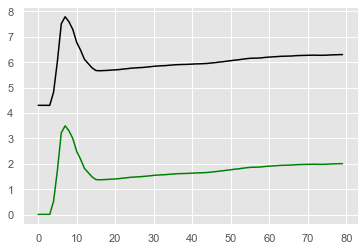

AC_ON


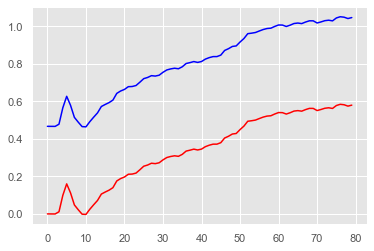

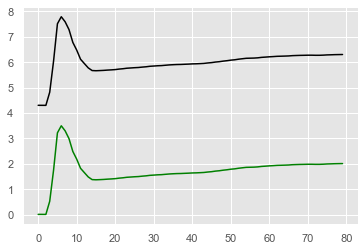

AC_ON


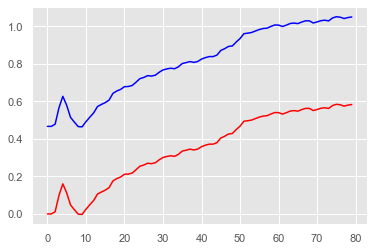

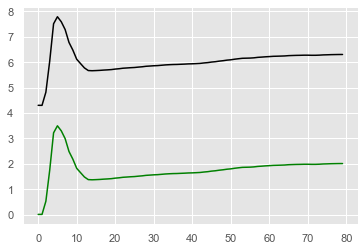

Microwave_ON


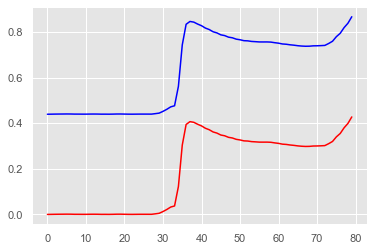

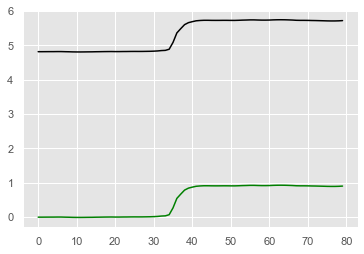

Microwave_ON


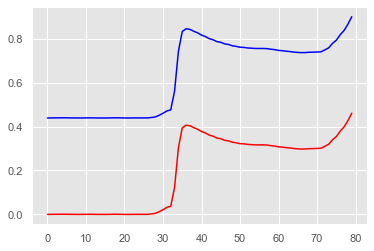

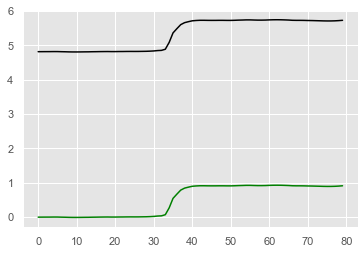

Microwave_ON


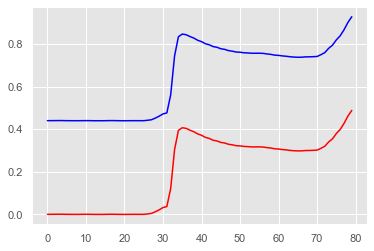

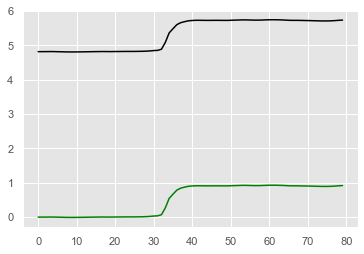

Microwave_ON


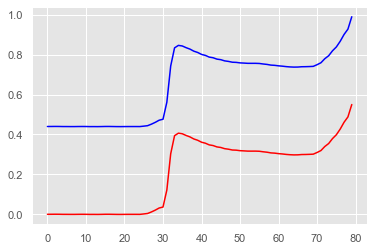

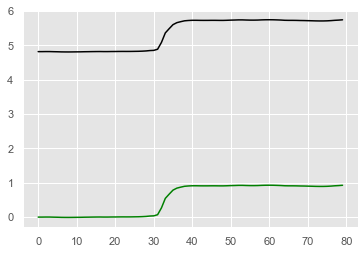

Microwave_ON


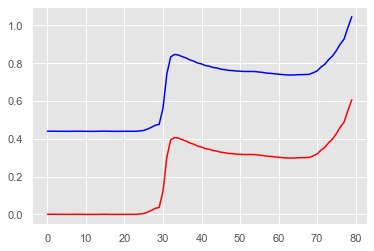

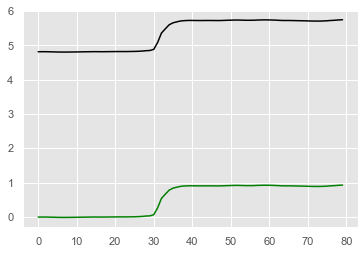

Microwave_ON


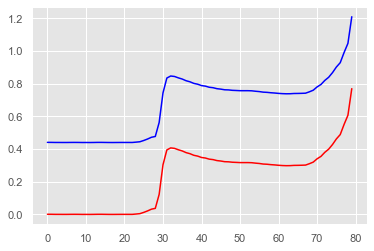

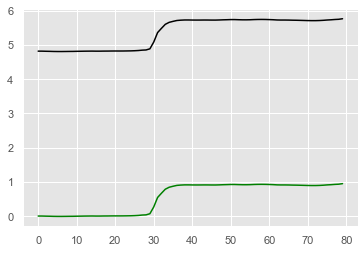

Microwave_ON


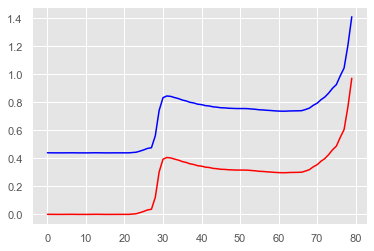

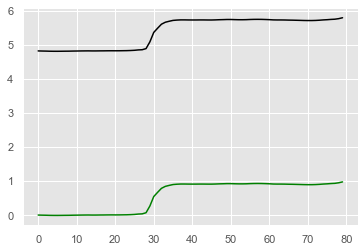

Microwave_ON


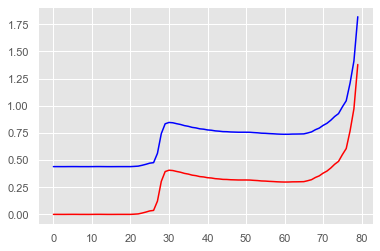

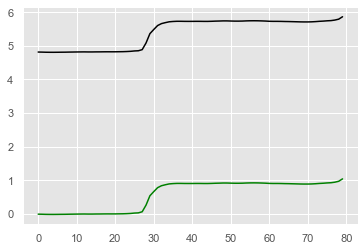

Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


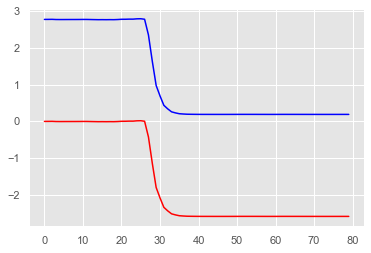

Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_ON


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


AC_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Microwave_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


Geyser_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


AC_OFF


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


Microwave_ON


In [36]:
for i in range(len(yfinaltargetset3)):
    print(truelabels[i])
    plt.plot(xfinaltargetset3[i, :, 0], color='blue')
    plt.plot(xfinaltargetset3[i, :, 2], color='red')
    plt.show()
    plt.plot(xfinaltargetset3[i, :, 1], color='black')
    plt.plot(xfinaltargetset3[i, :, 3], color='green')
    plt.show()

In [38]:
from pylab import rcParams
rcParams['figure.figsize'] = 10, 4

templist = []

for i in range(len(finallist)):
    out = finallist[i]
    out['apparent_power'] = out.apparent_power_S1 + out.apparent_power_S2 + out.apparent_power_S3
    print(timelist[i], labellist[i])
    ind = out.index[out.label != 'no_event'].tolist()[0]
    templist.append(ind)
    plt.plot(out.logged_on_local[int(ind-20):int(ind+60)], out.apparent_power[int(ind-20):int(ind+60)])
    plt.axvline(out.logged_on_local[ind], color='black')
#     plt.axvline(timelist[i], color='blue')
    plt.show()

2021-08-16 12:05:12.600000 AC_ON


2021-08-16 12:25:48.800000 AC_OFF


2021-08-16 12:13:58.800000 Microwave_ON


2021-08-16 12:15:46.800000 Geyser_ON


2021-08-16 12:16:58.400000 Microwave_OFF


2021-08-16 12:35:04.200000 Geyser_OFF


2021-08-16 12:30:44.800000 Microwave_ON


2021-08-16 12:33:44.400000 Microwave_OFF


2021-08-16 12:36:04.400000 AC_ON


2021-08-16 12:40:45 Geyser_ON


2021-08-16 12:51:03.600000 AC_OFF


2021-08-16 12:42:11.200000 Geyser_OFF


2021-08-16 16:07:33.200000 AC_ON


2021-08-16 16:10:57.400000 Microwave_ON


2021-08-16 16:13:57 Microwave_OFF


2021-08-16 16:30:52 Microwave_ON


2021-08-16 16:33:51 Microwave_OFF


2021-08-16 16:35:53.800000 Geyser_OFF


2021-08-16 16:36:54.800000 AC_ON


2021-08-16 16:40:48.600000 Geyser_ON


2021-08-16 17:01:09.200000 AC_OFF


2021-08-17 12:08:45 AC_ON


2021-08-17 12:13:55.600000 Microwave_OFF


2021-08-17 12:15:55.200000 Geyser_ON


2021-08-17 12:34:17 Geyser_OFF


2021-08-17 12:30:54.200000 Microwave_ON


2021-08-17 12:36:25 AC_ON


2021-08-17 12:41:03.400000 Geyser_ON


2021-08-17 12:42:34.200000 Geyser_OFF


2021-08-17 12:33:54.400000 Microwave_OFF


2021-08-17 13:01:27 AC_OFF


2021-08-17 16:06:02.200000 AC_ON


2021-08-17 16:11:05.800000 Microwave_ON


2021-08-17 16:14:05.200000 Microwave_OFF


2021-08-17 16:17:53.800000 Geyser_OFF


2021-08-17 16:26:08.600000 AC_OFF


2021-08-17 16:31:17 Microwave_ON
